## Data Exploration
create date: 02/09/2020
modify date: 02/15/2020

this script is to explore the data framework and structure and make a series of plot shown in the pdf

links:

http://mlpy.sourceforge.net/docs/3.4/dtw.html

https://www.audiolabs-erlangen.de/resources/MIR/FMP/C7/C7S2_SubsequenceDTW.html

https://tslearn.readthedocs.io/en/latest/gen_modules/metrics/tslearn.metrics.dtw_subsequence_path.html

https://openproceedings.org/2017/conf/edbt/paper-369.pdf

In [1]:
import gzip
import json
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt

# datetime
import datetime
import time
fmt = "%a, %d %b %Y %H:%M:%S %Z"

# dynamic time warping
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw

In [2]:
path='/Users/mzhang/Desktop/SQL/code/telematics_work_sample/'

In [3]:
with gzip.open(path+'mobile_trips.json.gz', "rb") as f:
    mobile = json.loads(f.read().decode("ascii"))
    
with gzip.open(path+'obd2_trips.json.gz', "rb") as f:
    obd2 = json.loads(f.read().decode("ascii"))

In [ ]:
pd.DataFrame(mobile).shape

In [ ]:
pd.DataFrame(obd2).shape

there are 44 trips recorded in mobile and 41 trips recorded in obd2

In [82]:
# view the example from mobile data
j=1
for i in range(5):
    print(mobile[j][i])

{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690662.0001, 'speed': 3.31, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690663, 'speed': 5.11, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690664.0001, 'speed': 6.83, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690665, 'speed': 9.79, 'accuracy': 50}
{'trip_id': 'C2AE5742-E987-4745-ADA1-2535BCB5AD3E', 'created_at': 1494706078.6895, 'timestamp': 1494690666.0001, 'speed': 14.47, 'accuracy': 50}


there are 5 variables in mobile data: trip_id, created_at, timestamp, speed and accuracy

In [ ]:
# check if 'created_at' values are identical given 'trip_id'
j=1
test= pd.DataFrame(columns=['created_at'], index=range(len(mobile[j])))
cnt=0
for i in range(len(mobile[j])):
    test.loc[cnt, 'created_at']=mobile[j][i]['created_at']
    cnt+=1

In [ ]:
set(test.created_at) # it's identical

In [ ]:
# check the distribution of accuracy variable

accuracy_list= []

for i in range(len(mobile)):    
    accuracy= [value['accuracy'] for value in mobile[i]]
    accuracy_list = [*accuracy_list, *accuracy]    

In [ ]:
from collections import Counter
from scipy import stats

Q3= np.percentile(accuracy_list, 75)
IQR= stats.iqr(accuracy_list)

In [ ]:
# max= Q3 + 1.5*IQR 

accuracy_threshold= Q3 +1.5*IQR
accuracy_threshold

In [ ]:
index = [idx for idx, val in enumerate(accuracy_list) if val > 17.5]
index= list(np.asarray(index, dtype=int))
#accuracy_list.remove(10)

drop mobile records with accuracy above 17.5

In [70]:
# view the example from obd2 data
j=1
for i in range(5):
    print(obd2[j][i])

{'trip_id': 'trip_TAU99985_000002', 'timestamp': 1.122, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 2.159, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 3.123, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 4.138, 'speed': 0}
{'trip_id': 'trip_TAU99985_000002', 'timestamp': 5.082, 'speed': 0}


there are only 3 variables in obd2 data: trip_id, timestamp and speed. The timestamp in the 2 data are relative to different reference.

In [ ]:
# make the table to count how many records were taken given each trip_id for mobile data

mobile_table=  pd.DataFrame(columns=['trip_id', 'records'], index= range(len(mobile)))
cnt= 0

for i in range(len(mobile)):
    mobile_table.loc[cnt, 'trip_id']= mobile[i][0]['trip_id']
    mobile_table.loc[cnt, 'records']= len(mobile[i])
    cnt+=1

In [ ]:
mobile_table.head()

In [ ]:
# # make the table to count how many records were taken given each trip_id for obd2 data

obd2_table=  pd.DataFrame(columns=['trip_id', 'records'], index= range(len(obd2)))
cnt= 0

for i in range(len(obd2)):
    obd2_table.loc[cnt, 'trip_id']= obd2[i][1]['trip_id']
    obd2_table.loc[cnt, 'records']= len(obd2[i])
    cnt+=1

In [ ]:
obd2_table.head()

the time records for both data are irregular

#### Find the right time reference

Since the timestamp is relative to different reference, I first need to convert to the same/close scale in order to find the matched interval. Based on the notice in the introduction pdf, it uses (epoch) second. So I convert epoch to human-readable date

In [ ]:
j=1
for i in range(5):
    s= mobile[j][i]['timestamp']
    t = time.strftime("%a, %d %b %Y %H:%M:%S %Z", time.localtime(s))

    print('time: ', t)

In [ ]:
# draw a few plots to check if the two times are on the same scale now

for i in range(2):
    mobile_id= mobile[i][0]['trip_id']
    
    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec', 'speed'], index= range(len(mobile[i])))
    cnt=0
    
    end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    for value in mobile[i]:
        
        if value['accuracy'] > 17.5:
            continue
        
        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
        mobile_time.loc[cnt, 'start']= start
        mobile_time.loc[cnt, 'end']= end
        mobile_time.loc[cnt, 'sec'] = ( start-end).total_seconds() 
        mobile_time.loc[cnt, 'speed']= value['speed']
        cnt+=1
    
    x1= mobile_time['sec']
    y1= mobile_time['speed']
    #y1= [value['speed'] for value in mobile[i]]
    #accu= [value['accuracy'] for value in mobile[i]]
    
    
    for j in range(2):
        obd2_id= obd2[j][0]['trip_id']
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed'] for value in obd2[j]]

        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        plt.plot(x1, y1, label='mobile')
        plt.plot(x2, y2, label='obd2')
        plt.legend()
        plt.show()


two times are roughly on the same scale and the speeds are not on the same scale. So I decide to normalize both time and speed and make sure they are on the scale 0-1. Next I'm using dynamic time warping (DTW) to compare the smiliarity of two signals

In [ ]:
dist_table= pd.DataFrame(columns=['mobile_id', 'obd2_id', 'distance'], index=range(len(mobile)*len(obd2)))
cnt=0

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    #y1= [value['speed'] for value in mobile[i]]
    
    y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 17.5]
    
    
    if sum(y1)==0:
        continue
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        y2= [value['speed'] for value in obd2[j]]
        
        if sum(y2)==0:
            continue
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        d, p = fastdtw(y1, y2, dist=euclidean)
        
        dist_table.loc[cnt, 'mobile_id']= mobile_id
        dist_table.loc[cnt, 'obd2_id']= obd2_id
        dist_table.loc[cnt, 'distance']= d
        
        cnt+=1

In [ ]:
dist_table.head()

In [ ]:
dist_table.to_csv(path+'DTW_dist_normalize_table.csv', index=None, sep=',')

### load DTW distance table

In [4]:
#dist_table= pd.read_csv(path+'DTW_dist_table.csv', sep=',')
dist_table= pd.read_csv(path+'DTW_dist_normalize_table.csv', sep=',')

In [5]:
dist_table.shape

(1804, 3)

In [6]:
dist_table= dist_table.dropna()

In [7]:
# assume there are roughly 50 matched trips
# I need to calculate the percentile corresponds to 50 trips

cutoff= np.percentile(dist_table.distance, 50/dist_table.shape[1])
print(cutoff)

dist_table_top = dist_table[dist_table.distance<=cutoff]

77.4325747756269


In [8]:
dist_table_top.head()

,mobile_id,obd2_id,distance
0,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000000,43.512121
1,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000002,63.125015
2,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000003,58.479866
3,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000010,61.248138
4,5305845D-61F4-40EB-BE97-F304DFFD4C36,trip_TAU99985_000011,72.377196


In [9]:
# select the top percentile mobile_id
mobile_select= set(dist_table_top.mobile_id)

mobile_list=[]

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id in mobile_select:
        mobile_list.append(mobile_id)

# select the top percentile obd2_id
obd2_select= set(dist_table_top.obd2_id)

obd2_list=[]

for i in range(len(obd2)):
    obd2_id= obd2[i][0]['trip_id']
    
    if obd2_id in obd2_select:
        obd2_list.append(obd2_id)

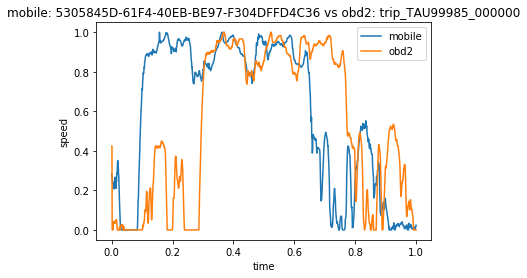

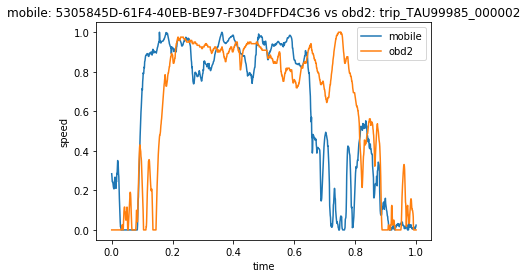

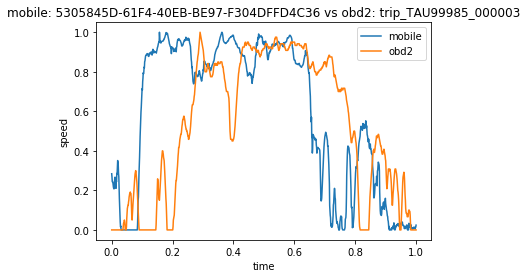

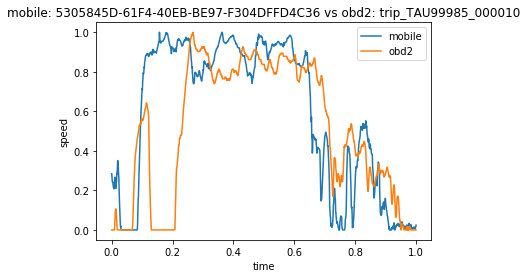

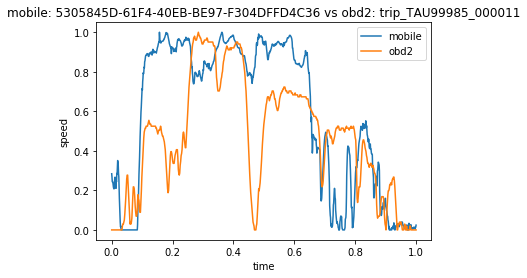

...

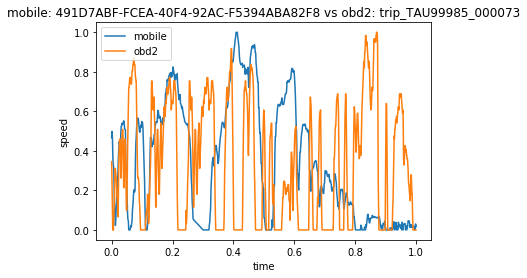

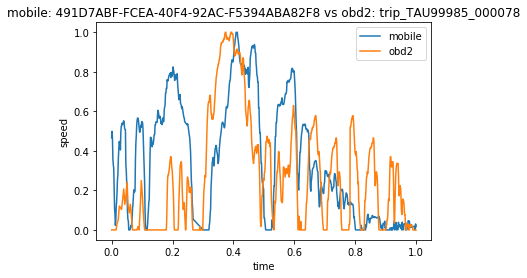

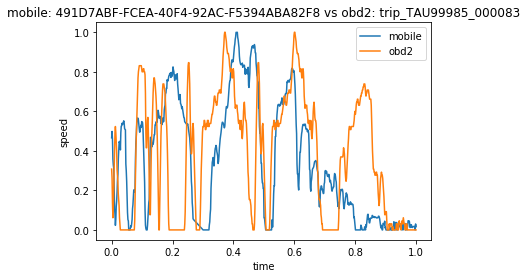

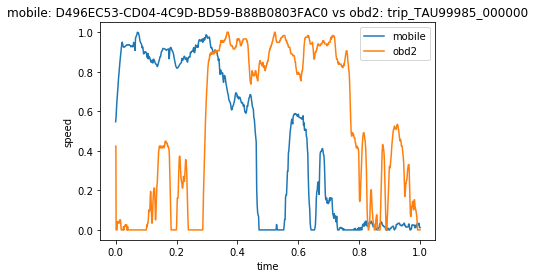

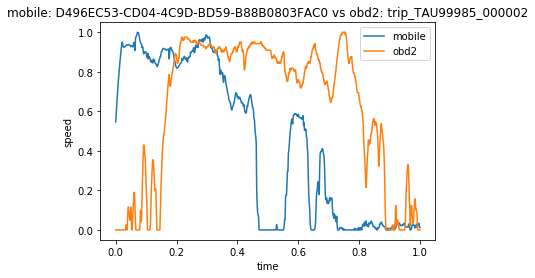

KeyboardInterrupt: 

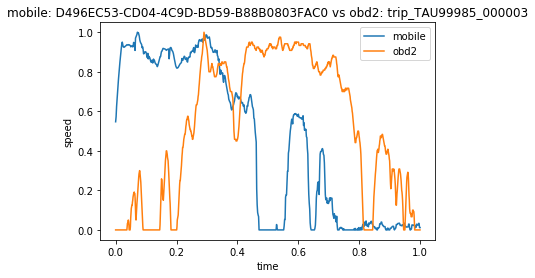

In [10]:
for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id not in mobile_list:
        continue
    
    mobile_time= pd.DataFrame(columns=['start', 'end', 'sec', 'speed'], index= range(len(mobile[i])))
    cnt=0
    
    end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    for value in mobile[i]:
        
        if value['accuracy'] > 17.5:
            continue
        
        start= datetime.datetime.fromtimestamp(float(value['timestamp']))
        mobile_time.loc[cnt, 'start']= start
        mobile_time.loc[cnt, 'end']= end
        mobile_time.loc[cnt, 'sec'] = ( start-end).total_seconds() 
        mobile_time.loc[cnt, 'speed']= value['speed']
        cnt+=1
    
    x1= mobile_time['sec']
    y1= mobile_time['speed']
    if sum(y1)==0:
        continue
        
    x1= np.asarray(x1)
    x1= (x1-min(x1))/(max(x1)-min(x1))    
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        
        if obd2_id not in obd2_list:
            continue
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed']/2 for value in obd2[j]]
        if sum(y2)==0:
            continue
        
        x2= np.asarray(x2)
        x2= (x2-min(x2))/(max(x2)-min(x2))
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        
        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        plt.plot(x1, y1, label='mobile')
        plt.plot(x2, y2, label='obd2')
        plt.legend()
        plt.savefig(path + 'figure/' + mobile_id +'-'+ obd2_id)
        plt.show()

Based on the figures, we can see some tirp pairs have high matched interval. Next I will find the matched subsequence

#### find matched subquences between two temporal sequences

In [11]:
from tslearn.metrics import dtw_subsequence_path

In [51]:
# demo of subsequence DTW package

for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    if mobile_id!= '629D24C3-A426-4F97-A83B-6BE9107DD681':
    #if mobile_id!= '5305845D-61F4-40EB-BE97-F304DFFD4C36':
        continue
        
    y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 17.5]
    
    if sum(y1)==0:
        continue
    y1= np.asarray(y1)
    y1= (y1-min(y1))/(max(y1)-min(y1))
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        #if obd2_id!= 'trip_TAU99985_000010':
        if obd2_id!= 'trip_TAU99985_000002':    
            continue
        y2= [value['speed'] for value in obd2[j]]
        
        if sum(y2)==0:
            continue
        y2= np.asarray(y2)
        y2= (y2-min(y2))/(max(y2)-min(y2))
        
        p, d = dtw_subsequence_path(y1, y2) # (subseq, longseq)
        


In [80]:
p[-1][1]

791

In [53]:
len(y1)

1447

In [54]:
len(y2)

1302

In [55]:
# take the index
mobile_index= [o[0] for o in p]
obd2_index= [o[1] for o in p]

In [56]:
len(mobile_index)

2201

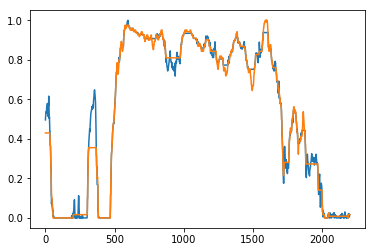

In [57]:
plt.plot([y1[i] for i in mobile_index] , label='mobile')
plt.plot([y2[i] for i in obd2_index], label='obd2')

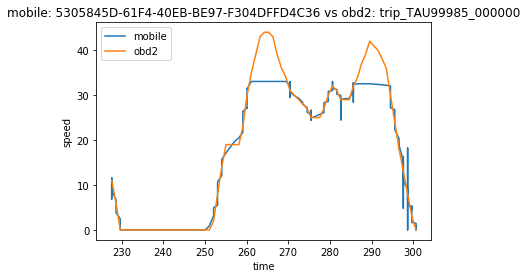

1494683921 227.62
1494684992 300.682


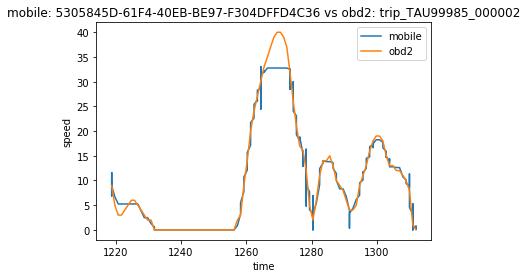

1494683921 1218.773
1494684992 1311.954


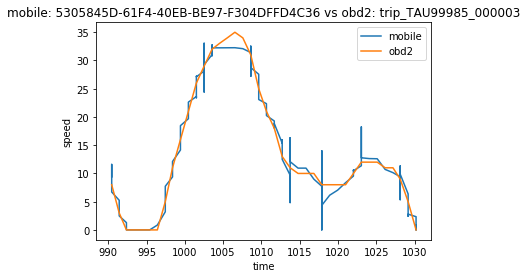

1494683921 990.453
1494684992 1030.204


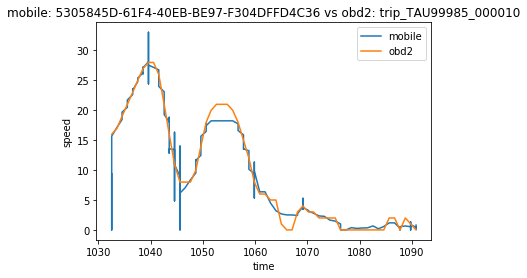

1494683921 1032.56
1494684992 1090.793


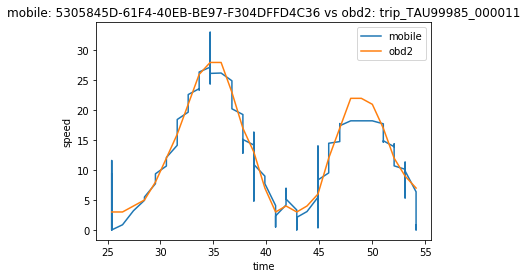

1494683921 25.391
1494684992 54.141


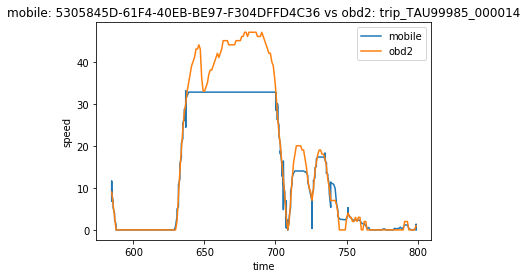

1494683921 584.702
1494684992 798.967


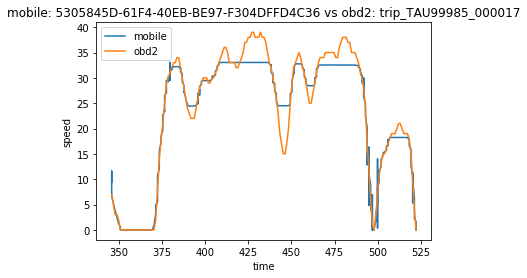

1494683921 346.016
1494684992 522.189


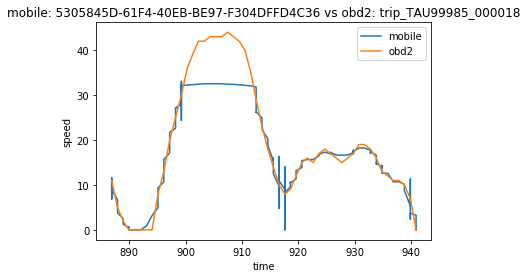

1494683921 886.924
1494684992 940.843


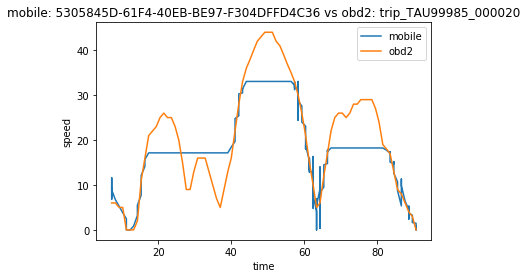

1494683921 7.225
1494684992 90.598


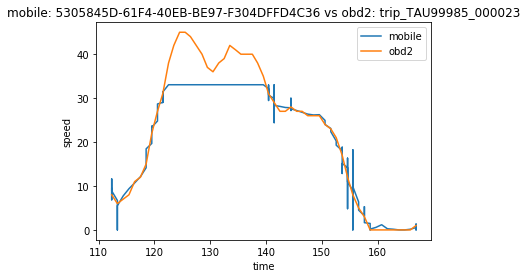

1494683921 112.343
1494684992 166.908


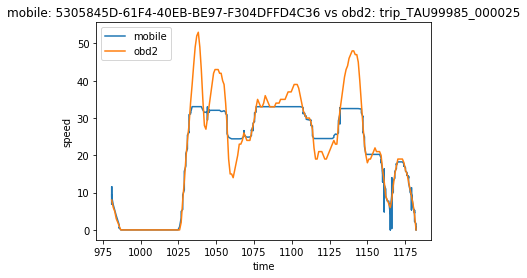

1494683921 980.857
1494684992 1182.233


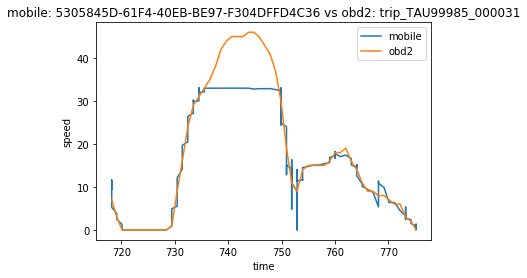

1494683921 718.207
1494684992 775.187


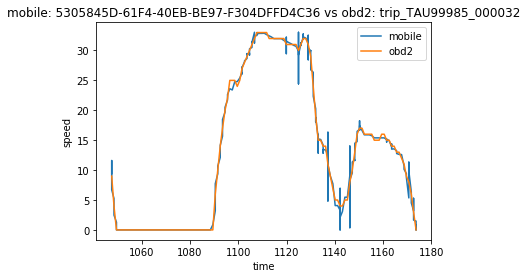

1494683921 1047.494
1494684992 1173.721


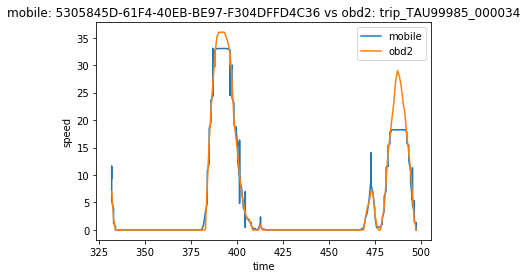

1494683921 331.989
1494684992 497.39


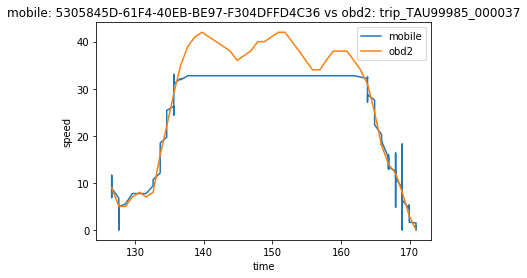

1494683921 126.578
1494684992 170.953


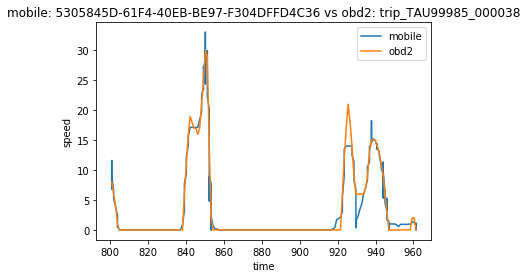

1494683921 800.701
1494684992 961.395


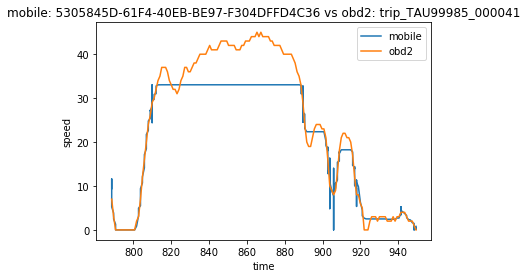

1494683921 788.493
1494684992 949.386


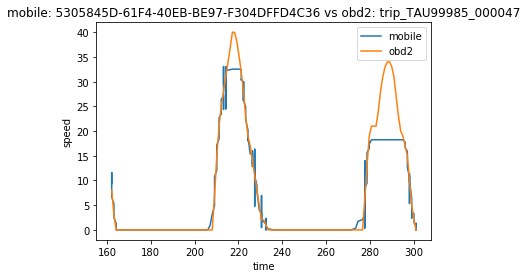

1494683921 162.173
1494684992 301.164


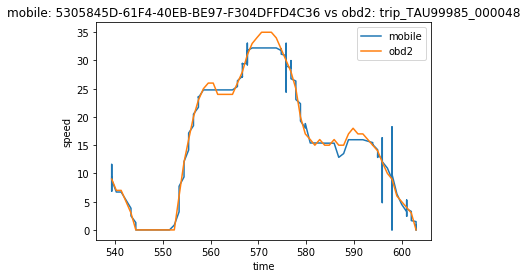

1494683921 539.261
1494684992 603.023


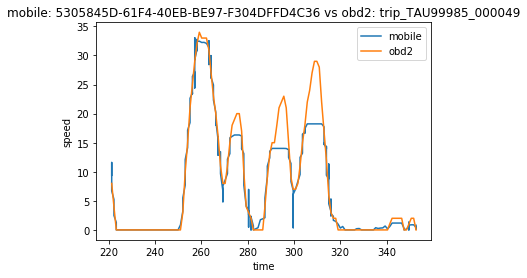

1494683921 221.339
1494684992 352.727


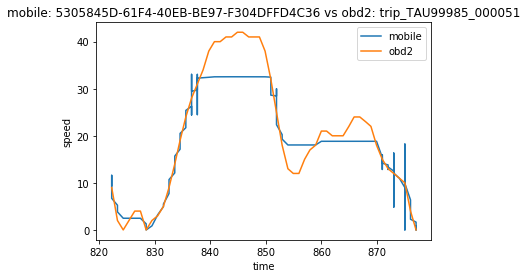

1494683921 822.249
1494684992 877.032


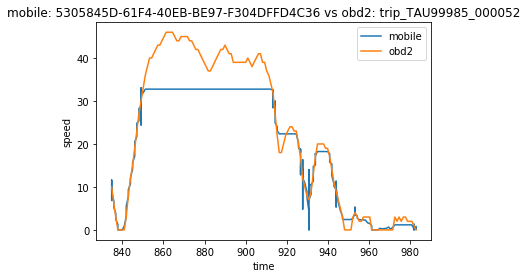

1494683921 834.875
1494684992 982.754


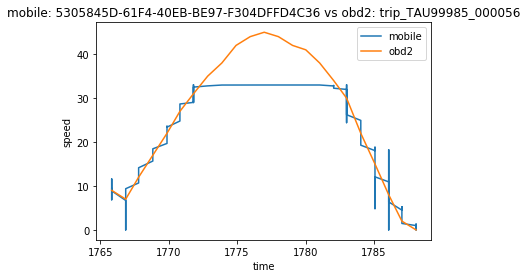

1494683921 1765.836
1494684992 1788.075


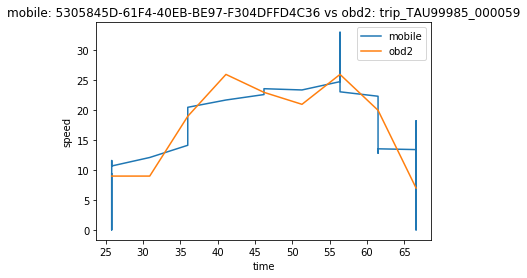

1494683921 25.798
1494684992 66.559


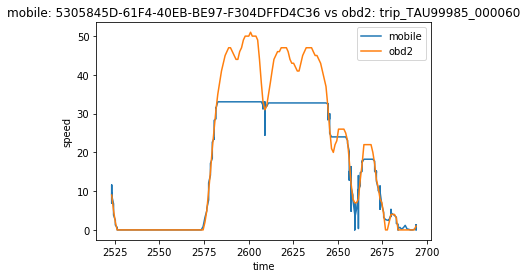

1494683921 2523.344
1494684992 2693.89


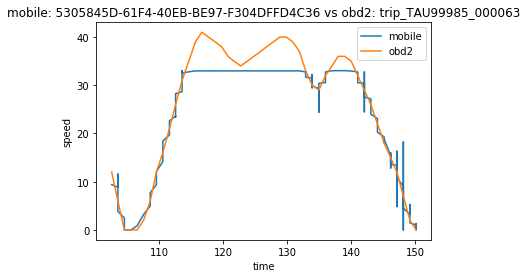

1494683921 102.577
1494684992 150.144


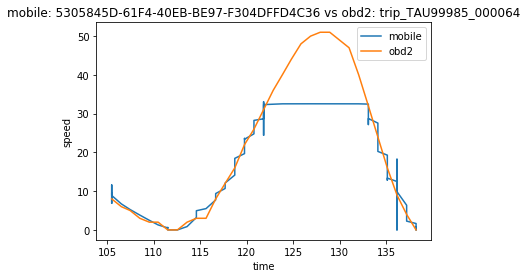

1494683921 105.507
1494684992 138.191


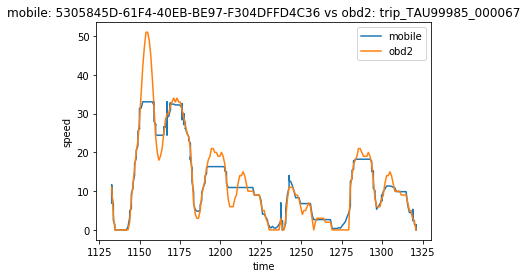

1494683921 1132.725
1494684992 1321.012


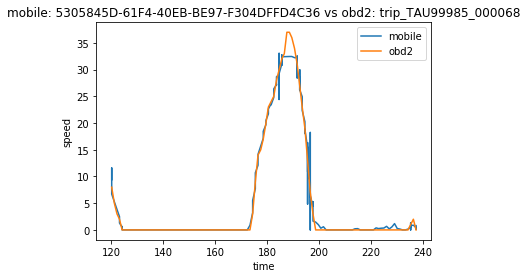

1494683921 120.153
1494684992 237.42


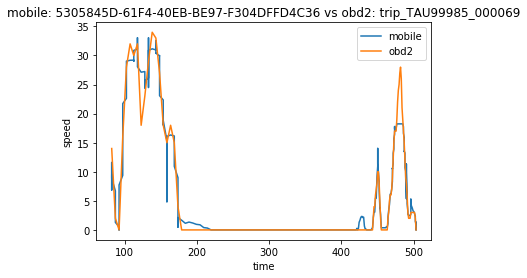

1494683921 81.965
1494684992 503.208


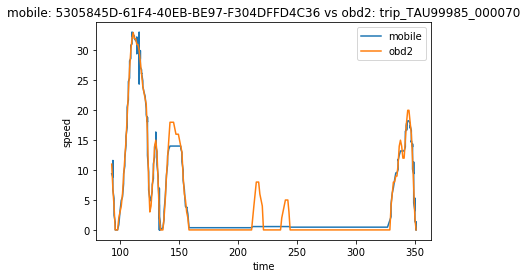

1494683921 92.821
1494684992 351.1


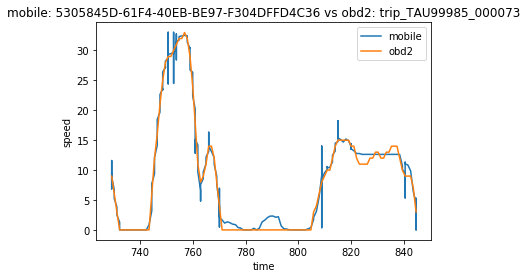

1494683921 729.33
1494684992 844.546


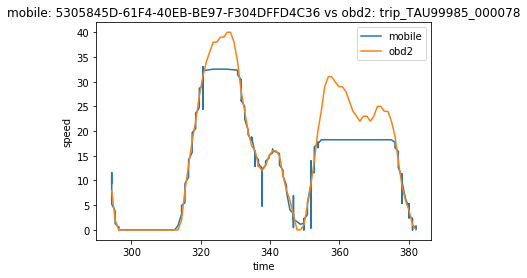

1494683921 294.294
1494684992 382.116


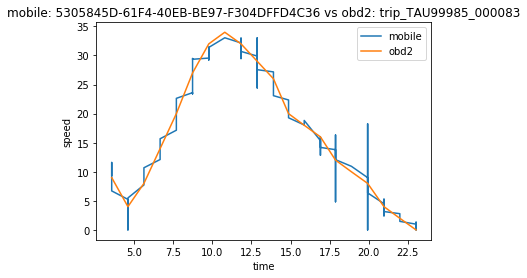

1494683921 3.568
1494684992 23.02


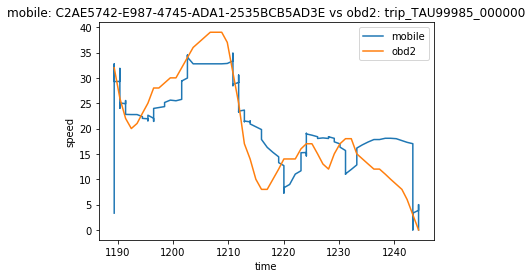

1494690662.0001 1189.351
1494691655.0001 1244.412


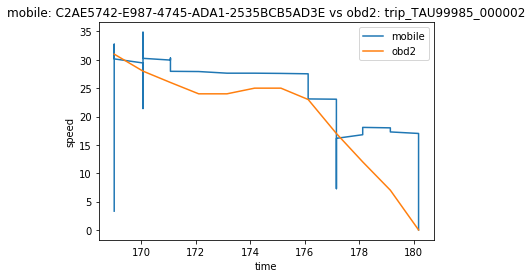

1494690662.0001 169.001
1494691655.0001 180.176


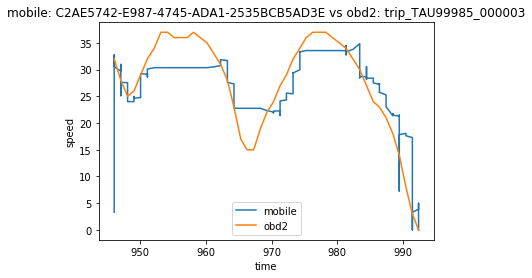

1494690662.0001 946.008
1494691655.0001 992.377


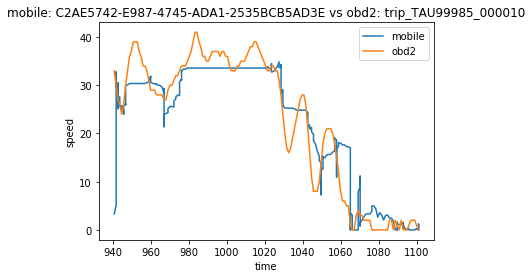

1494690662.0001 940.608
1494691655.0001 1100.959


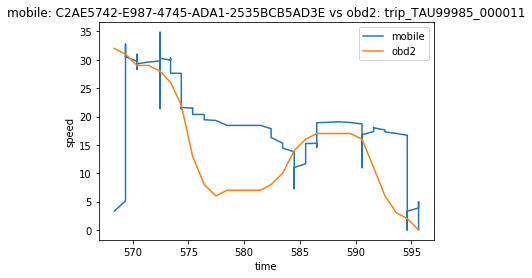

1494690662.0001 568.339
1494691655.0001 595.642


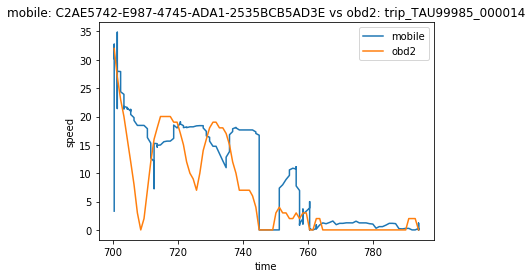

1494690662.0001 700.478
1494691655.0001 793.924


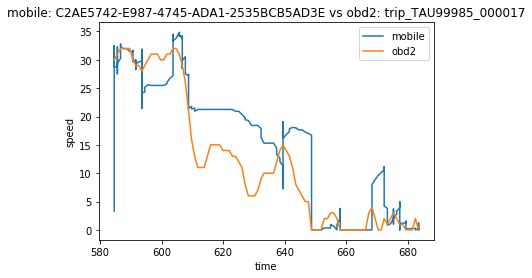

1494690662.0001 584.627
1494691655.0001 683.506


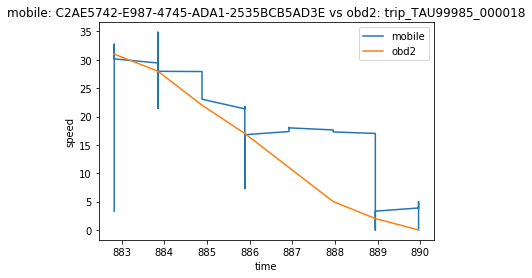

1494690662.0001 882.824
1494691655.0001 889.962


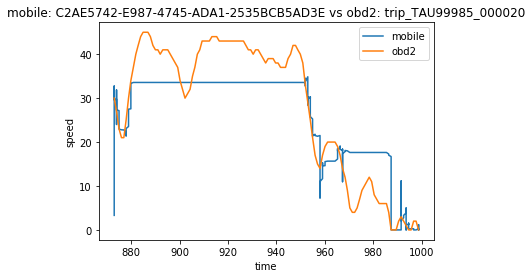

1494690662.0001 872.923
1494691655.0001 998.784


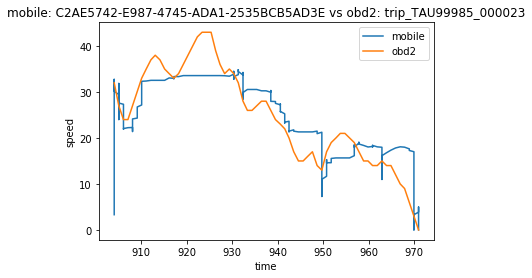

1494690662.0001 904.012
1494691655.0001 970.948


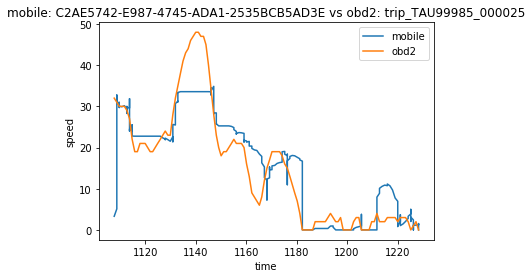

1494690662.0001 1107.585
1494691655.0001 1228.348


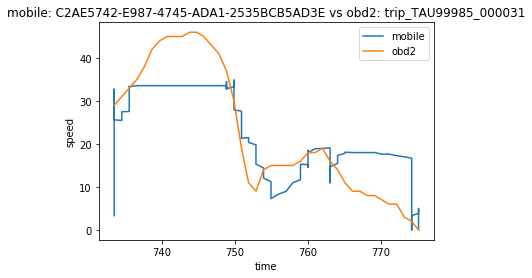

1494690662.0001 733.493
1494691655.0001 775.187


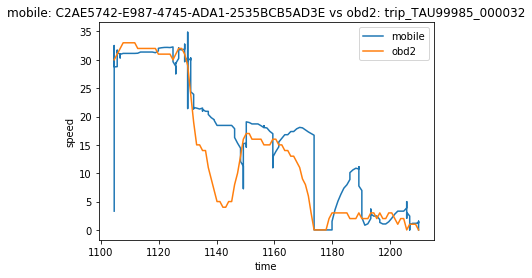

1494690662.0001 1104.642
1494691655.0001 1209.828


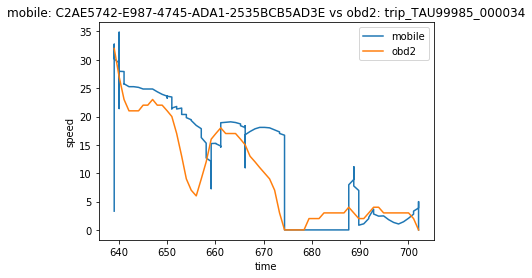

1494690662.0001 639.061
1494691655.0001 702.102


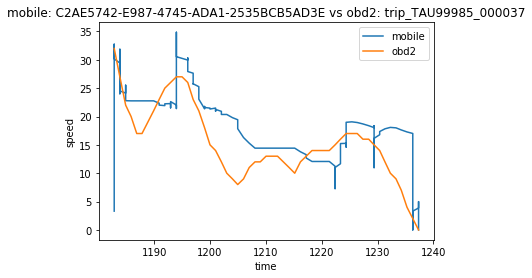

1494690662.0001 1182.841
1494691655.0001 1237.349


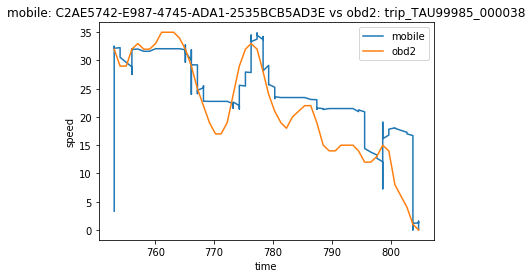

1494690662.0001 753.018
1494691655.0001 804.718


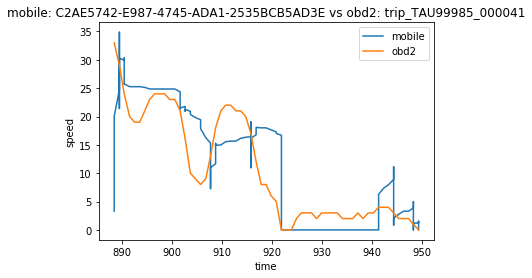

1494690662.0001 888.539
1494691655.0001 949.386


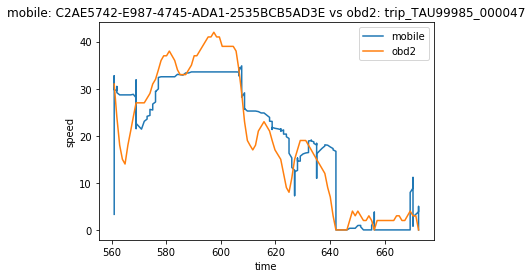

1494690662.0001 560.983
1494691655.0001 672.397


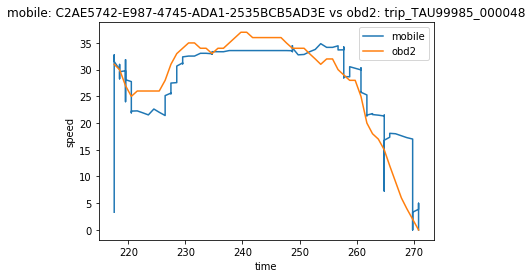

1494690662.0001 217.506
1494691655.0001 270.874


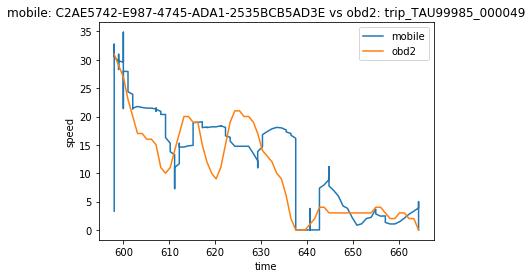

1494690662.0001 597.99
1494691655.0001 664.254


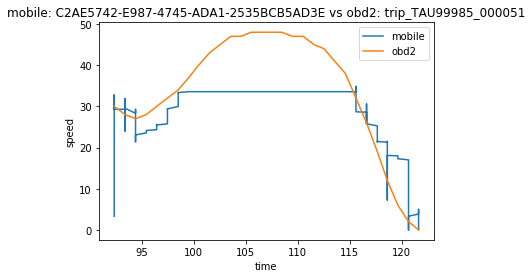

1494690662.0001 92.358
1494691655.0001 121.606


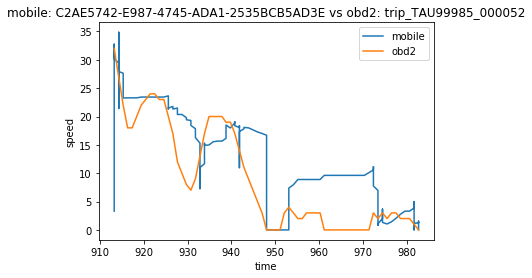

1494690662.0001 913.232
1494691655.0001 982.754


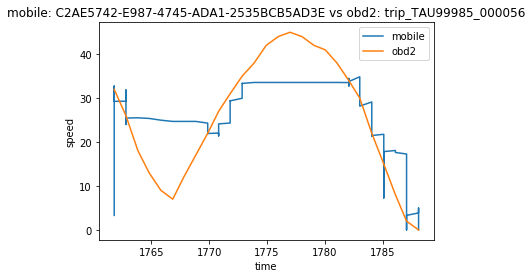

1494690662.0001 1761.805
1494691655.0001 1788.075


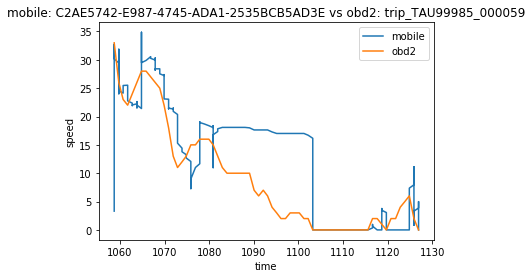

1494690662.0001 1058.7
1494691655.0001 1126.917


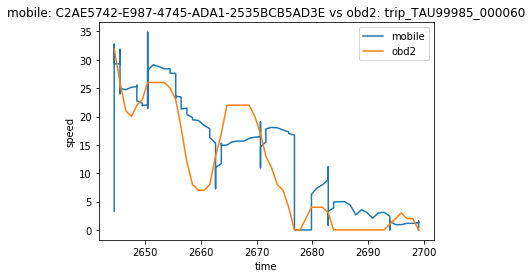

1494690662.0001 2644.432
1494691655.0001 2699.057


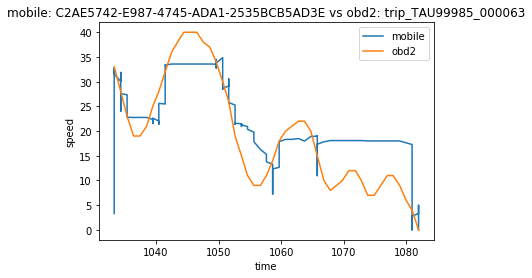

1494690662.0001 1033.312
1494691655.0001 1081.929


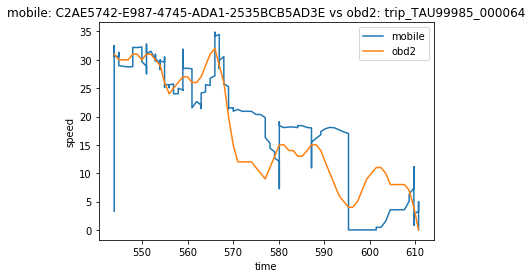

1494690662.0001 543.871
1494691655.0001 610.745


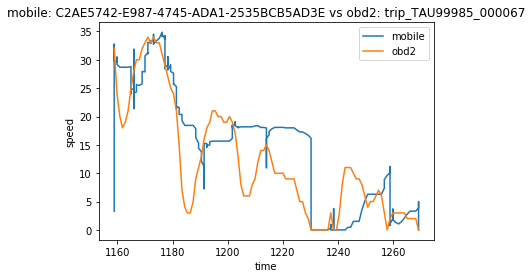

1494690662.0001 1158.89
1494691655.0001 1269.078


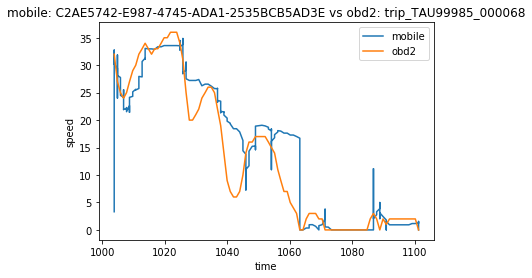

1494690662.0001 1003.747
1494691655.0001 1101.148


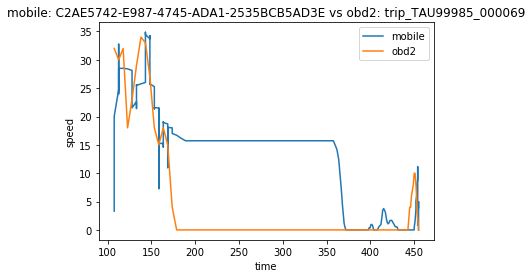

1494690662.0001 107.428
1494691655.0001 455.113


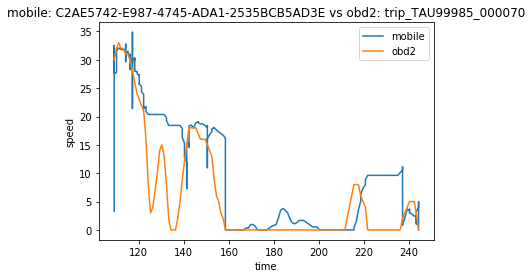

1494690662.0001 109.038
1494691655.0001 244.231


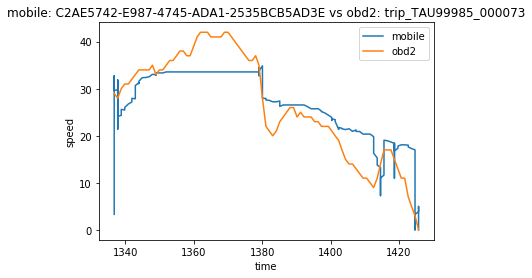

1494690662.0001 1336.759
1494691655.0001 1425.707


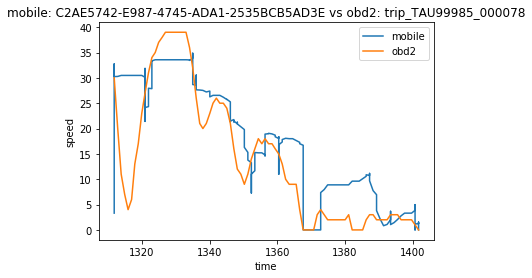

1494690662.0001 1311.818
1494691655.0001 1401.694


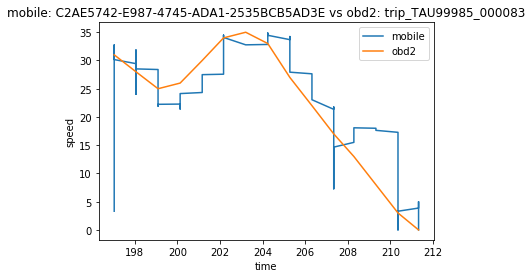

1494690662.0001 197.032
1494691655.0001 211.319


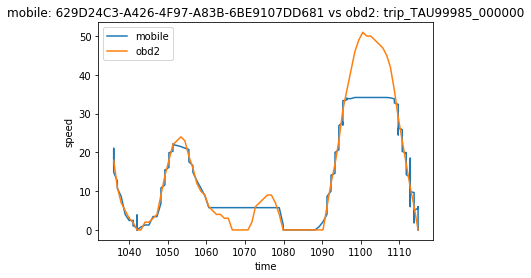

1494700273.9997 1035.989
1494701720.0002 1114.849


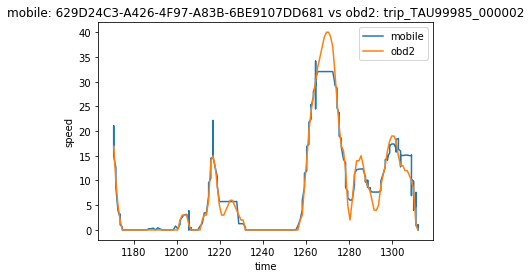

1494700273.9997 1170.706
1494701720.0002 1311.954


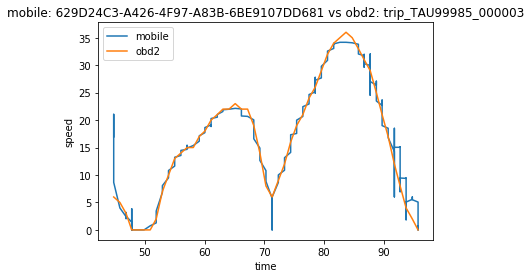

1494700273.9997 44.77
1494701720.0002 95.715


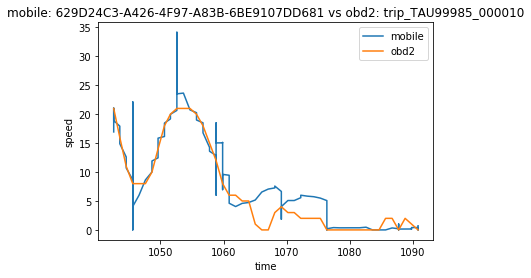

1494700273.9997 1042.599
1494701720.0002 1090.793


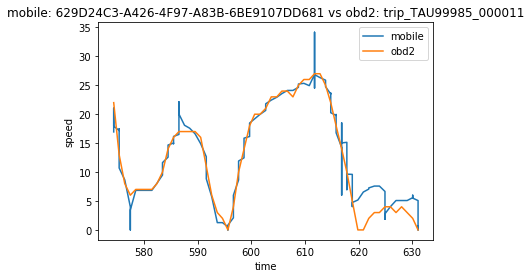

1494700273.9997 574.358
1494701720.0002 631.079


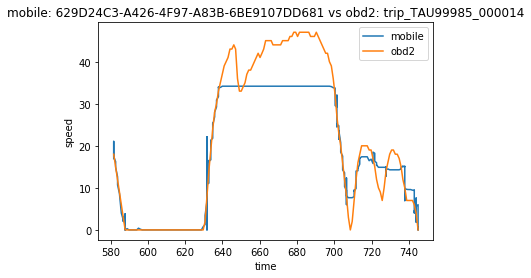

1494700273.9997 581.625
1494701720.0002 744.992


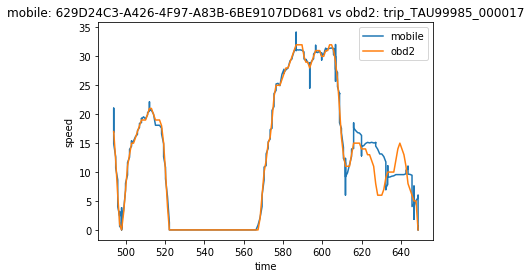

1494700273.9997 493.869
1494701720.0002 648.738


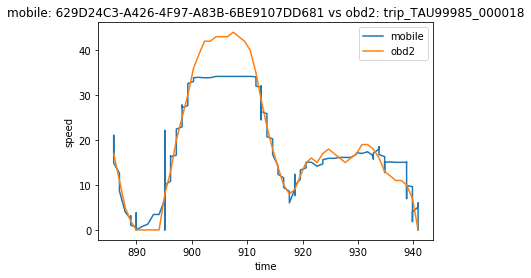

1494700273.9997 885.887
1494701720.0002 940.843


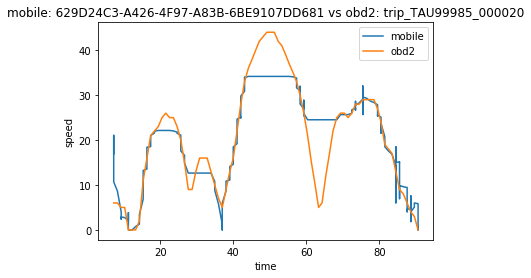

1494700273.9997 7.225
1494701720.0002 90.598


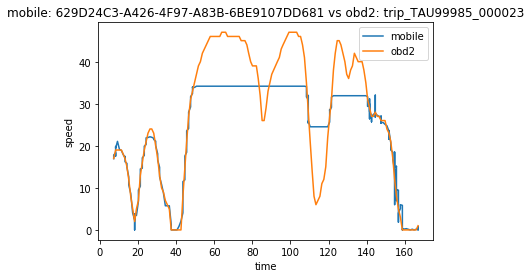

1494700273.9997 7.316
1494701720.0002 166.908


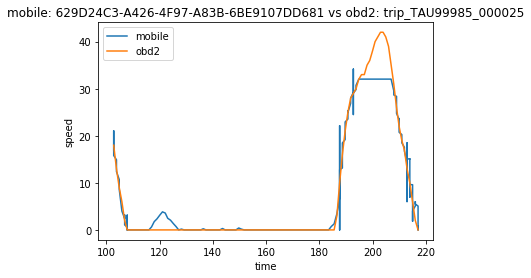

1494700273.9997 102.812
1494701720.0002 217.008


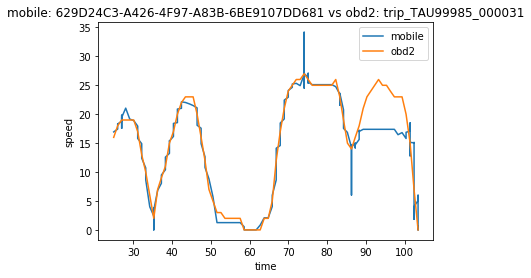

1494700273.9997 24.949
1494701720.0002 103.462


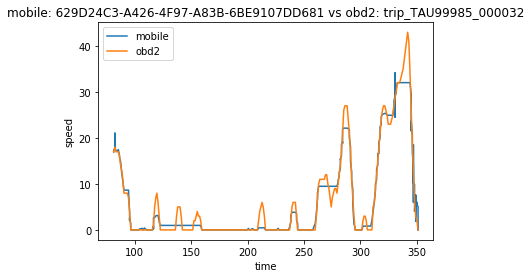

1494700273.9997 81.33
1494701720.0002 351.133


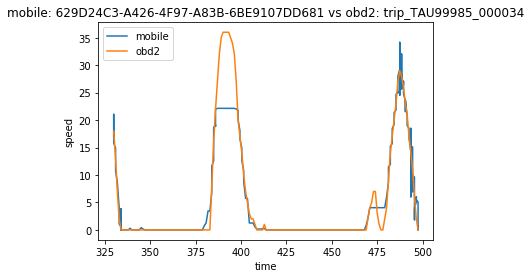

1494700273.9997 329.987
1494701720.0002 497.39


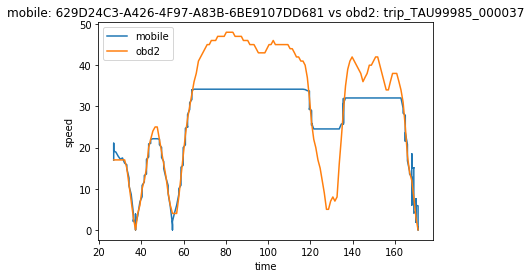

1494700273.9997 26.938
1494701720.0002 170.953


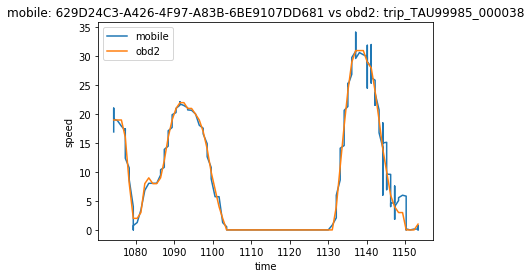

1494700273.9997 1074.188
1494701720.0002 1153.4


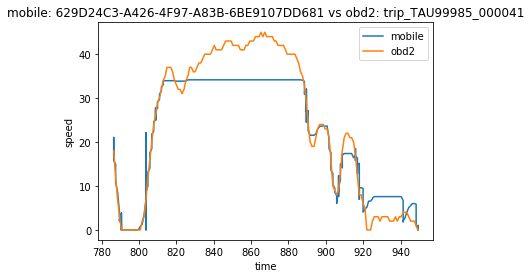

1494700273.9997 786.416
1494701720.0002 949.386


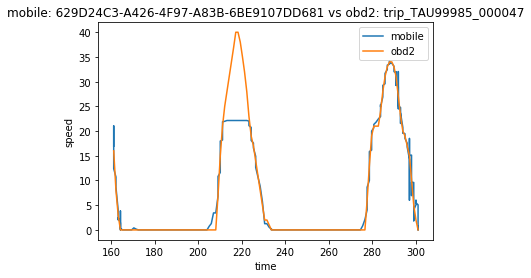

1494700273.9997 161.137
1494701720.0002 301.164


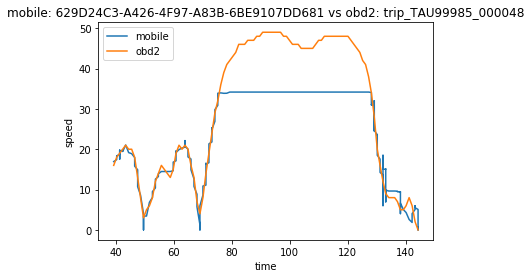

1494700273.9997 39.132
1494701720.0002 144.305


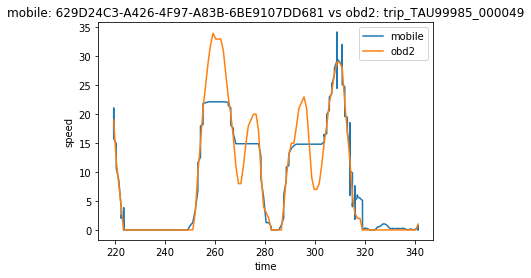

1494700273.9997 219.322
1494701720.0002 341.351


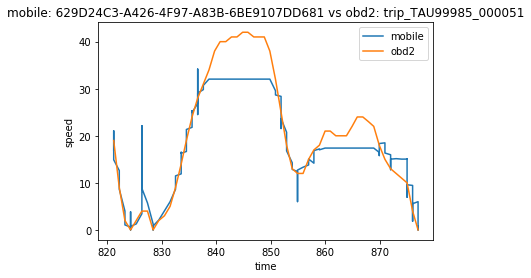

1494700273.9997 821.227
1494701720.0002 877.032


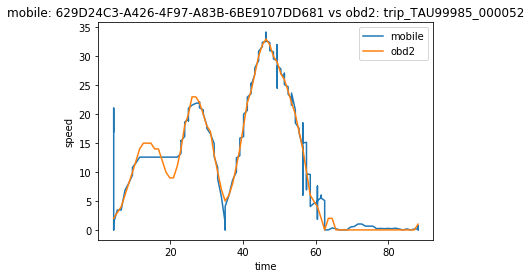

1494700273.9997 4.439
1494701720.0002 88.178


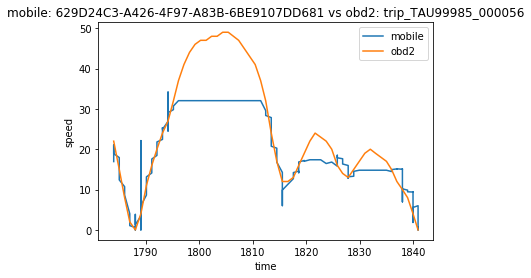

1494700273.9997 1784.036
1494701720.0002 1840.902


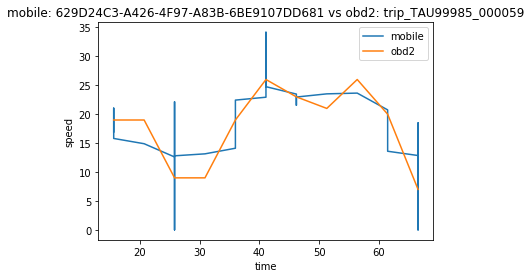

1494700273.9997 15.613
1494701720.0002 66.559


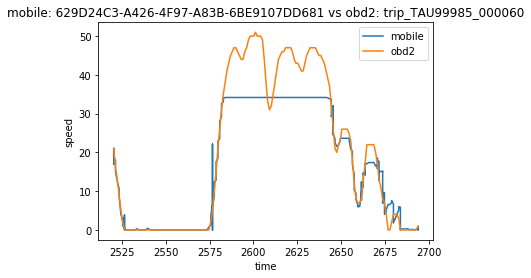

1494700273.9997 2520.266
1494701720.0002 2693.89


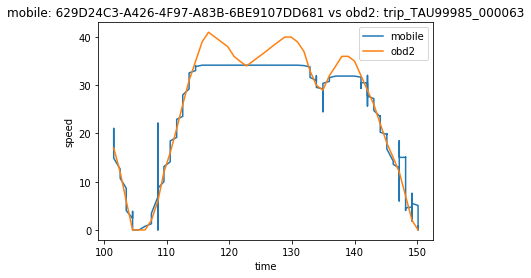

1494700273.9997 101.541
1494701720.0002 150.144


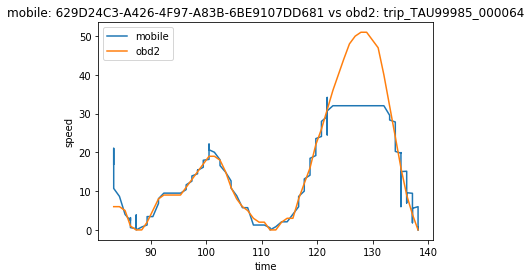

1494700273.9997 83.35
1494701720.0002 138.191


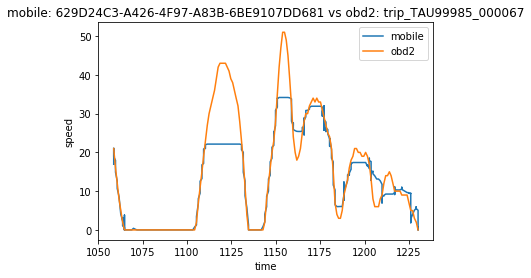

1494700273.9997 1058.773
1494701720.0002 1230.161


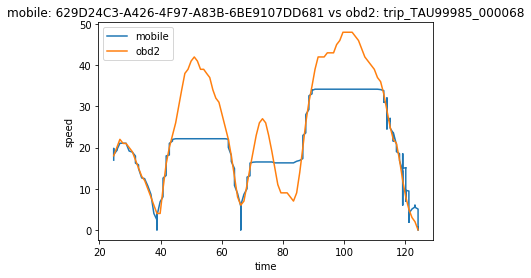

1494700273.9997 24.708
1494701720.0002 124.171


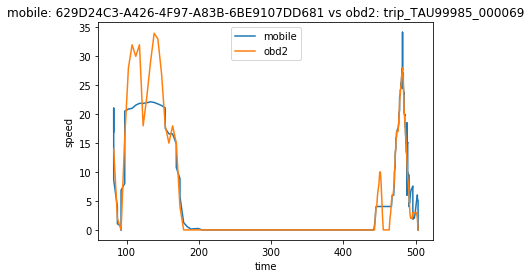

1494700273.9997 81.965
1494701720.0002 503.208


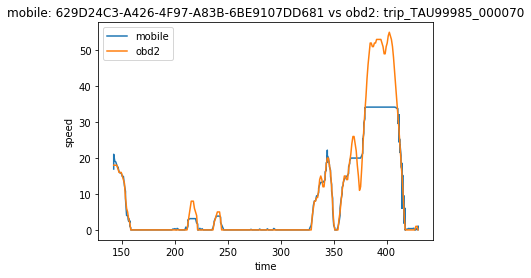

1494700273.9997 142.283
1494701720.0002 429.772


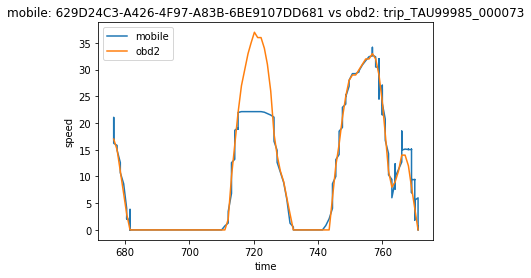

1494700273.9997 676.442
1494701720.0002 771.129


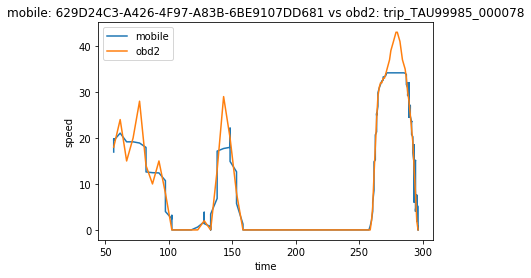

1494700273.9997 56.496
1494701720.0002 296.314


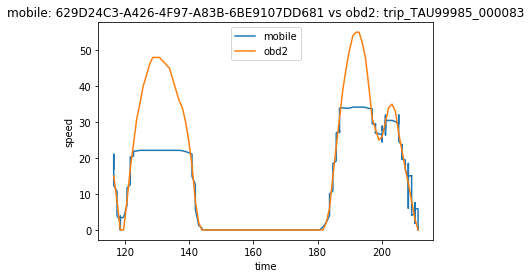

1494700273.9997 116.464
1494701720.0002 211.319


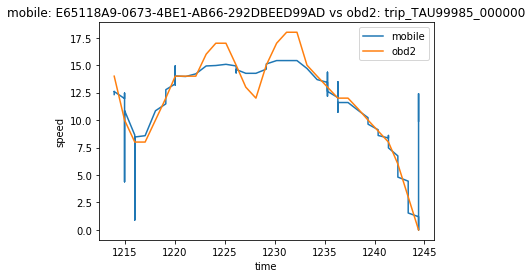

1494727222.9999 1213.936
1494727708.0001 1244.412


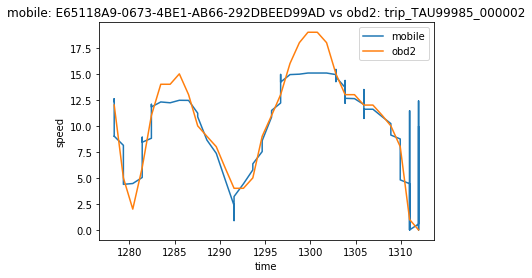

1494727222.9999 1278.324
1494727708.0001 1311.954


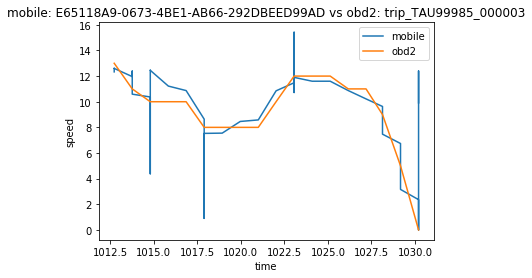

1494727222.9999 1012.722
1494727708.0001 1030.204


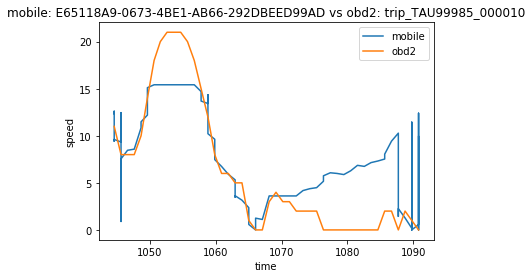

1494727222.9999 1044.579
1494727708.0001 1090.793


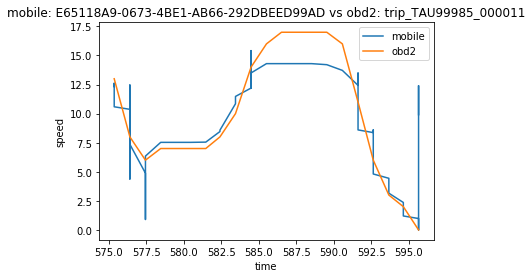

1494727222.9999 575.373
1494727708.0001 595.642


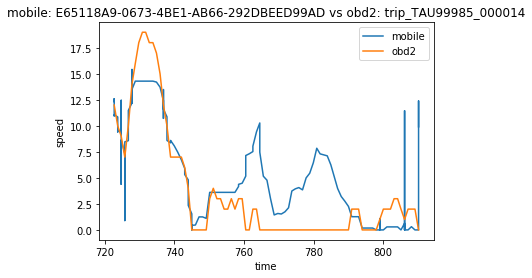

1494727222.9999 722.708
1494727708.0001 810.111


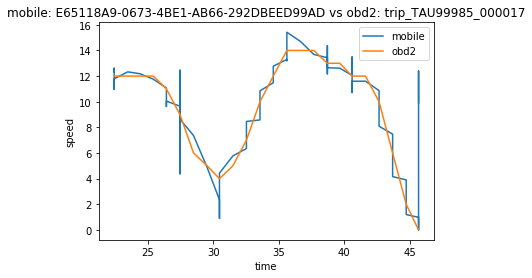

1494727222.9999 22.438
1494727708.0001 45.682


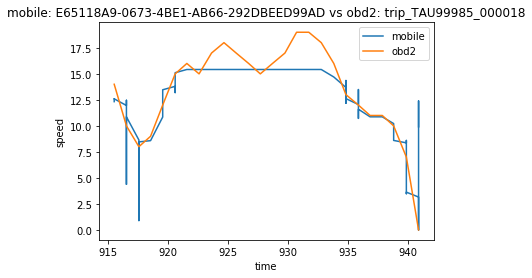

1494727222.9999 915.553
1494727708.0001 940.843


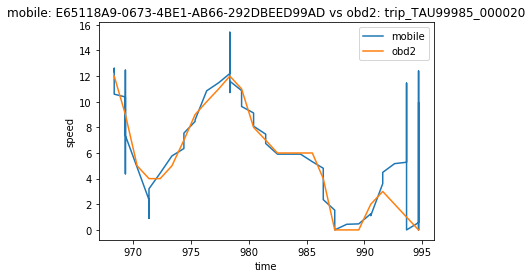

1494727222.9999 968.385
1494727708.0001 994.674


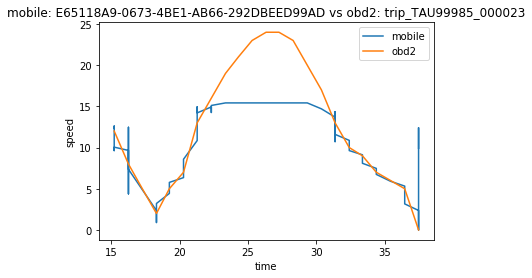

1494727222.9999 15.202
1494727708.0001 37.487


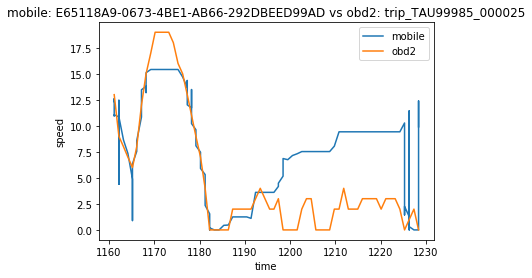

1494727222.9999 1161.154
1494727708.0001 1228.348


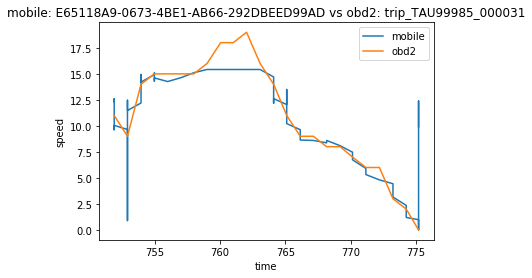

1494727222.9999 751.899
1494727708.0001 775.187


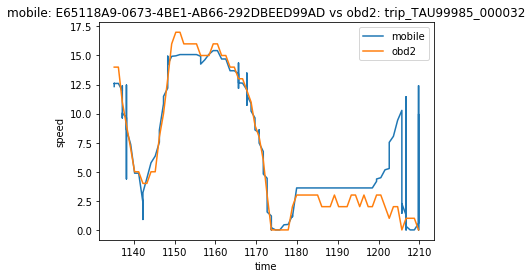

1494727222.9999 1135.174
1494727708.0001 1209.828


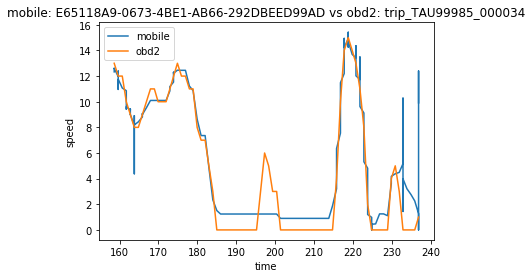

1494727222.9999 158.635
1494727708.0001 236.824


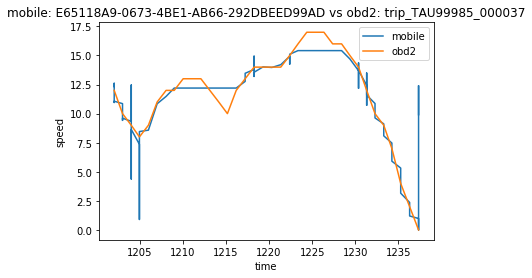

1494727222.9999 1202.035
1494727708.0001 1237.349


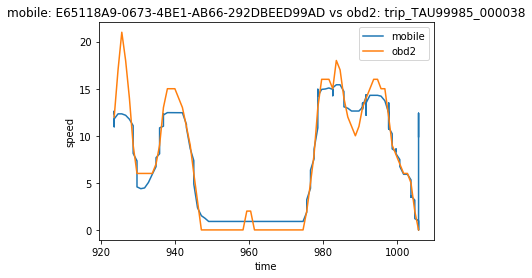

1494727222.9999 923.473
1494727708.0001 1005.762


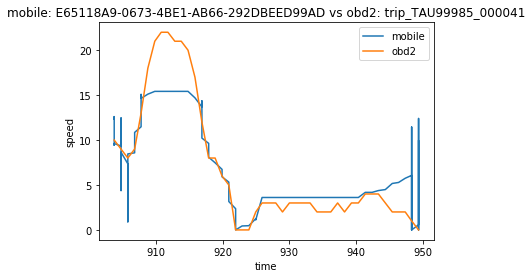

1494727222.9999 903.769
1494727708.0001 949.386


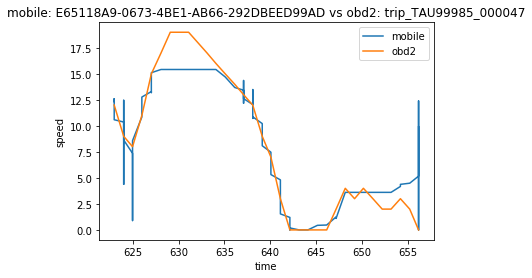

1494727222.9999 622.972
1494727708.0001 656.189


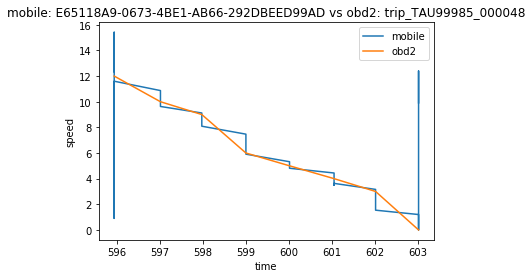

1494727222.9999 595.942
1494727708.0001 603.023


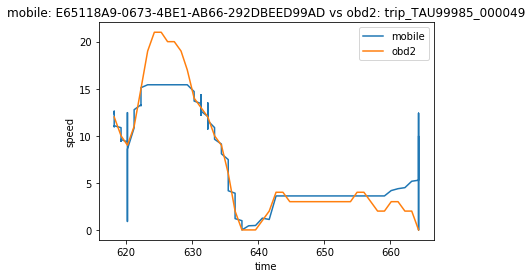

1494727222.9999 618.168
1494727708.0001 664.254


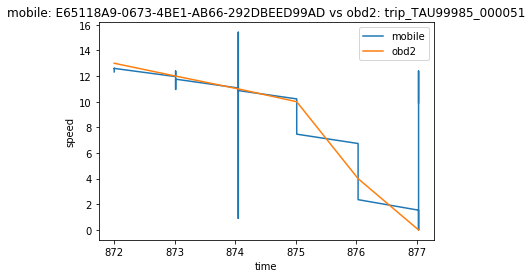

1494727222.9999 871.999
1494727708.0001 877.032


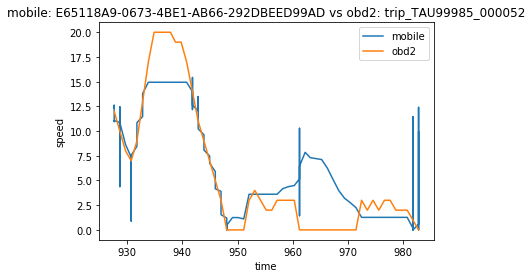

1494727222.9999 927.67
1494727708.0001 982.754


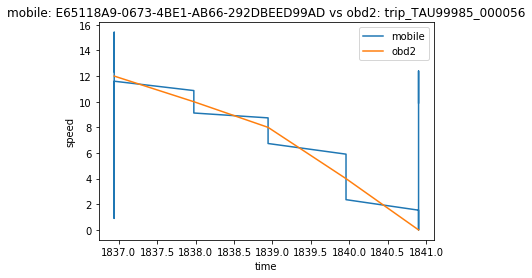

1494727222.9999 1836.942
1494727708.0001 1840.902


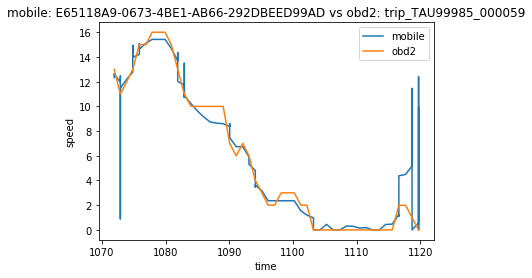

1494727222.9999 1071.929
1494727708.0001 1119.698


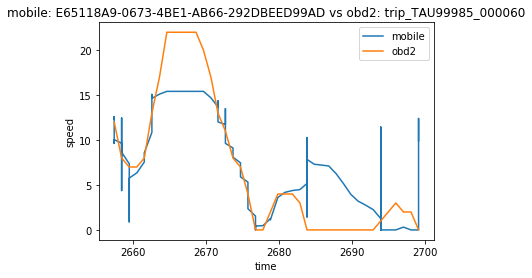

1494727222.9999 2657.475
1494727708.0001 2699.057


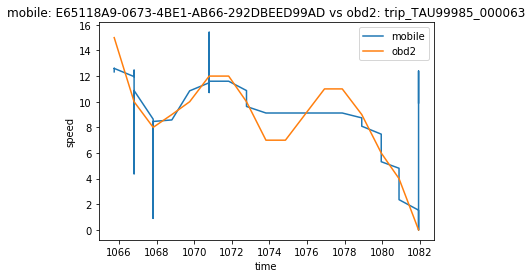

1494727222.9999 1065.751
1494727708.0001 1081.929


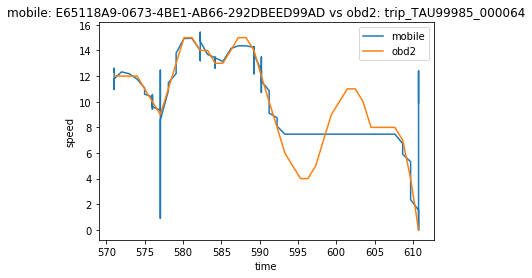

1494727222.9999 571.033
1494727708.0001 610.745


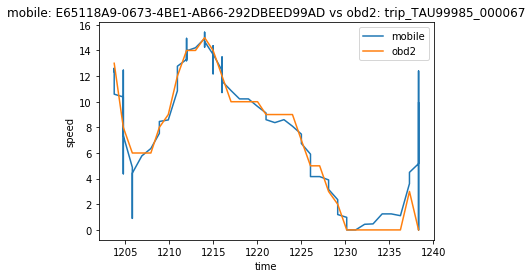

1494727222.9999 1203.717
1494727708.0001 1238.332


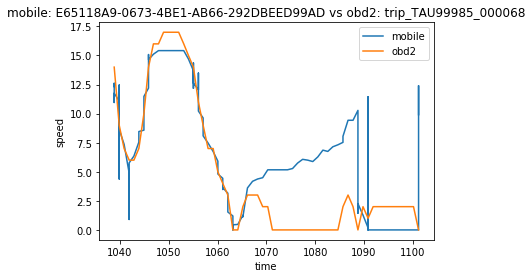

1494727222.9999 1038.858
1494727708.0001 1101.148


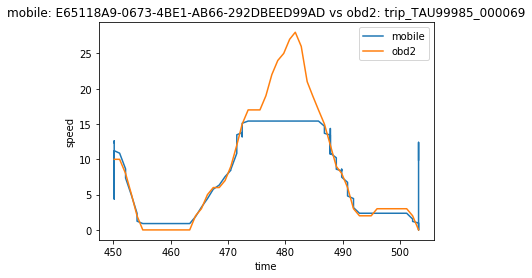

1494727222.9999 450.13
1494727708.0001 503.208


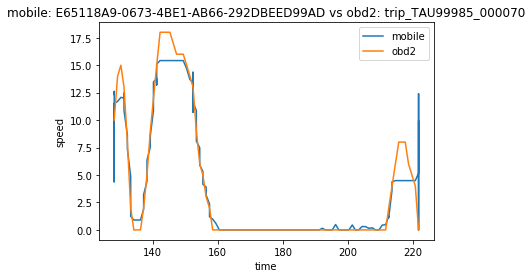

1494727222.9999 128.201
1494727708.0001 221.616


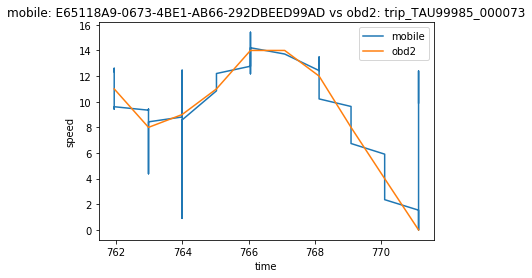

1494727222.9999 761.944
1494727708.0001 771.129


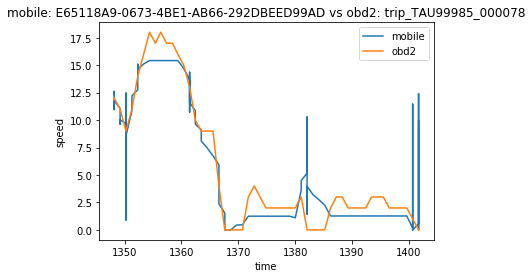

1494727222.9999 1348.173
1494727708.0001 1401.694


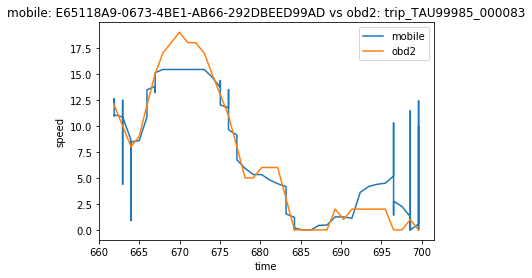

1494727222.9999 661.906
1494727708.0001 699.605


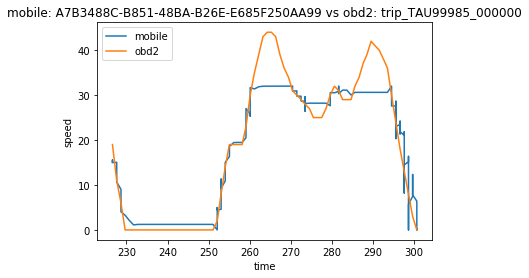

1494787811.0002 226.583
1494788789.9996 300.682


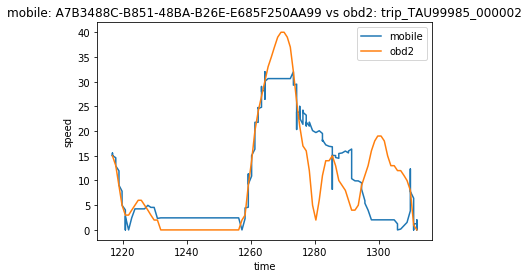

1494787811.0002 1216.735
1494788789.9996 1311.954


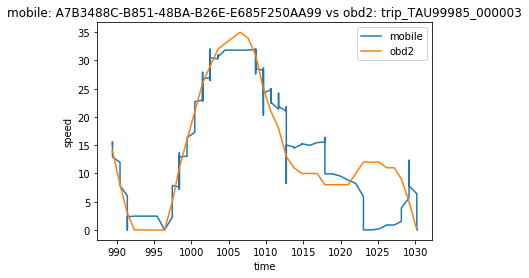

1494787811.0002 989.438
1494788789.9996 1030.204


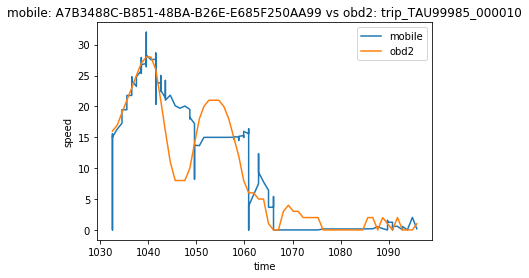

1494787811.0002 1032.56
1494788789.9996 1095.847


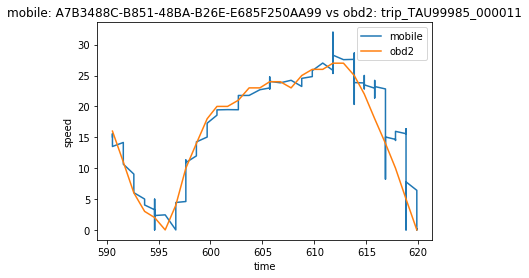

1494787811.0002 590.567
1494788789.9996 619.859


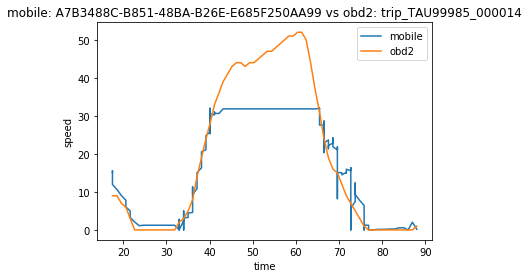

1494787811.0002 17.518
1494788789.9996 87.995


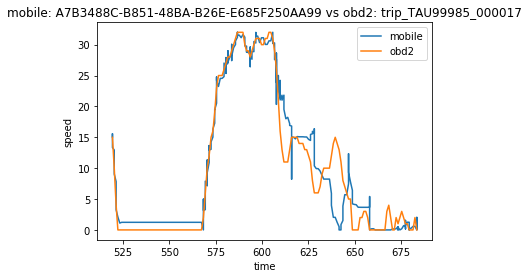

1494787811.0002 519.264
1494788789.9996 683.506


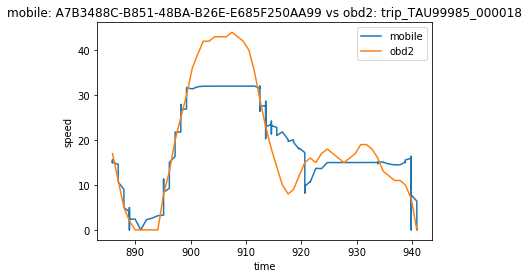

1494787811.0002 885.887
1494788789.9996 940.843


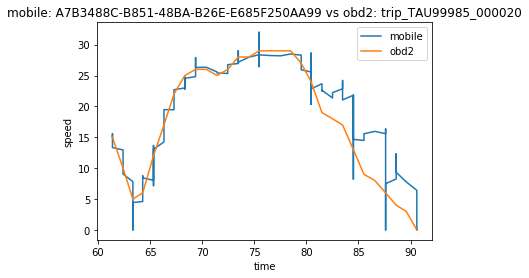

1494787811.0002 61.383
1494788789.9996 90.598


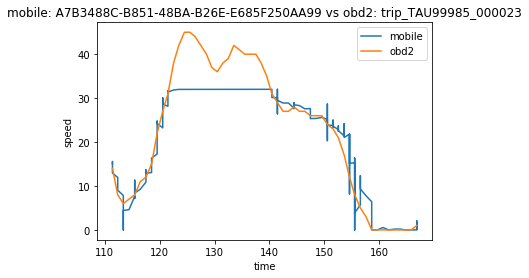

1494787811.0002 111.378
1494788789.9996 166.908


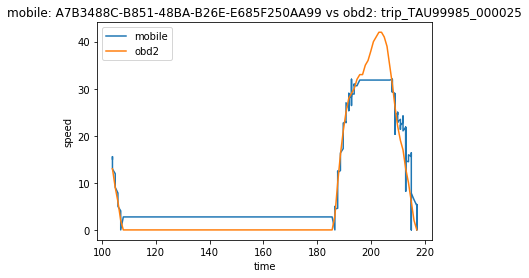

1494787811.0002 103.848
1494788789.9996 217.008


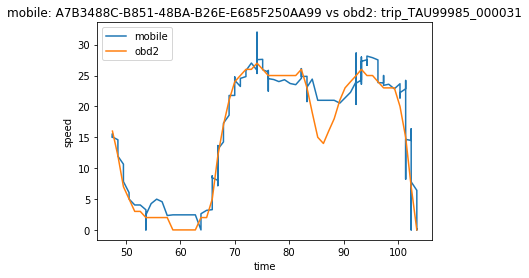

1494787811.0002 47.495
1494788789.9996 103.462


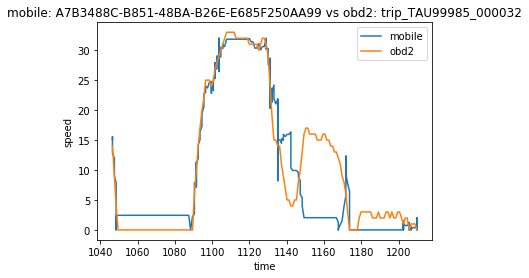

1494787811.0002 1046.456
1494788789.9996 1209.828


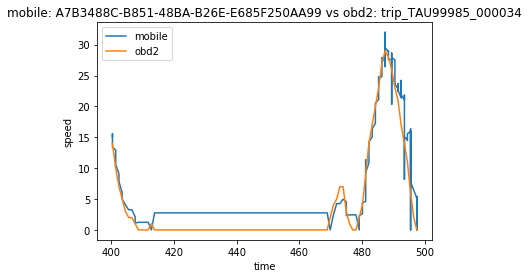

1494787811.0002 400.446
1494788789.9996 497.39


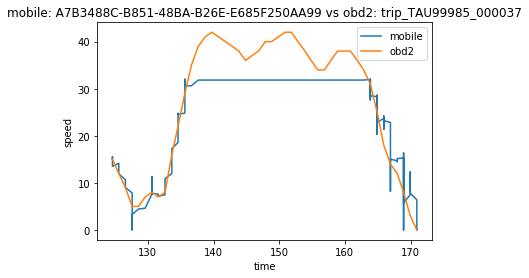

1494787811.0002 124.611
1494788789.9996 170.953


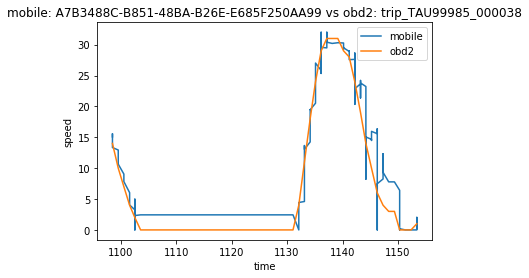

1494787811.0002 1098.511
1494788789.9996 1153.4


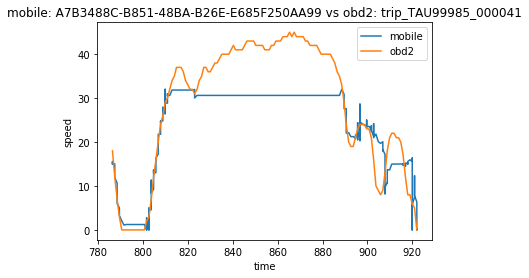

1494787811.0002 786.416
1494788789.9996 921.969


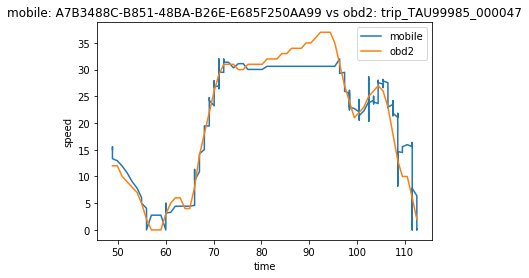

1494787811.0002 48.854
1494788789.9996 112.514


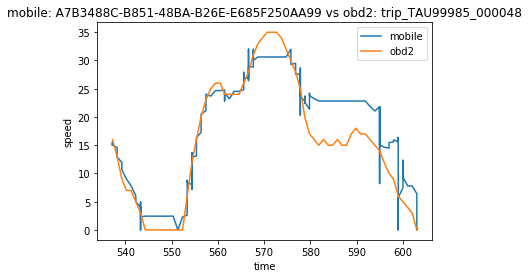

1494787811.0002 537.222
1494788789.9996 603.023


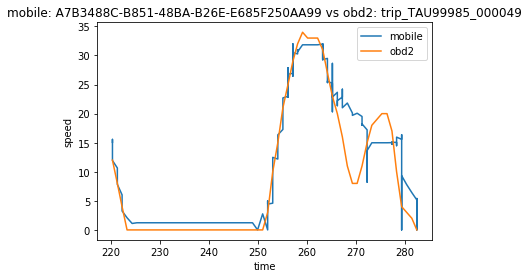

1494787811.0002 220.338
1494788789.9996 282.499


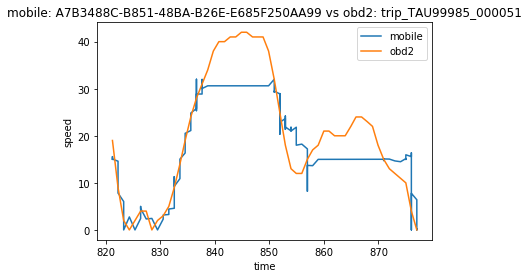

1494787811.0002 821.227
1494788789.9996 877.032


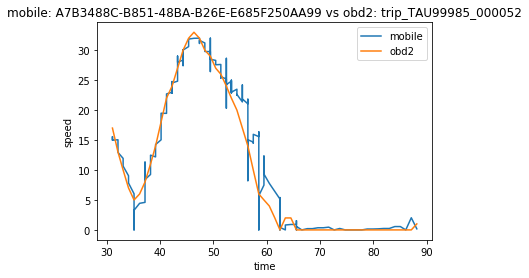

1494787811.0002 31.047
1494788789.9996 88.178


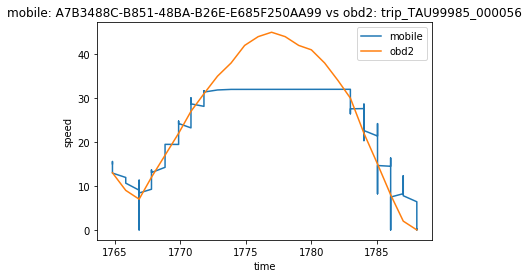

1494787811.0002 1764.821
1494788789.9996 1788.075


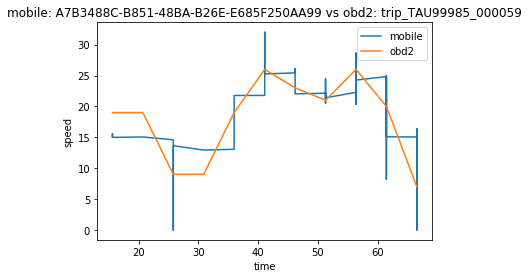

1494787811.0002 15.613
1494788789.9996 66.559


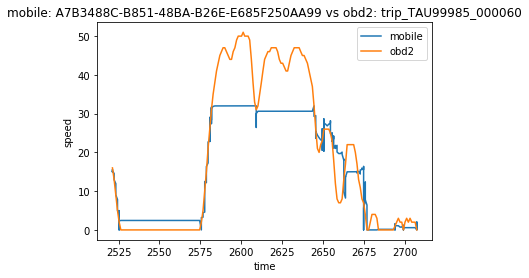

1494787811.0002 2521.292
1494788789.9996 2707.229


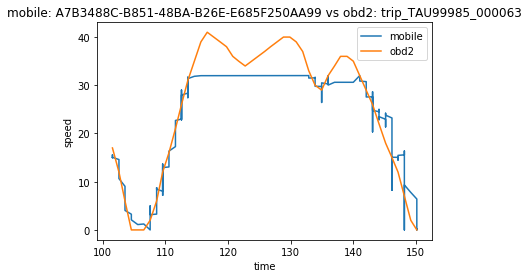

1494787811.0002 101.541
1494788789.9996 150.144


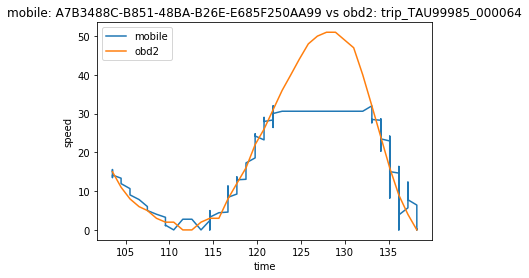

1494787811.0002 103.509
1494788789.9996 138.191


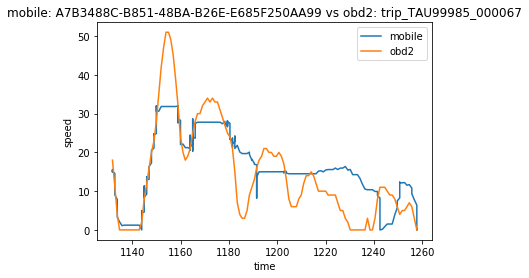

1494787811.0002 1131.741
1494788789.9996 1257.719


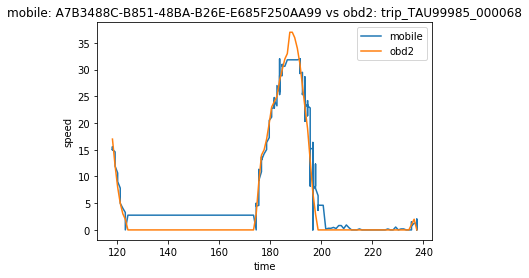

1494787811.0002 118.112
1494788789.9996 237.42


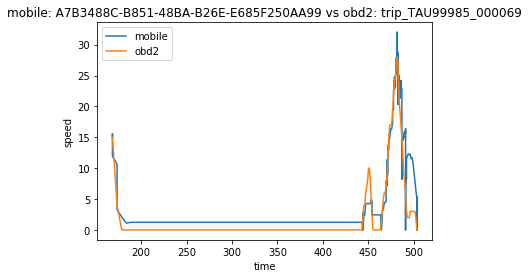

1494787811.0002 168.582
1494788789.9996 503.208


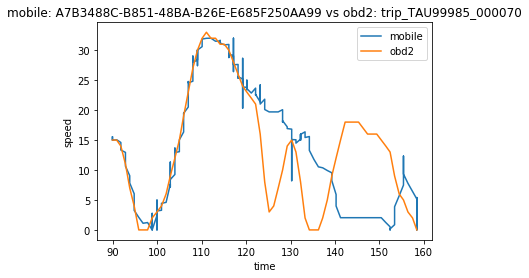

1494787811.0002 89.896
1494788789.9996 158.422


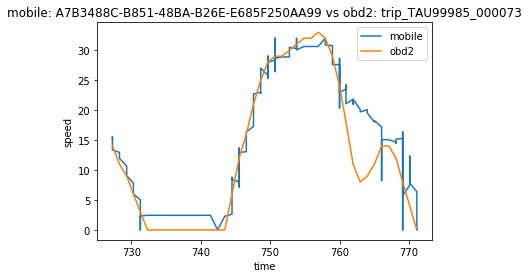

1494787811.0002 727.278
1494788789.9996 771.129


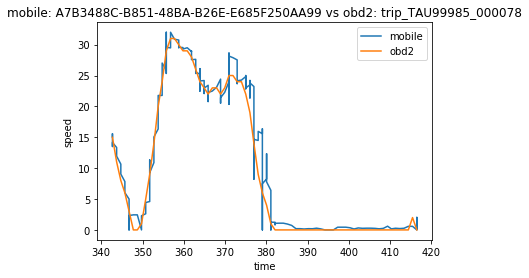

1494787811.0002 342.704
1494788789.9996 416.479


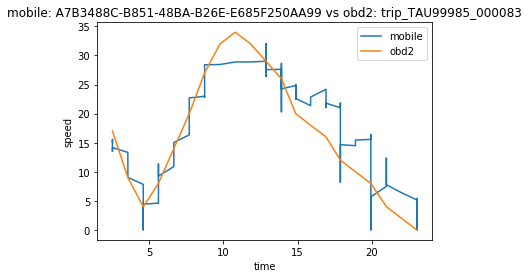

1494787811.0002 2.531
1494788789.9996 23.02


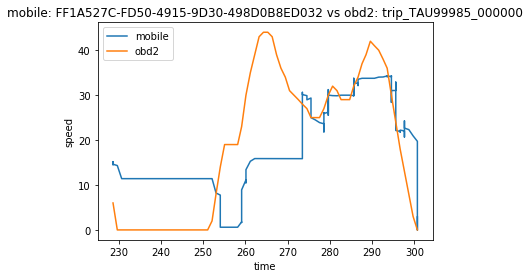

1494792475.9997 228.657
1494793295.0001 300.682


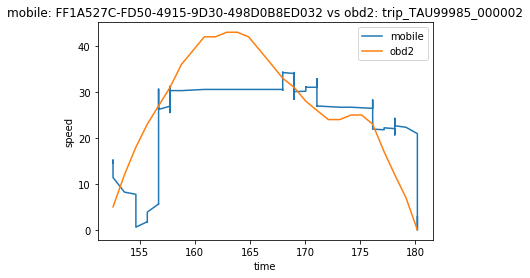

1494792475.9997 152.574
1494793295.0001 180.176


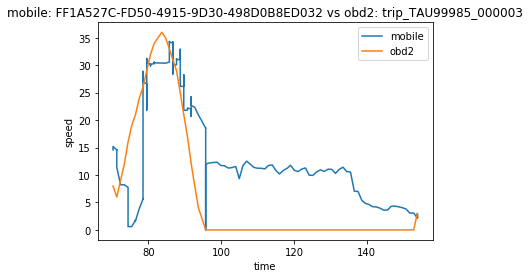

1494792475.9997 70.254
1494793295.0001 153.892


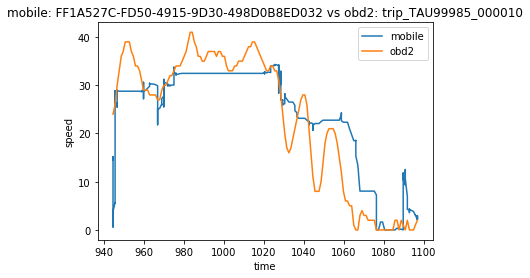

1494792475.9997 944.555
1494793295.0001 1096.85


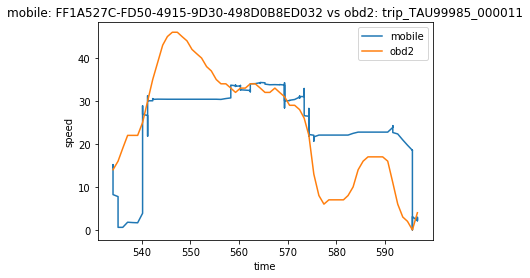

1494792475.9997 534.097
1494793295.0001 596.664


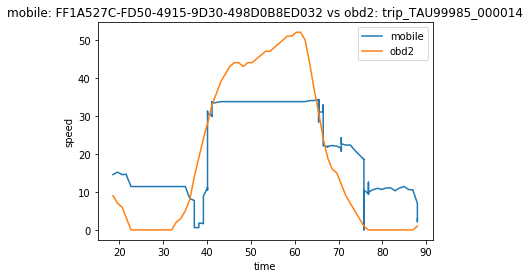

1494792475.9997 18.554
1494793295.0001 87.995


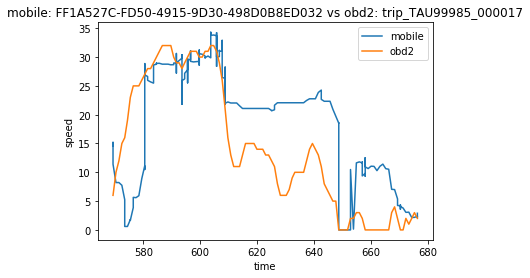

1494792475.9997 569.359
1494793295.0001 676.38


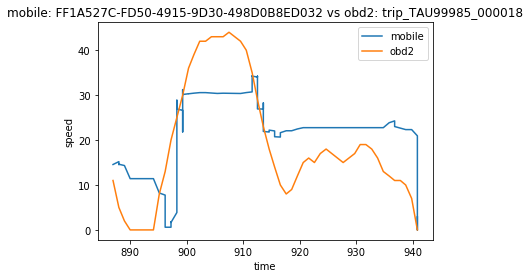

1494792475.9997 886.924
1494793295.0001 940.843


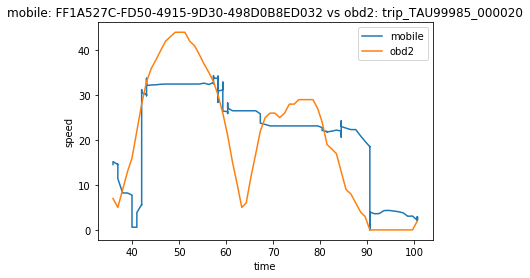

1494792475.9997 35.937
1494793295.0001 100.716


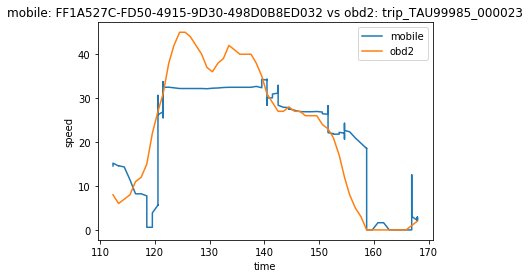

1494792475.9997 112.343
1494793295.0001 167.944


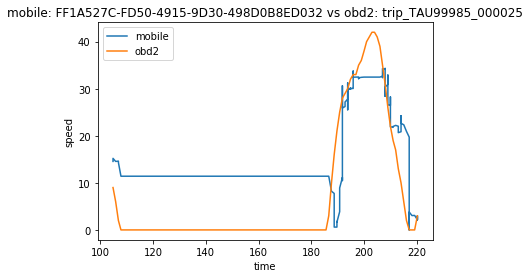

1494792475.9997 104.884
1494793295.0001 220.103


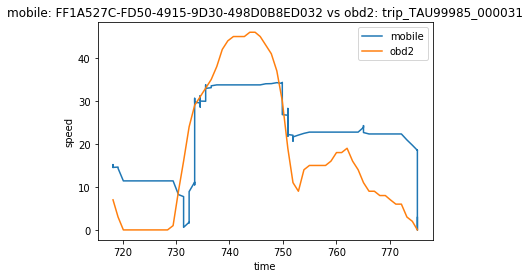

1494792475.9997 718.207
1494793295.0001 775.187


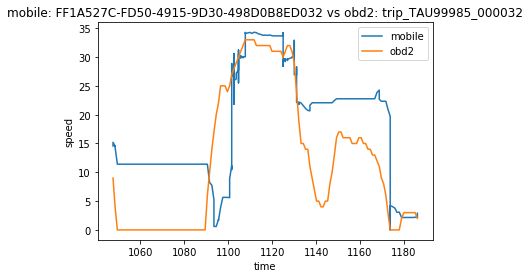

1494792475.9997 1047.494
1494793295.0001 1186.095


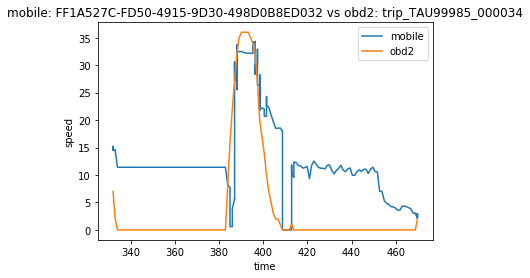

1494792475.9997 331.989
1494793295.0001 469.789


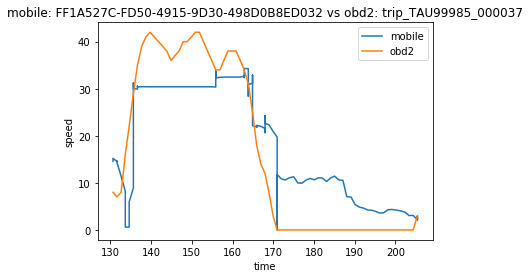

1494792475.9997 130.631
1494793295.0001 205.403


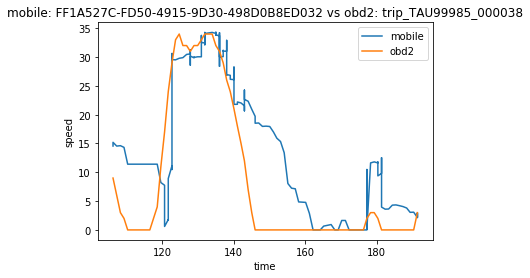

1494792475.9997 106.182
1494793295.0001 191.451


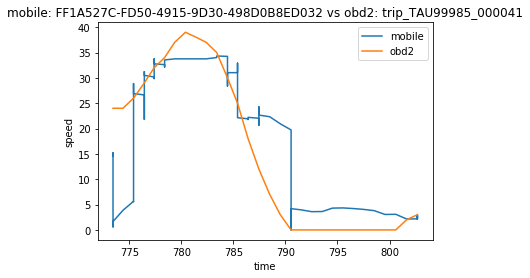

1494792475.9997 773.44
1494793295.0001 802.677


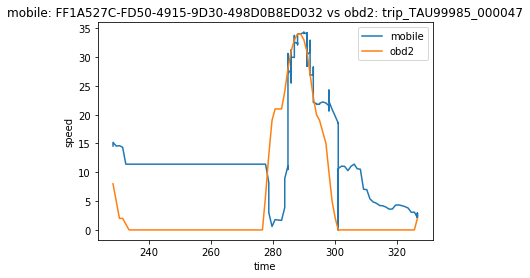

1494792475.9997 228.517
1494793295.0001 326.687


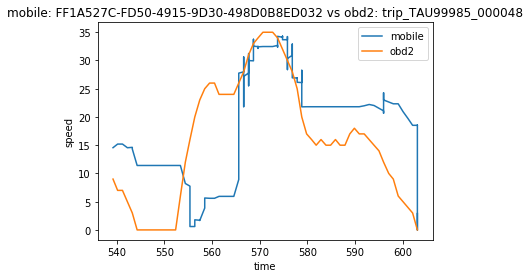

1494792475.9997 539.261
1494793295.0001 603.023


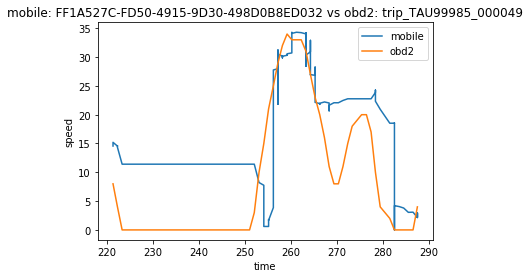

1494792475.9997 221.339
1494793295.0001 287.483


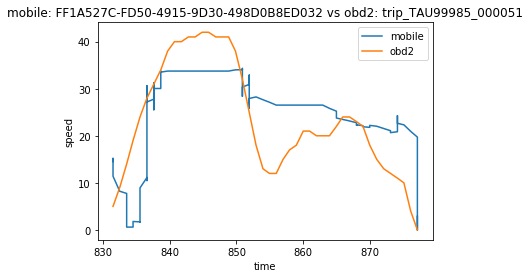

1494792475.9997 831.561
1494793295.0001 877.032


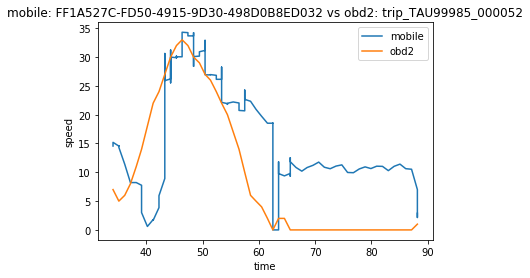

1494792475.9997 34.063
1494793295.0001 88.178


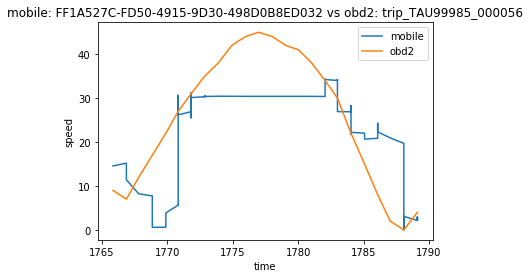

1494792475.9997 1765.836
1494793295.0001 1789.112


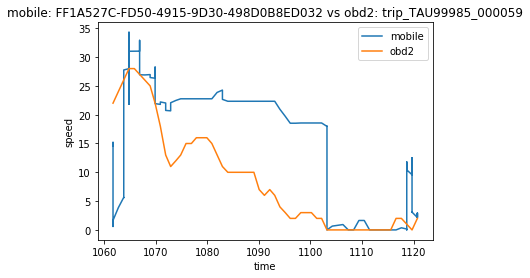

1494792475.9997 1061.716
1494793295.0001 1120.735


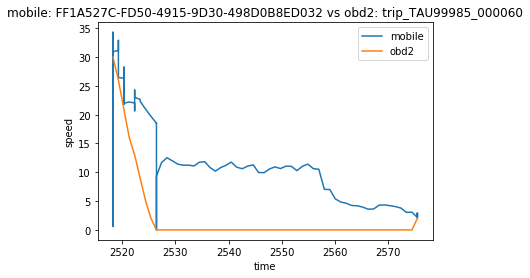

1494792475.9997 2518.228
1494793295.0001 2575.6


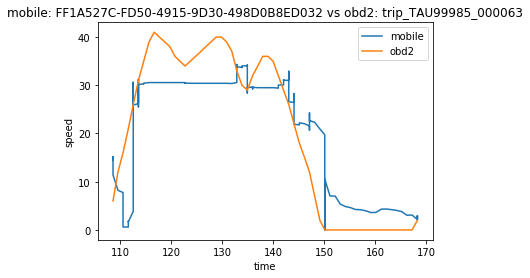

1494792475.9997 108.597
1494793295.0001 168.311


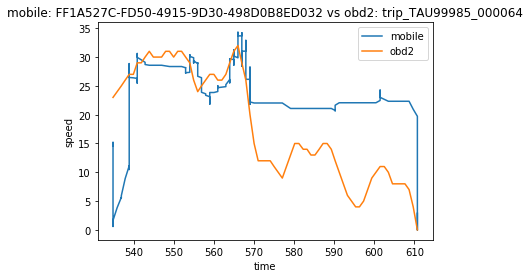

1494792475.9997 534.825
1494793295.0001 610.745


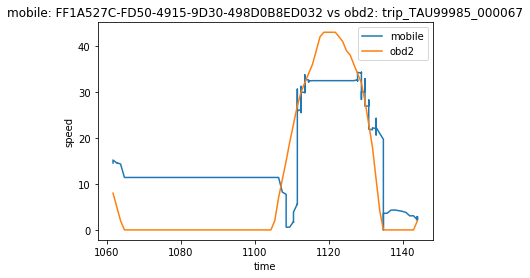

1494792475.9997 1061.754
1494793295.0001 1143.855


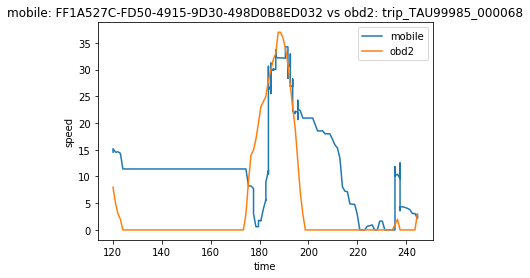

1494792475.9997 120.153
1494793295.0001 244.501


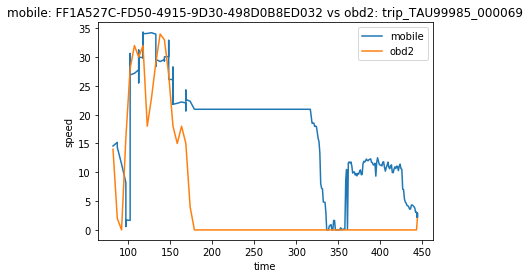

1494792475.9997 81.965
1494793295.0001 443.972


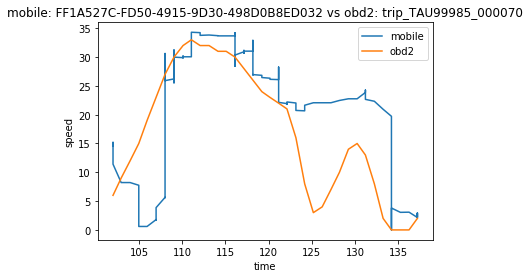

1494792475.9997 101.975
1494793295.0001 137.229


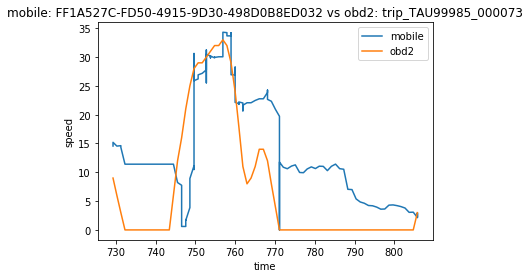

1494792475.9997 729.33
1494793295.0001 805.765


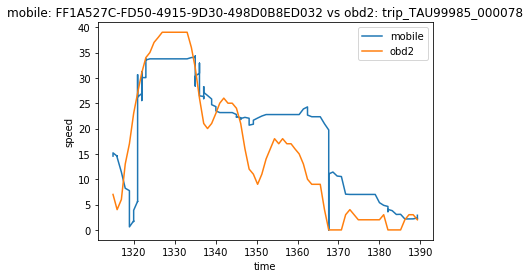

1494792475.9997 1314.914
1494793295.0001 1389.287


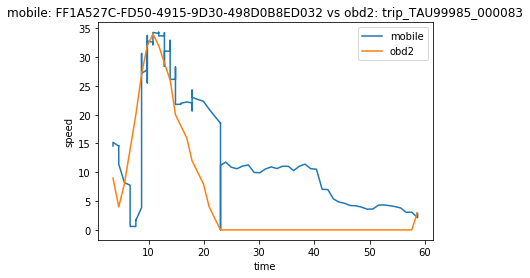

1494792475.9997 3.568
1494793295.0001 58.644


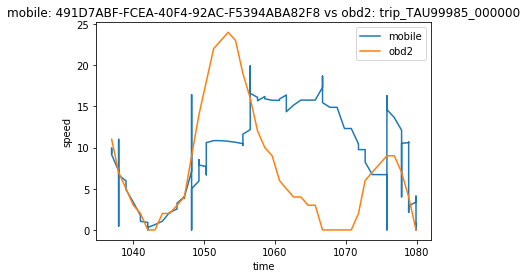

1494874456.0001 1036.933
1494875152.0001 1079.914


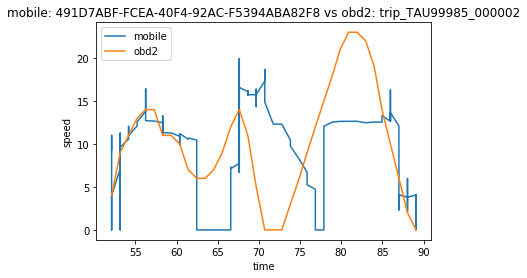

1494874456.0001 52.12
1494875152.0001 89.086


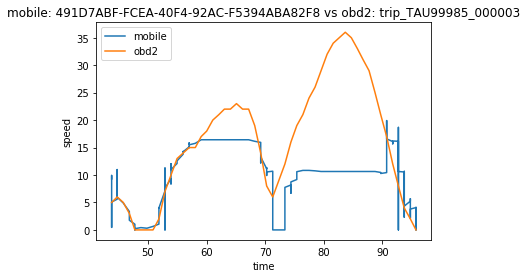

1494874456.0001 43.825
1494875152.0001 95.715


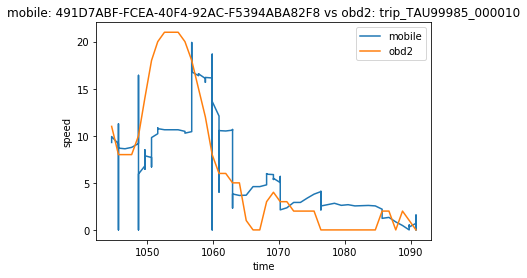

1494874456.0001 1044.579
1494875152.0001 1090.793


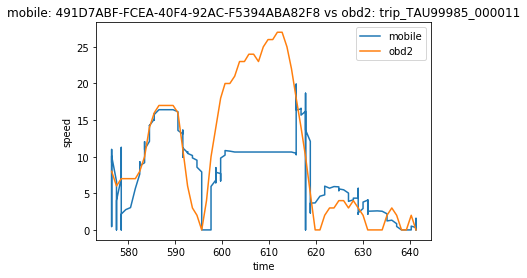

1494874456.0001 576.417
1494875152.0001 641.381


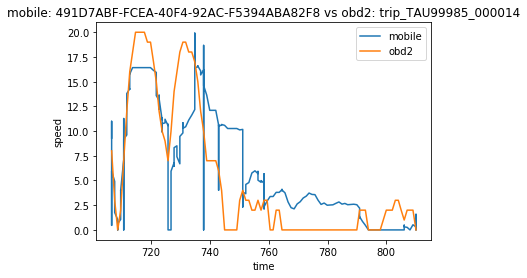

1494874456.0001 706.559
1494875152.0001 810.111


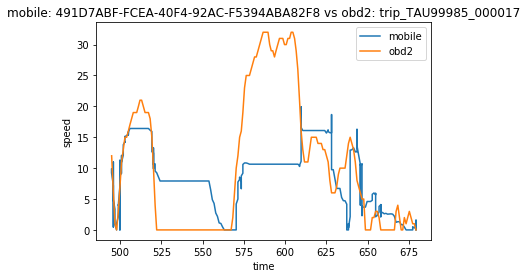

1494874456.0001 494.884
1494875152.0001 679.397


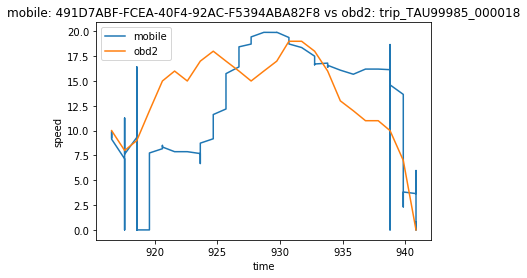

1494874456.0001 916.569
1494875152.0001 940.843


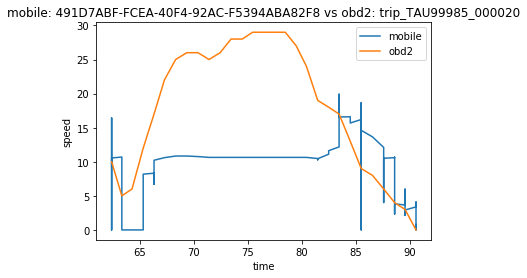

1494874456.0001 62.399
1494875152.0001 90.598


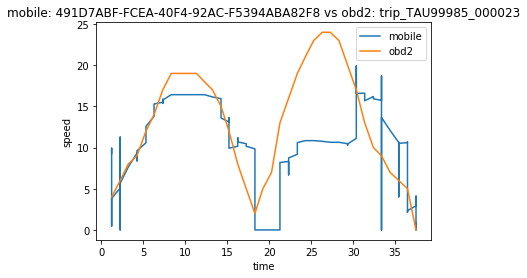

1494874456.0001 1.226
1494875152.0001 37.487


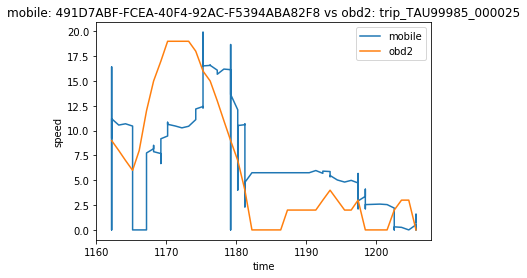

1494874456.0001 1162.191
1494875152.0001 1205.674


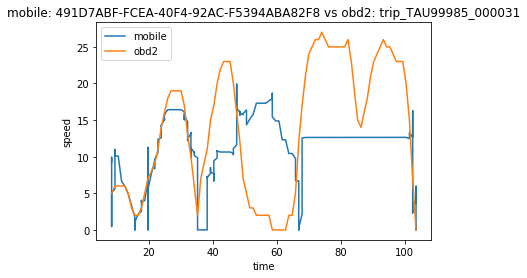

1494874456.0001 8.466
1494875152.0001 103.462


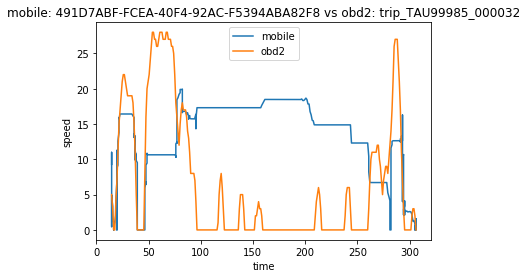

1494874456.0001 14.69
1494875152.0001 306.204


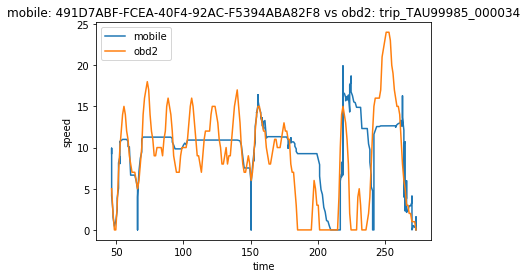

1494874456.0001 46.67
1494875152.0001 273.077


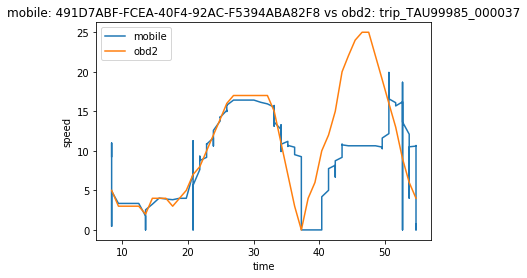

1494874456.0001 8.372
1494875152.0001 54.741


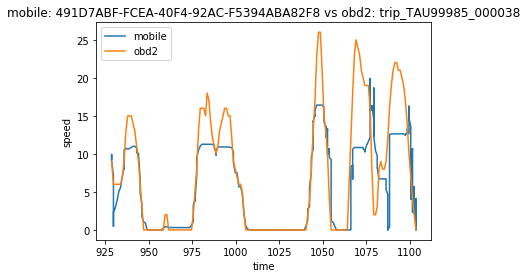

1494874456.0001 928.598
1494875152.0001 1103.586


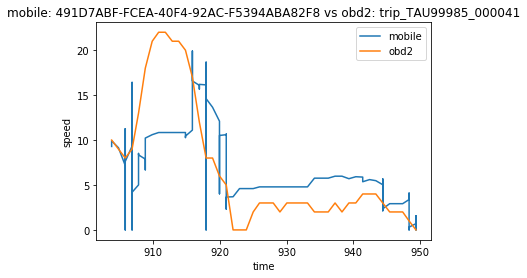

1494874456.0001 903.769
1494875152.0001 949.386


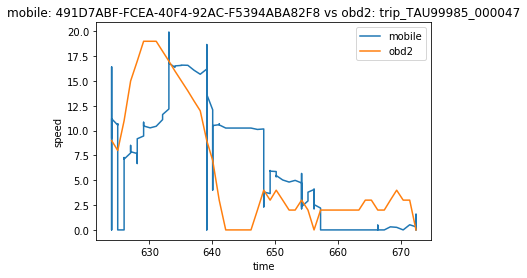

1494874456.0001 624.008
1494875152.0001 672.397


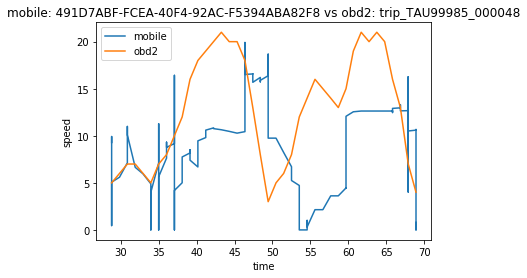

1494874456.0001 28.798
1494875152.0001 68.927


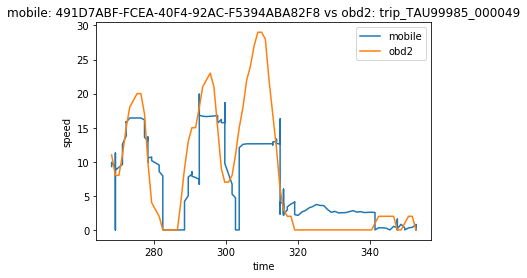

1494874456.0001 268.307
1494875152.0001 352.727


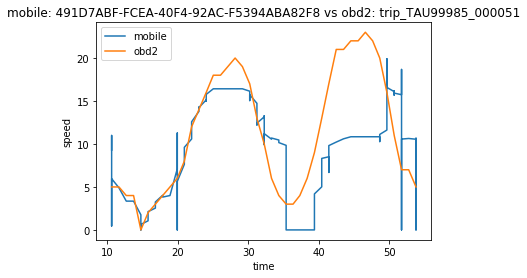

1494874456.0001 10.607
1494875152.0001 53.806


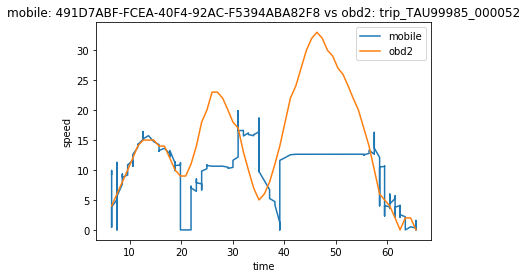

1494874456.0001 6.497
1494875152.0001 65.58


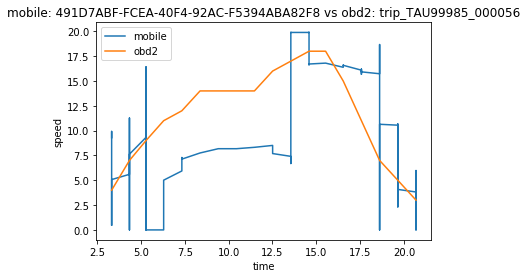

1494874456.0001 3.334
1494875152.0001 20.678


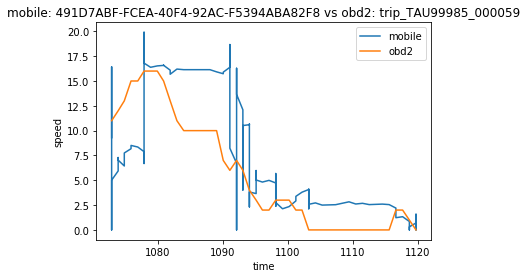

1494874456.0001 1072.894
1494875152.0001 1119.698


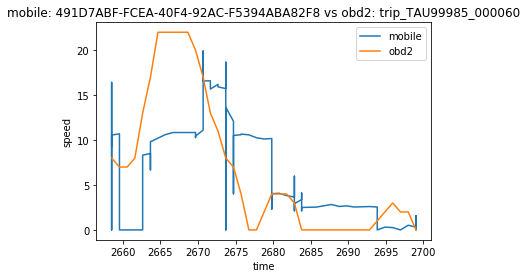

1494874456.0001 2658.49
1494875152.0001 2699.057


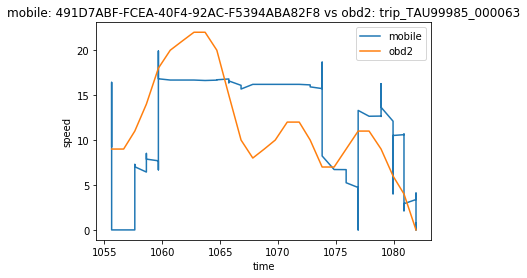

1494874456.0001 1055.622
1494875152.0001 1081.929


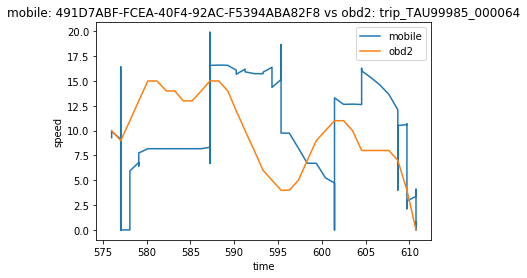

1494874456.0001 576.017
1494875152.0001 610.745


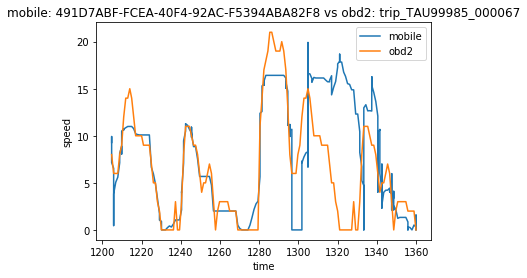

1494874456.0001 1204.753
1494875152.0001 1359.929


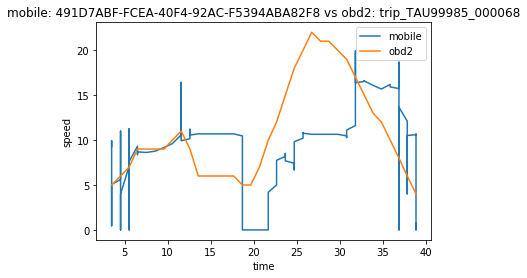

1494874456.0001 3.505
1494875152.0001 38.845


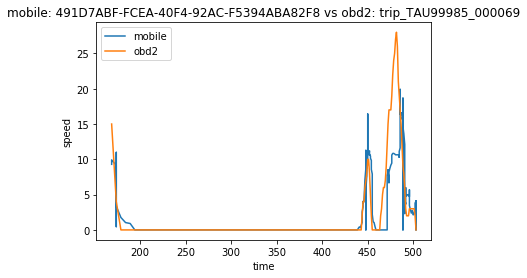

1494874456.0001 168.582
1494875152.0001 503.208


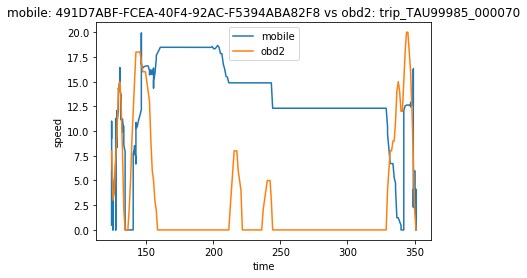

1494874456.0001 124.175
1494875152.0001 351.1


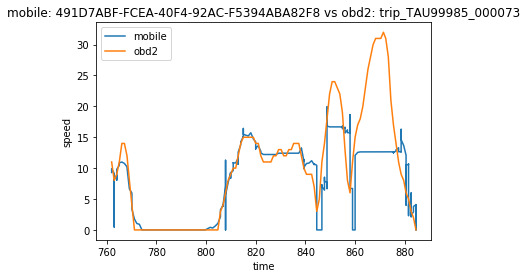

1494874456.0001 761.944
1494875152.0001 884.52


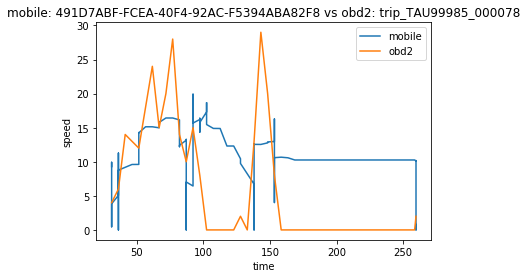

1494874456.0001 31.012
1494875152.0001 259.628


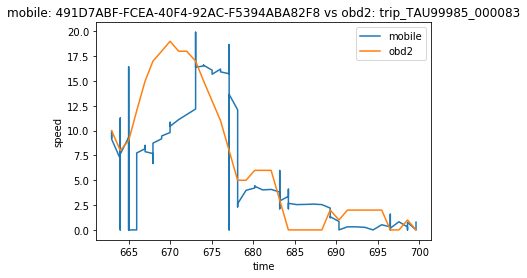

1494874456.0001 662.949
1494875152.0001 699.605


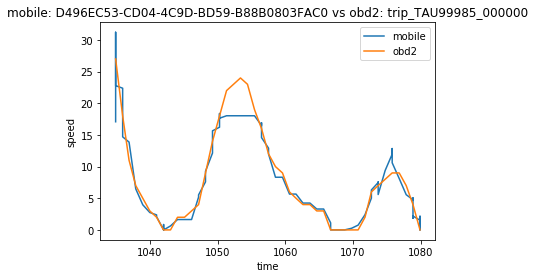

1494943576 1034.951
1494944219.0001 1079.914


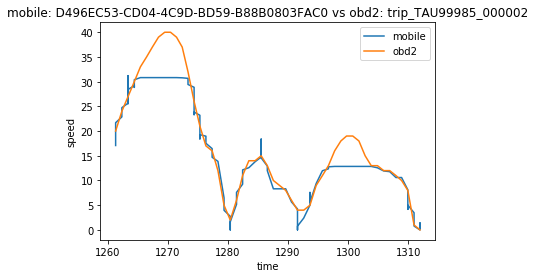

1494943576 1261.297
1494944219.0001 1311.954


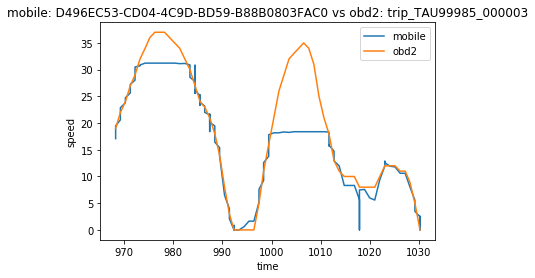

1494943576 968.295
1494944219.0001 1030.204


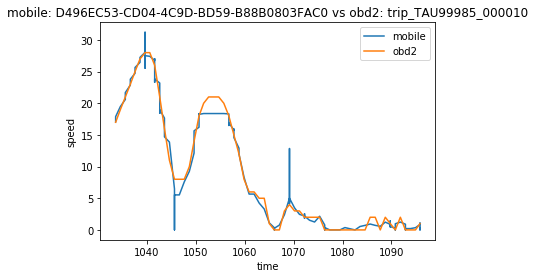

1494943576 1033.575
1494944219.0001 1095.847


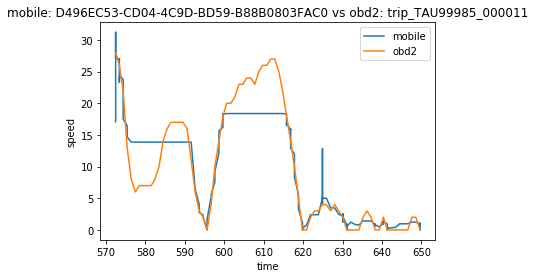

1494943576 572.449
1494944219.0001 649.657


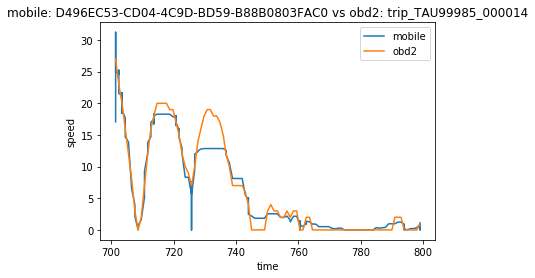

1494943576 701.423
1494944219.0001 798.967


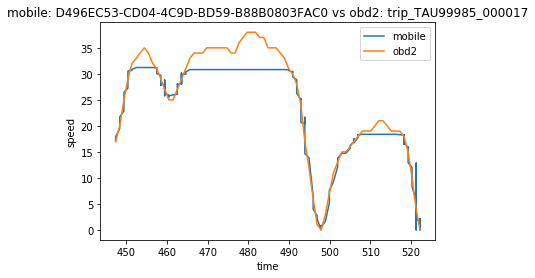

1494943576 447.342
1494944219.0001 522.189


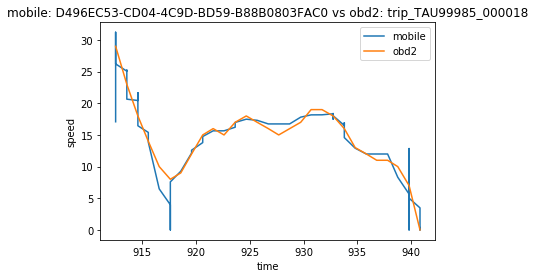

1494943576 912.513
1494944219.0001 940.843


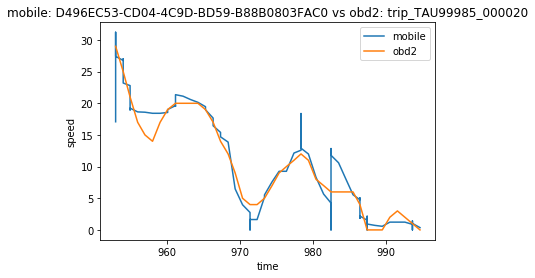

1494943576 952.977
1494944219.0001 994.674


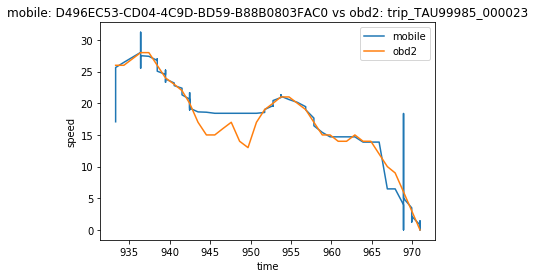

1494943576 933.303
1494944219.0001 970.948


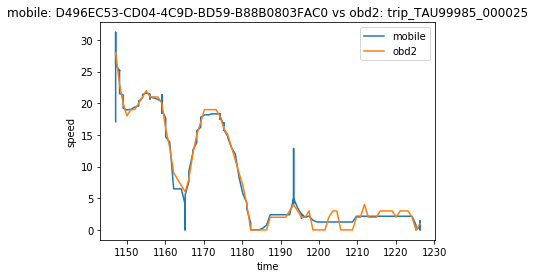

1494943576 1147.081
1494944219.0001 1226.29


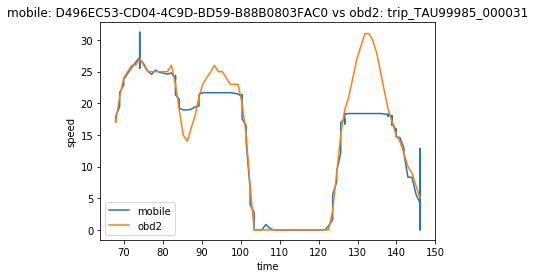

1494943576 67.907
1494944219.0001 146.039


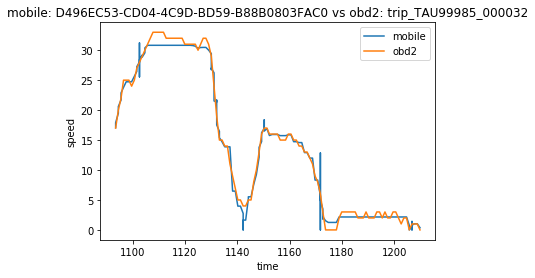

1494943576 1093.454
1494944219.0001 1209.828


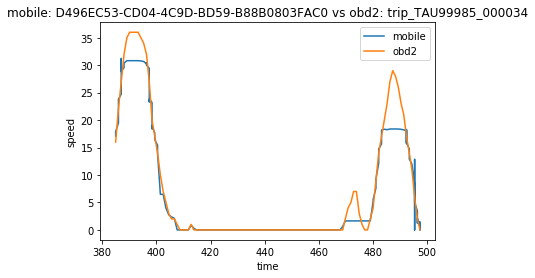

1494943576 384.955
1494944219.0001 497.39


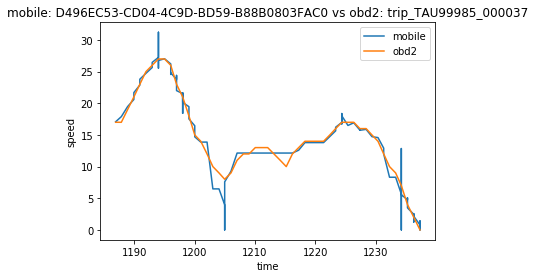

1494943576 1186.877
1494944219.0001 1237.349


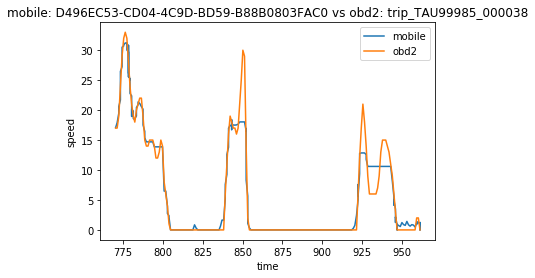

1494943576 770.23
1494944219.0001 961.395


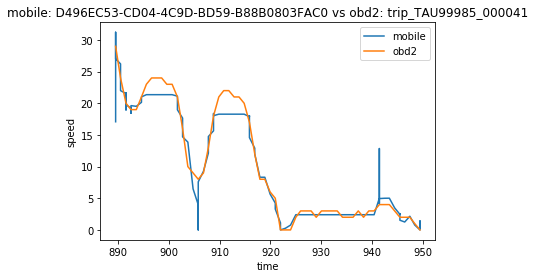

1494943576 889.577
1494944219.0001 949.386


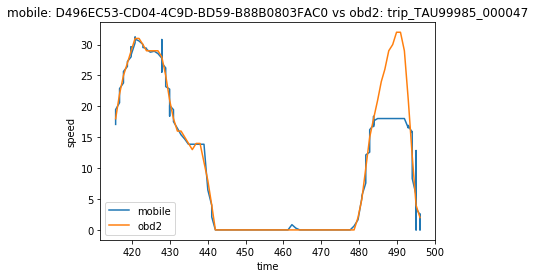

1494943576 415.63
1494944219.0001 496.16


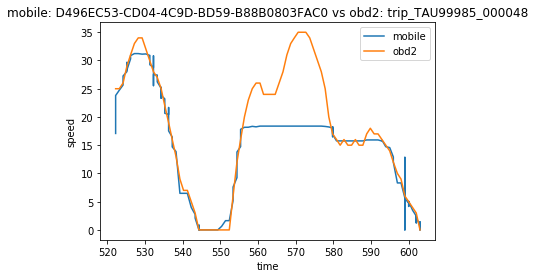

1494943576 522.188
1494944219.0001 603.023


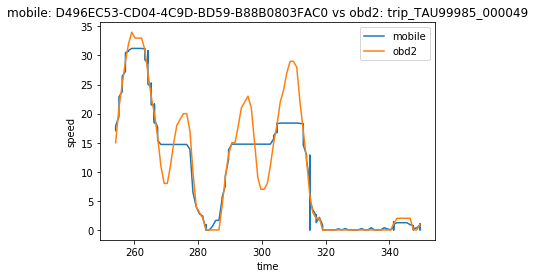

1494943576 254.11
1494944219.0001 349.615


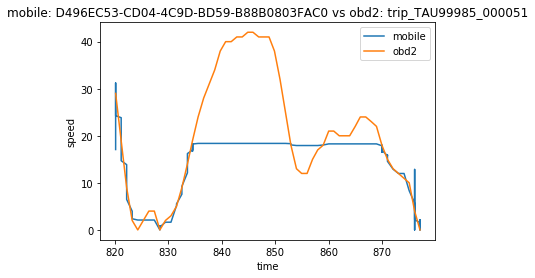

1494943576 820.191
1494944219.0001 877.032


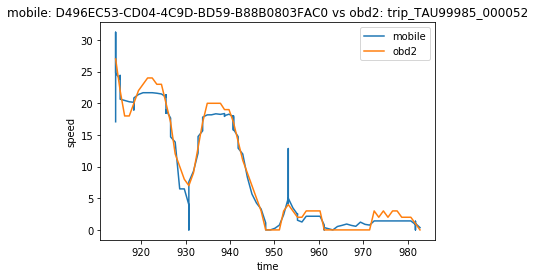

1494943576 914.269
1494944219.0001 982.754


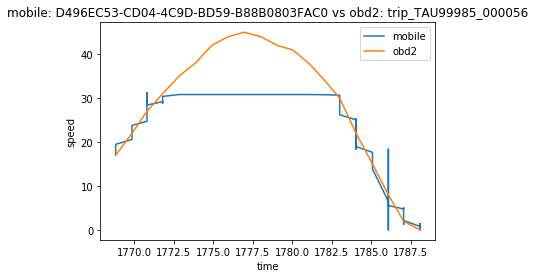

1494943576 1768.84
1494944219.0001 1788.075


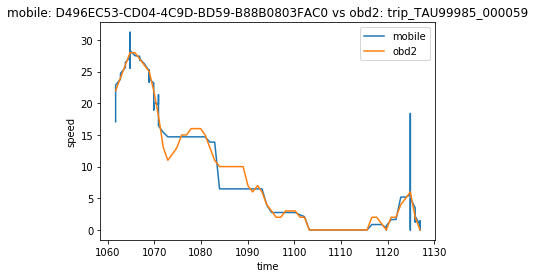

1494943576 1061.716
1494944219.0001 1126.917


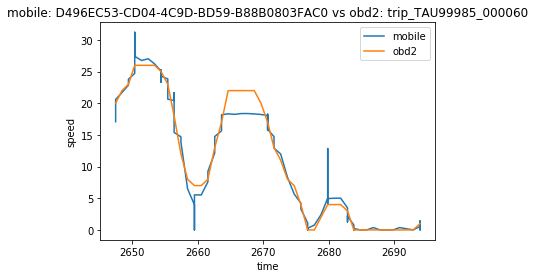

1494943576 2647.529
1494944219.0001 2693.89


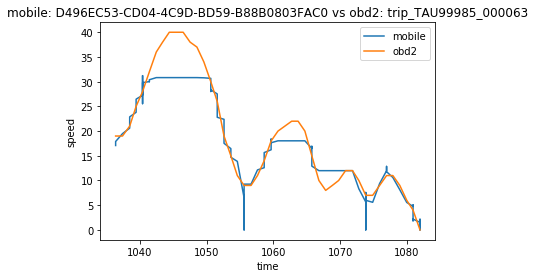

1494943576 1036.408
1494944219.0001 1081.929


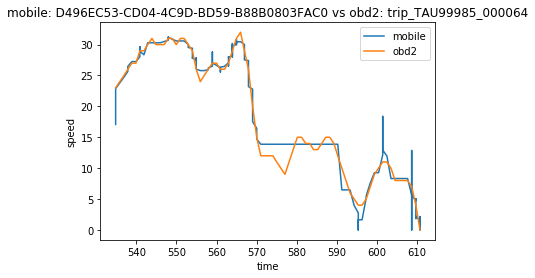

1494943576 534.825
1494944219.0001 610.745


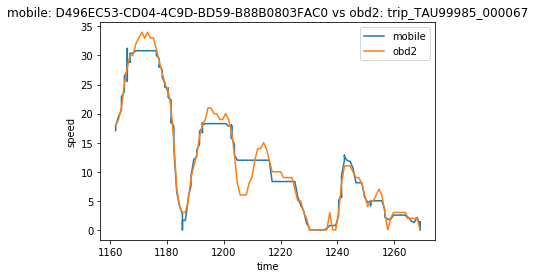

1494943576 1161.885
1494944219.0001 1269.078


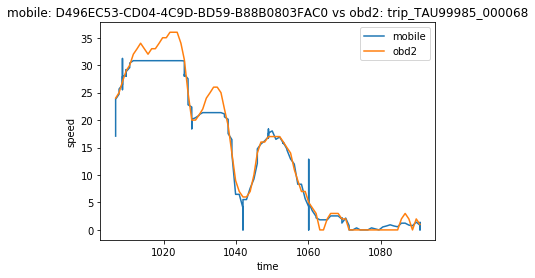

1494943576 1006.75
1494944219.0001 1090.813


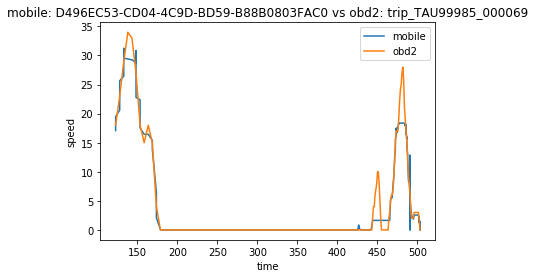

1494943576 122.706
1494944219.0001 503.208


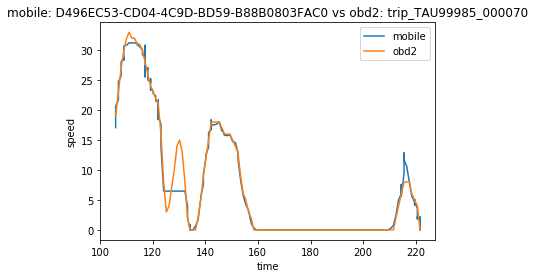

1494943576 105.921
1494944219.0001 221.616


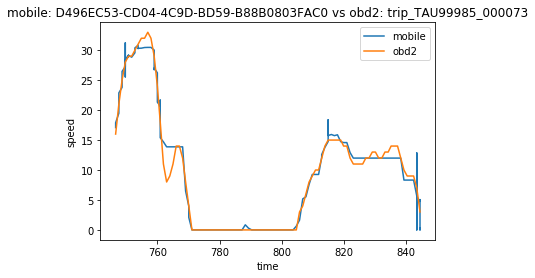

1494943576 746.562
1494944219.0001 844.546


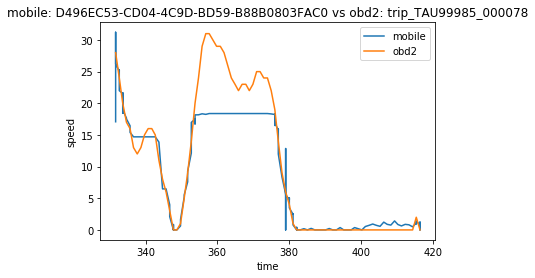

1494943576 331.661
1494944219.0001 416.479


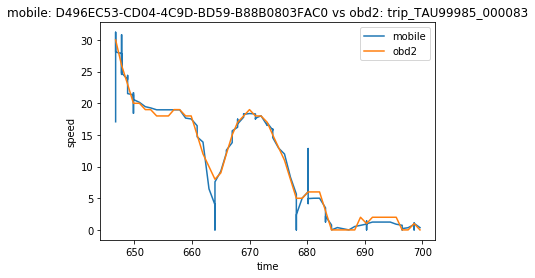

1494943576 646.73
1494944219.0001 699.605


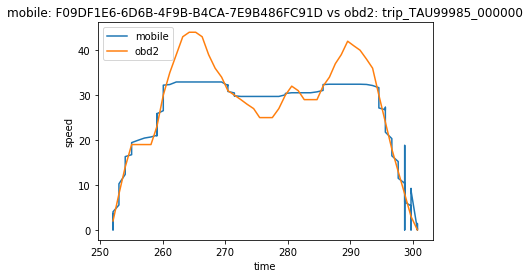

1494946644.3497 252.091
1494947481.9999 300.682


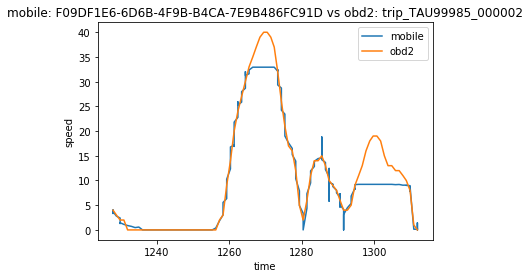

1494946644.3497 1227.807
1494947481.9999 1311.954


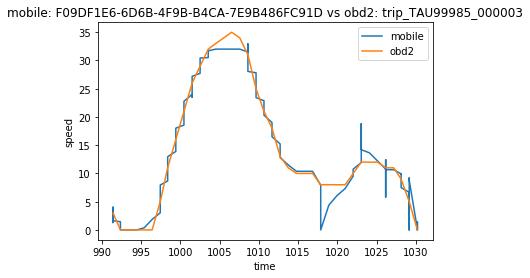

1494946644.3497 991.433
1494947481.9999 1030.204


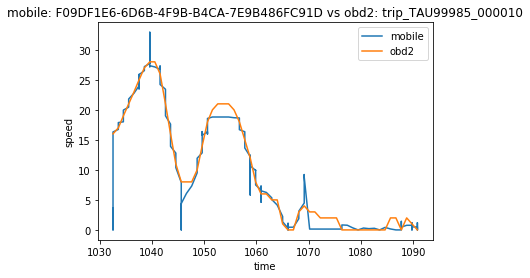

1494946644.3497 1032.56
1494947481.9999 1090.793


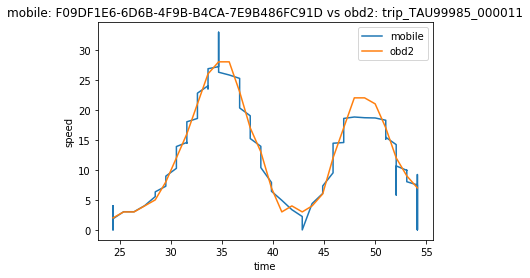

1494946644.3497 24.354
1494947481.9999 54.141


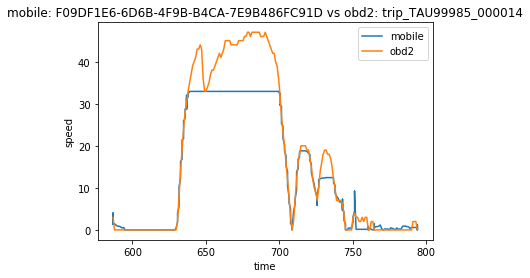

1494946644.3497 586.74
1494947481.9999 793.924


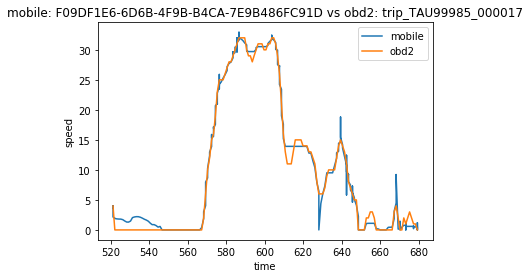

1494946644.3497 521.244
1494947481.9999 679.397


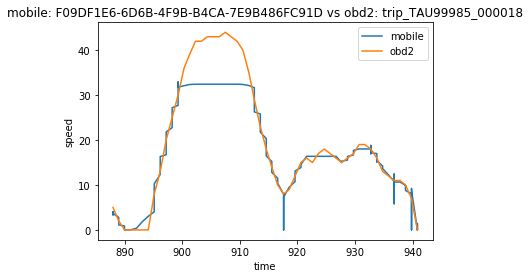

1494946644.3497 887.96
1494947481.9999 940.843


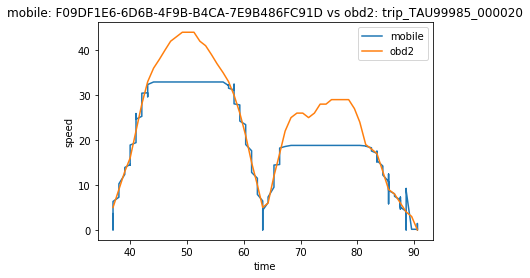

1494946644.3497 36.959
1494947481.9999 90.598


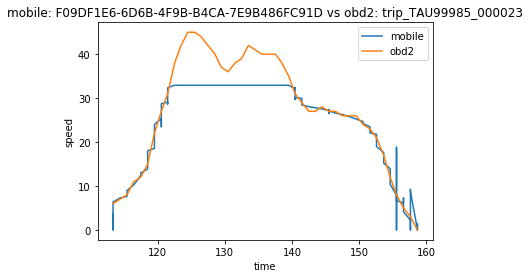

1494946644.3497 113.358
1494947481.9999 158.678


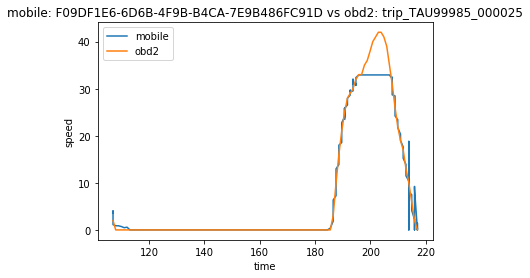

1494946644.3497 106.922
1494947481.9999 217.008


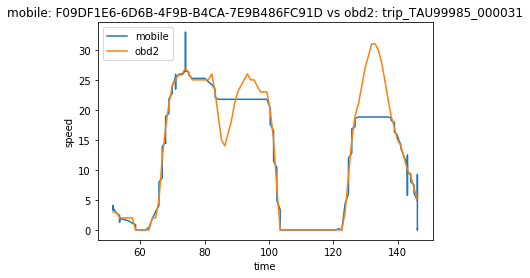

1494946644.3497 51.594
1494947481.9999 146.039


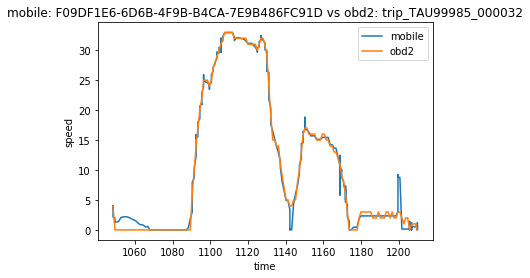

1494946644.3497 1048.437
1494947481.9999 1209.828


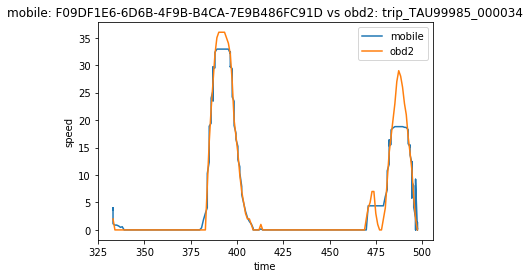

1494946644.3497 333.003
1494947481.9999 497.39


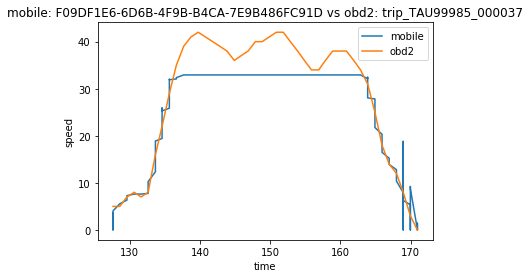

1494946644.3497 127.614
1494947481.9999 170.953


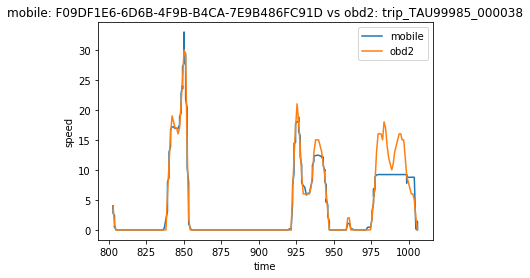

1494946644.3497 802.752
1494947481.9999 1005.762


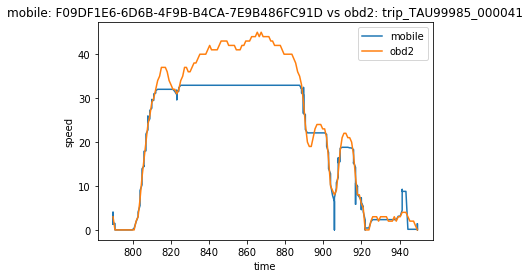

1494946644.3497 789.508
1494947481.9999 949.386


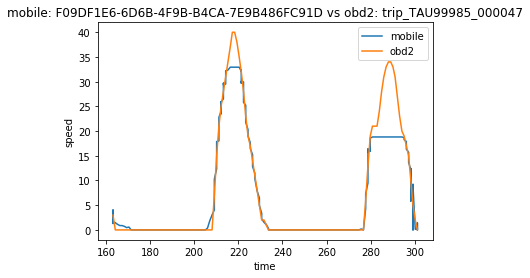

1494946644.3497 163.195
1494947481.9999 301.164


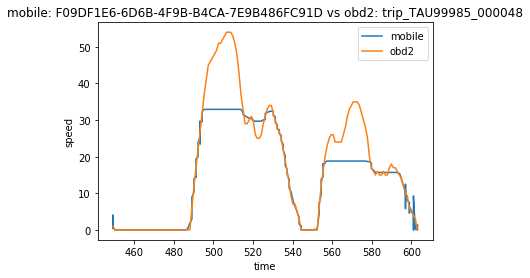

1494946644.3497 449.282
1494947481.9999 603.023


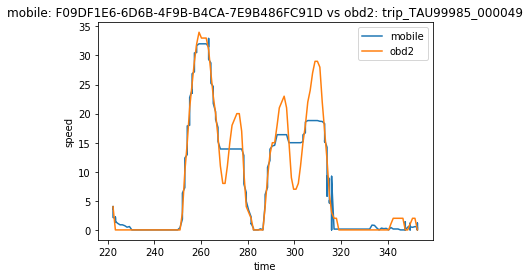

1494946644.3497 222.304
1494947481.9999 352.727


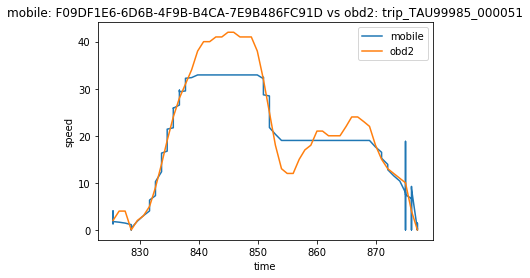

1494946644.3497 825.358
1494947481.9999 877.032


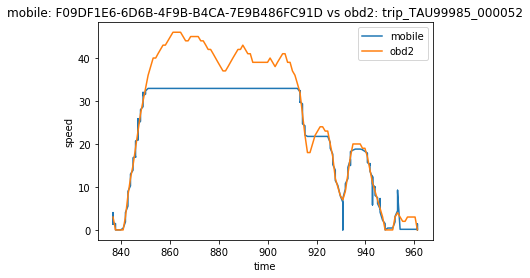

1494946644.3497 836.857
1494947481.9999 961.206


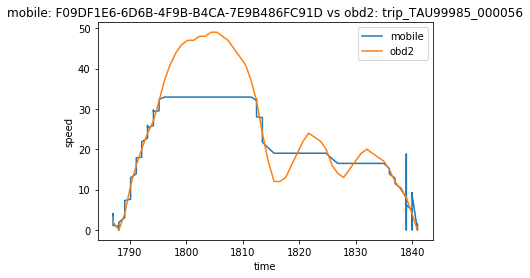

1494946644.3497 1787.039
1494947481.9999 1840.902


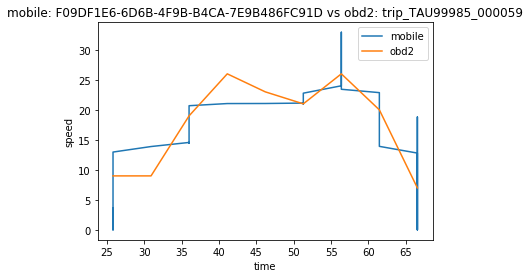

1494946644.3497 25.798
1494947481.9999 66.559


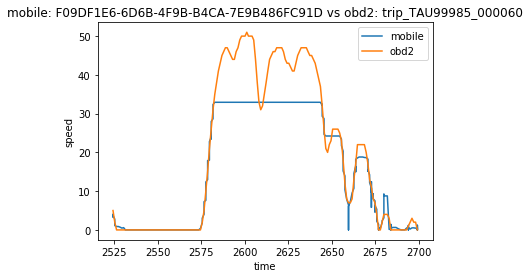

1494946644.3497 2524.379
1494947481.9999 2699.057


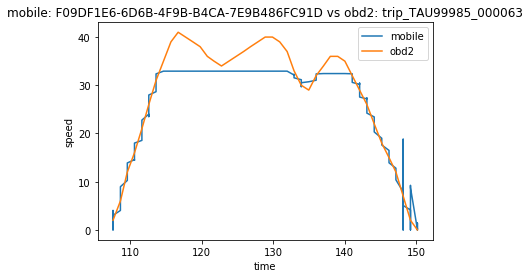

1494946644.3497 107.561
1494947481.9999 150.144


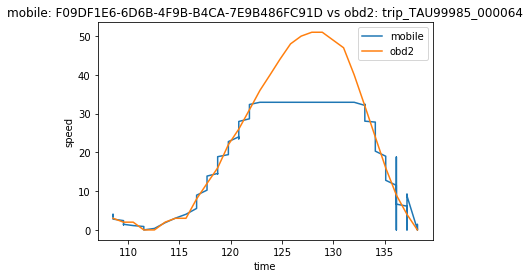

1494946644.3497 108.524
1494947481.9999 138.191


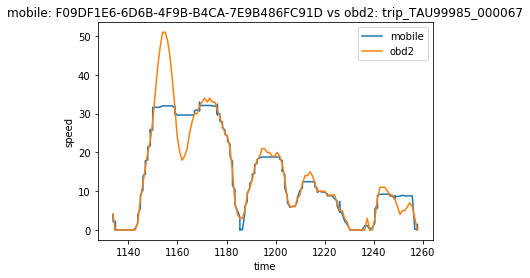

1494946644.3497 1133.74
1494947481.9999 1257.719


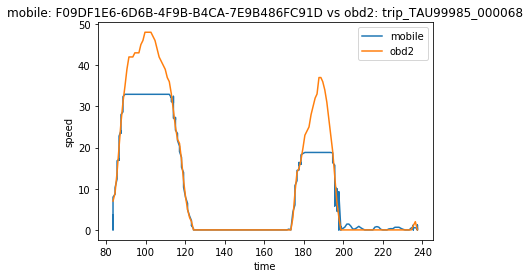

1494946644.3497 83.46
1494947481.9999 237.42


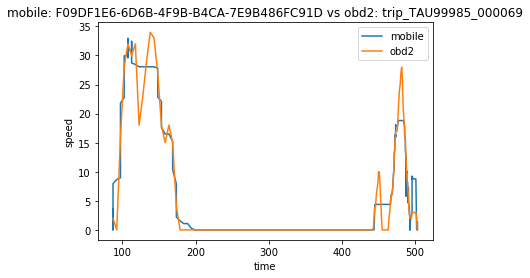

1494946644.3497 87.059
1494947481.9999 503.208


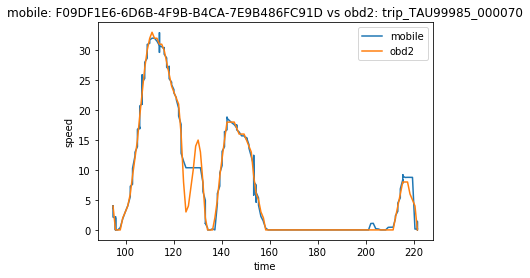

1494946644.3497 94.787
1494947481.9999 221.616


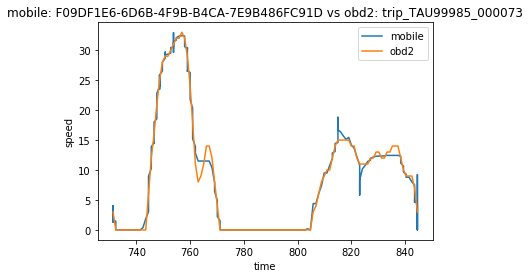

1494946644.3497 731.296
1494947481.9999 844.546


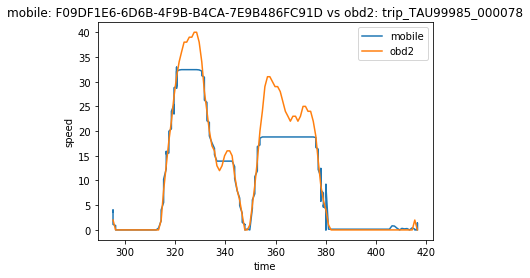

1494946644.3497 295.277
1494947481.9999 416.479


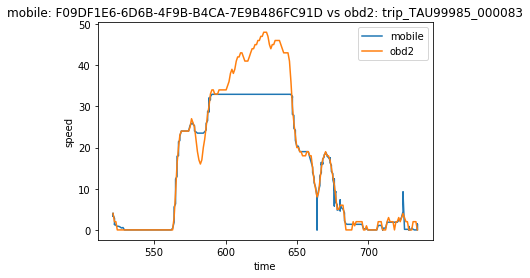

1494946644.3497 521.159
1494947481.9999 734.225


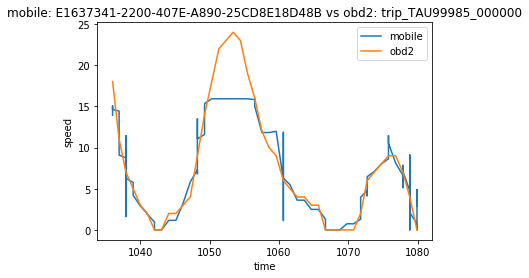

1495125735.9998 1035.989
1495126220.0002 1079.914


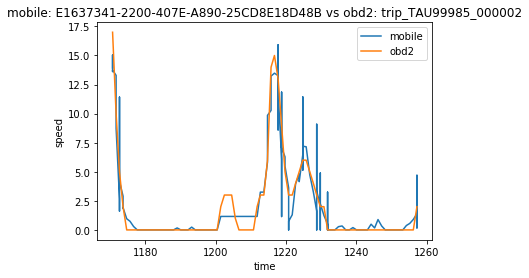

1495125735.9998 1170.706
1495126220.0002 1257.255


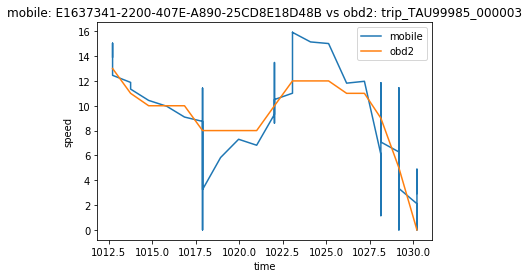

1495125735.9998 1012.722
1495126220.0002 1030.204


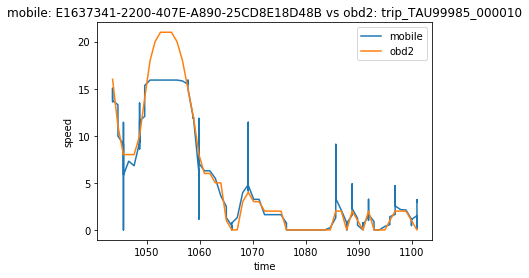

1495125735.9998 1043.564
1495126220.0002 1100.959


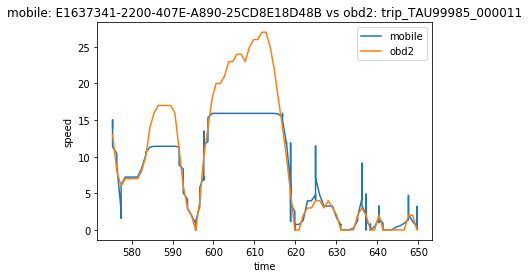

1495125735.9998 575.373
1495126220.0002 649.657


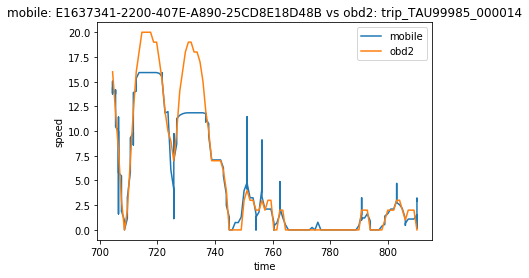

1495125735.9998 704.507
1495126220.0002 810.111


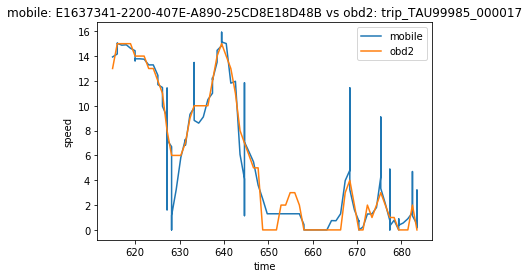

1495125735.9998 614.892
1495126220.0002 683.506


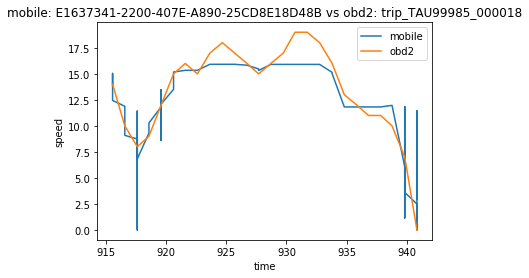

1495125735.9998 915.553
1495126220.0002 940.843


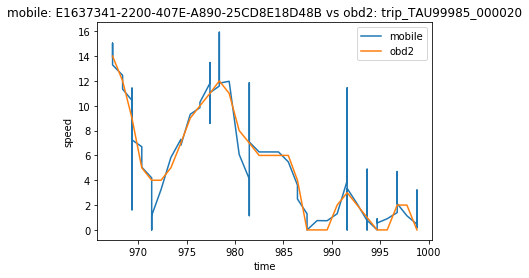

1495125735.9998 967.349
1495126220.0002 998.784


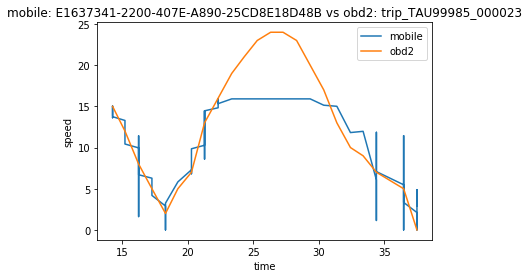

1495125735.9998 14.257
1495126220.0002 37.487


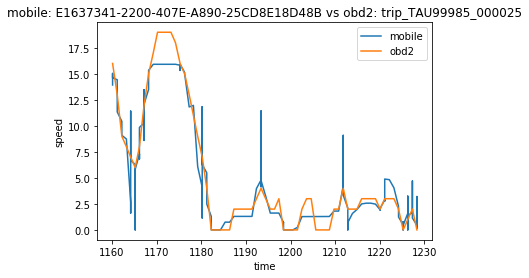

1495125735.9998 1160.11
1495126220.0002 1228.348


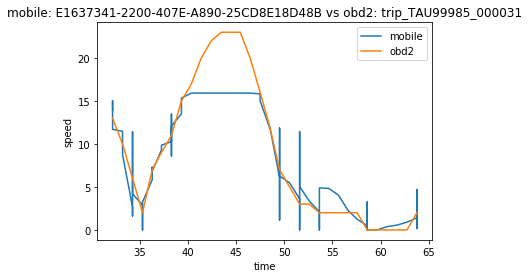

1495125735.9998 32.176
1495126220.0002 63.772


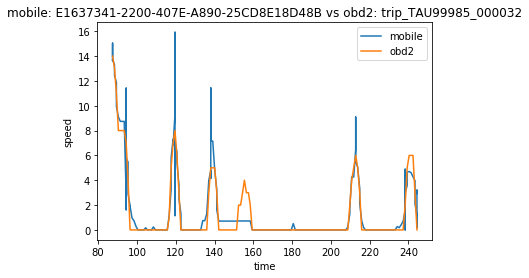

1495125735.9998 87.42
1495126220.0002 244.407


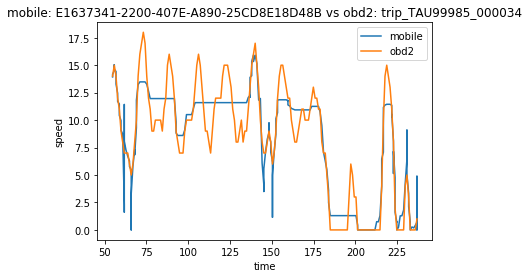

1495125735.9998 54.809
1495126220.0002 236.824


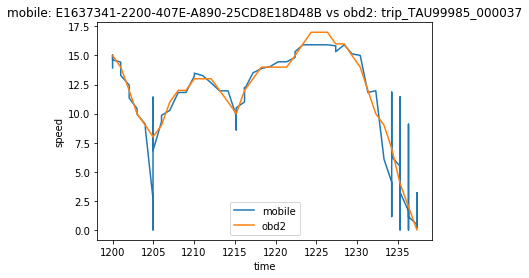

1495125735.9998 1199.998
1495126220.0002 1237.349


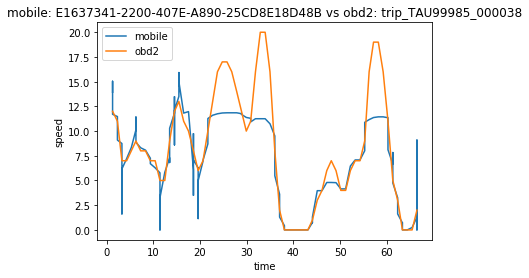

1495125735.9998 1.266
1495126220.0002 66.465


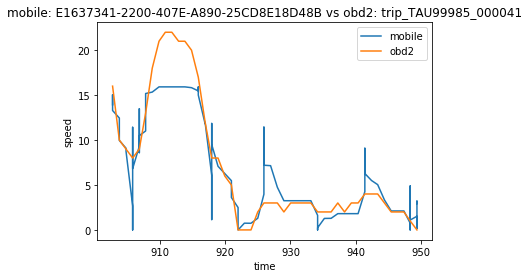

1495125735.9998 902.733
1495126220.0002 949.386


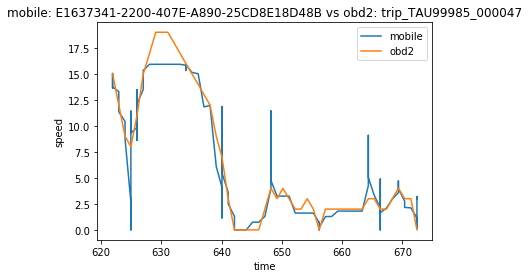

1495125735.9998 621.939
1495126220.0002 672.397


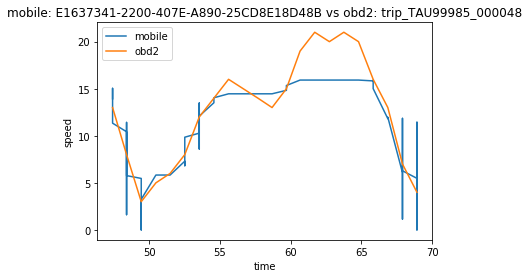

1495125735.9998 47.409
1495126220.0002 68.927


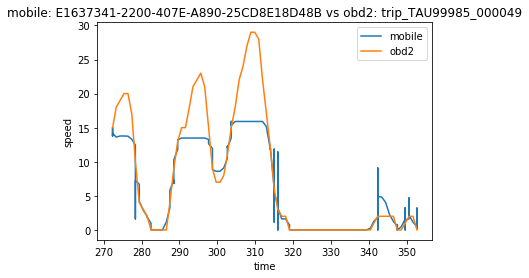

1495125735.9998 272.348
1495126220.0002 352.727


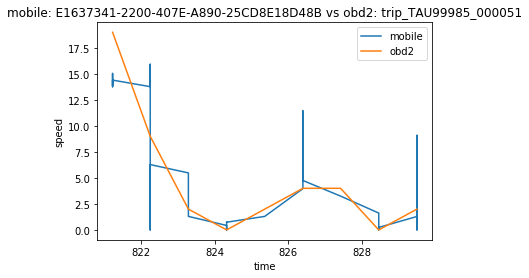

1495125735.9998 821.227
1495126220.0002 829.49


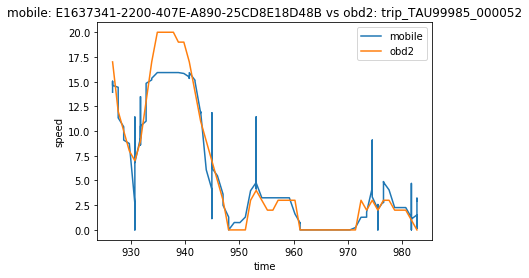

1495125735.9998 926.635
1495126220.0002 982.754


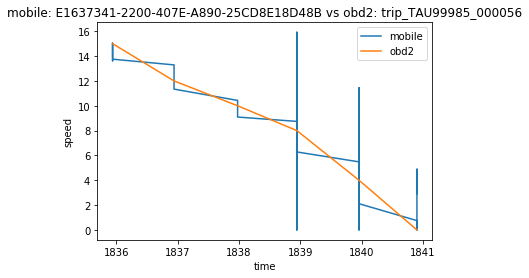

1495125735.9998 1835.94
1495126220.0002 1840.902


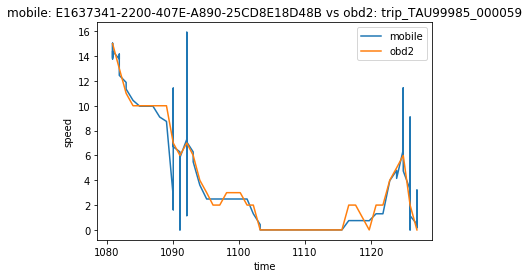

1495125735.9998 1080.882
1495126220.0002 1126.917


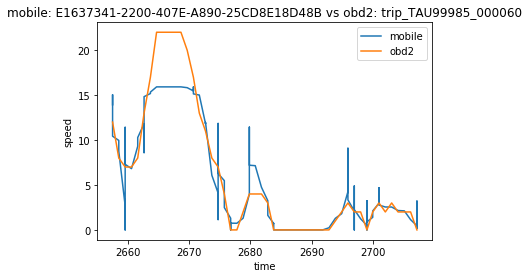

1495125735.9998 2657.475
1495126220.0002 2707.229


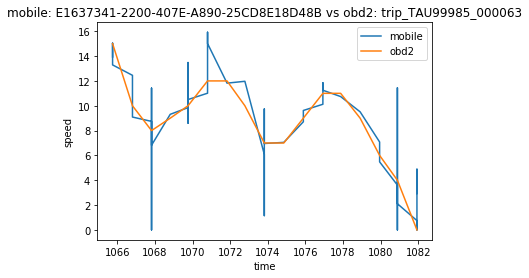

1495125735.9998 1065.751
1495126220.0002 1081.929


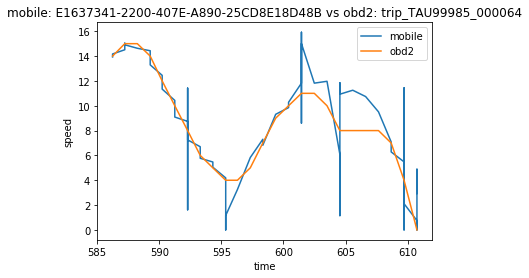

1495125735.9998 586.24
1495126220.0002 610.745


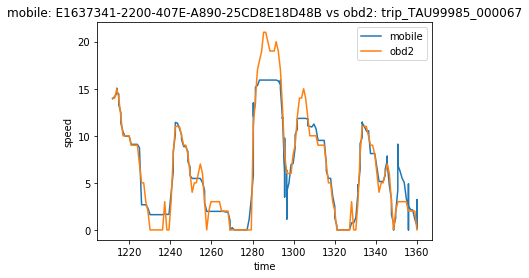

1495125735.9998 1211.948
1495126220.0002 1359.929


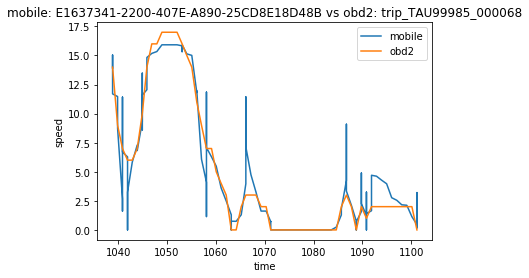

1495125735.9998 1038.858
1495126220.0002 1101.148


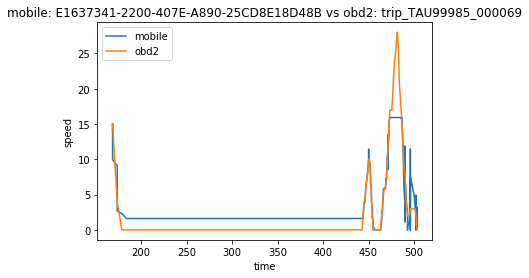

1495125735.9998 168.582
1495126220.0002 503.208


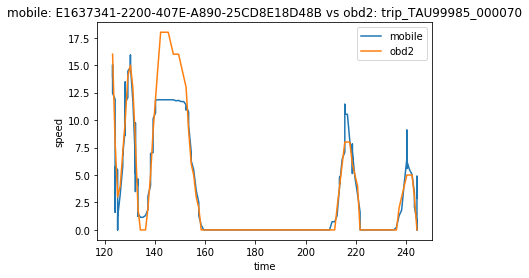

1495125735.9998 123.16
1495126220.0002 244.231


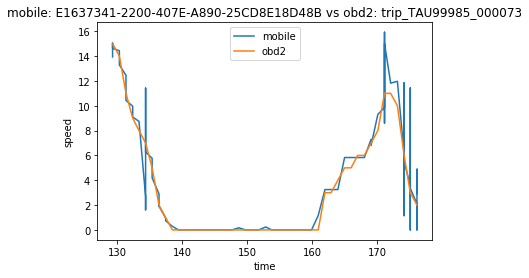

1495125735.9998 129.321
1495126220.0002 176.101


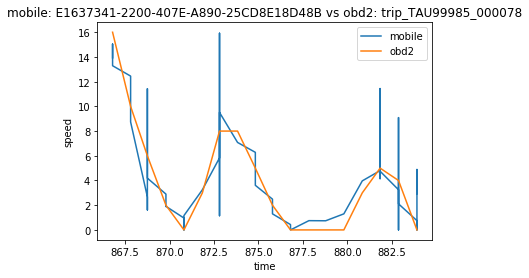

1495125735.9998 866.788
1495126220.0002 883.919


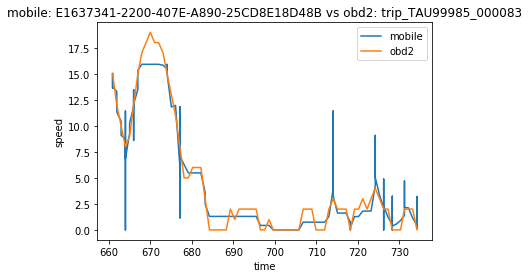

1495125735.9998 660.891
1495126220.0002 734.225


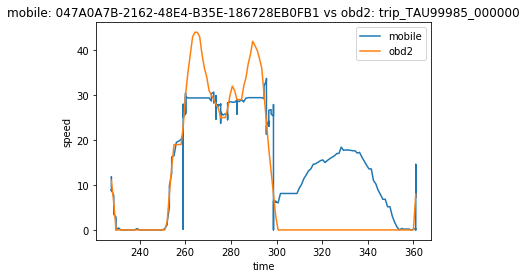

1495203347.0001 227.62
1495204218.0001 361.016


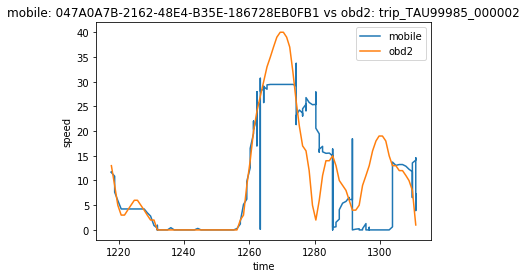

1495203347.0001 1217.773
1495204218.0001 1310.964


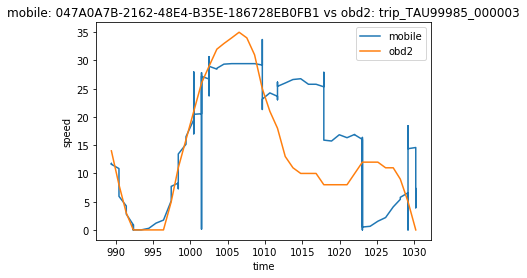

1495203347.0001 989.438
1495204218.0001 1030.204


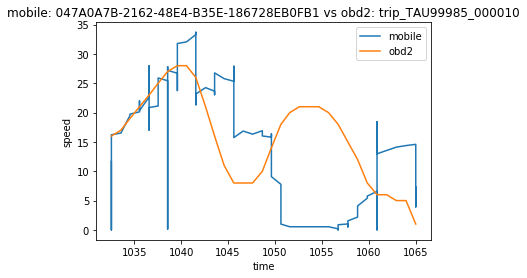

1495203347.0001 1032.56
1495204218.0001 1065.013


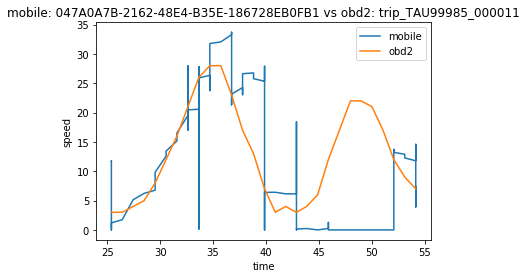

1495203347.0001 25.391
1495204218.0001 54.141


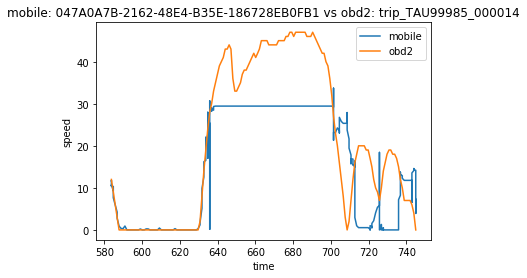

1495203347.0001 583.699
1495204218.0001 744.992


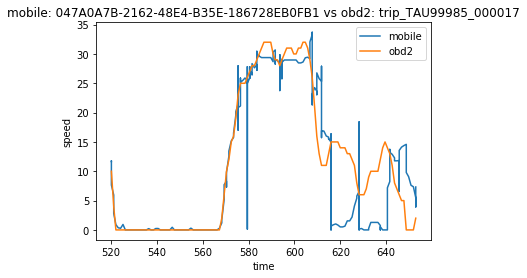

1495203347.0001 520.23
1495204218.0001 652.868


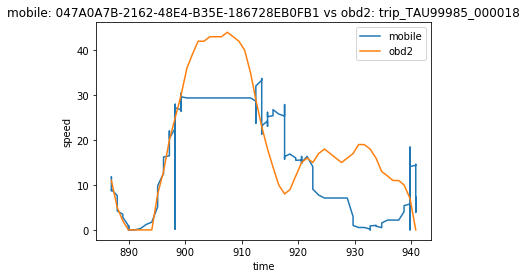

1495203347.0001 886.924
1495204218.0001 940.843


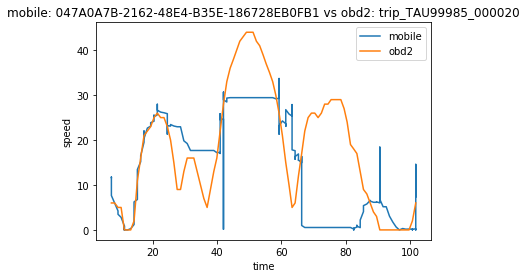

1495203347.0001 7.225
1495204218.0001 101.761


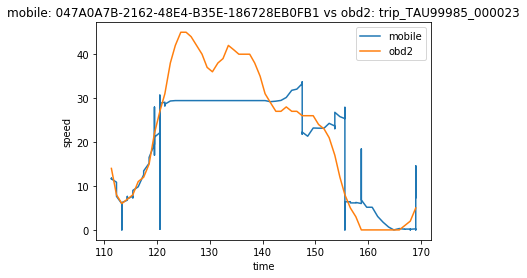

1495203347.0001 111.378
1495204218.0001 168.981


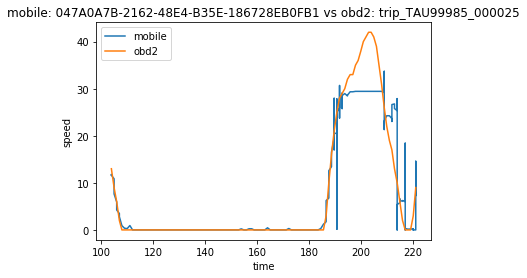

1495203347.0001 103.848
1495204218.0001 221.068


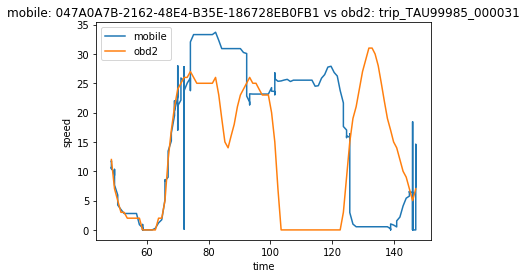

1495203347.0001 48.498
1495204218.0001 147.054


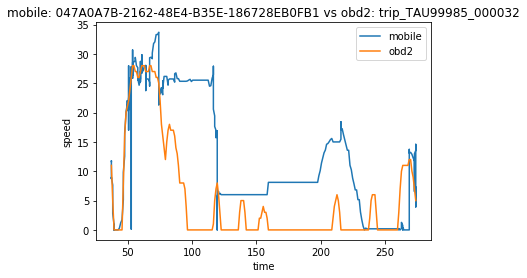

1495203347.0001 37.202
1495204218.0001 274.145


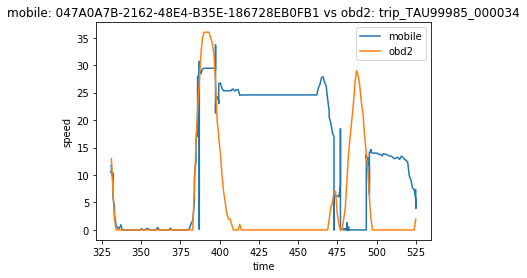

1495203347.0001 331.023
1495204218.0001 524.96


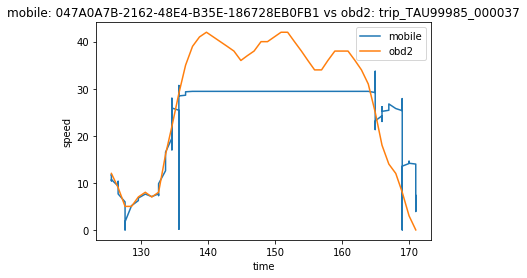

1495203347.0001 125.576
1495204218.0001 170.953


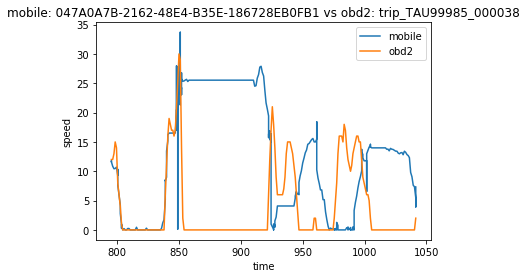

1495203347.0001 795.556
1495204218.0001 1041.358


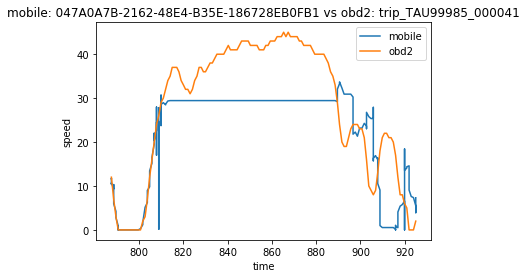

1495203347.0001 787.453
1495204218.0001 924.985


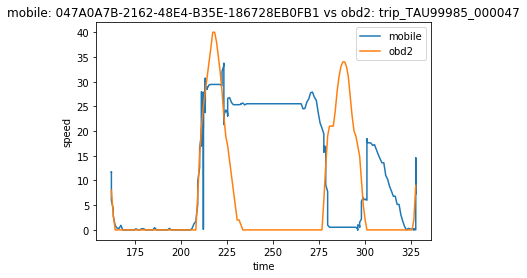

1495203347.0001 162.173
1495204218.0001 327.723


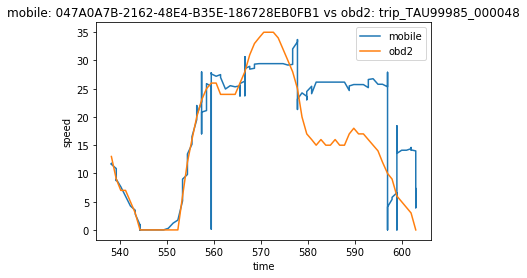

1495203347.0001 538.224
1495204218.0001 603.023


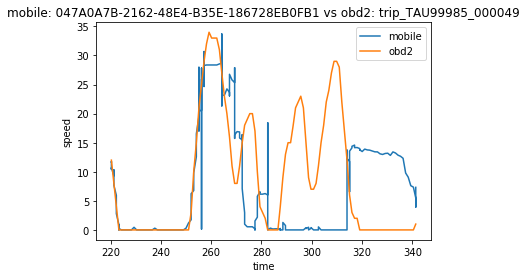

1495203347.0001 220.338
1495204218.0001 341.351


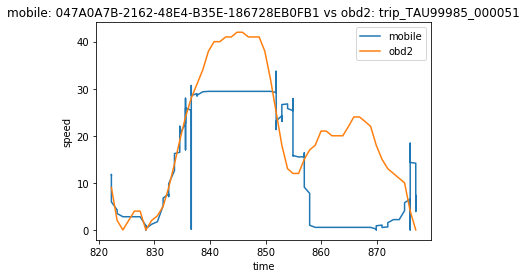

1495203347.0001 822.249
1495204218.0001 877.032


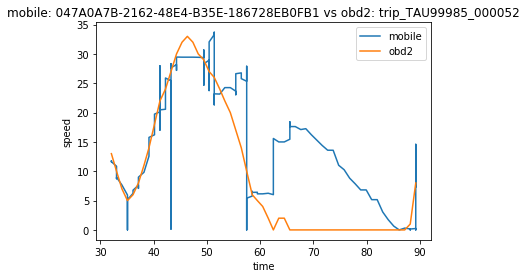

1495203347.0001 32.083
1495204218.0001 89.214


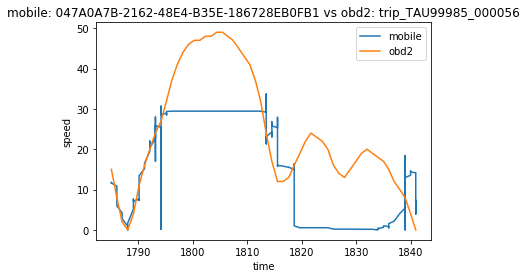

1495203347.0001 1785.073
1495204218.0001 1840.902


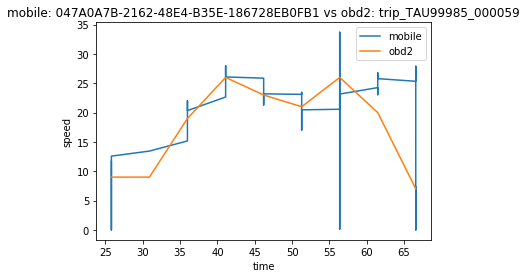

1495203347.0001 25.798
1495204218.0001 66.559


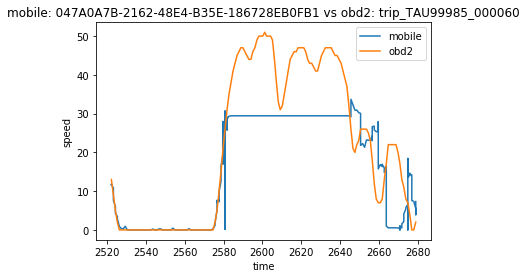

1495203347.0001 2522.307
1495204218.0001 2678.808


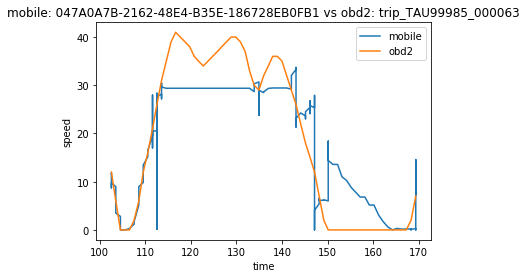

1495203347.0001 102.577
1495204218.0001 169.347


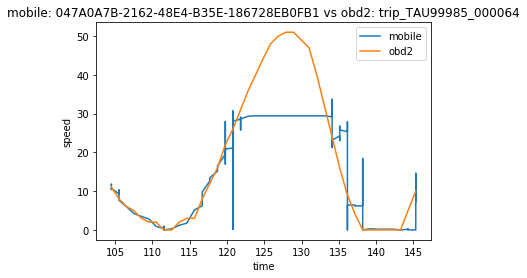

1495203347.0001 104.493
1495204218.0001 145.304


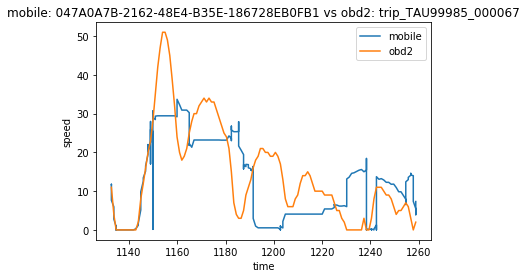

1495203347.0001 1132.725
1495204218.0001 1258.743


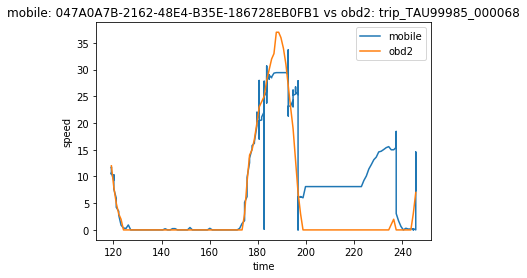

1495203347.0001 119.149
1495204218.0001 245.539


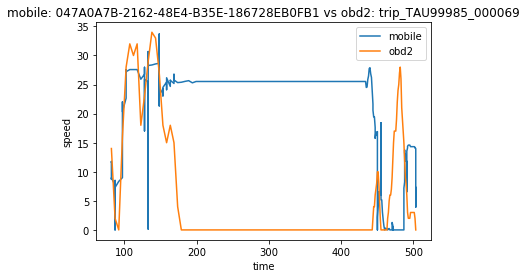

1495203347.0001 81.965
1495204218.0001 503.208


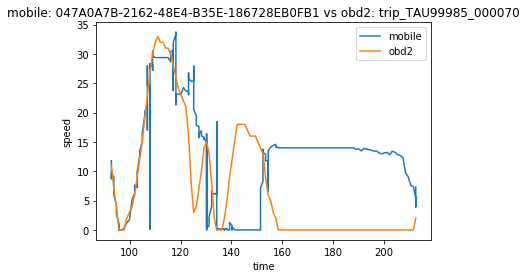

1495203347.0001 92.821
1495204218.0001 212.455


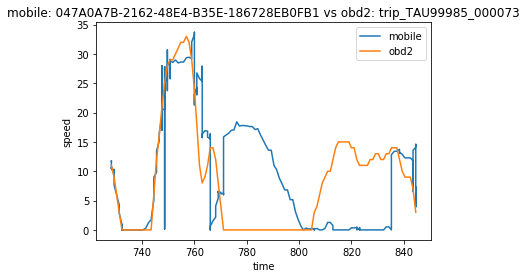

1495203347.0001 728.293
1495204218.0001 844.546


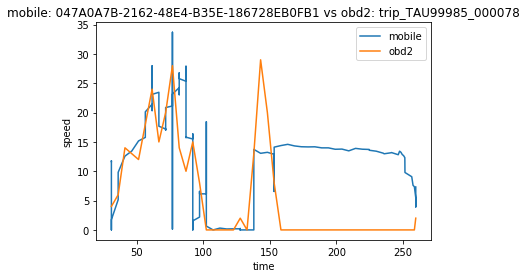

1495203347.0001 31.012
1495204218.0001 259.628


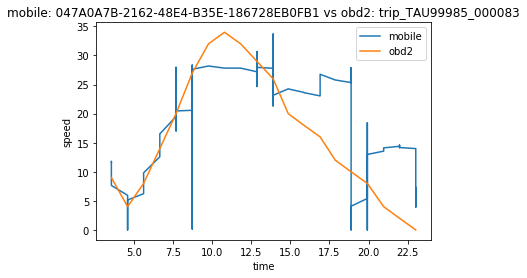

1495203347.0001 3.568
1495204218.0001 23.02


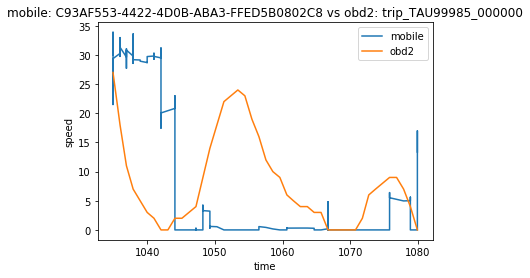

1495211821 1034.951
1495212841.0001 1079.914


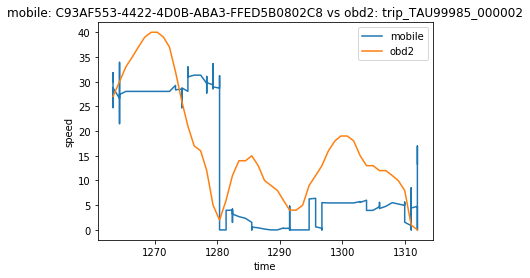

1495211821 1263.367
1495212841.0001 1311.954


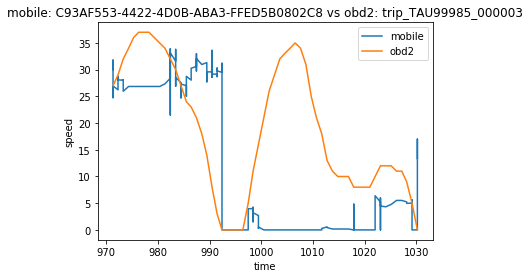

1495211821 971.279
1495212841.0001 1030.204


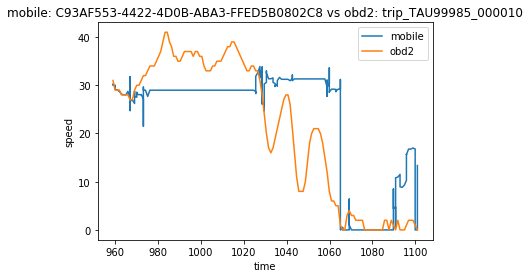

1495211821 958.877
1495212841.0001 1100.959


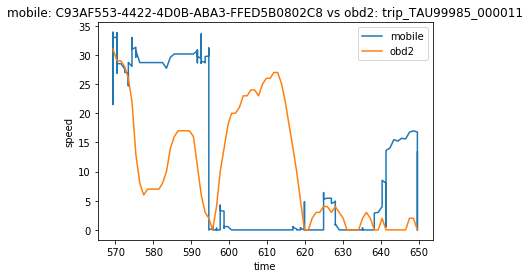

1495211821 569.354
1495212841.0001 649.657


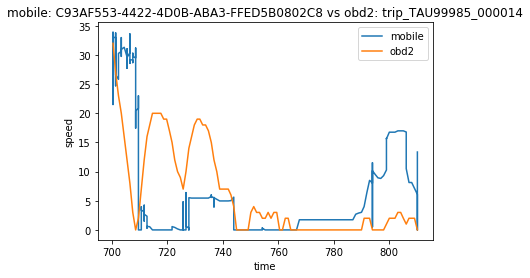

1495211821 700.478
1495212841.0001 810.111


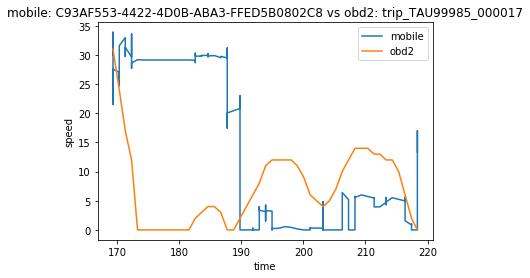

1495211821 169.302
1495212841.0001 218.367


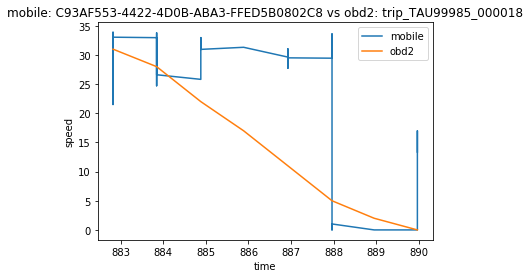

1495211821 882.824
1495212841.0001 889.962


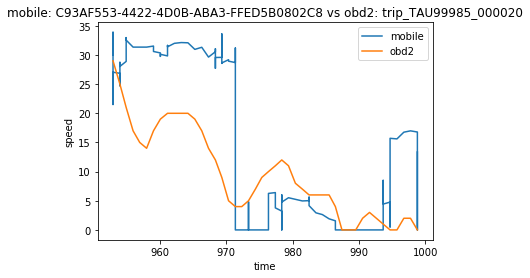

1495211821 952.977
1495212841.0001 998.784


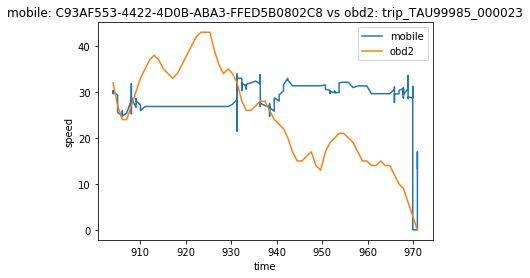

1495211821 904.012
1495212841.0001 970.948


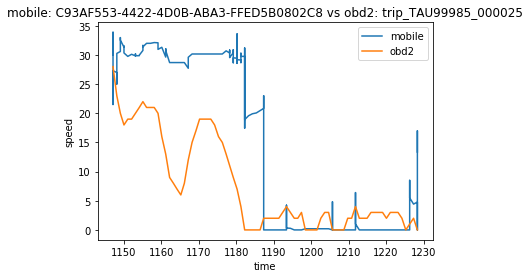

1495211821 1147.081
1495212841.0001 1228.348


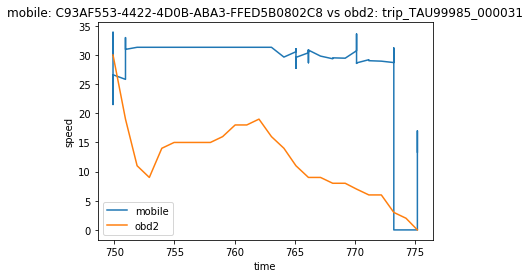

1495211821 749.897
1495212841.0001 775.187


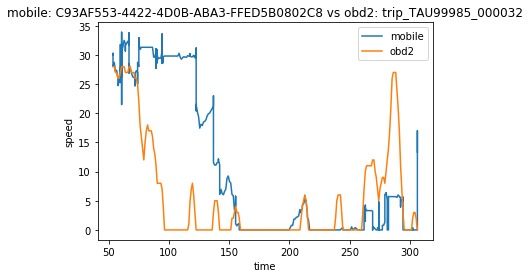

1495211821 53.71
1495212841.0001 306.204


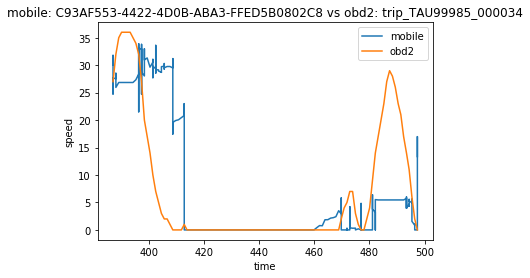

1495211821 387.028
1495212841.0001 497.39


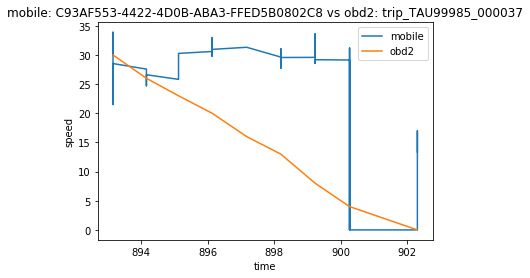

1495211821 893.147
1495212841.0001 902.304


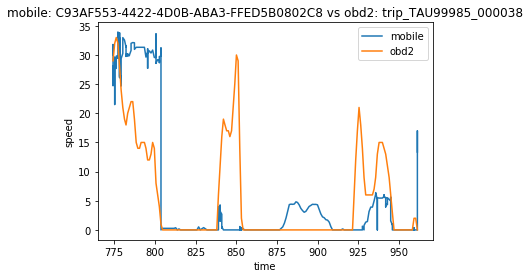

1495211821 774.27
1495212841.0001 961.395


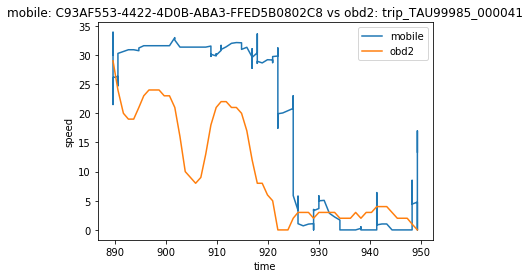

1495211821 889.577
1495212841.0001 949.386


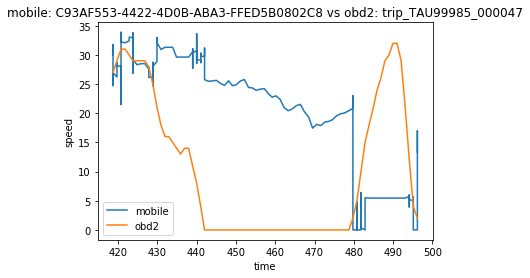

1495211821 418.739
1495212841.0001 496.16


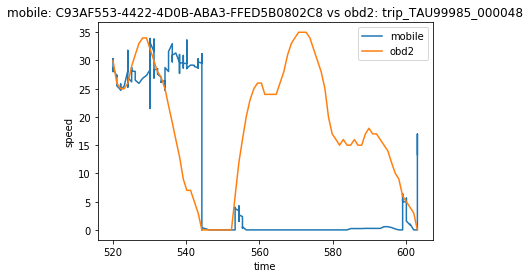

1495211821 520.115
1495212841.0001 603.023


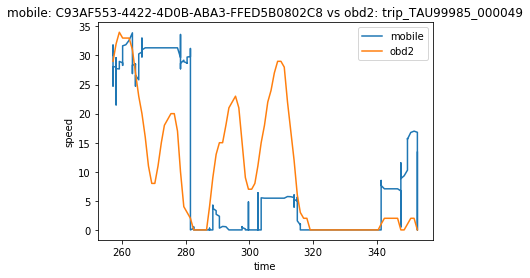

1495211821 257.184
1495212841.0001 352.727


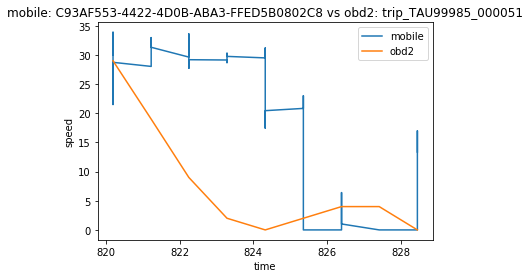

1495211821 820.191
1495212841.0001 828.453


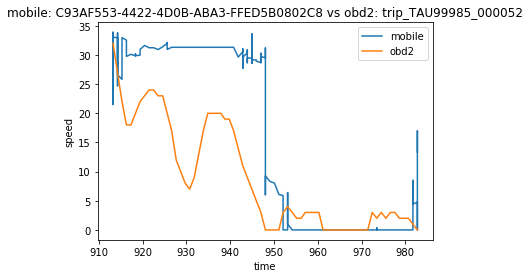

1495211821 913.232
1495212841.0001 982.754


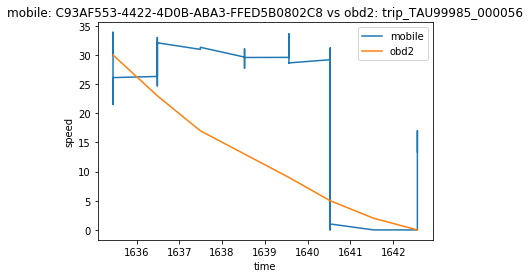

1495211821 1635.45
1495212841.0001 1642.564


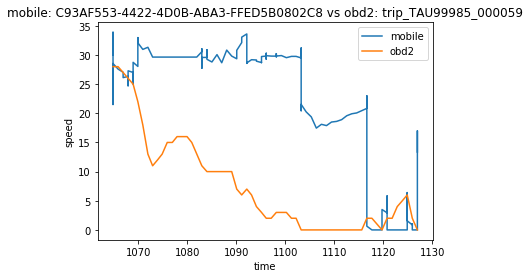

1495211821 1064.812
1495212841.0001 1126.917


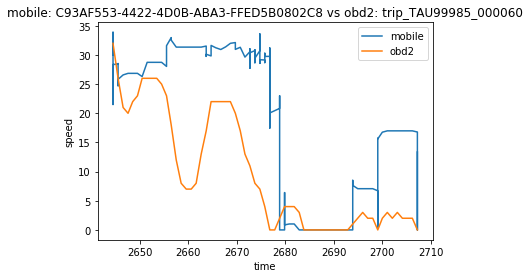

1495211821 2644.432
1495212841.0001 2707.229


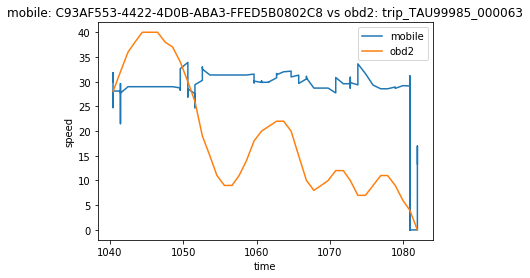

1495211821 1040.437
1495212841.0001 1081.929


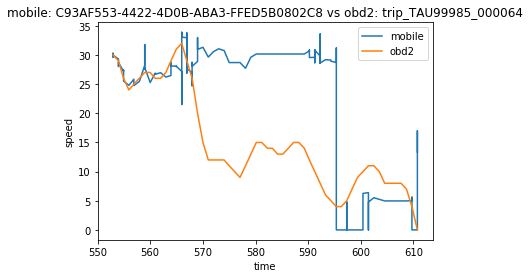

1495211821 552.934
1495212841.0001 610.745


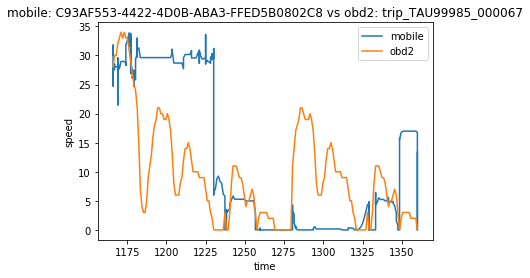

1495211821 1165.996
1495212841.0001 1359.929


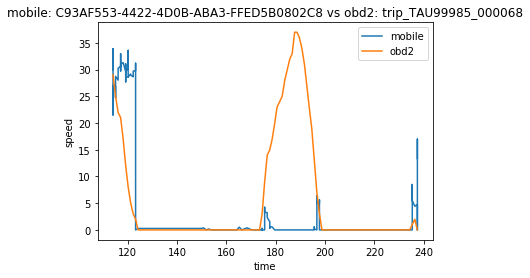

1495211821 114.003
1495212841.0001 237.42


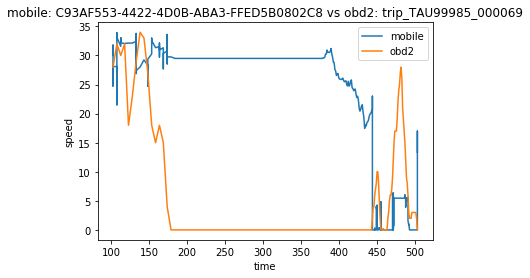

1495211821 102.336
1495212841.0001 503.208


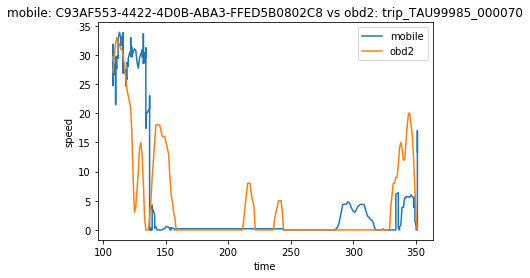

1495211821 108.002
1495212841.0001 351.1


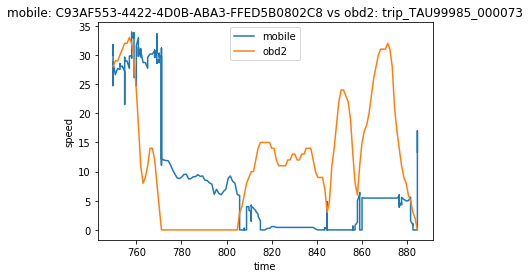

1495211821 749.671
1495212841.0001 884.52


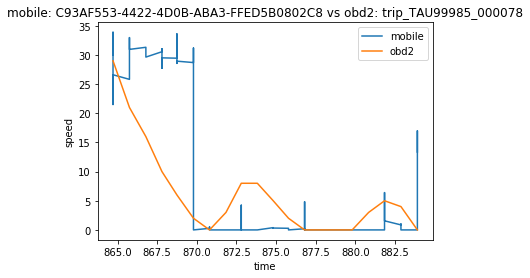

1495211821 864.715
1495212841.0001 883.919


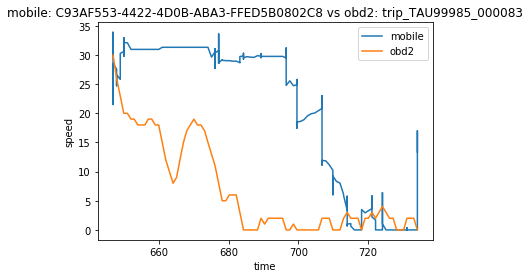

1495211821 646.73
1495212841.0001 734.225


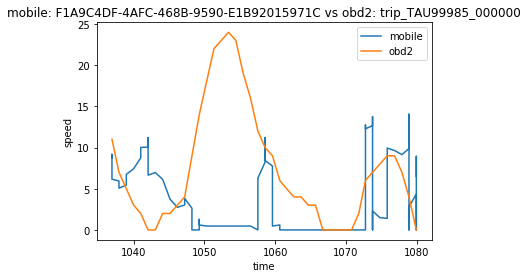

1495240772 1036.933
1495241559.0001 1079.914


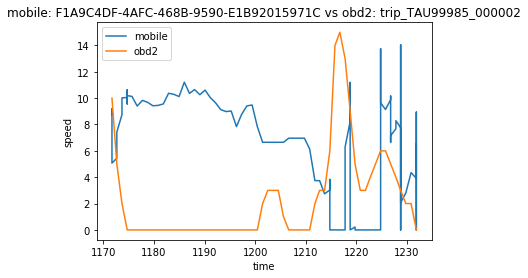

1495240772 1171.707
1495241559.0001 1231.845


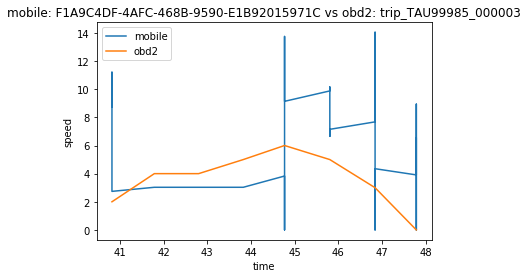

1495240772 40.819
1495241559.0001 47.786


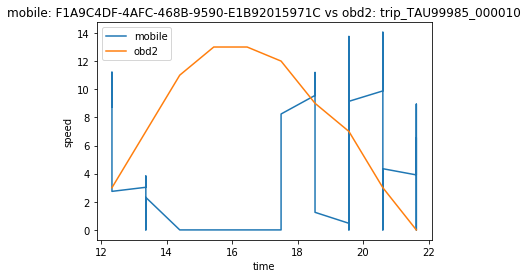

1495240772 12.329
1495241559.0001 21.626


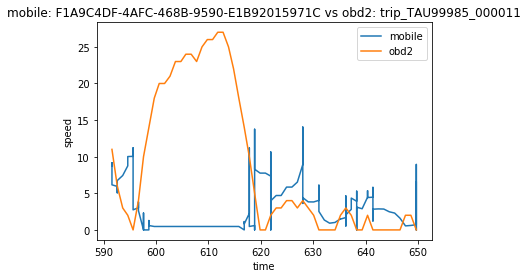

1495240772 591.611
1495241559.0001 649.657


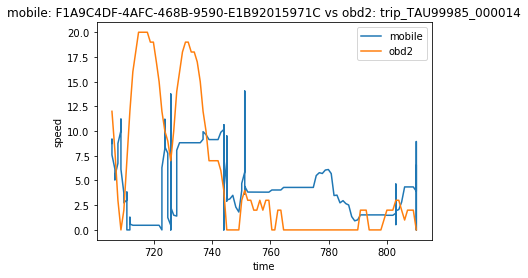

1495240772 705.545
1495241559.0001 810.111


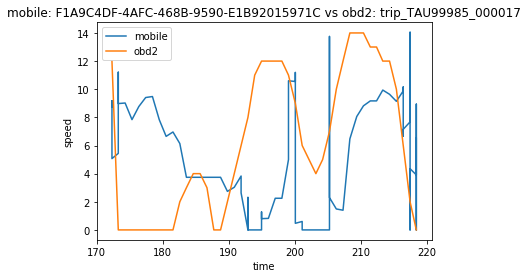

1495240772 172.295
1495241559.0001 218.367


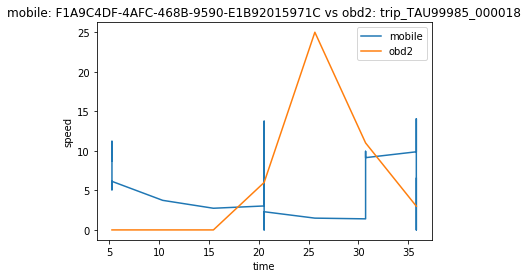

1495240772 5.261
1495241559.0001 35.816


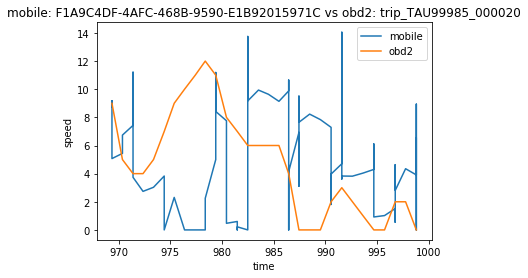

1495240772 969.351
1495241559.0001 998.784


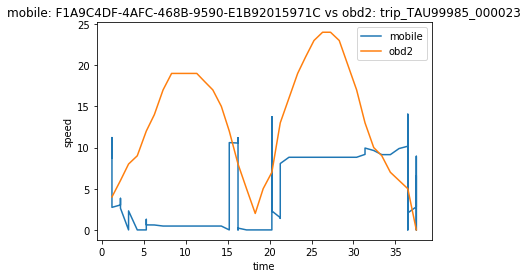

1495240772 1.226
1495241559.0001 37.487


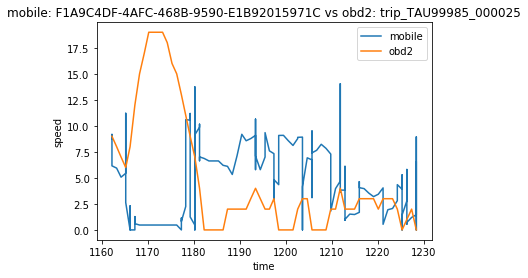

1495240772 1162.191
1495241559.0001 1228.348


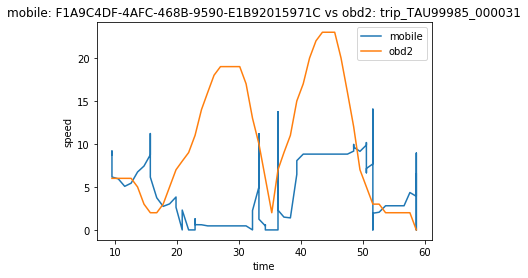

1495240772 9.501
1495241559.0001 58.605


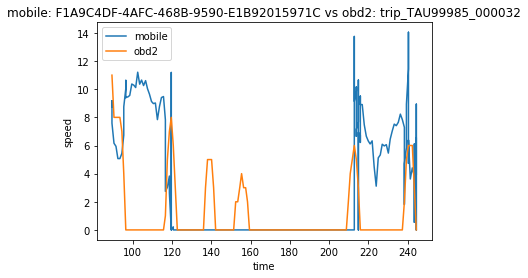

1495240772 89.386
1495241559.0001 244.407


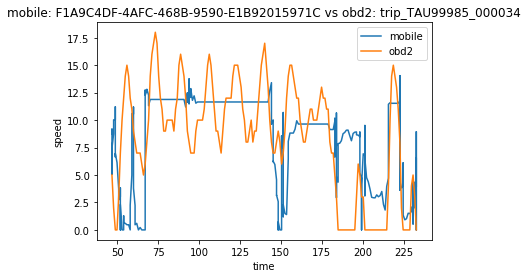

1495240772 46.67
1495241559.0001 232.824


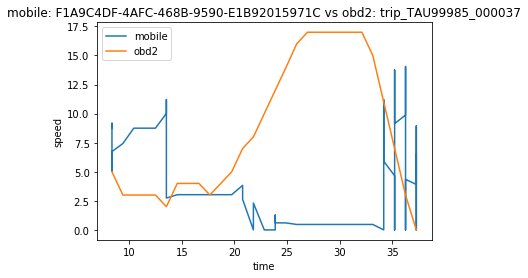

1495240772 8.372
1495241559.0001 37.273


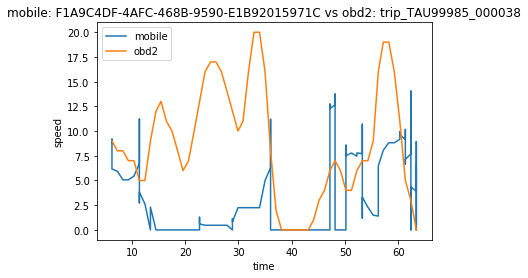

1495240772 6.27
1495241559.0001 63.356


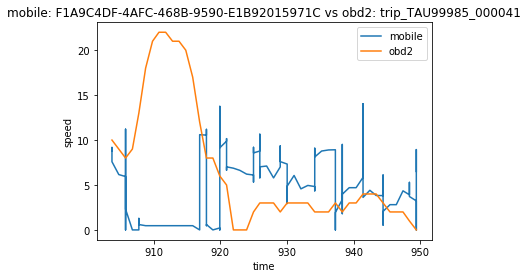

1495240772 903.769
1495241559.0001 949.386


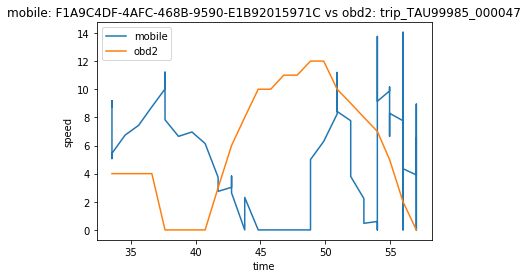

1495240772 33.562
1495241559.0001 57.003


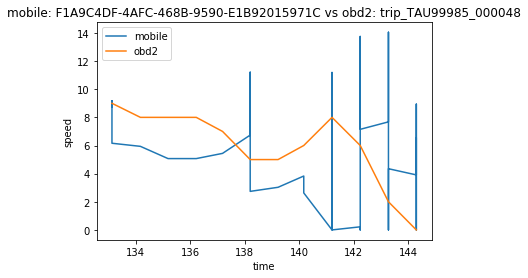

1495240772 133.132
1495241559.0001 144.305


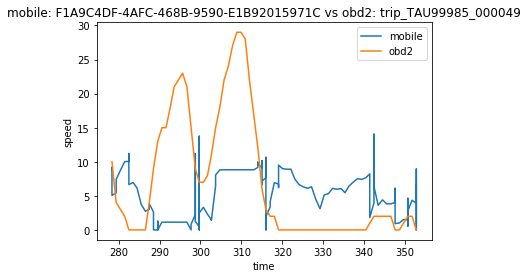

1495240772 278.368
1495241559.0001 352.727


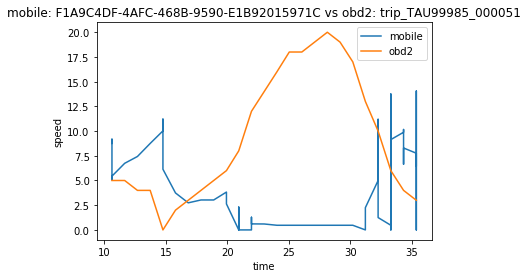

1495240772 10.607
1495241559.0001 35.373


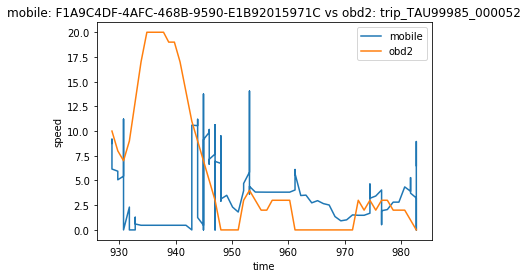

1495240772 928.685
1495241559.0001 982.754


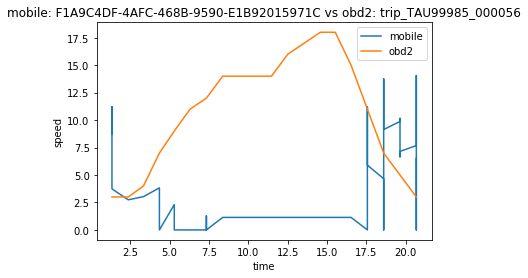

1495240772 1.332
1495241559.0001 20.678


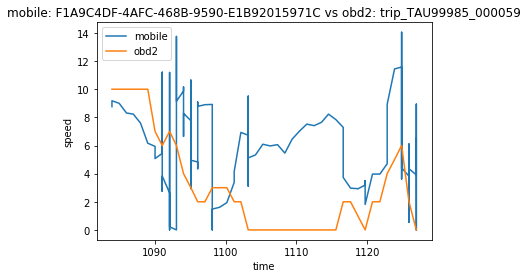

1495240772 1083.977
1495241559.0001 1126.917


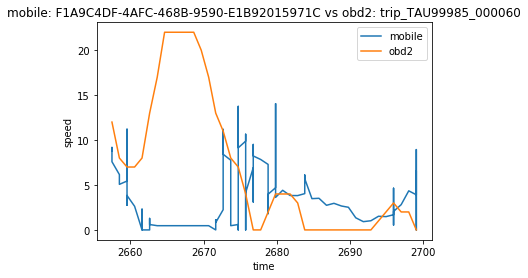

1495240772 2657.475
1495241559.0001 2699.057


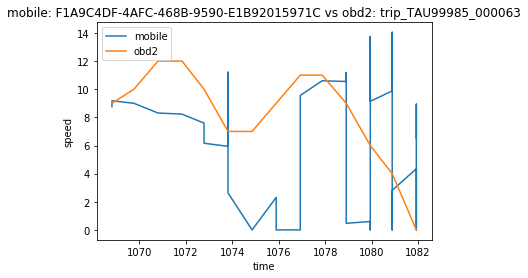

1495240772 1068.815
1495241559.0001 1081.929


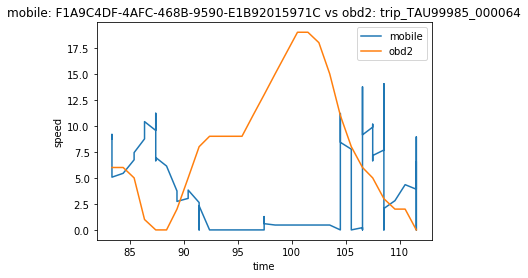

1495240772 83.35
1495241559.0001 111.526


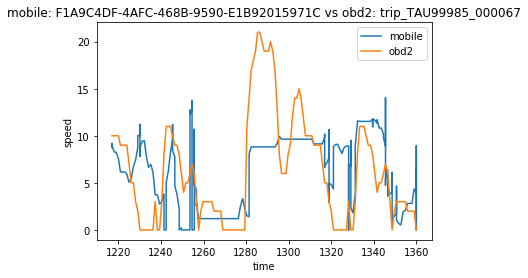

1495240772 1217.003
1495241559.0001 1359.929


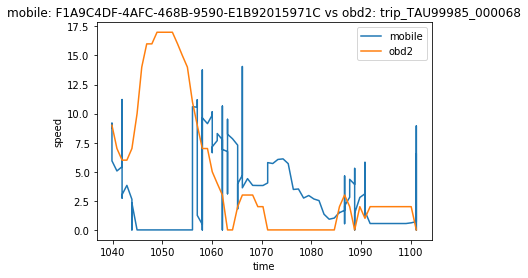

1495240772 1039.884
1495241559.0001 1101.148


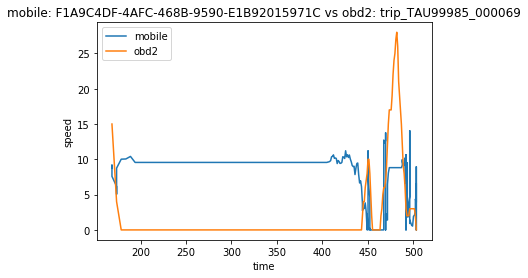

1495240772 168.582
1495241559.0001 503.208


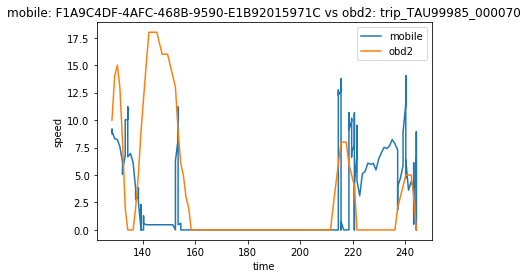

1495240772 128.201
1495241559.0001 244.231


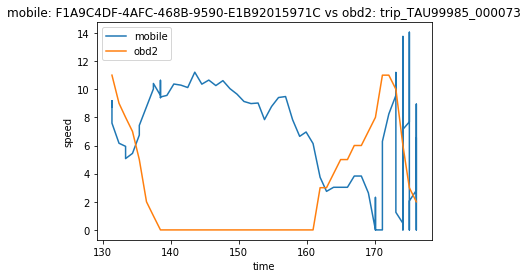

1495240772 131.38
1495241559.0001 176.101


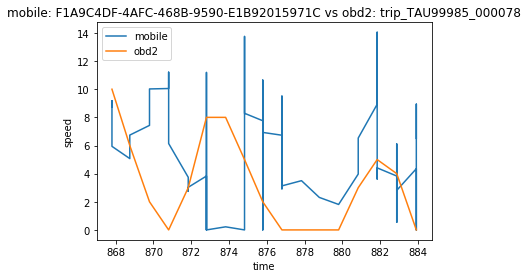

1495240772 867.803
1495241559.0001 883.919


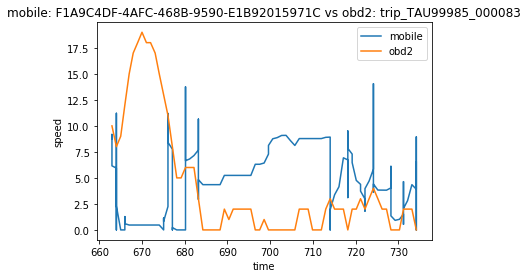

1495240772 662.949
1495241559.0001 734.225


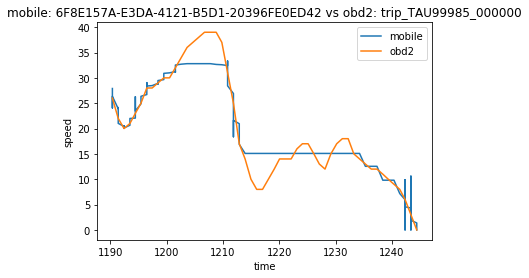

1495296884.0001 1190.374
1495297774.9993 1244.412


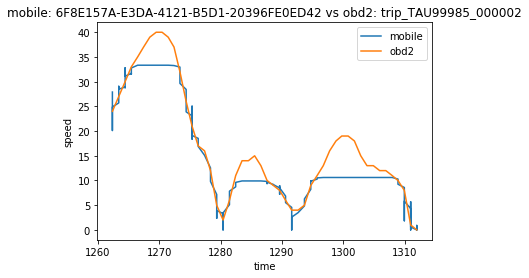

1495296884.0001 1262.33
1495297774.9993 1311.954


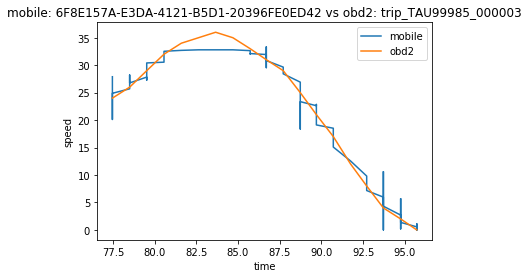

1495296884.0001 77.466
1495297774.9993 95.715


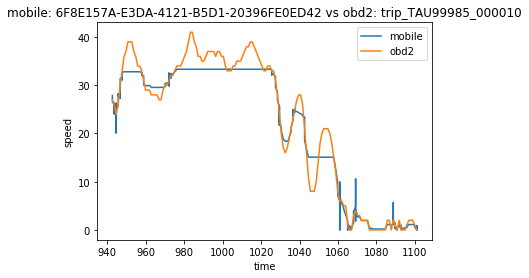

1495296884.0001 942.588
1495297774.9993 1100.959


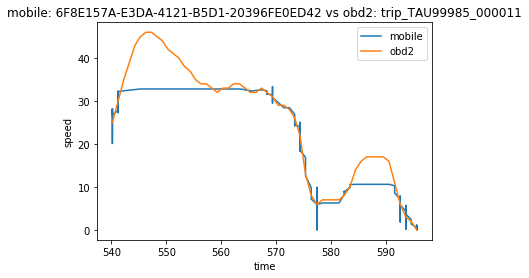

1495296884.0001 540.177
1495297774.9993 595.642


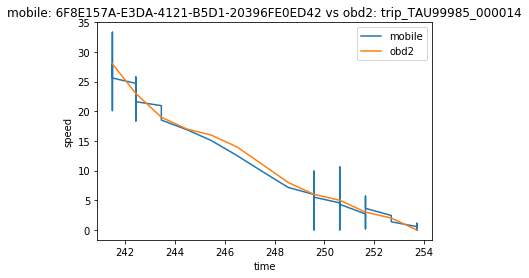

1495296884.0001 241.481
1495297774.9993 253.71


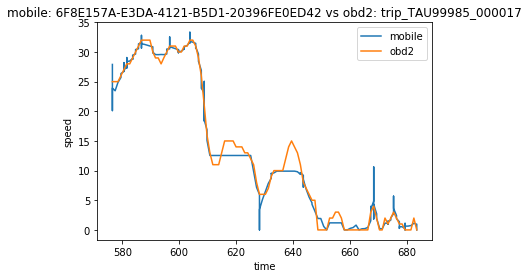

1495296884.0001 576.477
1495297774.9993 683.506


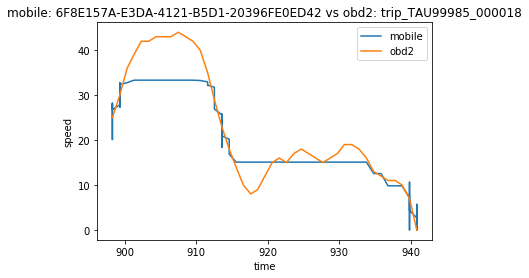

1495296884.0001 898.235
1495297774.9993 940.843


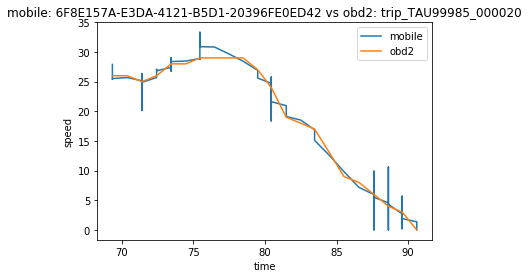

1495296884.0001 69.362
1495297774.9993 90.598


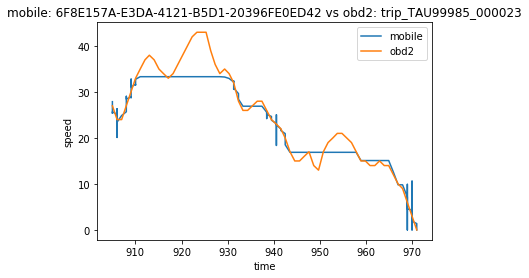

1495296884.0001 905.027
1495297774.9993 970.948


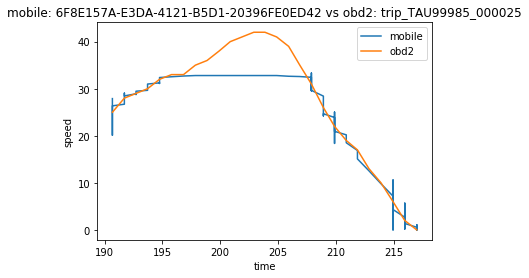

1495296884.0001 190.682
1495297774.9993 217.008


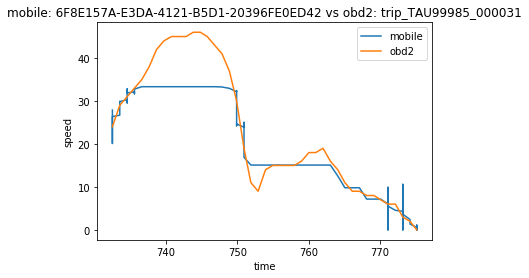

1495296884.0001 732.456
1495297774.9993 775.187


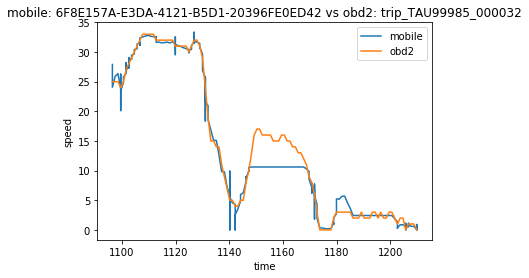

1495296884.0001 1096.469
1495297774.9993 1209.828


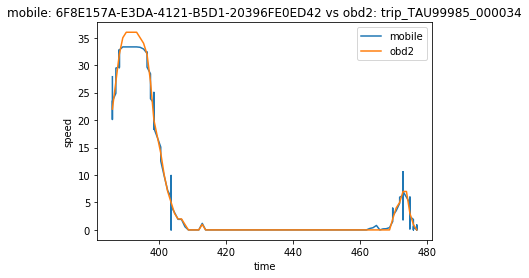

1495296884.0001 385.991
1495297774.9993 476.974


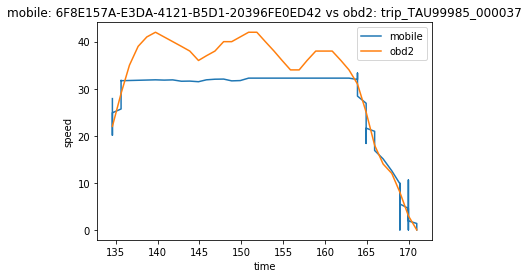

1495296884.0001 134.598
1495297774.9993 170.953


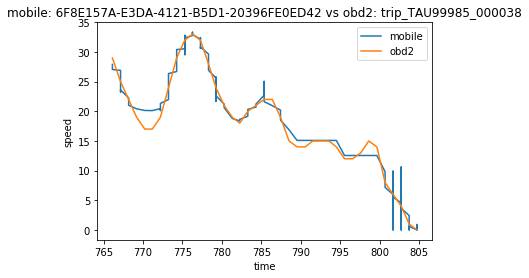

1495296884.0001 766.12
1495297774.9993 804.718


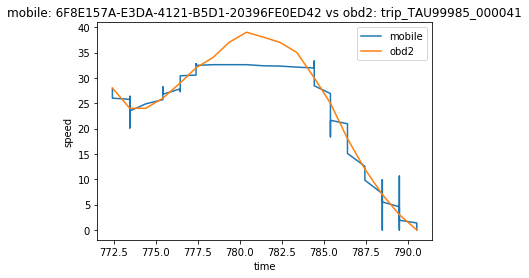

1495296884.0001 772.403
1495297774.9993 790.546


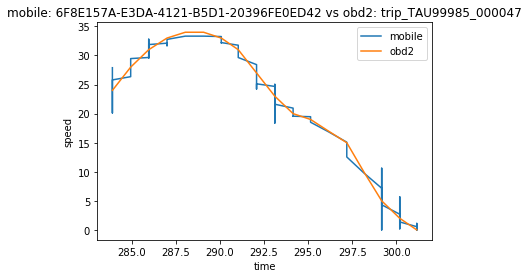

1495296884.0001 283.907
1495297774.9993 301.164


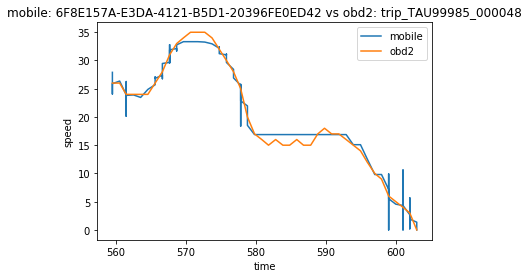

1495296884.0001 559.488
1495297774.9993 603.023


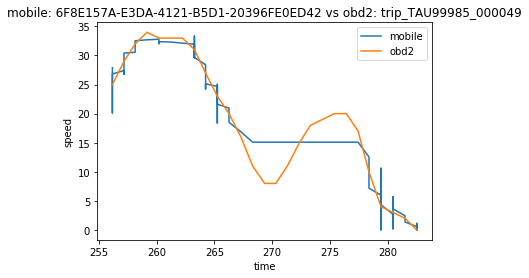

1495296884.0001 256.183
1495297774.9993 282.499


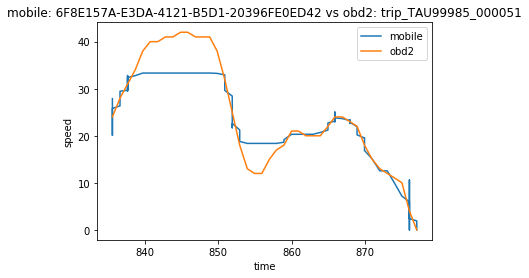

1495296884.0001 835.592
1495297774.9993 877.032


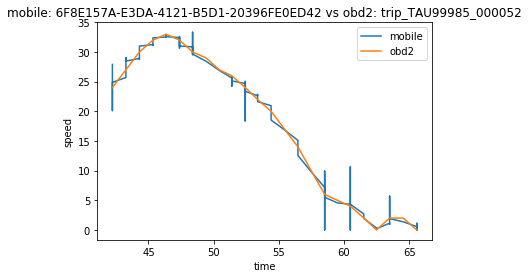

1495296884.0001 42.234
1495297774.9993 65.58


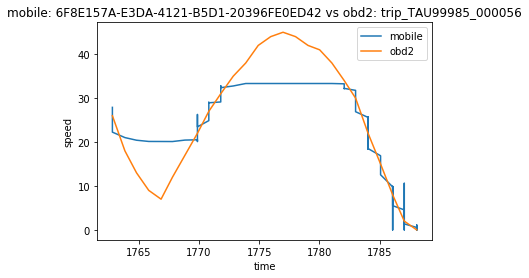

1495296884.0001 1762.819
1495297774.9993 1788.075


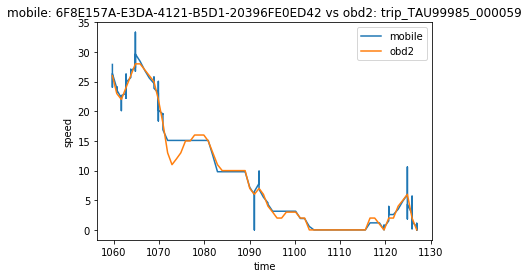

1495296884.0001 1059.736
1495297774.9993 1126.917


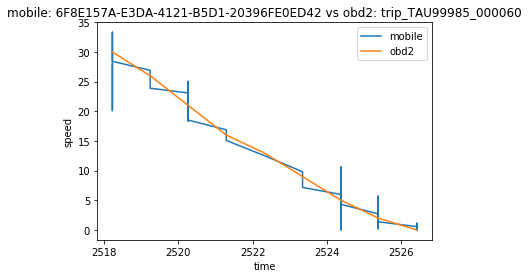

1495296884.0001 2518.228
1495297774.9993 2526.417


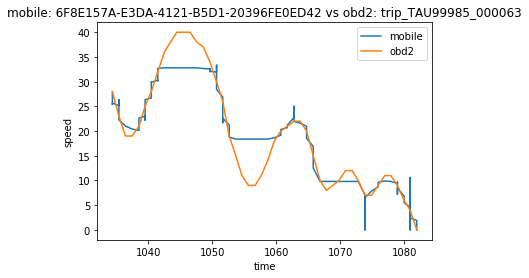

1495296884.0001 1034.357
1495297774.9993 1081.929


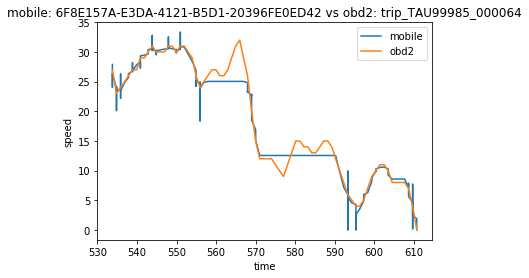

1495296884.0001 533.788
1495297774.9993 610.745


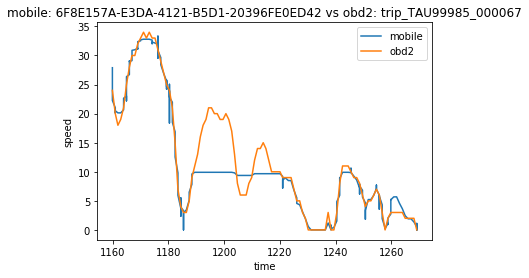

1495296884.0001 1159.905
1495297774.9993 1269.078


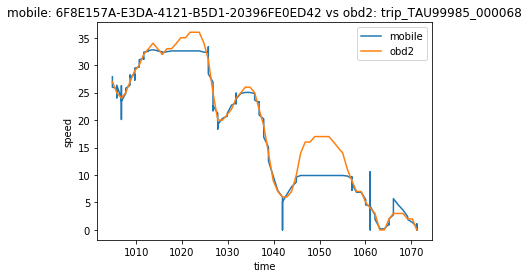

1495296884.0001 1004.783
1495297774.9993 1071.229


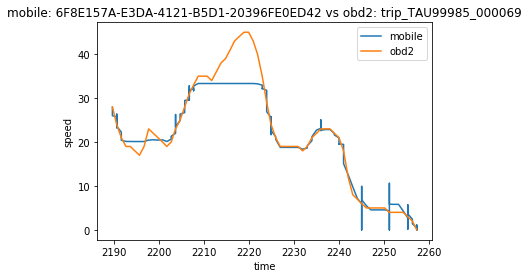

1495296884.0001 2189.585
1495297774.9993 2257.28


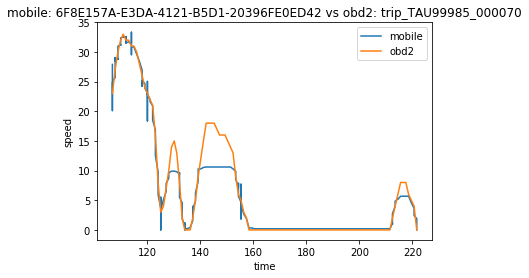

1495296884.0001 106.965
1495297774.9993 221.616


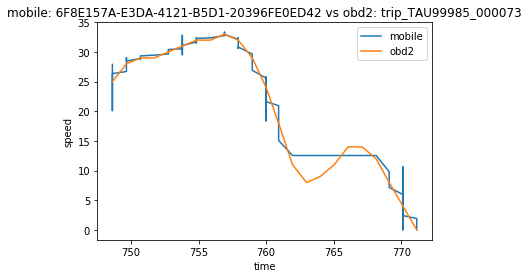

1495296884.0001 748.634
1495297774.9993 771.129


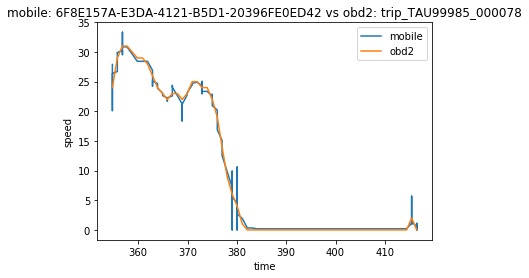

1495296884.0001 354.751
1495297774.9993 416.479


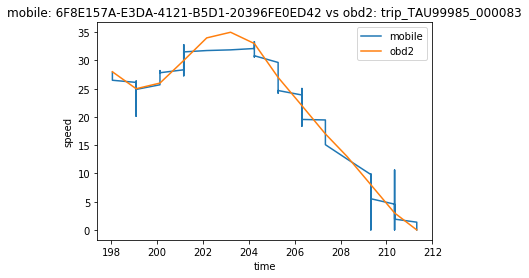

1495296884.0001 198.054
1495297774.9993 211.319


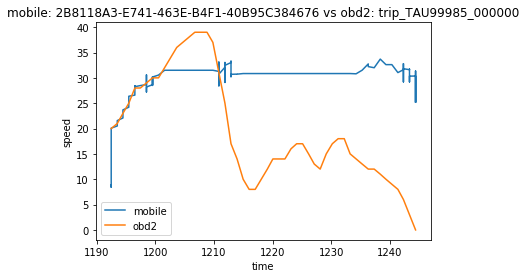

1495388184.0058 1192.446
1495388712.0001 1244.412


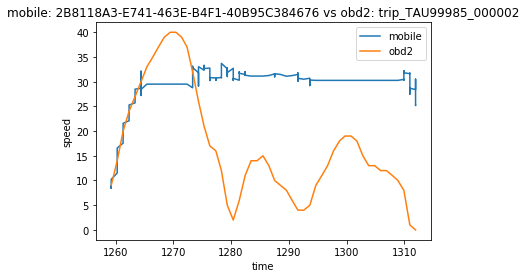

1495388184.0058 1259.235
1495388712.0001 1311.954


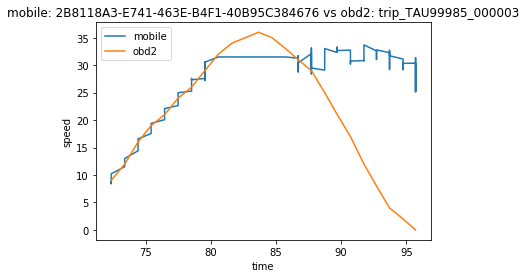

1495388184.0058 72.326
1495388712.0001 95.715


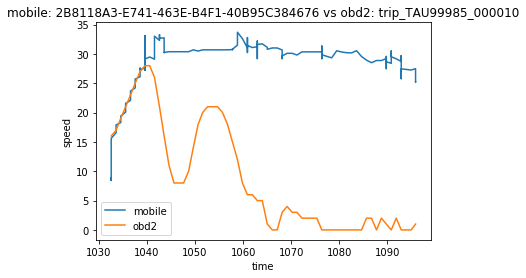

1495388184.0058 1032.56
1495388712.0001 1095.847


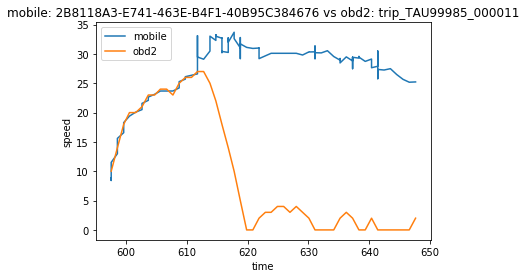

1495388184.0058 597.63
1495388712.0001 647.585


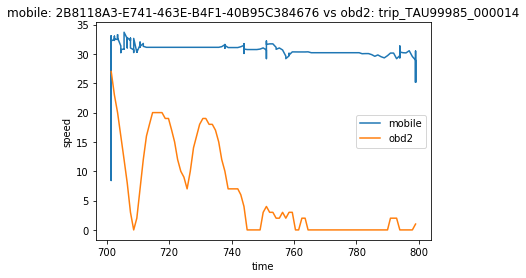

1495388184.0058 701.423
1495388712.0001 798.967


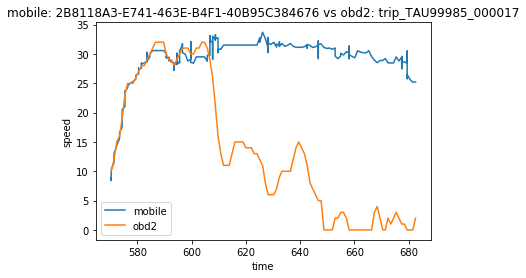

1495388184.0058 570.396
1495388712.0001 682.492


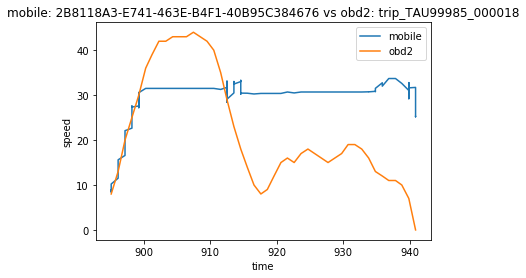

1495388184.0058 895.122
1495388712.0001 940.843


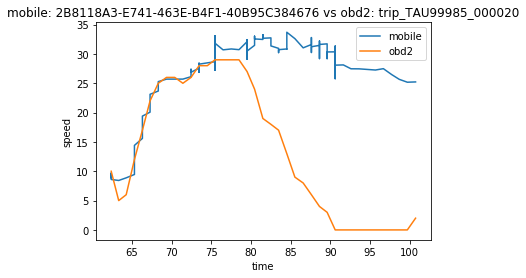

1495388184.0058 62.399
1495388712.0001 100.716


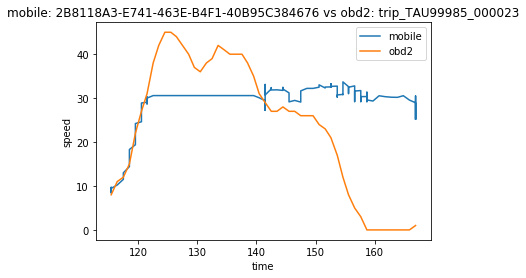

1495388184.0058 115.438
1495388712.0001 166.908


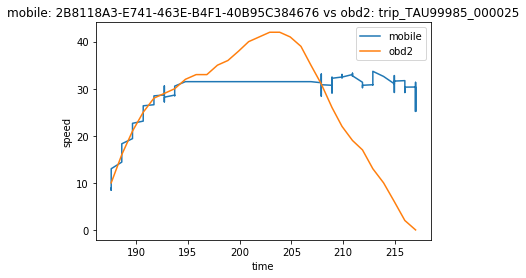

1495388184.0058 187.587
1495388712.0001 217.008


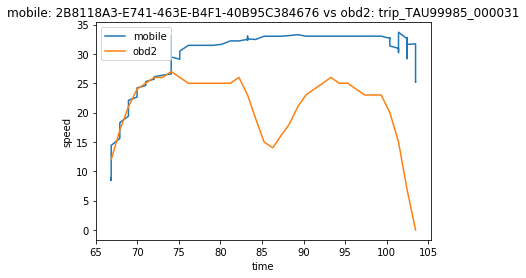

1495388184.0058 66.871
1495388712.0001 103.462


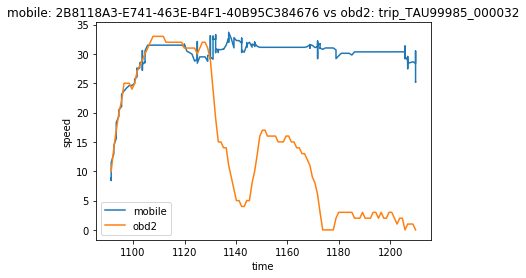

1495388184.0058 1091.487
1495388712.0001 1209.828


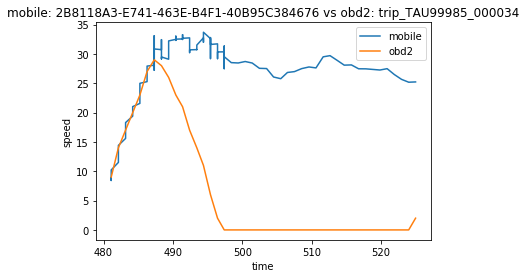

1495388184.0058 481.104
1495388712.0001 524.96


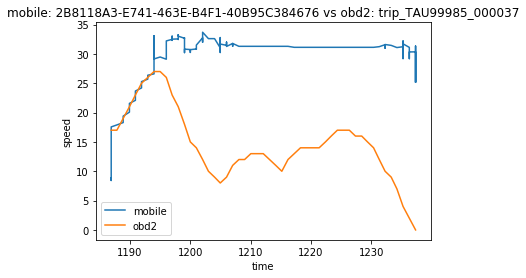

1495388184.0058 1186.877
1495388712.0001 1237.349


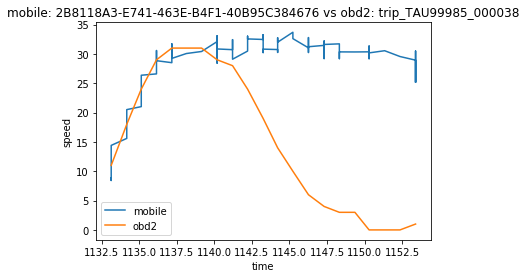

1495388184.0058 1133.131
1495388712.0001 1153.4


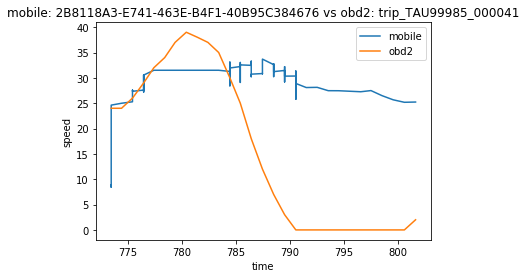

1495388184.0058 773.44
1495388712.0001 801.641


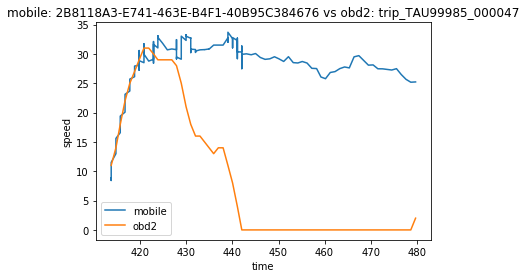

1495388184.0058 413.664
1495388712.0001 479.755


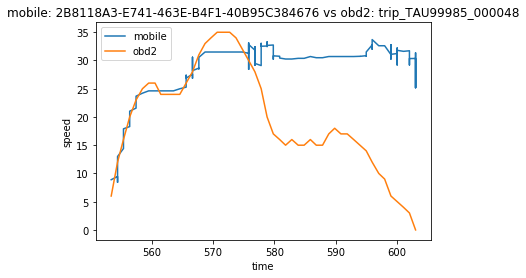

1495388184.0058 553.376
1495388712.0001 603.023


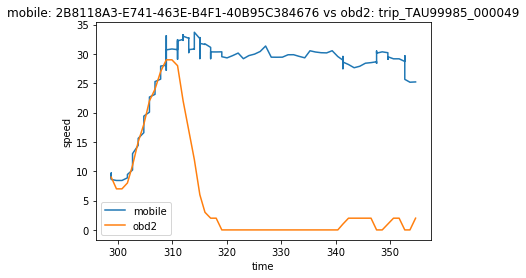

1495388184.0058 298.731
1495388712.0001 354.711


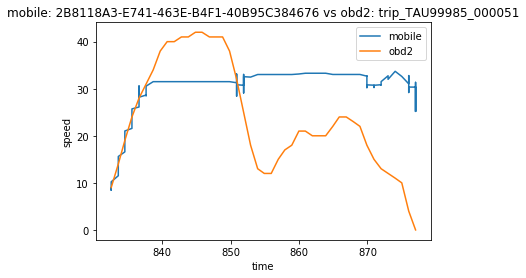

1495388184.0058 832.563
1495388712.0001 877.032


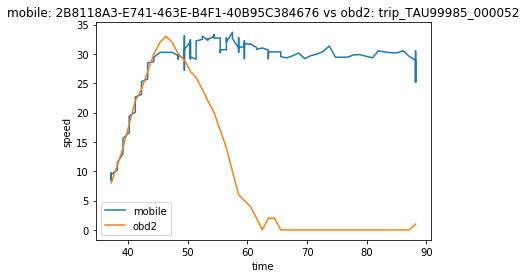

1495388184.0058 37.158
1495388712.0001 88.178


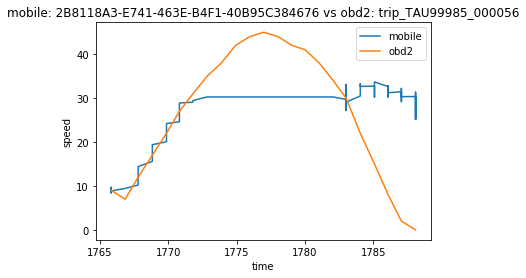

1495388184.0058 1765.836
1495388712.0001 1788.075


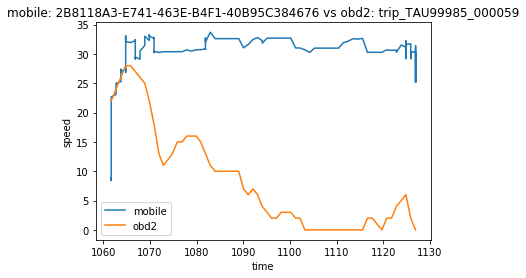

1495388184.0058 1061.716
1495388712.0001 1126.917


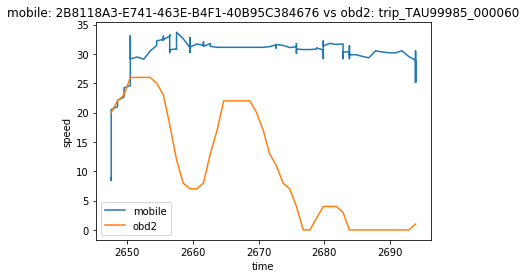

1495388184.0058 2647.529
1495388712.0001 2693.89


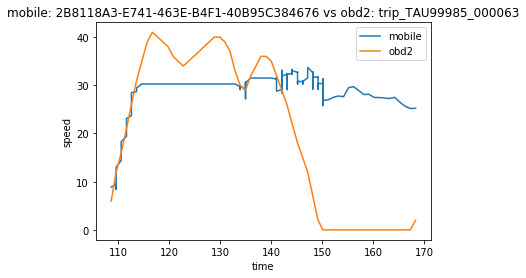

1495388184.0058 108.597
1495388712.0001 168.311


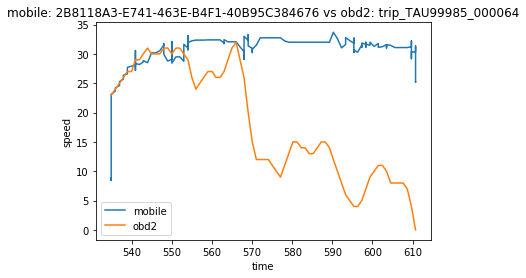

1495388184.0058 534.825
1495388712.0001 610.745


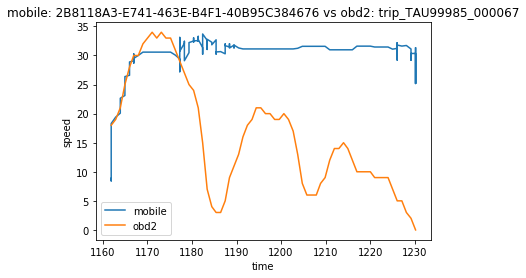

1495388184.0058 1161.885
1495388712.0001 1230.161


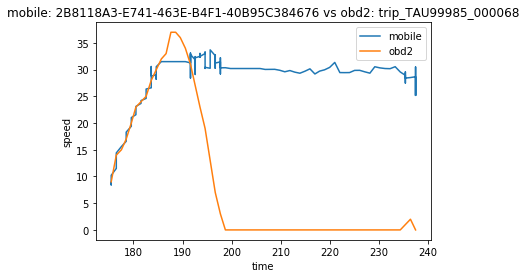

1495388184.0058 175.49
1495388712.0001 237.42


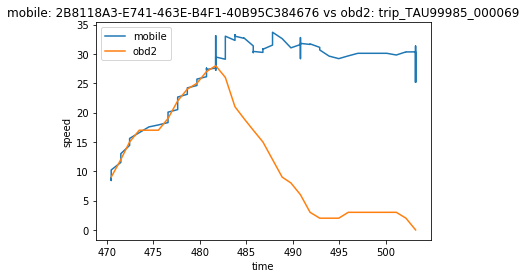

1495388184.0058 470.471
1495388712.0001 503.208


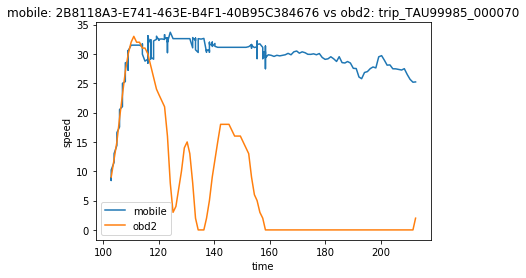

1495388184.0058 102.919
1495388712.0001 212.455


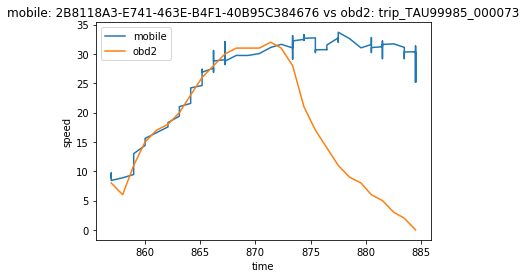

1495388184.0058 856.923
1495388712.0001 884.52


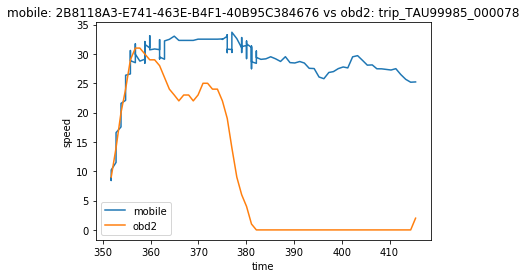

1495388184.0058 351.735
1495388712.0001 415.444


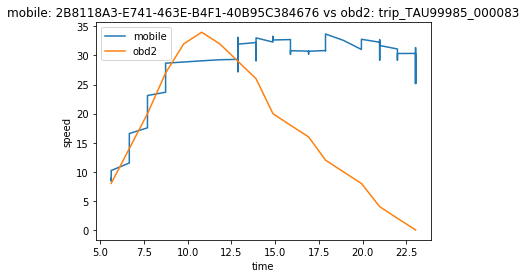

1495388184.0058 5.627
1495388712.0001 23.02


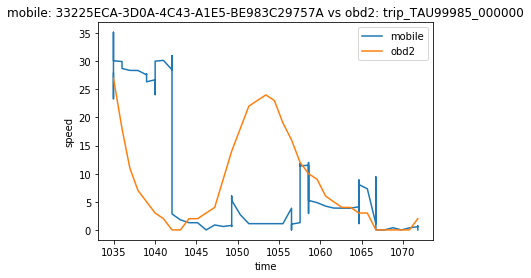

1495391984.0001 1034.951
1495392689.0001 1071.789


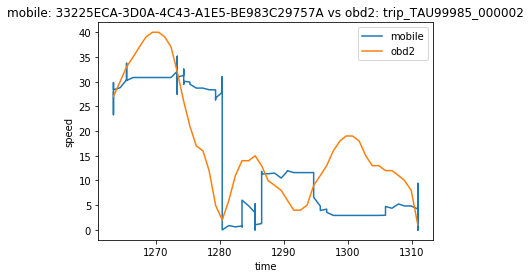

1495391984.0001 1263.367
1495392689.0001 1310.964


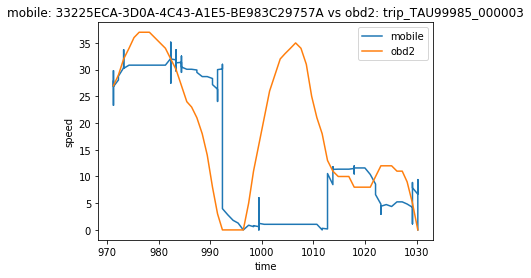

1495391984.0001 971.279
1495392689.0001 1030.204


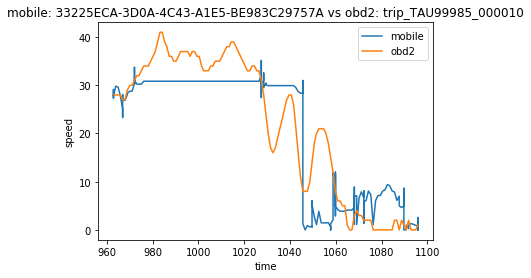

1495391984.0001 962.86
1495392689.0001 1095.847


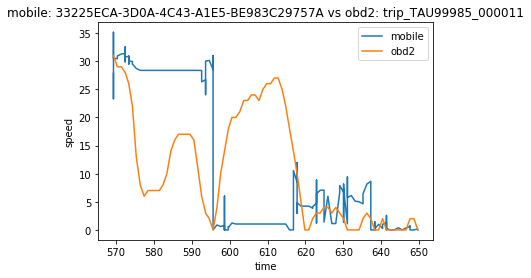

1495391984.0001 569.354
1495392689.0001 649.657


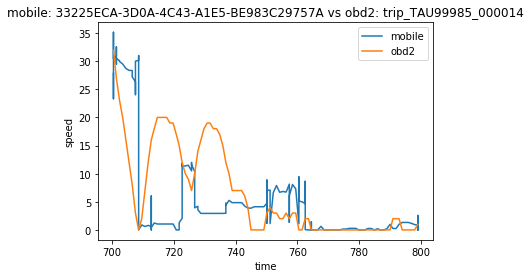

1495391984.0001 700.478
1495392689.0001 798.967


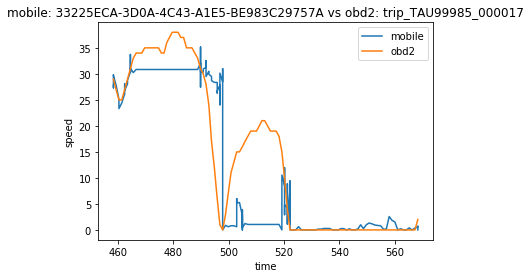

1495391984.0001 458.461
1495392689.0001 568.337


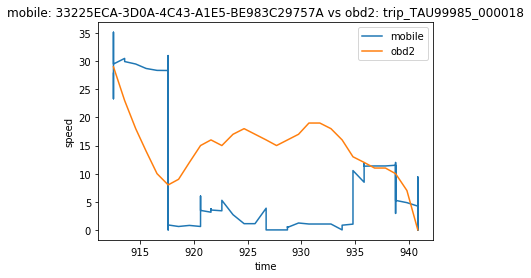

1495391984.0001 912.513
1495392689.0001 940.843


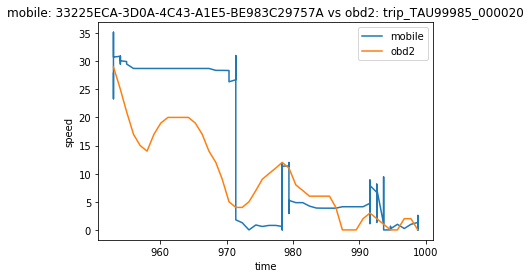

1495391984.0001 952.977
1495392689.0001 998.784


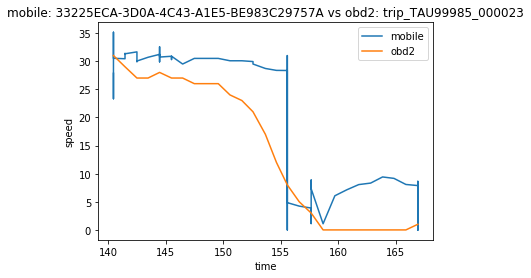

1495391984.0001 140.466
1495392689.0001 166.908


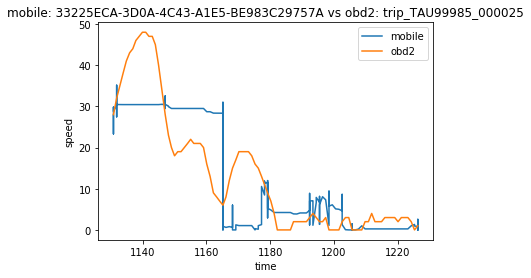

1495391984.0001 1130.852
1495392689.0001 1226.29


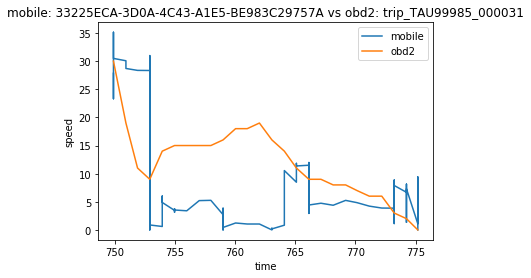

1495391984.0001 749.897
1495392689.0001 775.187


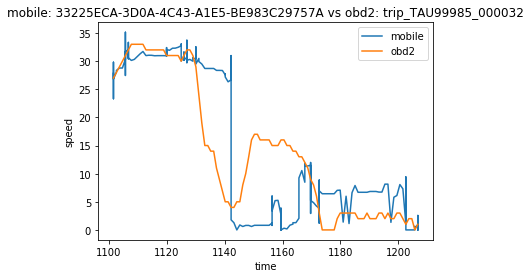

1495391984.0001 1101.546
1495392689.0001 1206.765


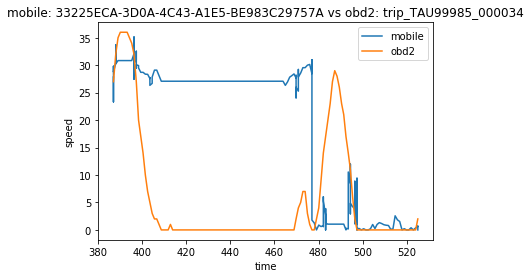

1495391984.0001 387.028
1495392689.0001 524.96


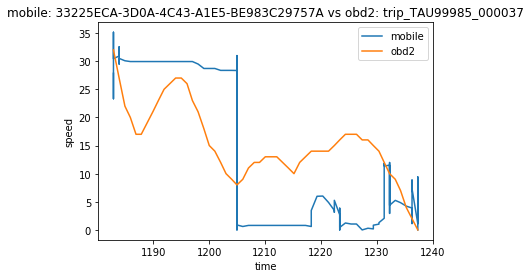

1495391984.0001 1182.841
1495392689.0001 1237.349


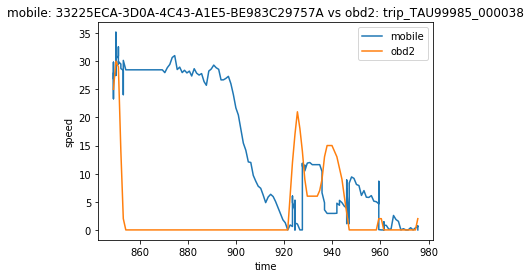

1495391984.0001 849.129
1495392689.0001 975.53


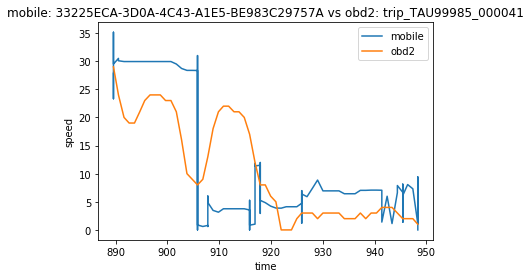

1495391984.0001 889.577
1495392689.0001 948.35


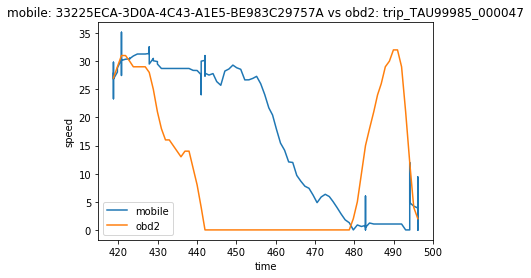

1495391984.0001 418.739
1495392689.0001 496.16


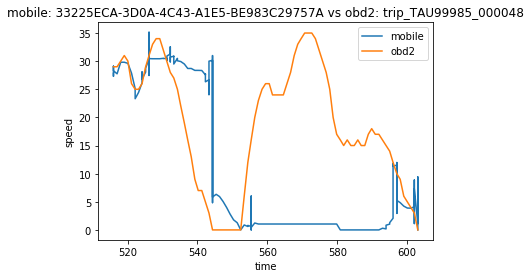

1495391984.0001 515.983
1495392689.0001 603.023


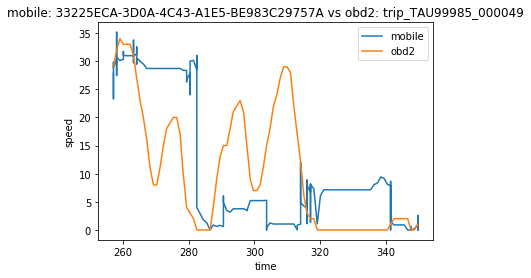

1495391984.0001 257.184
1495392689.0001 349.615


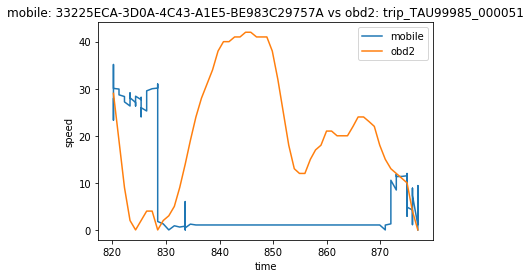

1495391984.0001 820.191
1495392689.0001 877.032


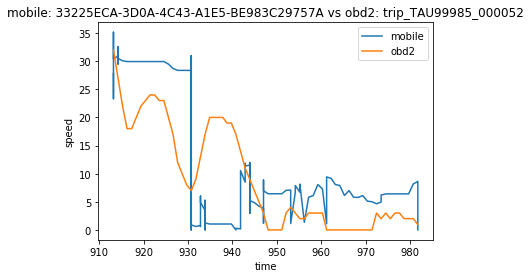

1495391984.0001 913.232
1495392689.0001 981.73


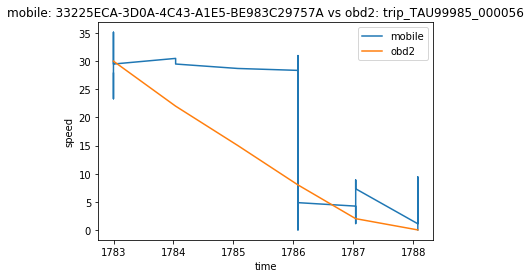

1495391984.0001 1782.999
1495392689.0001 1788.075


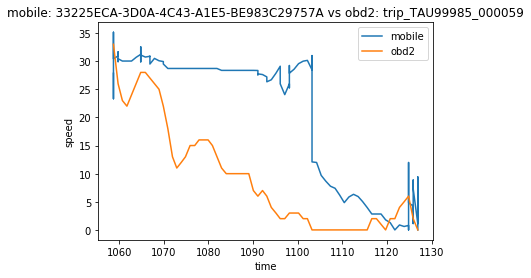

1495391984.0001 1058.7
1495392689.0001 1126.917


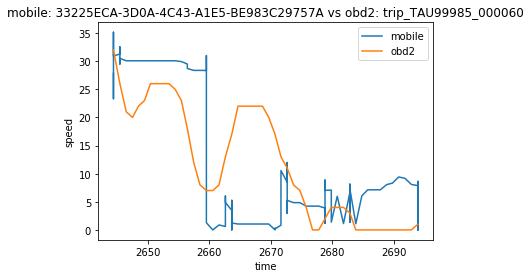

1495391984.0001 2644.432
1495392689.0001 2693.89


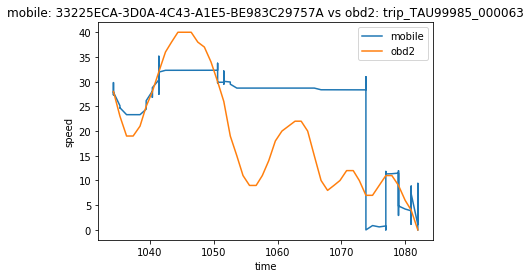

1495391984.0001 1034.357
1495392689.0001 1081.929


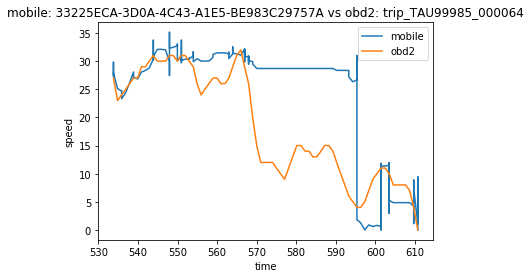

1495391984.0001 533.788
1495392689.0001 610.745


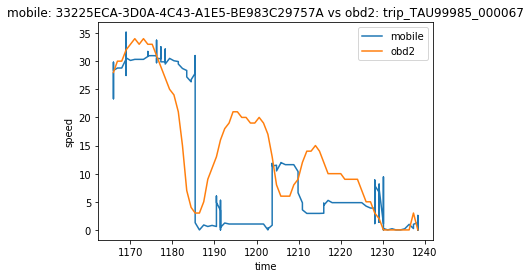

1495391984.0001 1165.996
1495392689.0001 1238.332


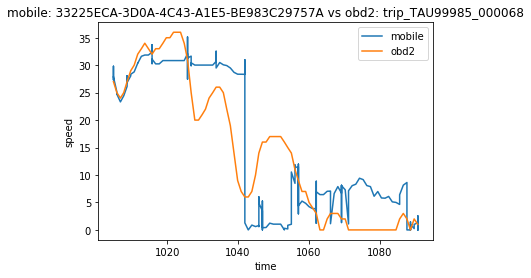

1495391984.0001 1004.783
1495392689.0001 1090.813


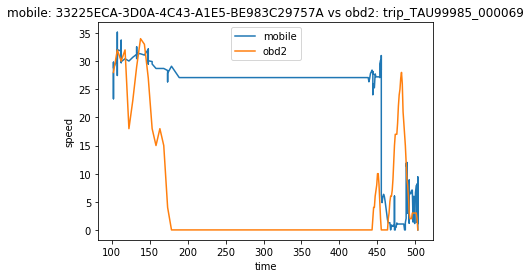

1495391984.0001 102.336
1495392689.0001 503.208


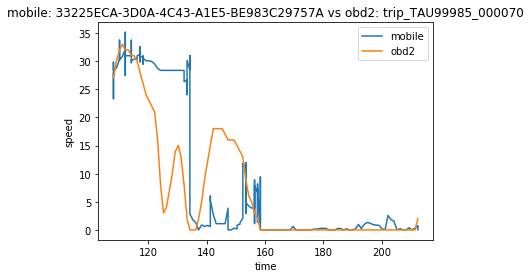

1495391984.0001 108.002
1495392689.0001 212.455


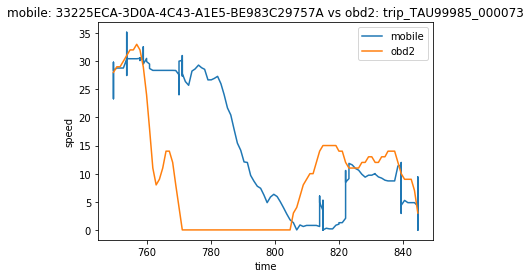

1495391984.0001 749.671
1495392689.0001 844.546


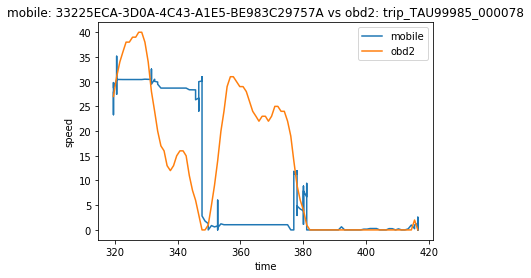

1495391984.0001 319.564
1495392689.0001 416.479


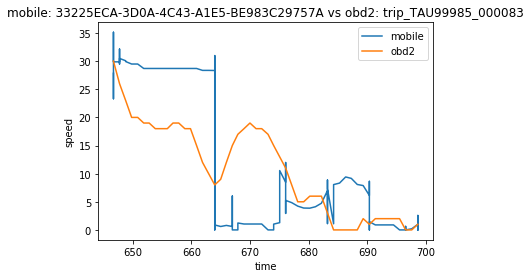

1495391984.0001 646.73
1495392689.0001 698.582


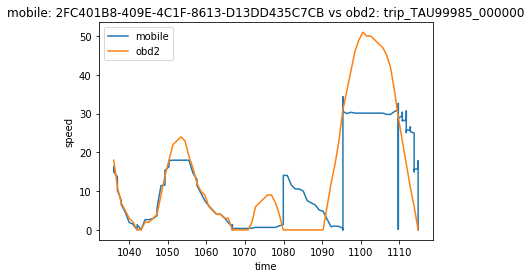

1495494020.0001 1035.989
1495495128.0002 1114.849


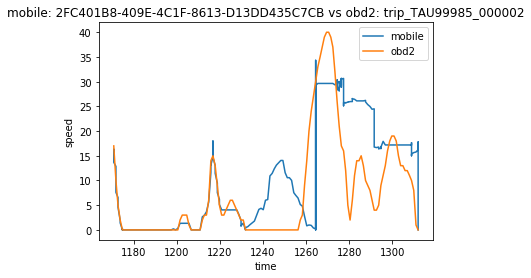

1495494020.0001 1170.706
1495495128.0002 1311.954


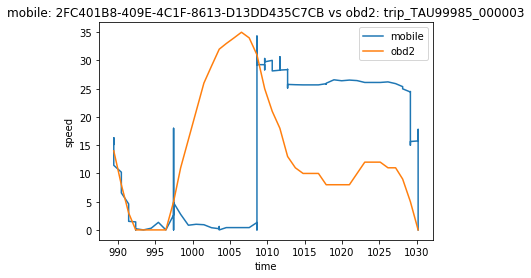

1495494020.0001 989.438
1495495128.0002 1030.204


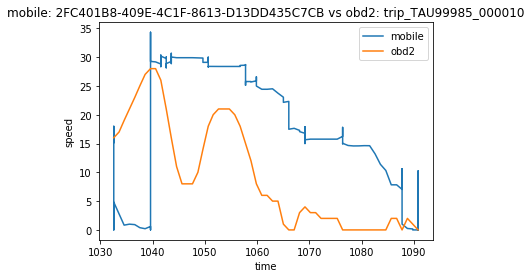

1495494020.0001 1032.56
1495495128.0002 1090.793


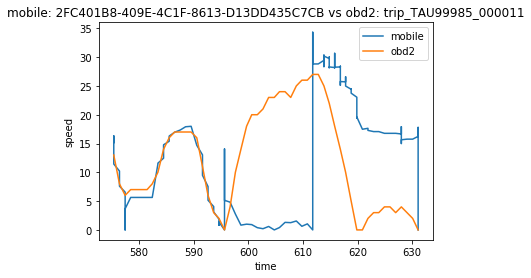

1495494020.0001 575.373
1495495128.0002 631.079


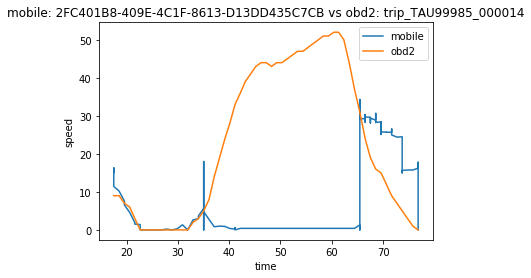

1495494020.0001 17.518
1495495128.0002 76.83


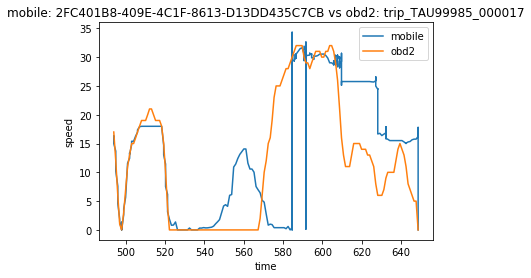

1495494020.0001 493.869
1495495128.0002 648.738


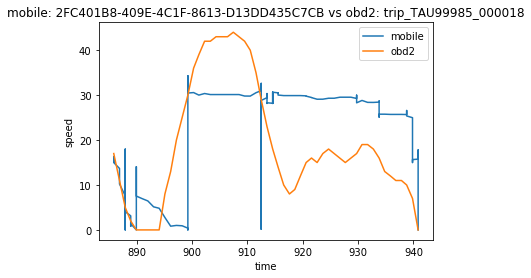

1495494020.0001 885.887
1495495128.0002 940.843


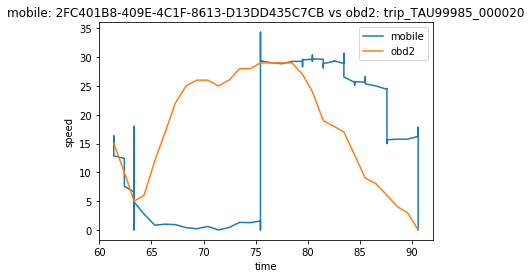

1495494020.0001 61.383
1495495128.0002 90.598


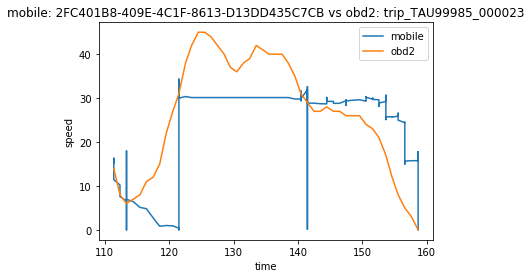

1495494020.0001 111.378
1495495128.0002 158.678


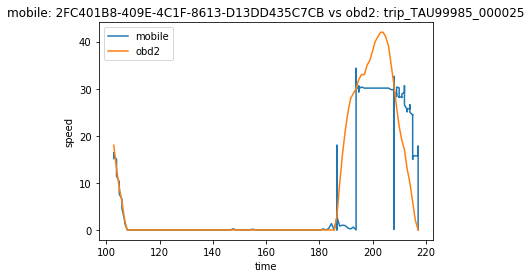

1495494020.0001 102.812
1495495128.0002 217.008


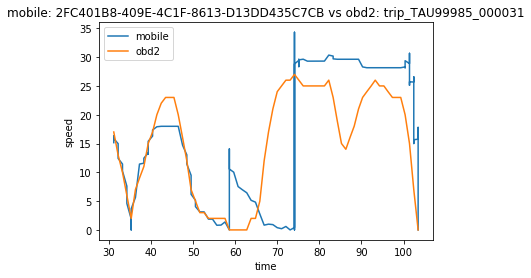

1495494020.0001 31.139
1495495128.0002 103.462


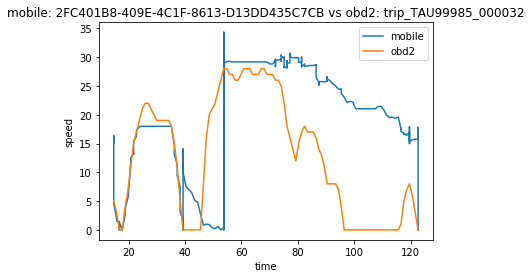

1495494020.0001 14.69
1495495128.0002 122.678


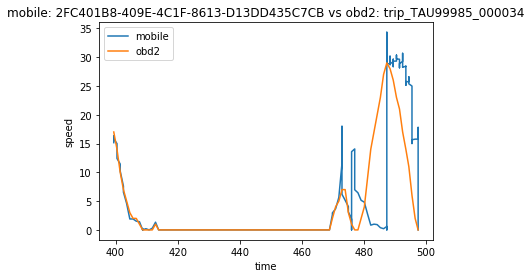

1495494020.0001 399.41
1495495128.0002 497.39


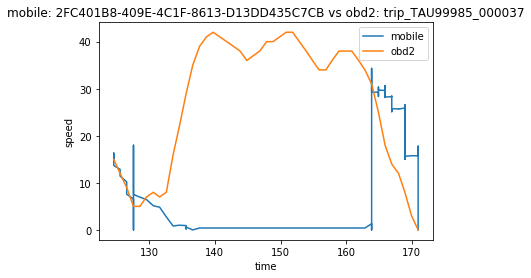

1495494020.0001 124.611
1495495128.0002 170.953


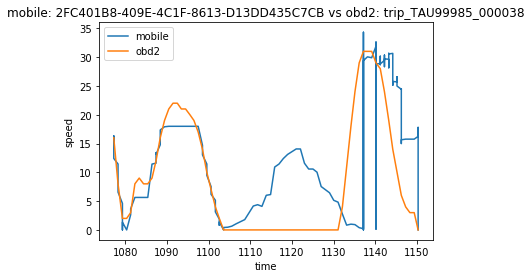

1495494020.0001 1077.205
1495495128.0002 1150.305


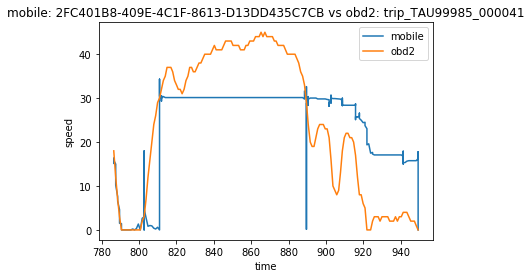

1495494020.0001 786.416
1495495128.0002 949.386


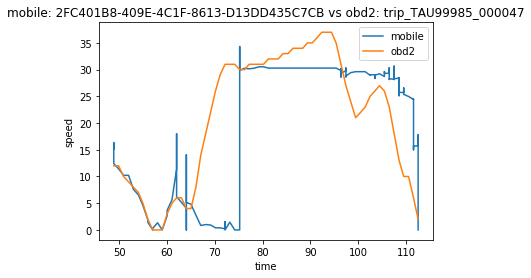

1495494020.0001 48.854
1495495128.0002 112.514


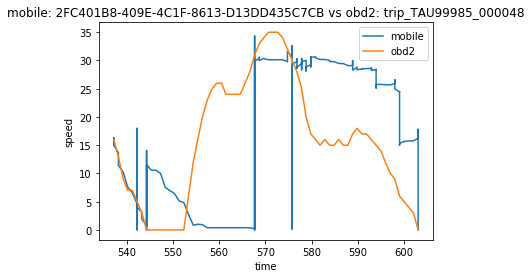

1495494020.0001 537.222
1495495128.0002 603.023


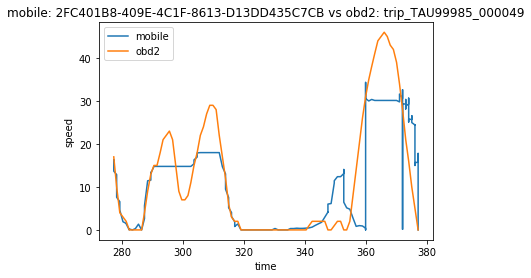

1495494020.0001 277.424
1495495128.0002 377.072


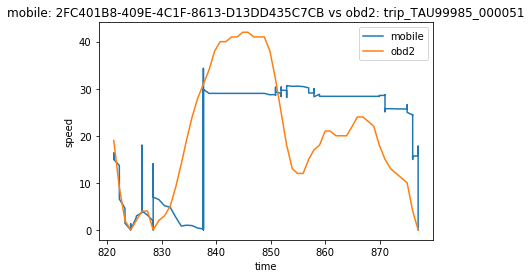

1495494020.0001 821.227
1495495128.0002 877.032


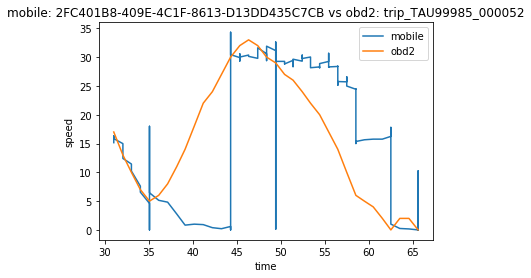

1495494020.0001 31.047
1495495128.0002 65.58


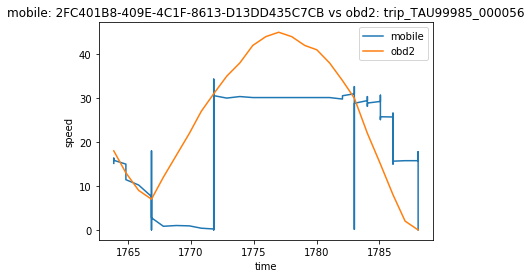

1495494020.0001 1763.857
1495495128.0002 1788.075


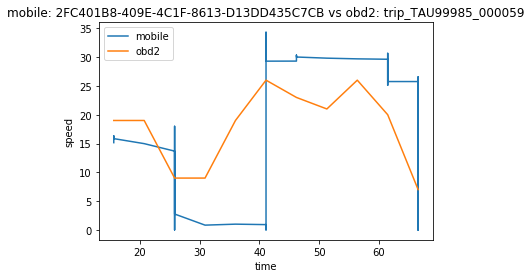

1495494020.0001 15.613
1495495128.0002 66.559


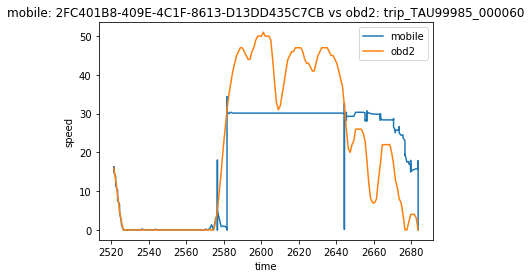

1495494020.0001 2521.292
1495495128.0002 2683.814


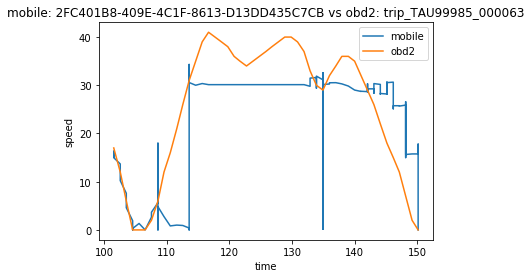

1495494020.0001 101.541
1495495128.0002 150.144


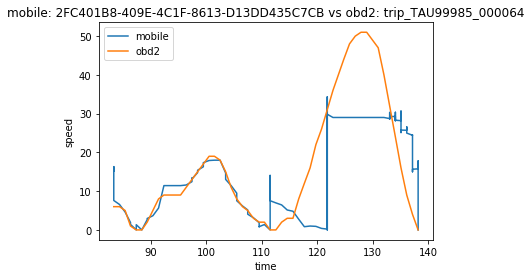

1495494020.0001 83.35
1495495128.0002 138.191


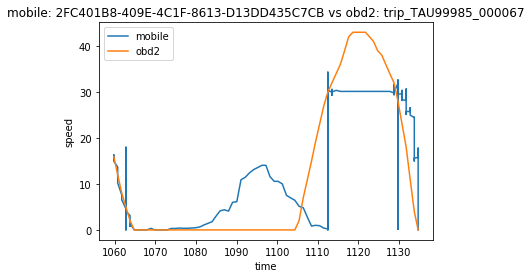

1495494020.0001 1059.787
1495495128.0002 1134.684


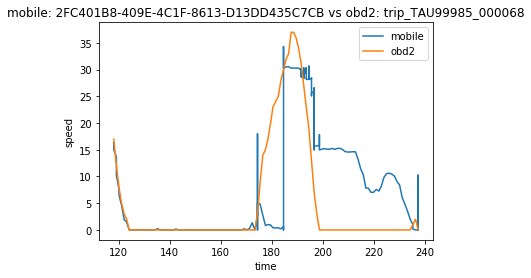

1495494020.0001 118.112
1495495128.0002 237.42


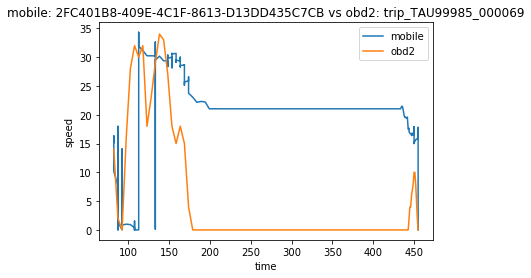

1495494020.0001 81.965
1495495128.0002 455.113


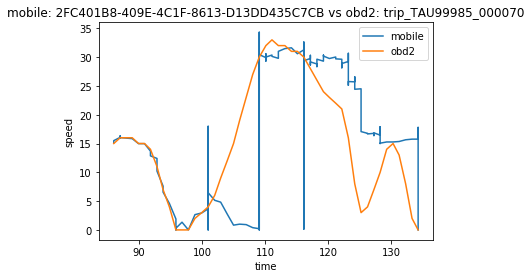

1495494020.0001 85.97
1495495128.0002 134.225


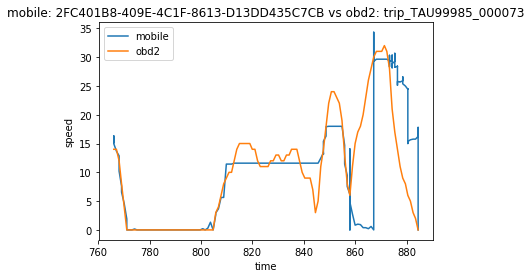

1495494020.0001 766.056
1495495128.0002 884.52


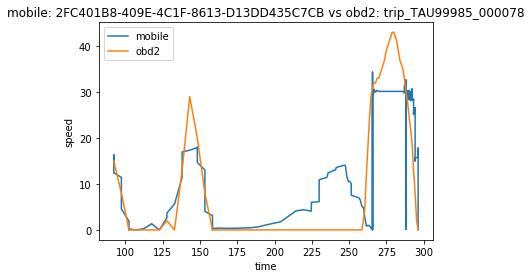

1495494020.0001 92.143
1495495128.0002 296.314


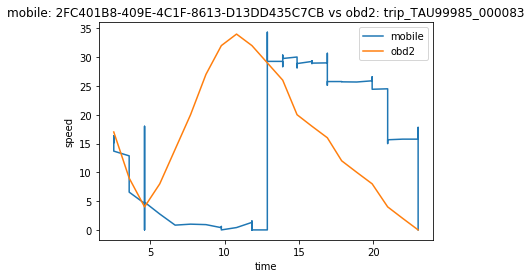

1495494020.0001 2.531
1495495128.0002 23.02


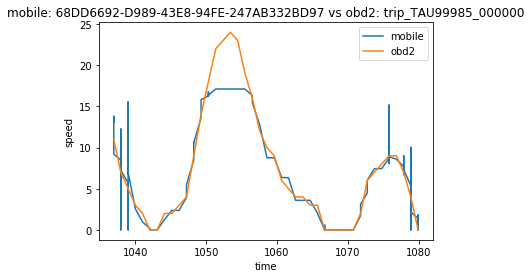

1495812273 1036.933
1495812915.9987 1079.914


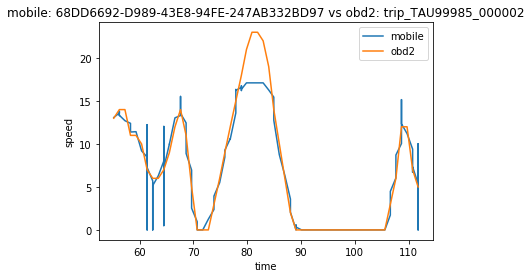

1495812273 55.214
1495812915.9987 111.781


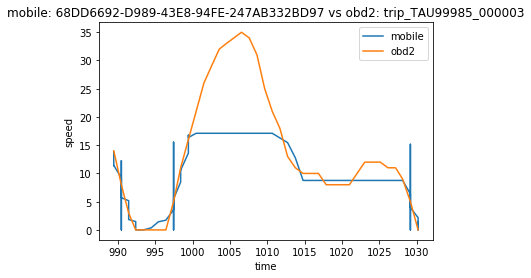

1495812273 989.438
1495812915.9987 1030.204


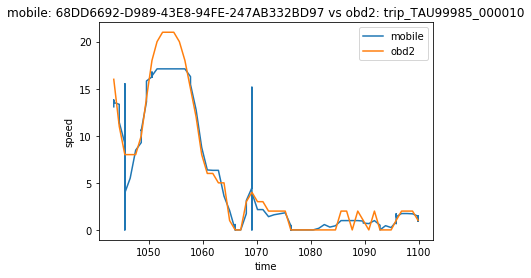

1495812273 1043.564
1495812915.9987 1099.923


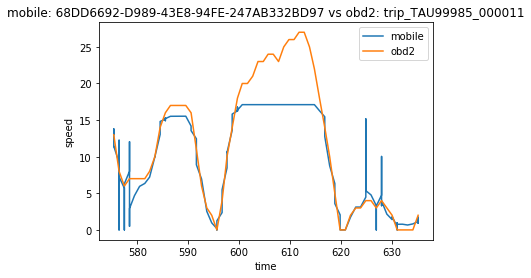

1495812273 575.373
1495812915.9987 635.192


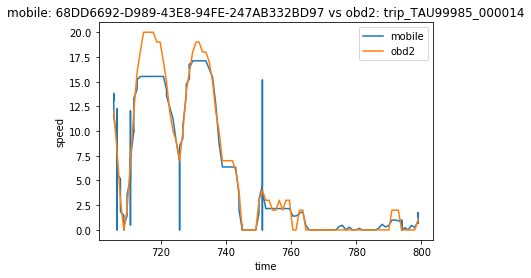

1495812273 705.545
1495812915.9987 798.967


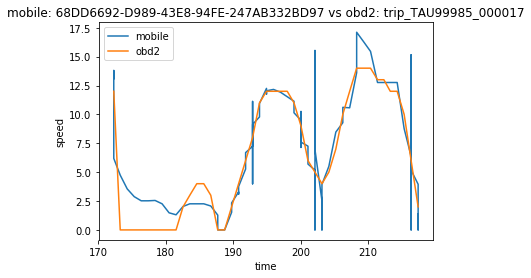

1495812273 172.295
1495812915.9987 217.423


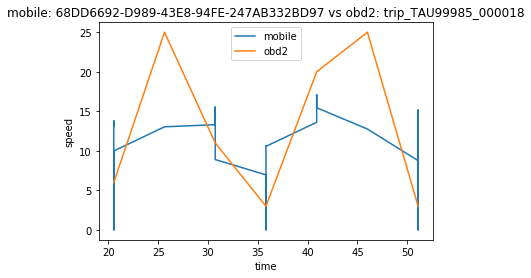

1495812273 20.538
1495812915.9987 51.093


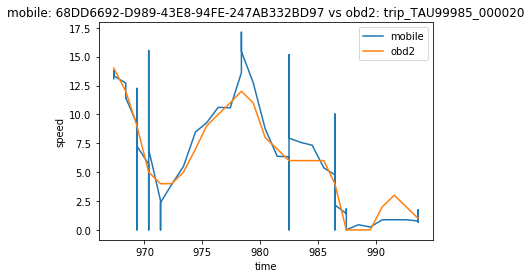

1495812273 967.349
1495812915.9987 993.637


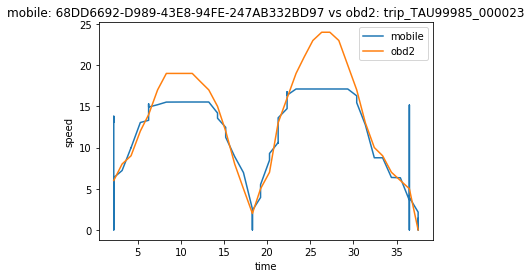

1495812273 2.241
1495812915.9987 37.487


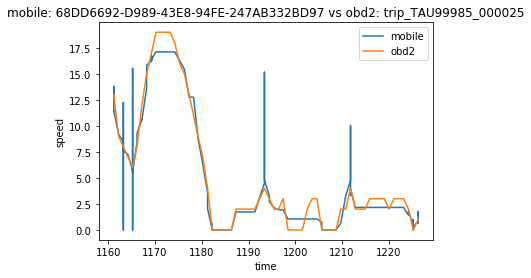

1495812273 1161.154
1495812915.9987 1226.29


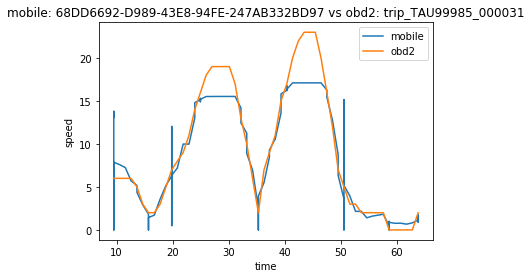

1495812273 9.501
1495812915.9987 63.772


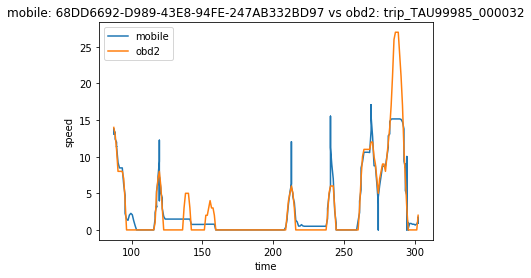

1495812273 87.42
1495812915.9987 302.279


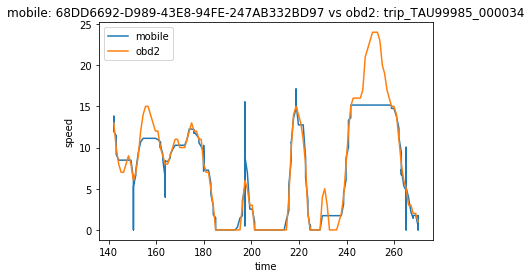

1495812273 142.165
1495812915.9987 270.074


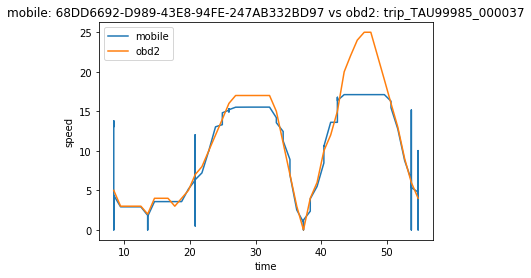

1495812273 8.372
1495812915.9987 54.741


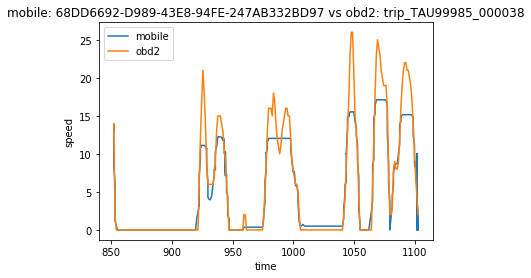

1495812273 852.203
1495812915.9987 1102.55


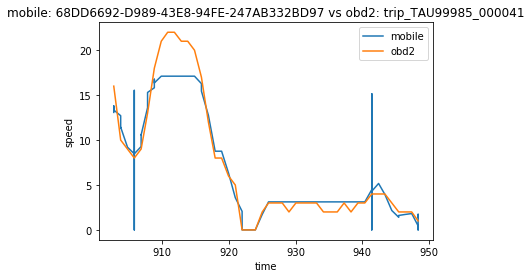

1495812273 902.733
1495812915.9987 948.35


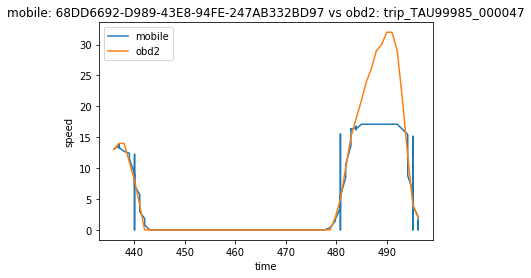

1495812273 435.911
1495812915.9987 496.16


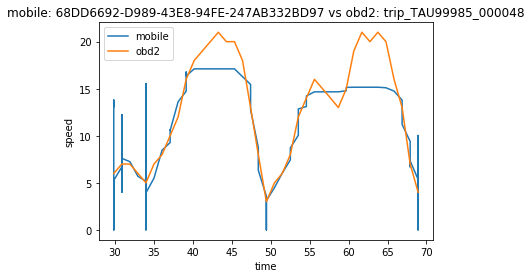

1495812273 29.834
1495812915.9987 68.927


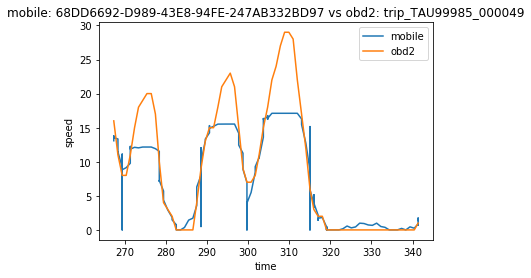

1495812273 267.292
1495812915.9987 341.351


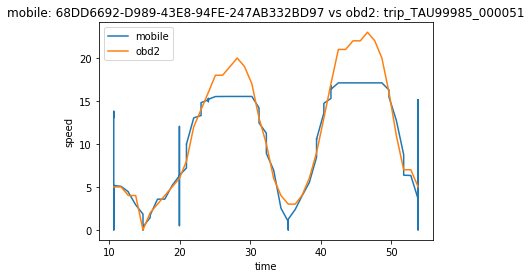

1495812273 10.607
1495812915.9987 53.806


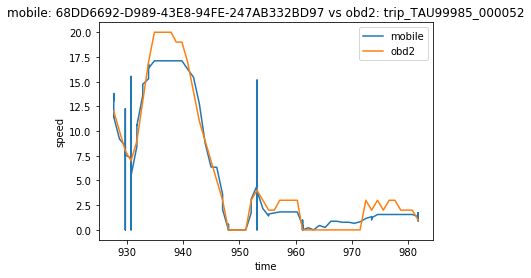

1495812273 927.67
1495812915.9987 981.73


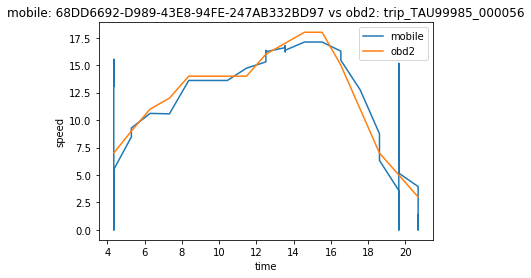

1495812273 4.349
1495812915.9987 20.678


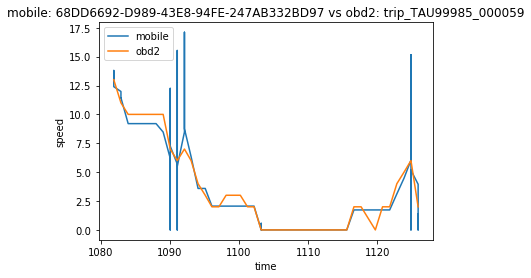

1495812273 1081.896
1495812915.9987 1125.881


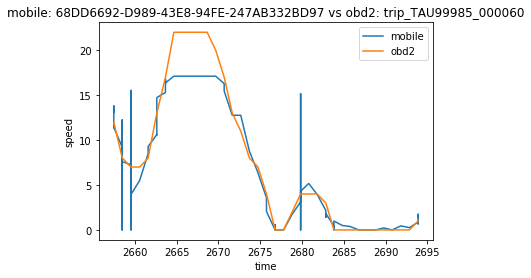

1495812273 2657.475
1495812915.9987 2693.89


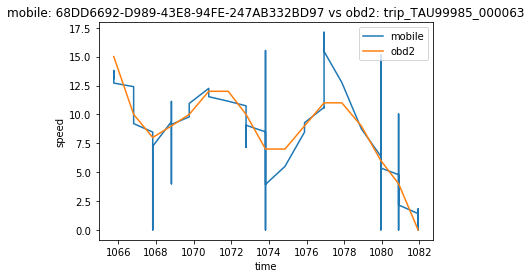

1495812273 1065.751
1495812915.9987 1081.929


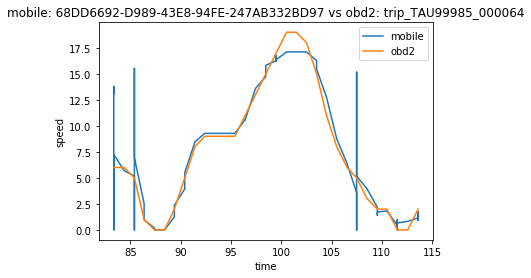

1495812273 83.35
1495812915.9987 113.599


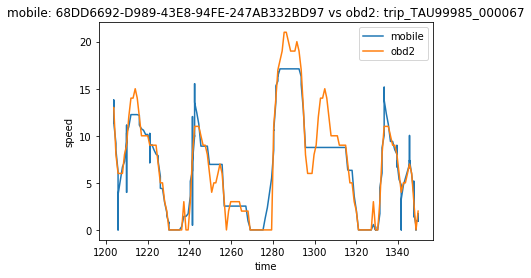

1495812273 1203.717
1495812915.9987 1349.594


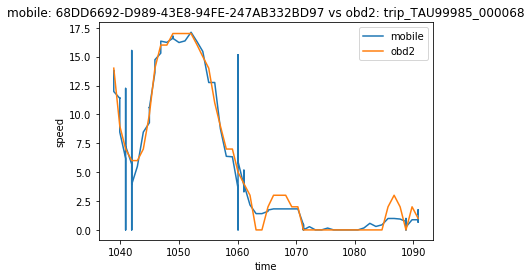

1495812273 1038.858
1495812915.9987 1090.813


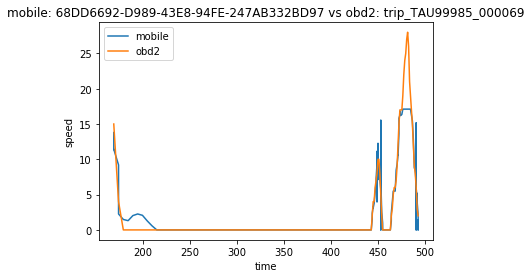

1495812273 168.582
1495812915.9987 492.9


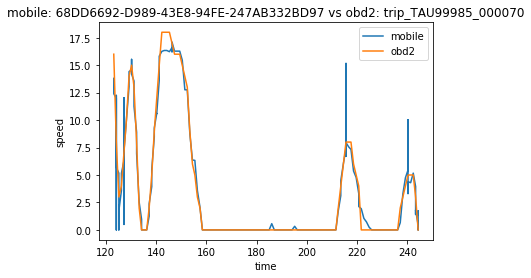

1495812273 123.16
1495812915.9987 244.231


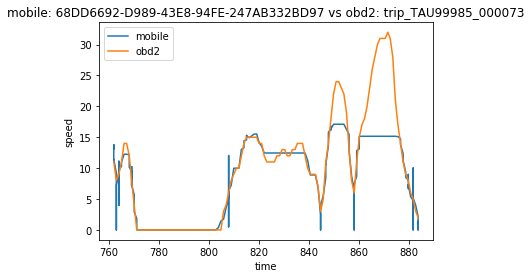

1495812273 761.944
1495812915.9987 883.497


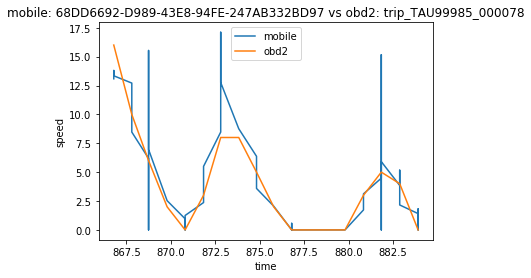

1495812273 866.788
1495812915.9987 883.919


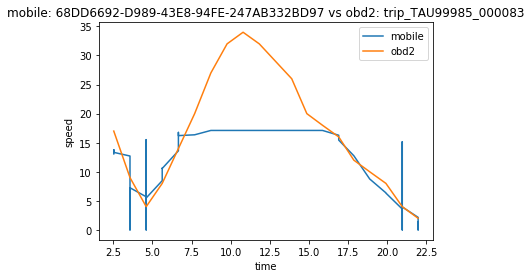

1495812273 2.531
1495812915.9987 21.983


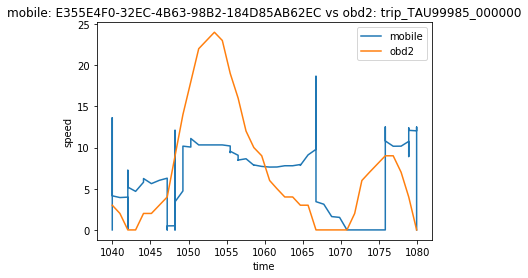

1495814628.0021 1039.997
1495815405.0001 1079.914


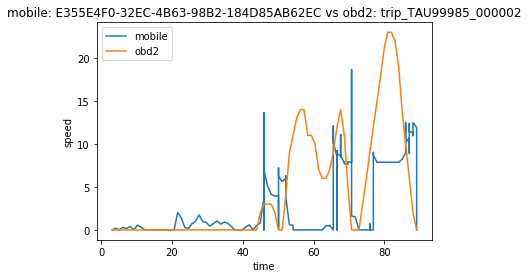

1495814628.0021 3.123
1495815405.0001 89.086


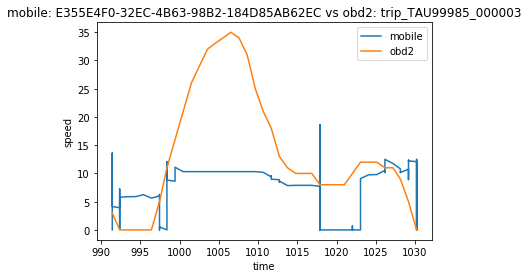

1495814628.0021 991.433
1495815405.0001 1030.204


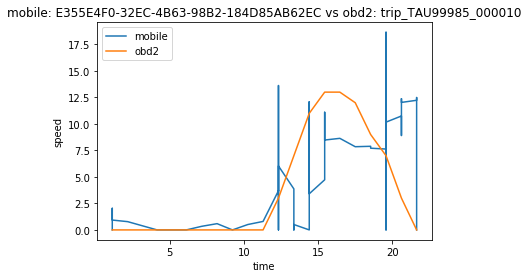

1495814628.0021 1.144
1495815405.0001 21.626


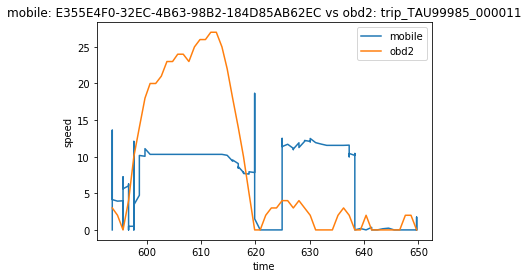

1495814628.0021 593.662
1495815405.0001 649.657


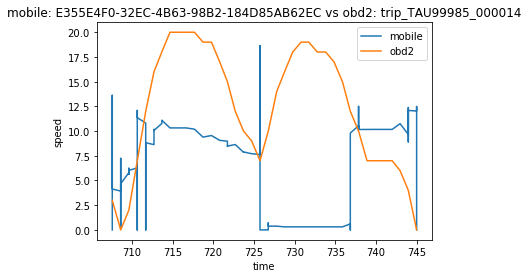

1495814628.0021 707.595
1495815405.0001 744.992


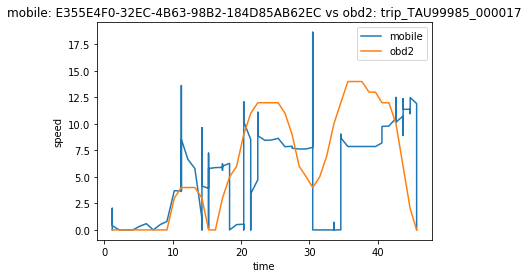

1495814628.0021 1.143
1495815405.0001 45.682


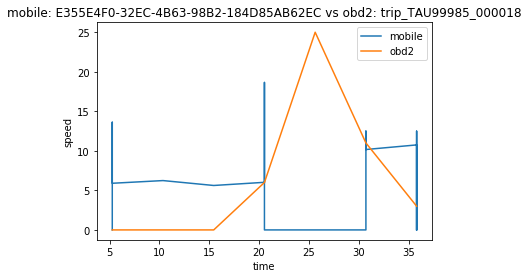

1495814628.0021 5.261
1495815405.0001 35.816


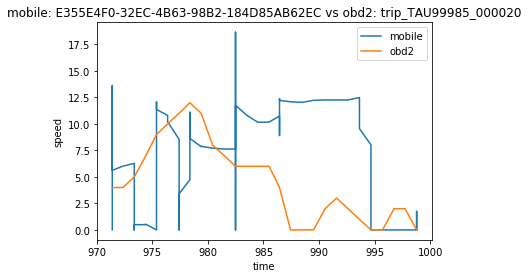

1495814628.0021 971.389
1495815405.0001 998.784


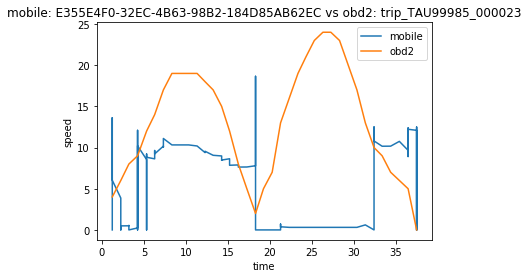

1495814628.0021 1.226
1495815405.0001 37.487


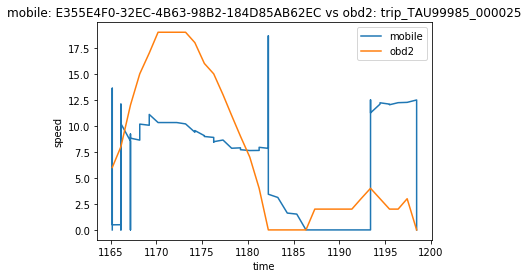

1495814628.0021 1165.185
1495815405.0001 1198.434


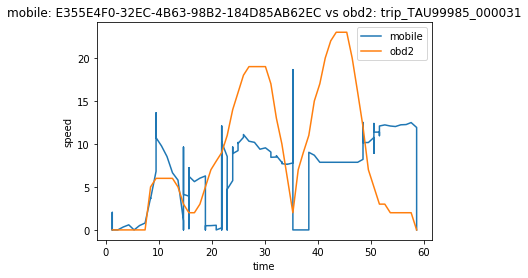

1495814628.0021 1.248
1495815405.0001 58.605


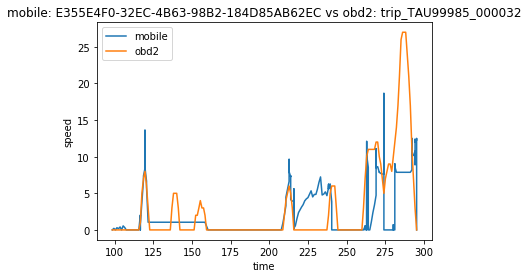

1495814628.0021 98.449
1495815405.0001 295.315


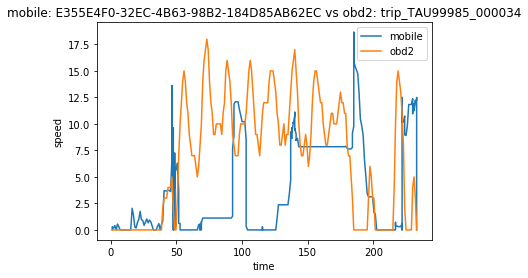

1495814628.0021 1.245
1495815405.0001 232.824


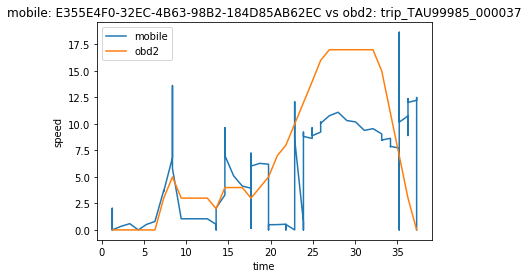

1495814628.0021 1.246
1495815405.0001 37.273


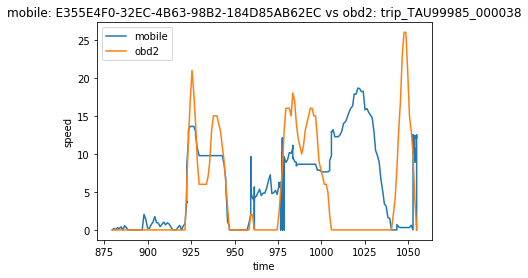

1495814628.0021 879.645
1495815405.0001 1054.789


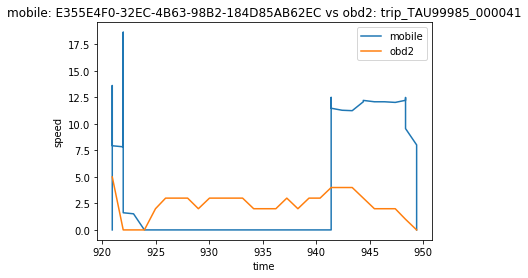

1495814628.0021 920.946
1495815405.0001 949.386


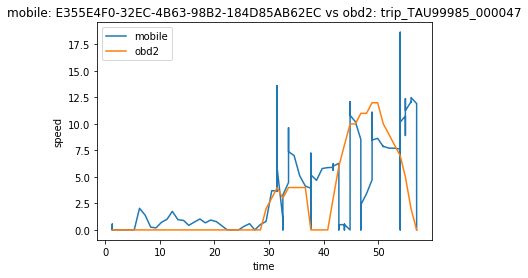

1495814628.0021 1.309
1495815405.0001 57.003


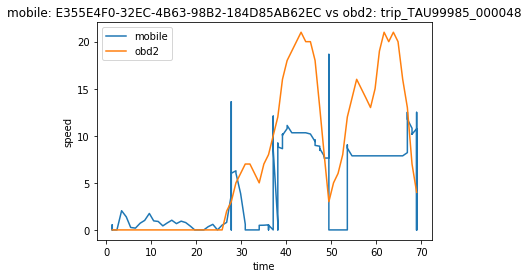

1495814628.0021 1.333
1495815405.0001 68.927


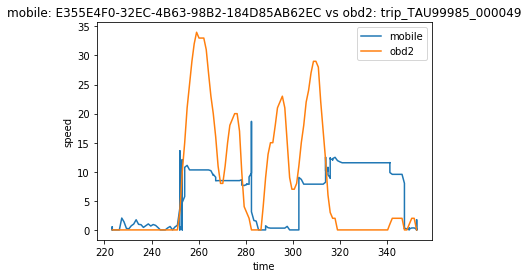

1495814628.0021 223.319
1495815405.0001 352.727


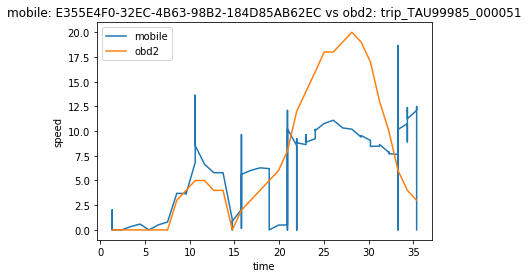

1495814628.0021 1.329
1495815405.0001 35.373


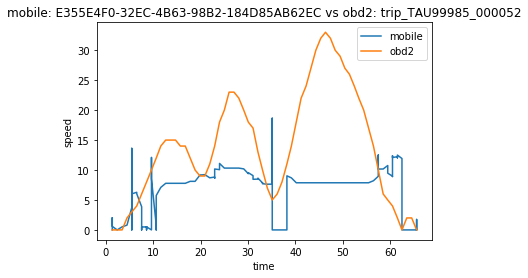

1495814628.0021 1.33
1495815405.0001 65.58


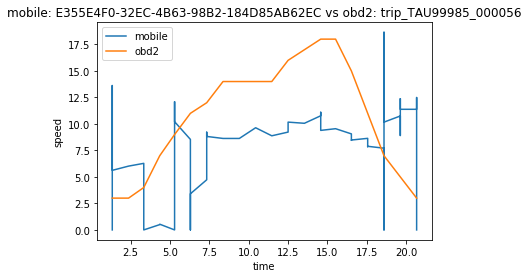

1495814628.0021 1.332
1495815405.0001 20.678


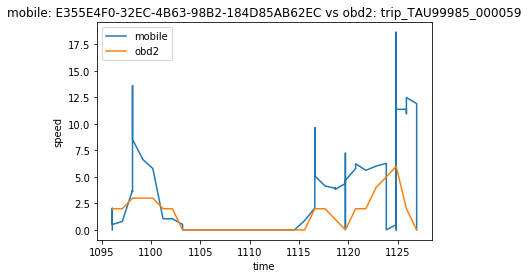

1495814628.0021 1096.077
1495815405.0001 1126.917


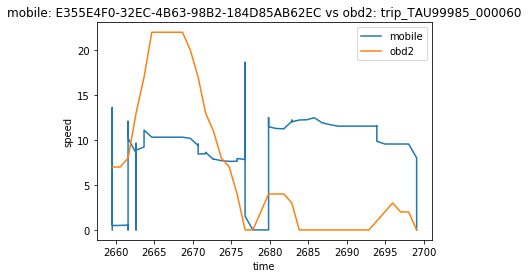

1495814628.0021 2659.533
1495815405.0001 2699.057


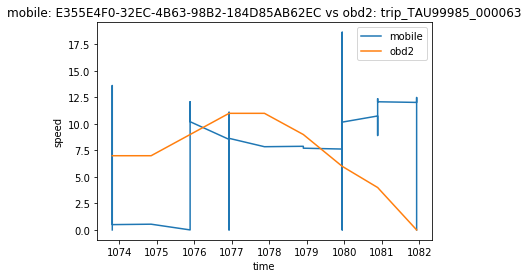

1495814628.0021 1073.816
1495815405.0001 1081.929


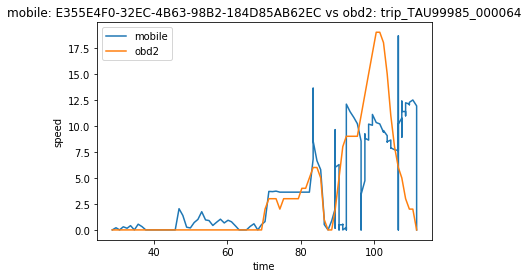

1495814628.0021 28.659
1495815405.0001 111.526


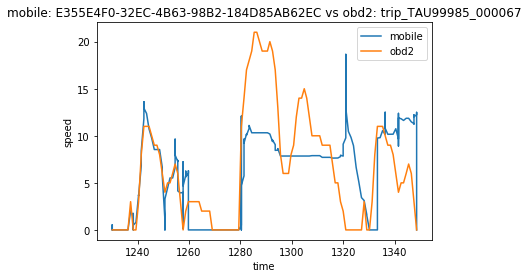

1495814628.0021 1230.161
1495815405.0001 1348.57


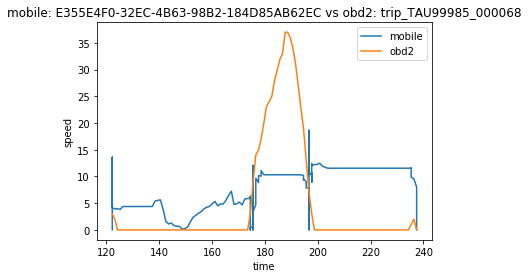

1495814628.0021 122.191
1495815405.0001 237.42


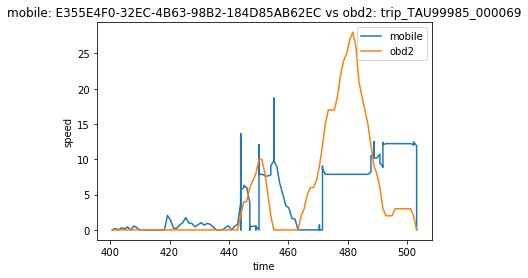

1495814628.0021 400.725
1495815405.0001 503.208


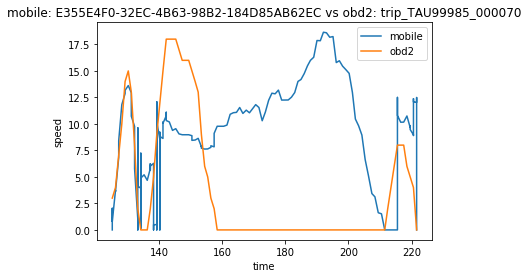

1495814628.0021 125.178
1495815405.0001 221.616


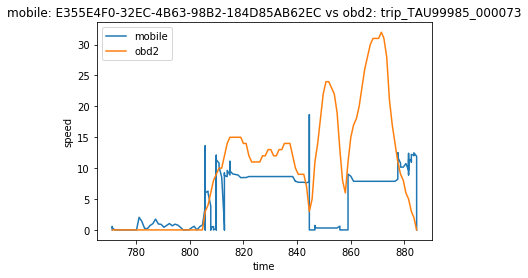

1495814628.0021 771.129
1495815405.0001 884.52


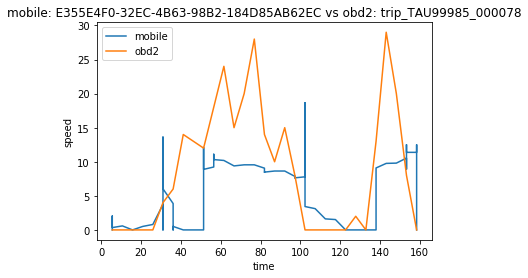

1495814628.0021 5.549
1495815405.0001 158.367


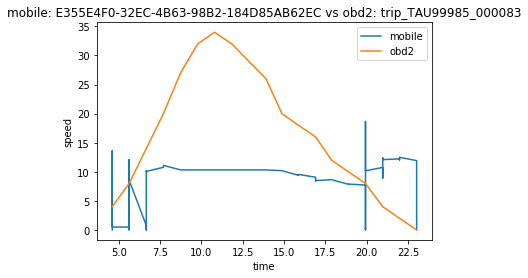

1495814628.0021 4.604
1495815405.0001 23.02


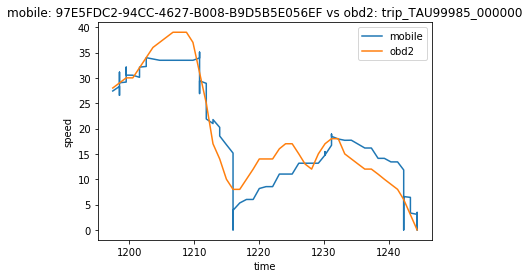

1495837966.9999 1197.43
1495838777.9999 1244.412


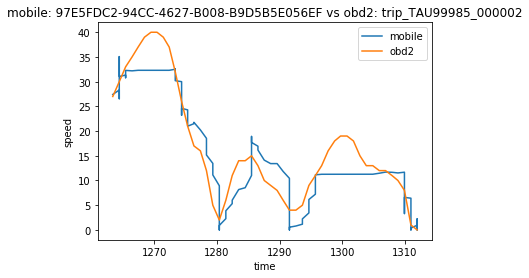

1495837966.9999 1263.367
1495838777.9999 1311.954


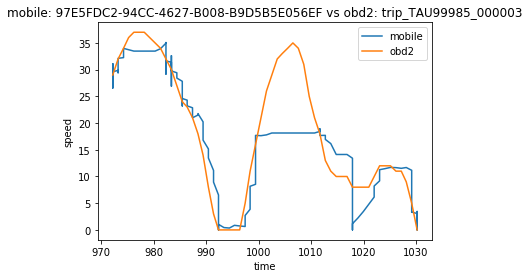

1495837966.9999 972.241
1495838777.9999 1030.204


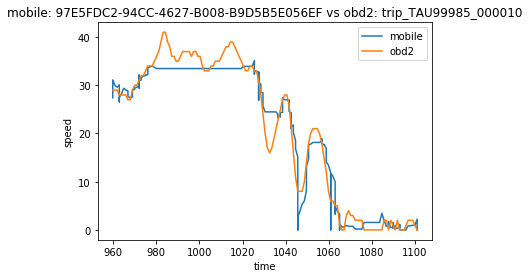

1495837966.9999 959.823
1495838777.9999 1100.959


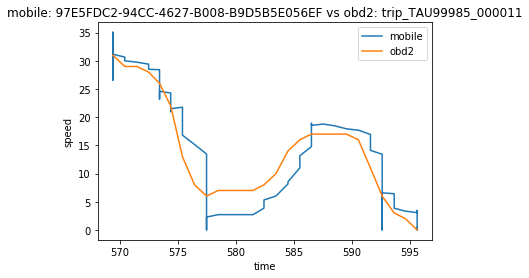

1495837966.9999 569.354
1495838777.9999 595.642


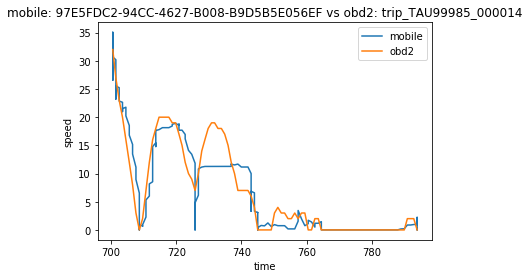

1495837966.9999 700.478
1495838777.9999 793.924


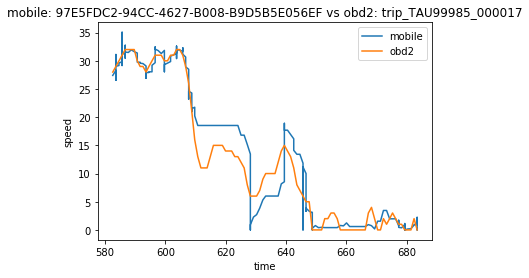

1495837966.9999 582.568
1495838777.9999 683.506


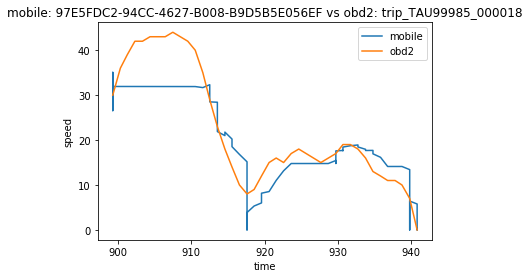

1495837966.9999 899.265
1495838777.9999 940.843


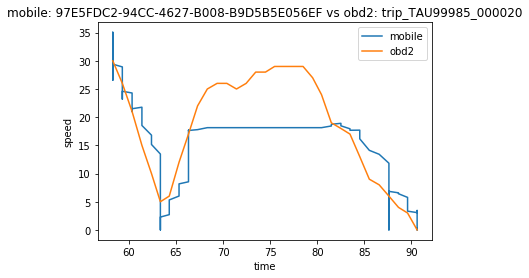

1495837966.9999 58.289
1495838777.9999 90.598


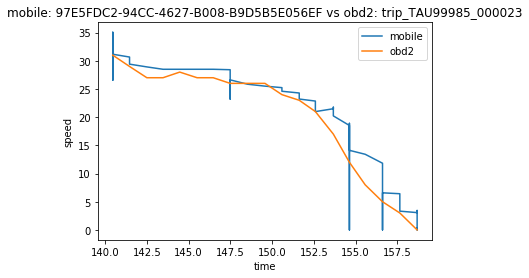

1495837966.9999 140.466
1495838777.9999 158.678


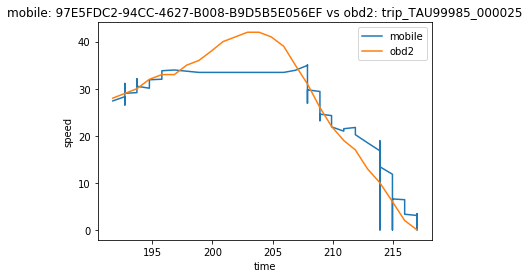

1495837966.9999 191.718
1495838777.9999 217.008


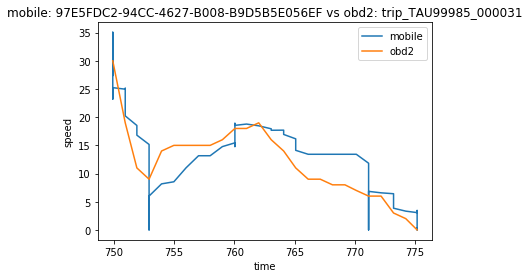

1495837966.9999 749.897
1495838777.9999 775.187


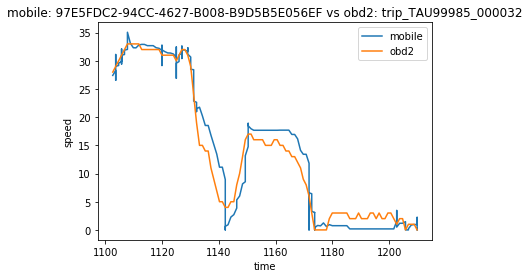

1495837966.9999 1102.568
1495838777.9999 1209.828


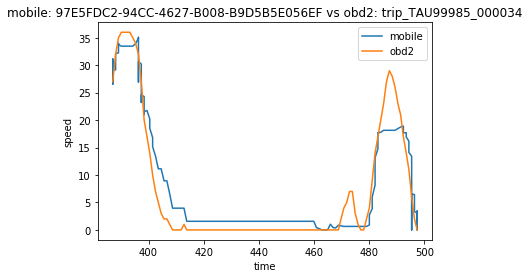

1495837966.9999 387.028
1495838777.9999 497.39


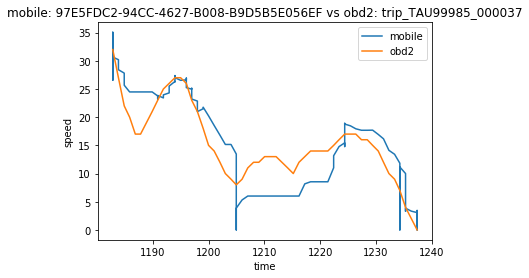

1495837966.9999 1182.841
1495838777.9999 1237.349


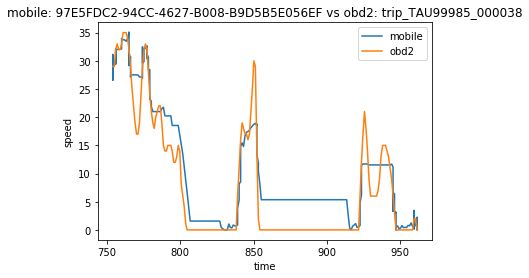

1495837966.9999 754.019
1495838777.9999 961.395


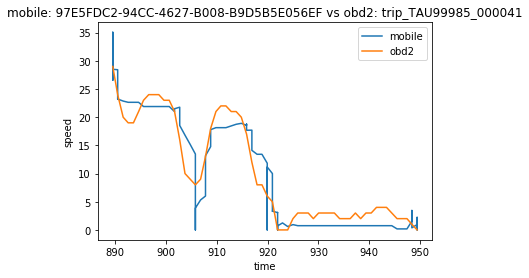

1495837966.9999 889.577
1495838777.9999 949.386


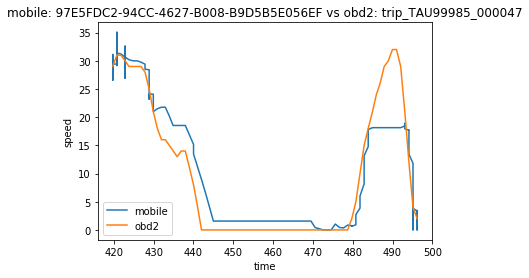

1495837966.9999 419.741
1495838777.9999 496.16


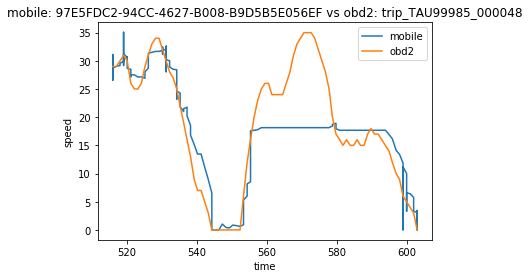

1495837966.9999 515.983
1495838777.9999 603.023


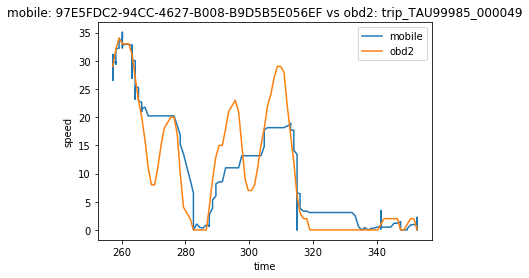

1495837966.9999 257.184
1495838777.9999 352.727


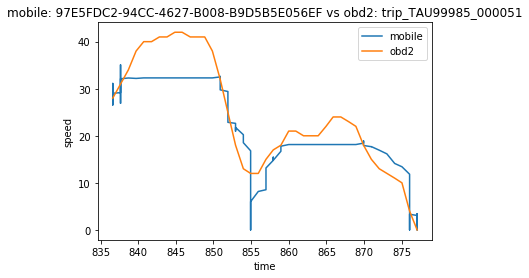

1495837966.9999 836.628
1495838777.9999 877.032


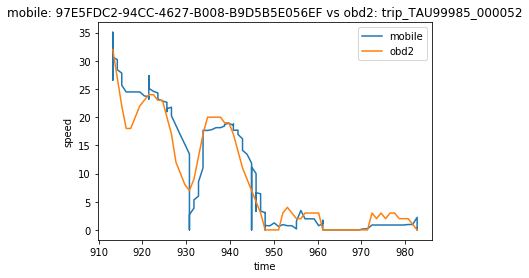

1495837966.9999 913.232
1495838777.9999 982.754


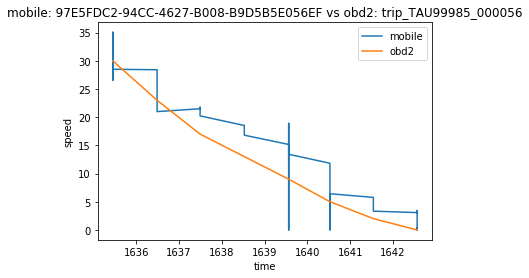

1495837966.9999 1635.45
1495838777.9999 1642.564


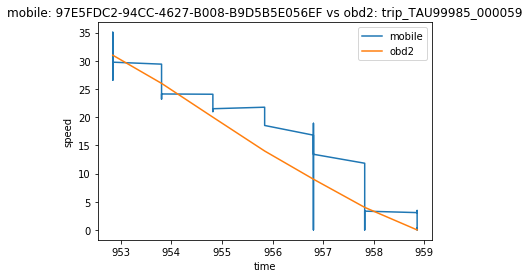

1495837966.9999 952.84
1495838777.9999 958.86


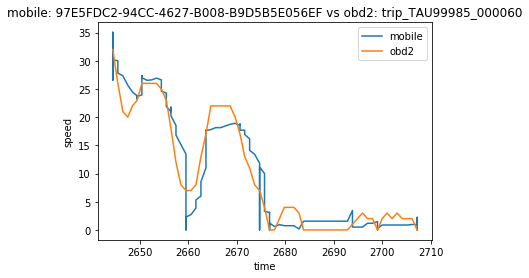

1495837966.9999 2644.432
1495838777.9999 2707.229


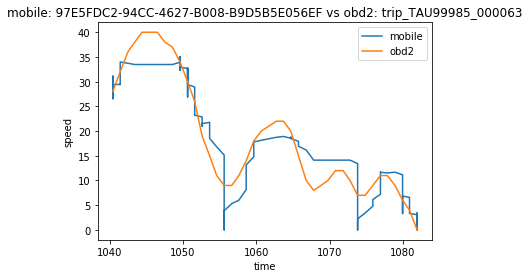

1495837966.9999 1040.437
1495838777.9999 1081.929


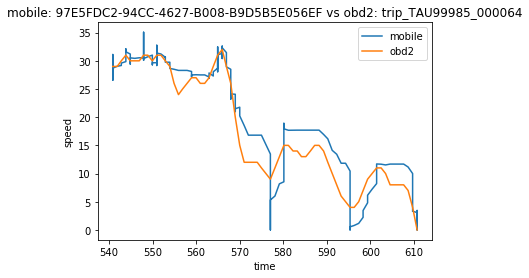

1495837966.9999 540.866
1495838777.9999 610.745


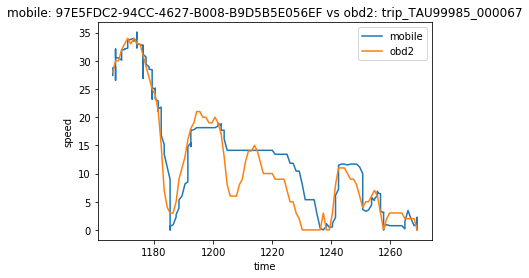

1495837966.9999 1165.996
1495838777.9999 1269.078


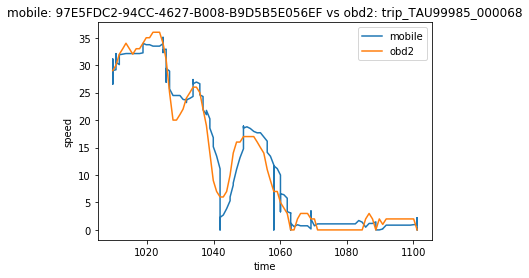

1495837966.9999 1009.675
1495838777.9999 1101.148


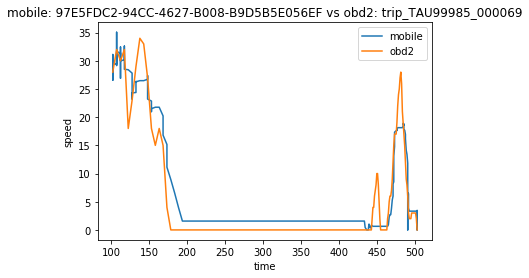

1495837966.9999 102.336
1495838777.9999 503.208


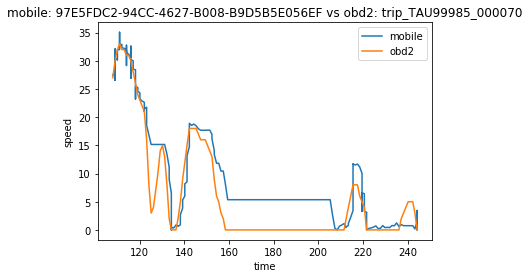

1495837966.9999 108.002
1495838777.9999 244.231


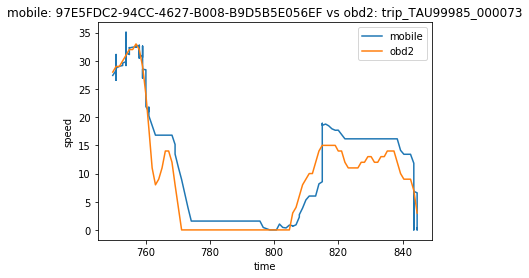

1495837966.9999 749.671
1495838777.9999 844.546


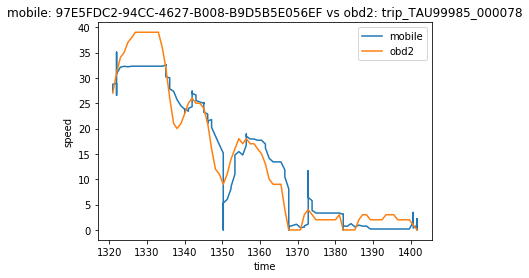

1495837966.9999 1320.924
1495838777.9999 1401.694


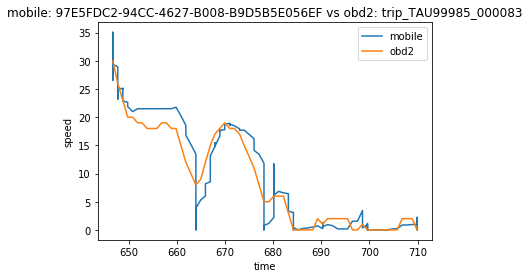

1495837966.9999 646.73
1495838777.9999 709.921


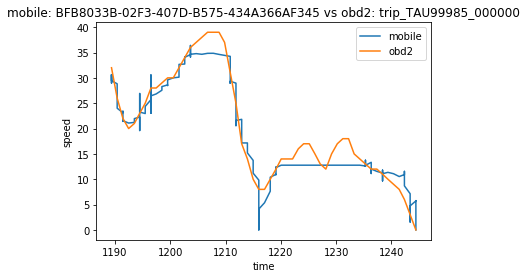

1495841107.0001 1189.351
1495842035 1244.412


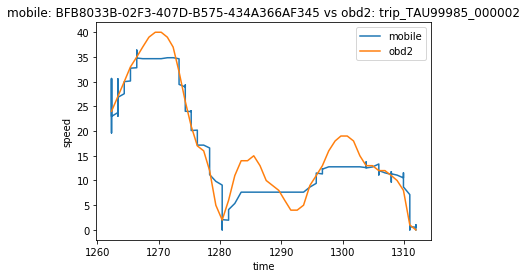

1495841107.0001 1262.33
1495842035 1311.954


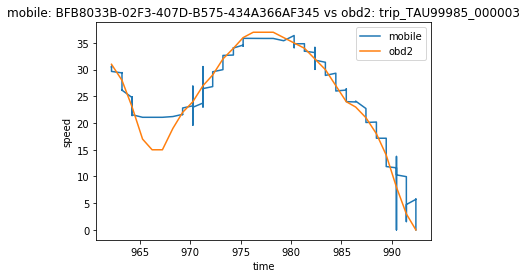

1495841107.0001 962.214
1495842035 992.377


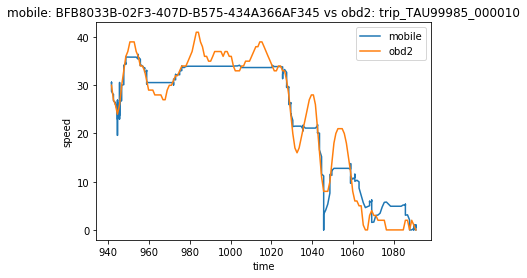

1495841107.0001 941.645
1495842035 1090.793


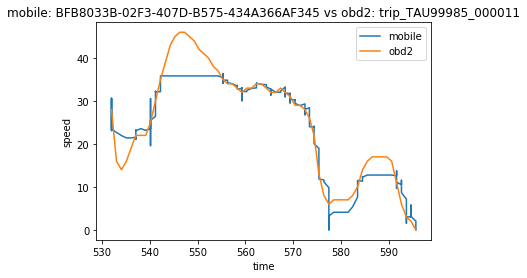

1495841107.0001 532.024
1495842035 595.642


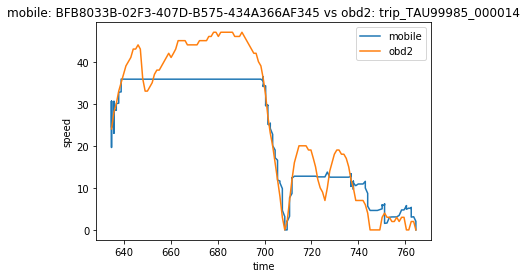

1495841107.0001 634.773
1495842035 764.514


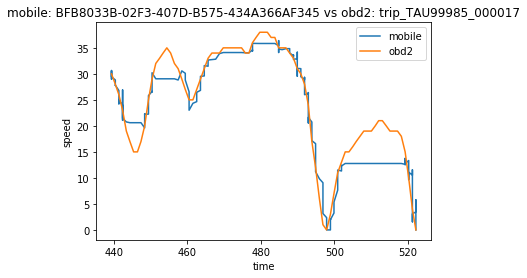

1495841107.0001 439.32
1495842035 522.189


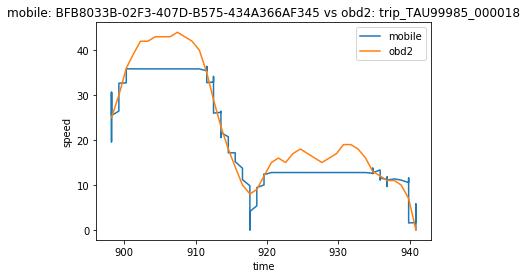

1495841107.0001 898.235
1495842035 940.843


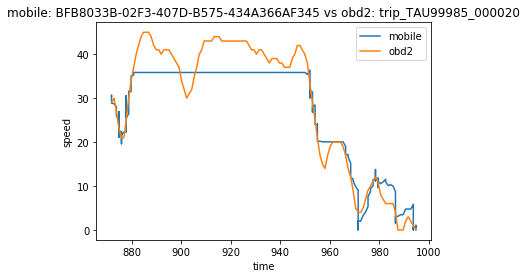

1495841107.0001 871.918
1495842035 994.674


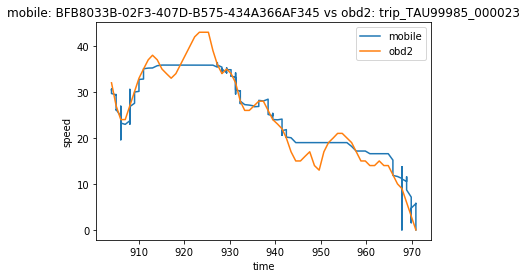

1495841107.0001 904.012
1495842035 970.948


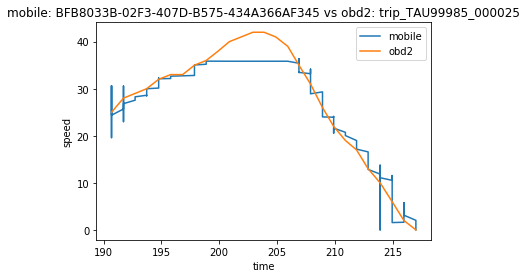

1495841107.0001 190.682
1495842035 217.008


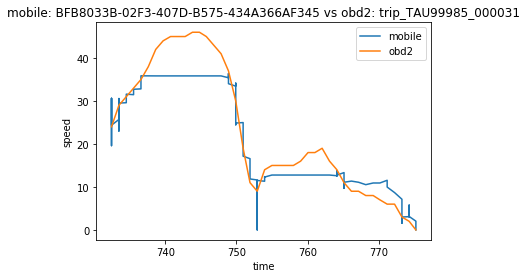

1495841107.0001 732.456
1495842035 775.187


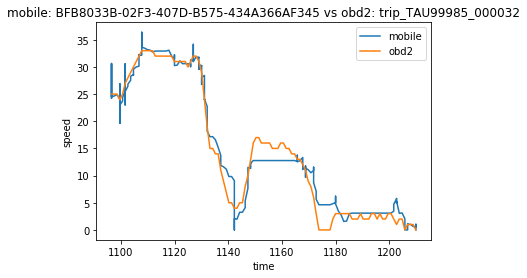

1495841107.0001 1096.469
1495842035 1209.828


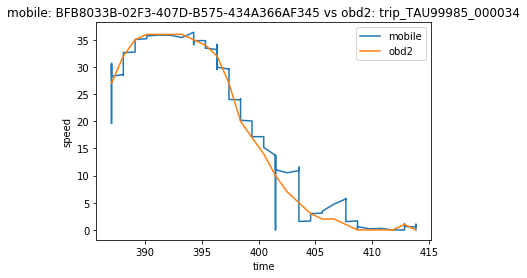

1495841107.0001 387.028
1495842035 413.857


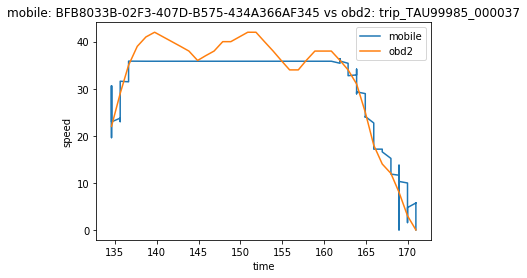

1495841107.0001 134.598
1495842035 170.953


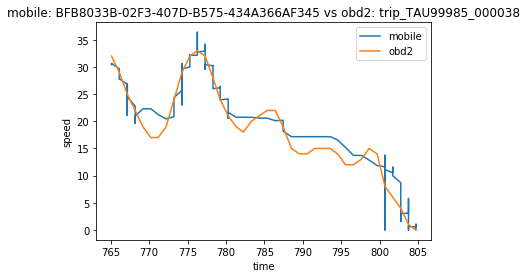

1495841107.0001 765.105
1495842035 804.718


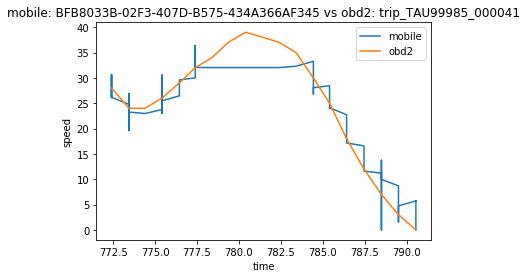

1495841107.0001 772.403
1495842035 790.546


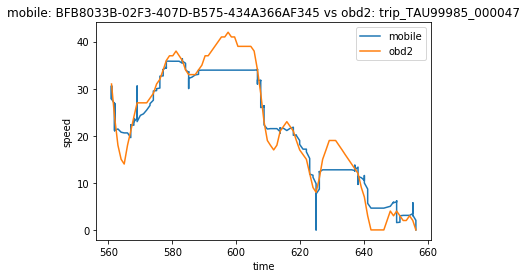

1495841107.0001 560.983
1495842035 656.189


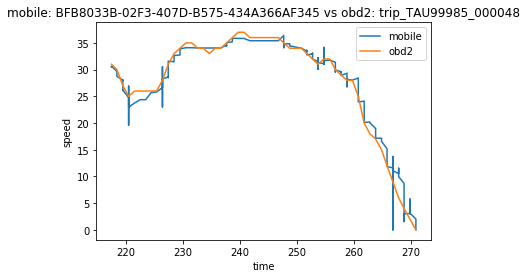

1495841107.0001 217.506
1495842035 270.874


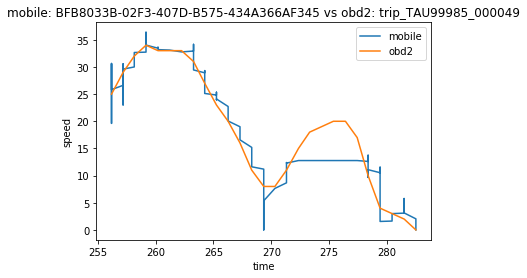

1495841107.0001 256.183
1495842035 282.499


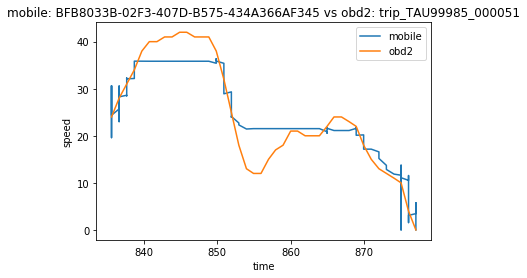

1495841107.0001 835.592
1495842035 877.032


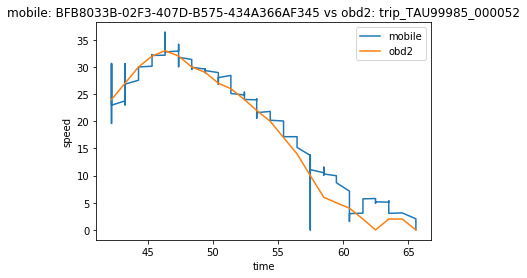

1495841107.0001 42.234
1495842035 65.58


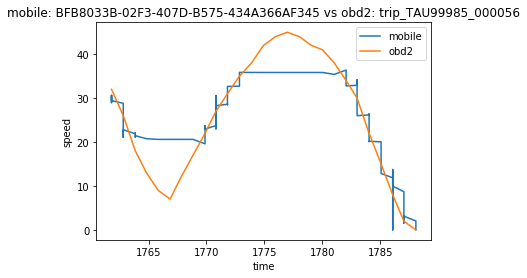

1495841107.0001 1761.805
1495842035 1788.075


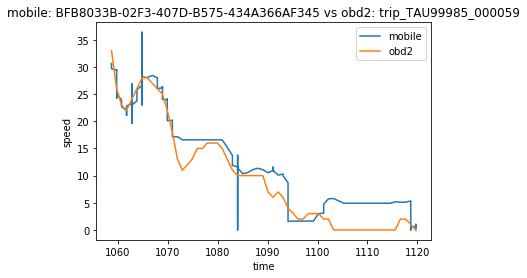

1495841107.0001 1058.7
1495842035 1119.698


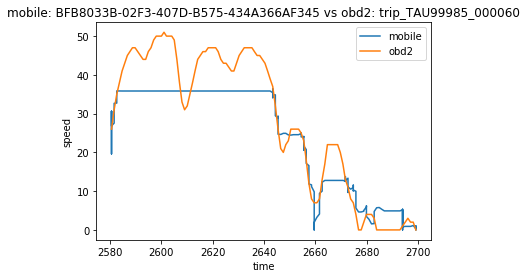

1495841107.0001 2580.745
1495842035 2699.057


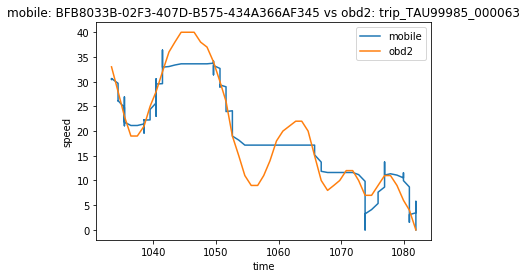

1495841107.0001 1033.312
1495842035 1081.929


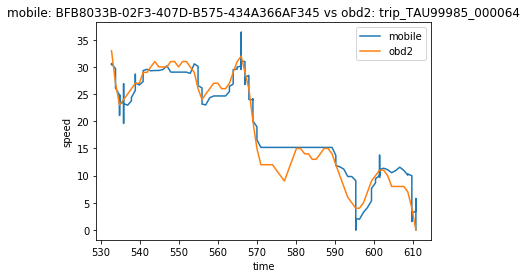

1495841107.0001 532.764
1495842035 610.745


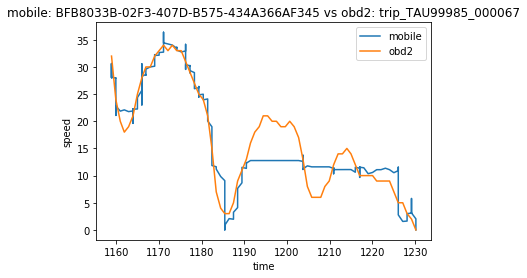

1495841107.0001 1158.89
1495842035 1230.161


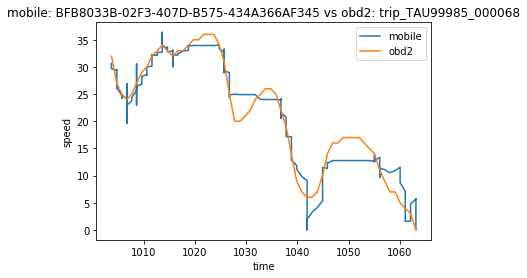

1495841107.0001 1003.747
1495842035 1063.147


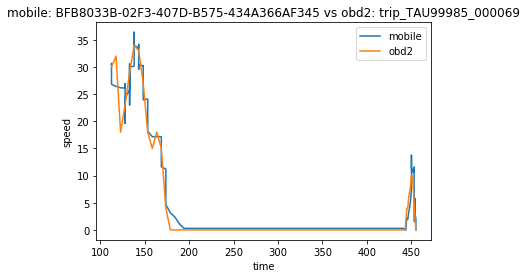

1495841107.0001 112.52
1495842035 455.113


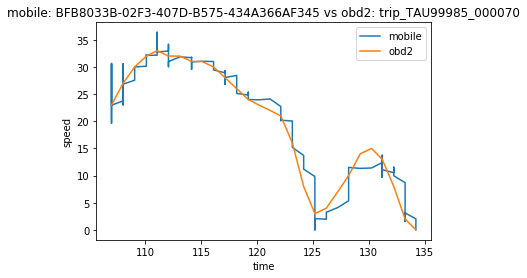

1495841107.0001 106.965
1495842035 134.225


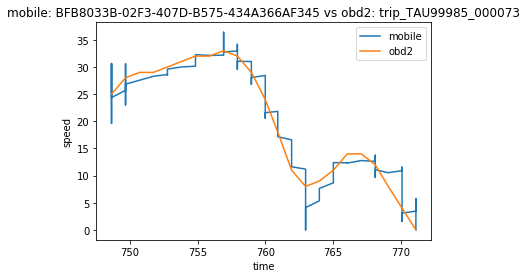

1495841107.0001 748.634
1495842035 771.129


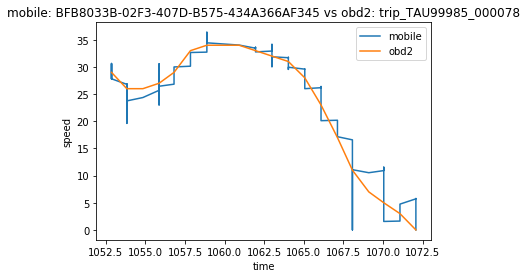

1495841107.0001 1052.859
1495842035 1072.076


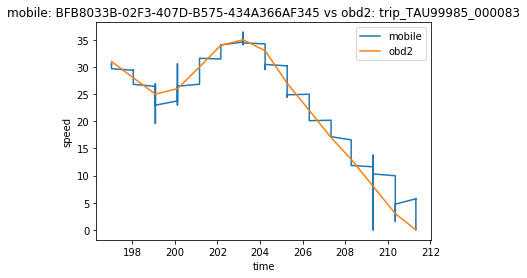

1495841107.0001 197.032
1495842035 211.319


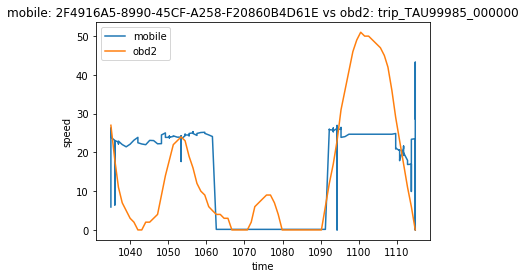

1495910520.0437 1034.951
1495911252 1114.849


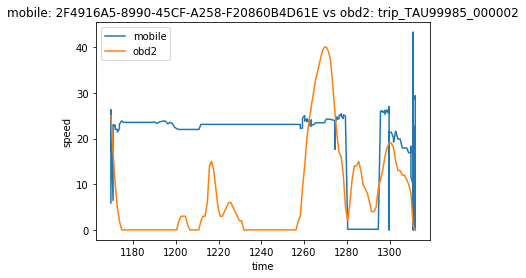

1495910520.0437 1169.691
1495911252 1311.954


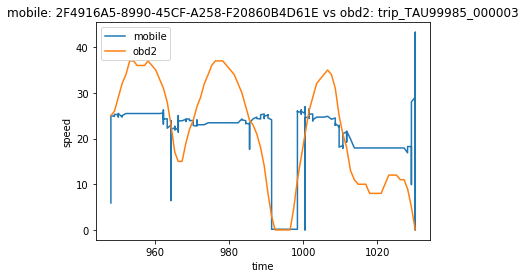

1495910520.0437 948.046
1495911252 1030.204


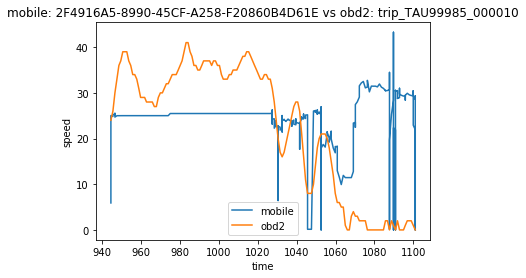

1495910520.0437 944.555
1495911252 1100.959


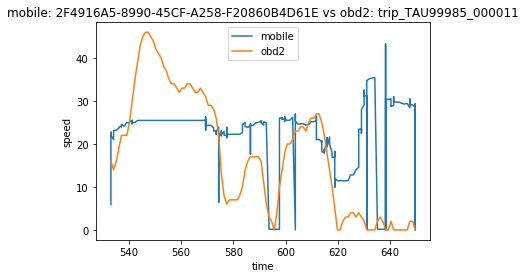

1495910520.0437 533.061
1495911252 649.657


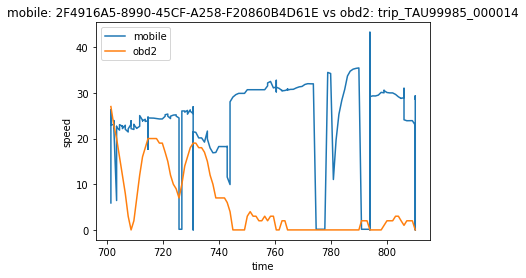

1495910520.0437 701.423
1495911252 810.111


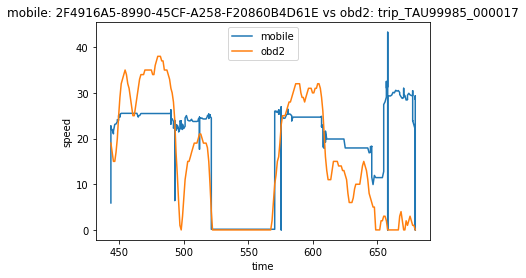

1495910520.0437 443.36
1495911252 679.397


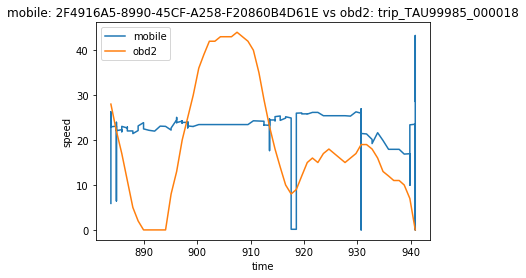

1495910520.0437 883.847
1495911252 940.843


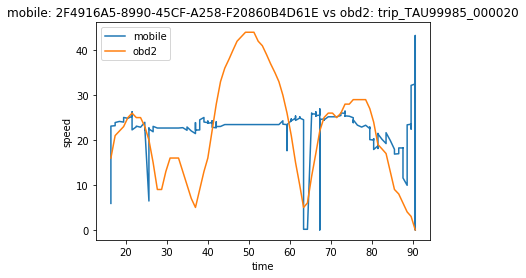

1495910520.0437 16.32
1495911252 90.598


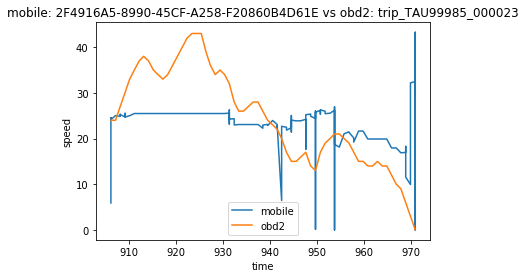

1495910520.0437 906.05
1495911252 970.948


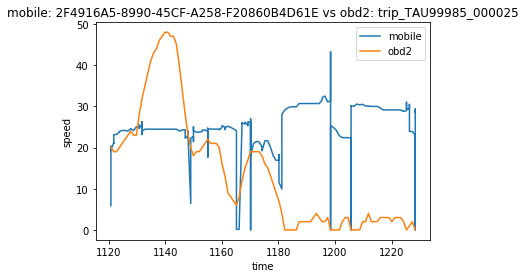

1495910520.0437 1120.837
1495911252 1228.348


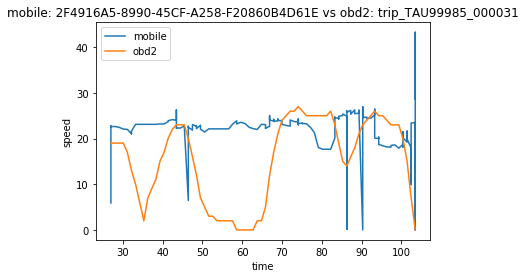

1495910520.0437 27.008
1495911252 103.462


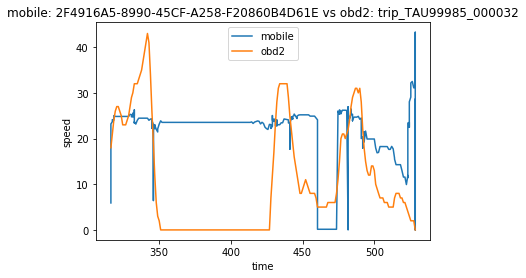

1495910520.0437 316.448
1495911252 528.492


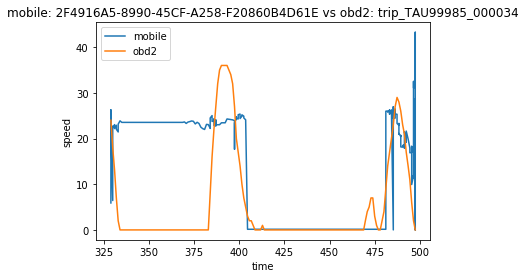

1495910520.0437 328.972
1495911252 497.39


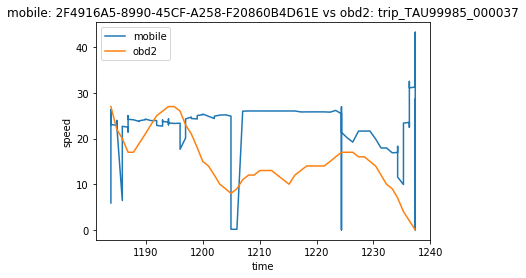

1495910520.0437 1183.856
1495911252 1237.349


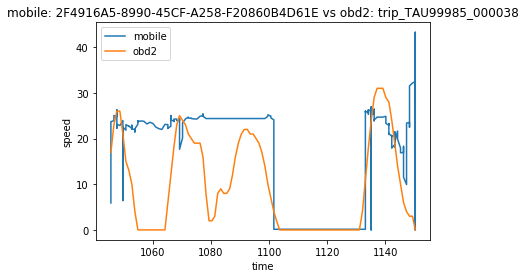

1495910520.0437 1045.49
1495911252 1150.305


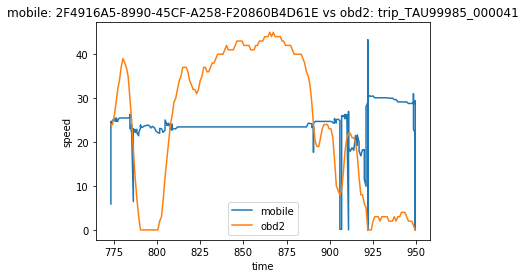

1495910520.0437 773.44
1495911252 949.386


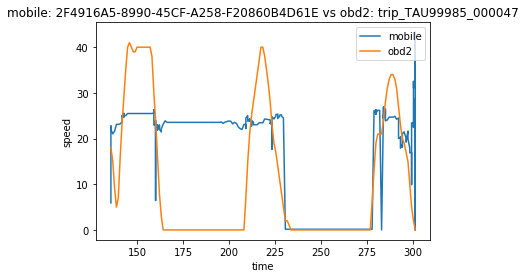

1495910520.0437 135.811
1495911252 301.164


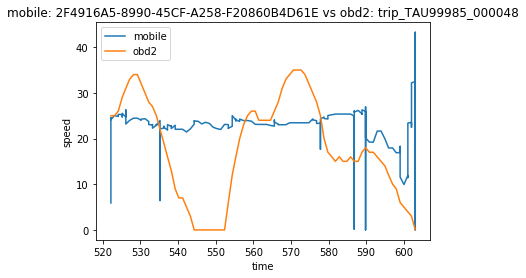

1495910520.0437 522.188
1495911252 603.023


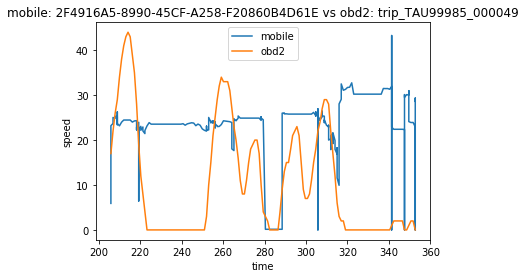

1495910520.0437 205.898
1495911252 352.727


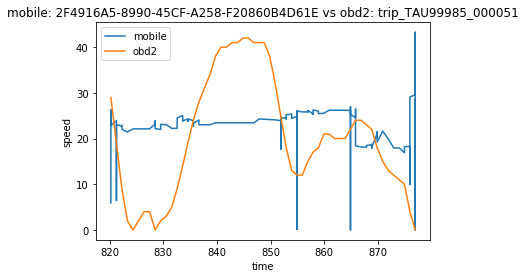

1495910520.0437 820.191
1495911252 877.032


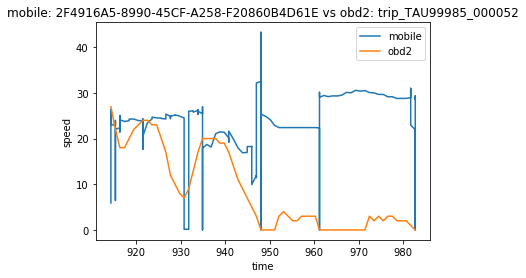

1495910520.0437 914.269
1495911252 982.754


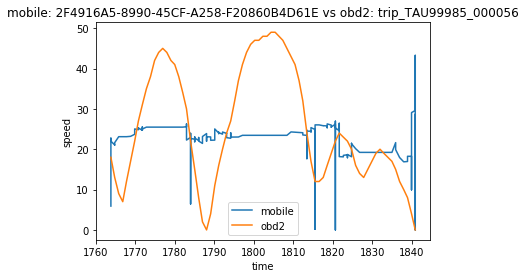

1495910520.0437 1763.857
1495911252 1840.902


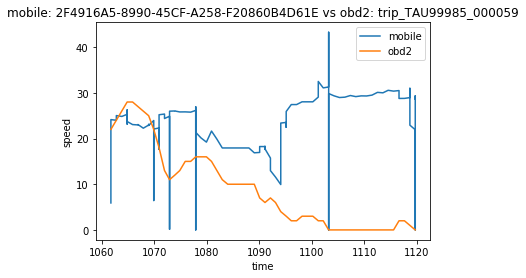

1495910520.0437 1061.716
1495911252 1119.698


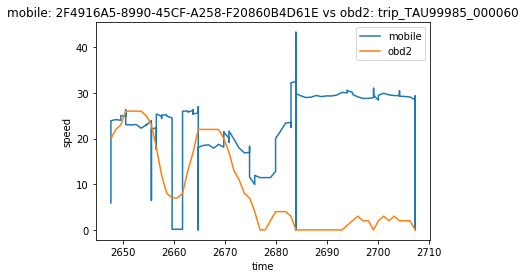

1495910520.0437 2647.529
1495911252 2707.229


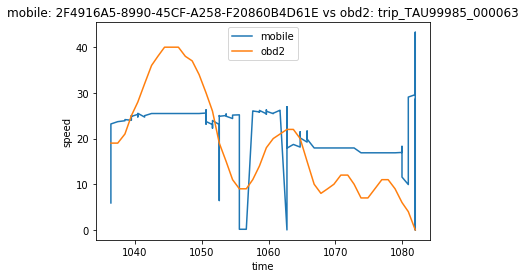

1495910520.0437 1036.408
1495911252 1081.929


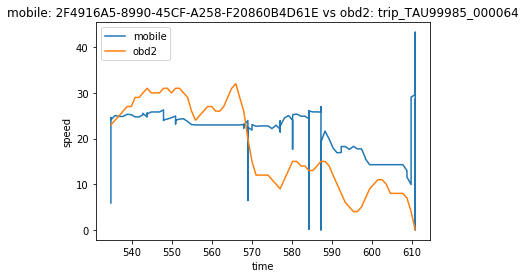

1495910520.0437 534.825
1495911252 610.745


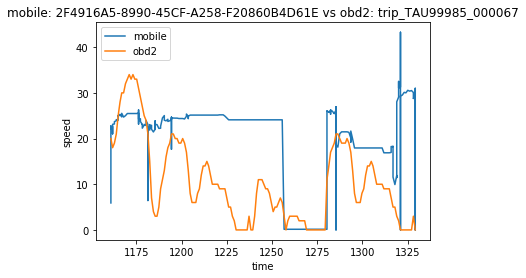

1495910520.0437 1160.941
1495911252 1329.183


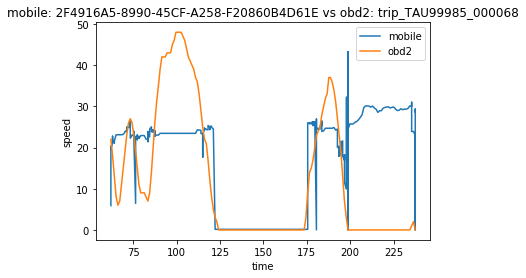

1495910520.0437 62.171
1495911252 237.42


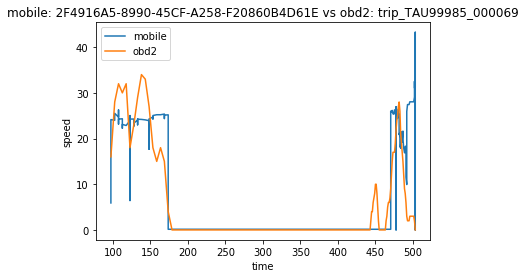

1495910520.0437 97.243
1495911252 503.208


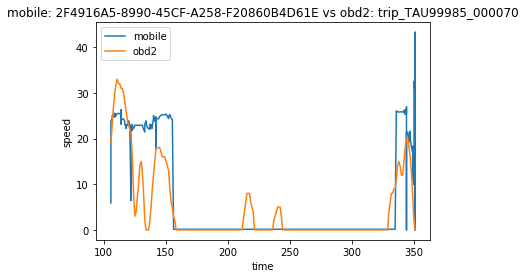

1495910520.0437 105.921
1495911252 351.1


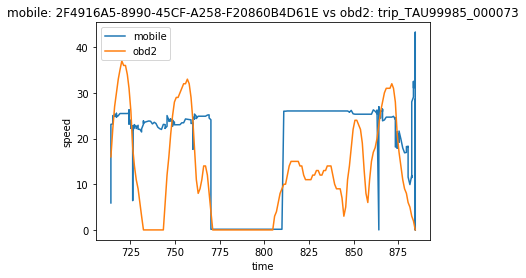

1495910520.0437 714.102
1495911252 884.52


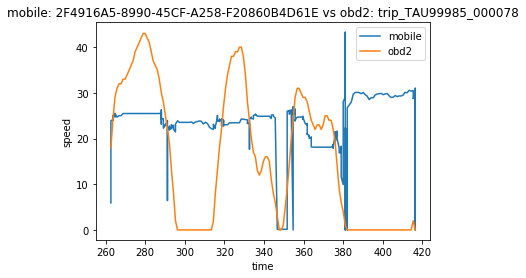

1495910520.0437 262.631
1495911252 416.479


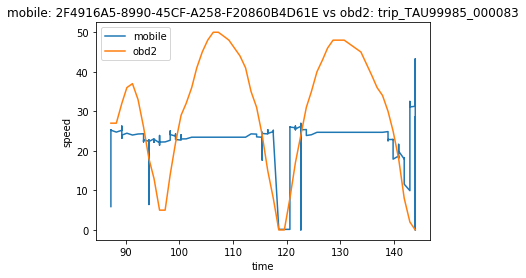

1495910520.0437 87.23
1495911252 143.961


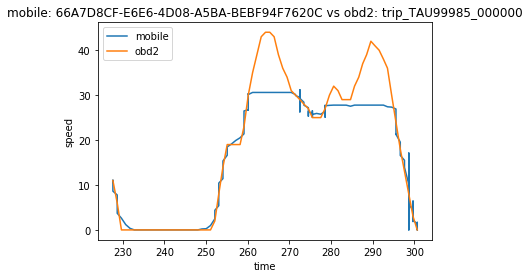

1495980237.0163 227.62
1495981153.0001 300.682


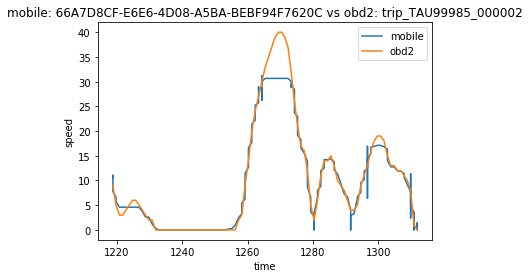

1495980237.0163 1218.773
1495981153.0001 1311.954


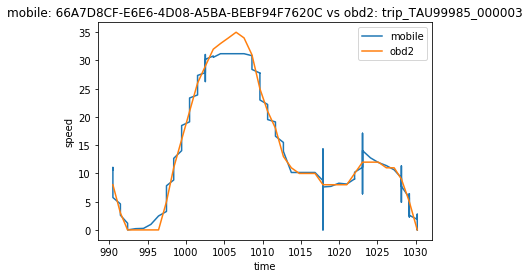

1495980237.0163 990.453
1495981153.0001 1030.204


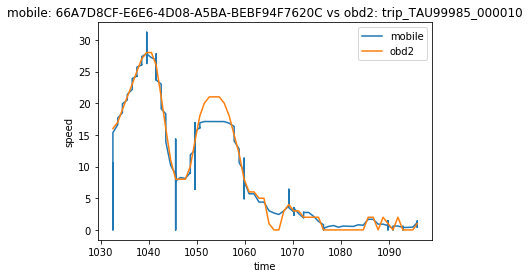

1495980237.0163 1032.56
1495981153.0001 1095.847


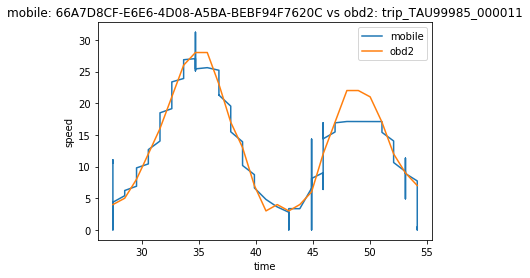

1495980237.0163 27.448
1495981153.0001 54.141


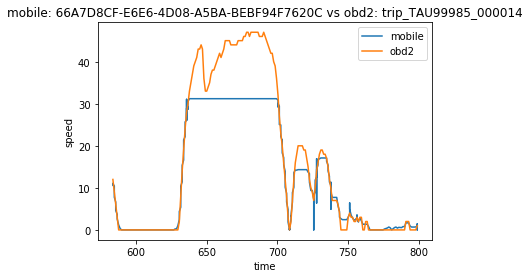

1495980237.0163 583.699
1495981153.0001 798.967


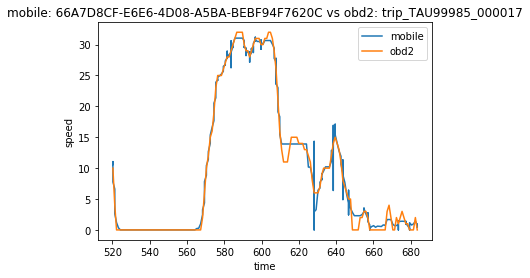

1495980237.0163 520.23
1495981153.0001 683.506


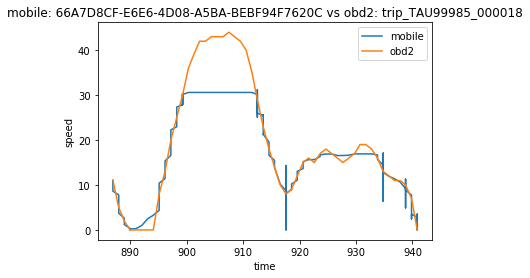

1495980237.0163 886.924
1495981153.0001 940.843


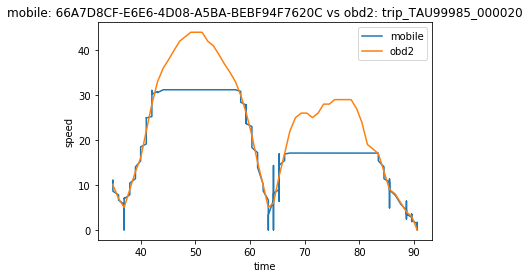

1495980237.0163 34.9
1495981153.0001 90.598


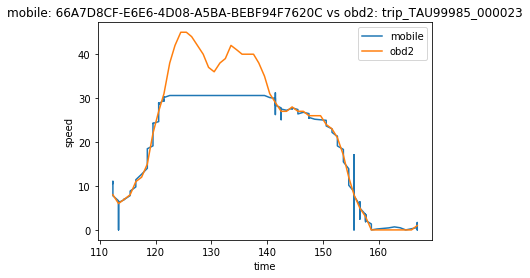

1495980237.0163 112.343
1495981153.0001 166.908


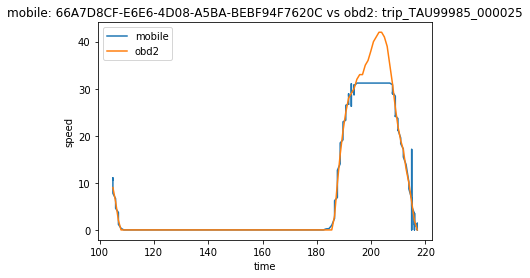

1495980237.0163 104.884
1495981153.0001 217.008


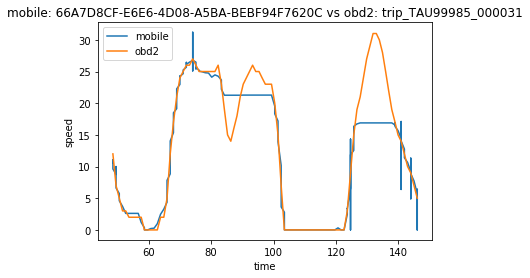

1495980237.0163 48.498
1495981153.0001 146.039


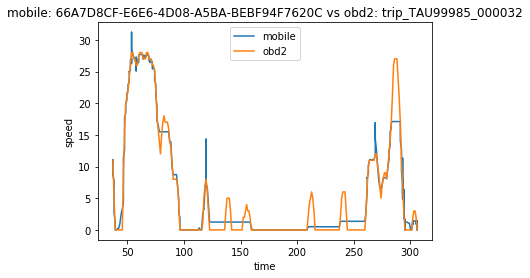

1495980237.0163 37.202
1495981153.0001 306.204


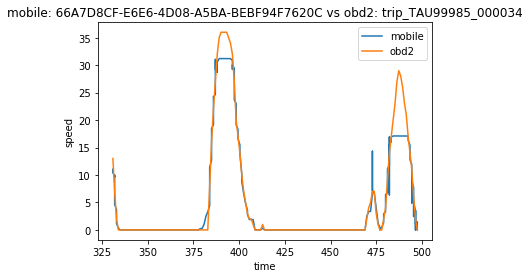

1495980237.0163 331.023
1495981153.0001 497.39


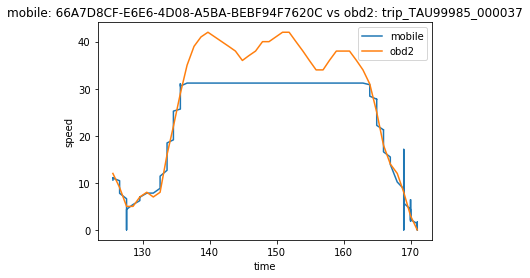

1495980237.0163 125.576
1495981153.0001 170.953


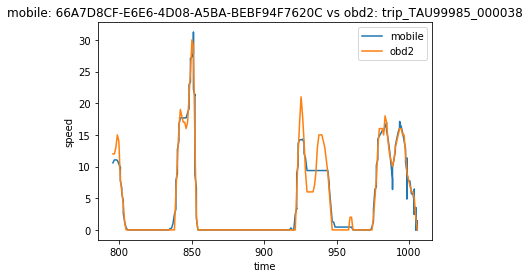

1495980237.0163 795.556
1495981153.0001 1005.762


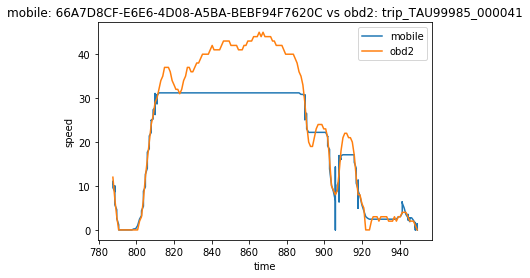

1495980237.0163 787.453
1495981153.0001 949.386


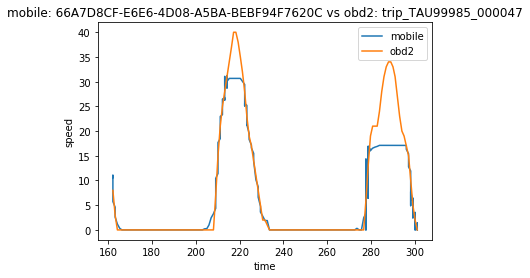

1495980237.0163 162.173
1495981153.0001 301.164


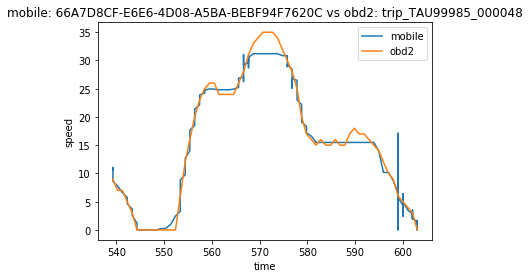

1495980237.0163 539.261
1495981153.0001 603.023


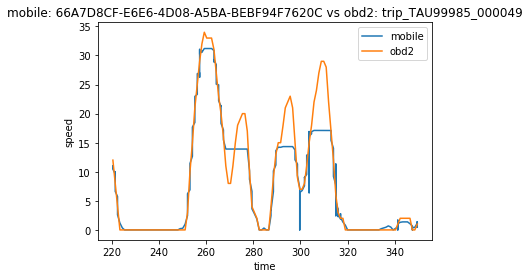

1495980237.0163 220.338
1495981153.0001 349.615


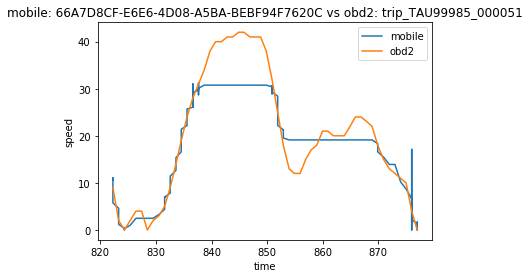

1495980237.0163 822.249
1495981153.0001 877.032


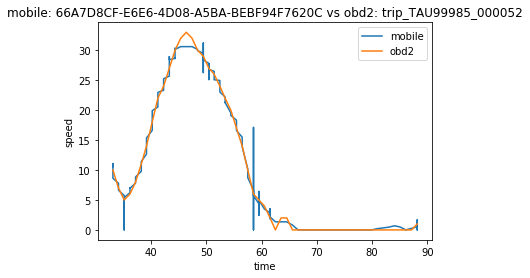

1495980237.0163 33.049
1495981153.0001 88.178


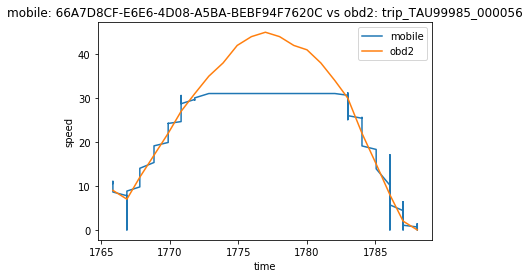

1495980237.0163 1765.836
1495981153.0001 1788.075


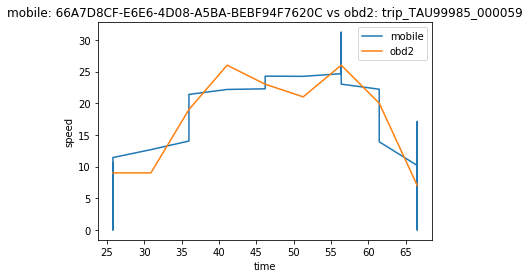

1495980237.0163 25.798
1495981153.0001 66.559


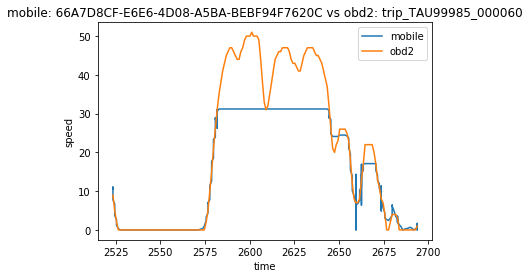

1495980237.0163 2523.344
1495981153.0001 2693.89


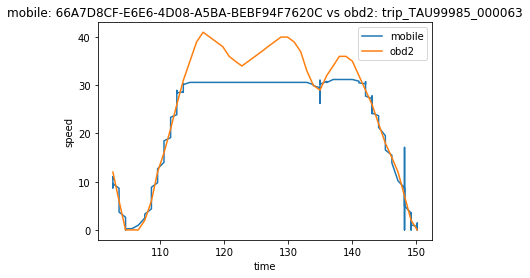

1495980237.0163 102.577
1495981153.0001 150.144


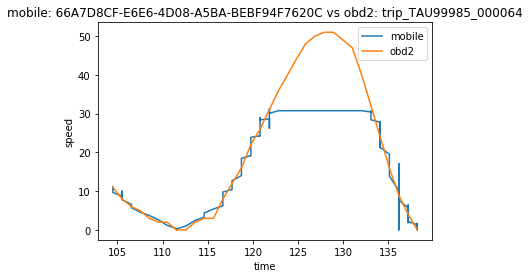

1495980237.0163 104.493
1495981153.0001 138.191


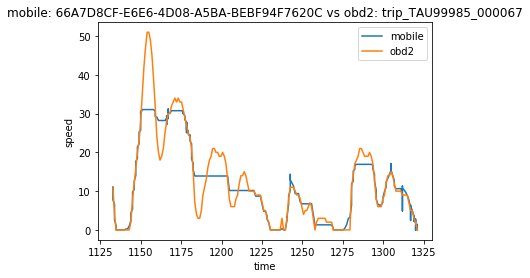

1495980237.0163 1132.725
1495981153.0001 1321.012


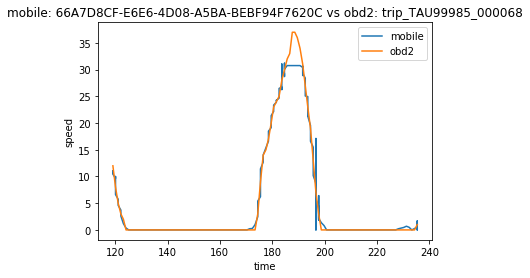

1495980237.0163 119.149
1495981153.0001 235.344


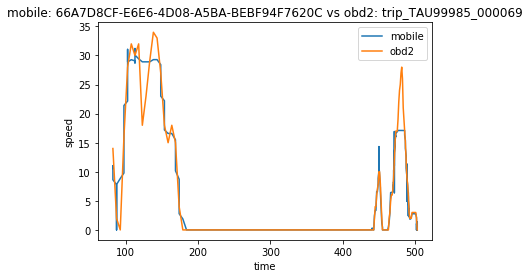

1495980237.0163 81.965
1495981153.0001 503.208


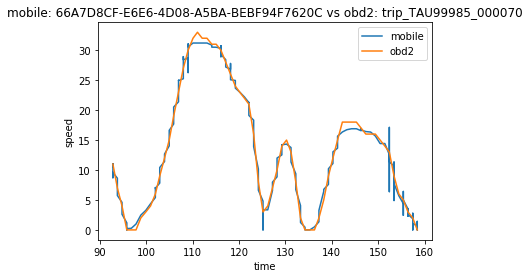

1495980237.0163 92.821
1495981153.0001 158.422


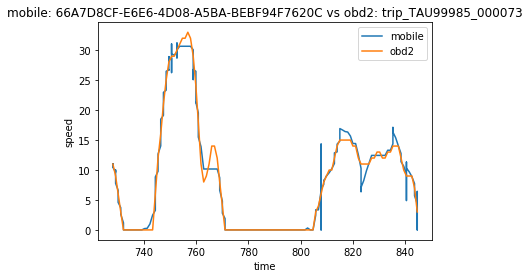

1495980237.0163 728.293
1495981153.0001 844.546


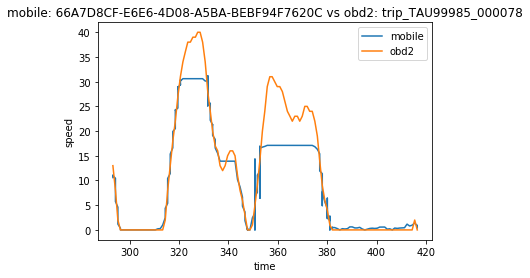

1495980237.0163 293.257
1495981153.0001 416.479


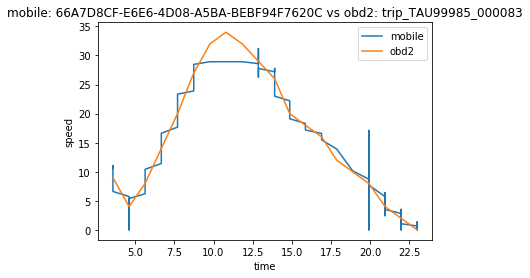

1495980237.0163 3.568
1495981153.0001 23.02


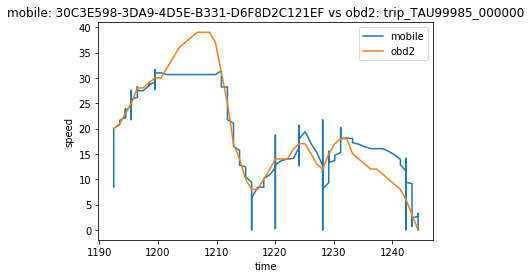

1496001627.9992 1192.446
1496002791.0001 1244.412


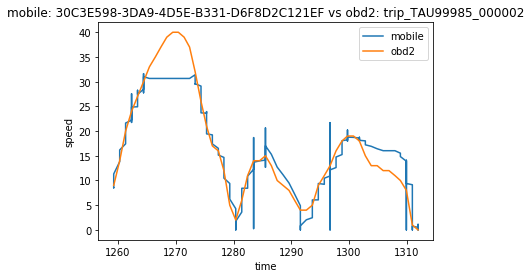

1496001627.9992 1259.235
1496002791.0001 1311.954


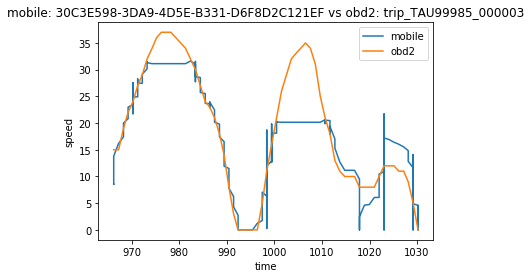

1496001627.9992 966.236
1496002791.0001 1030.204


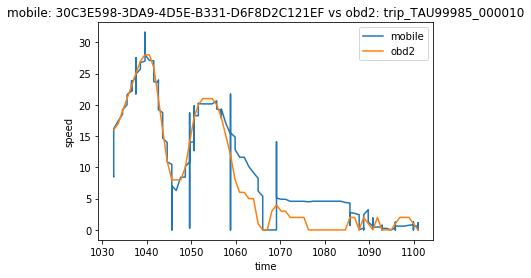

1496001627.9992 1032.56
1496002791.0001 1100.959


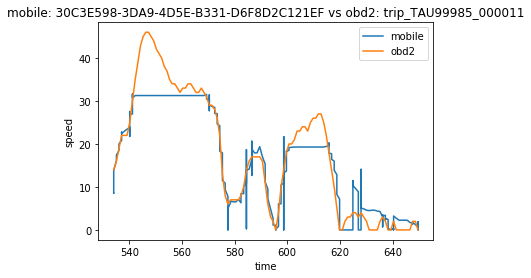

1496001627.9992 534.097
1496002791.0001 649.657


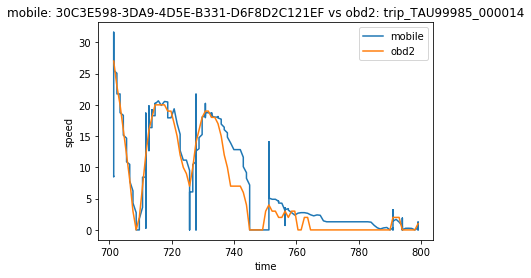

1496001627.9992 701.423
1496002791.0001 798.967


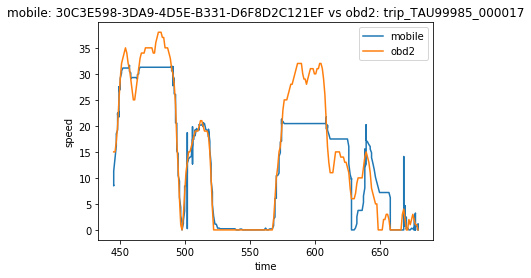

1496001627.9992 445.34
1496002791.0001 679.397


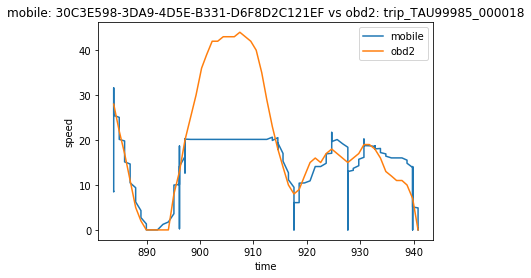

1496001627.9992 883.847
1496002791.0001 940.843


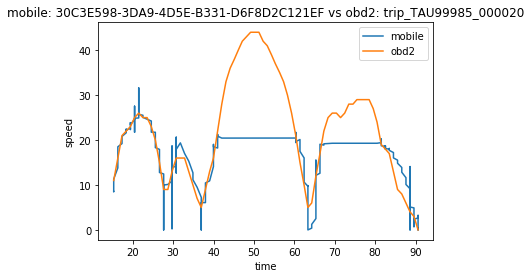

1496001627.9992 15.298
1496002791.0001 90.598


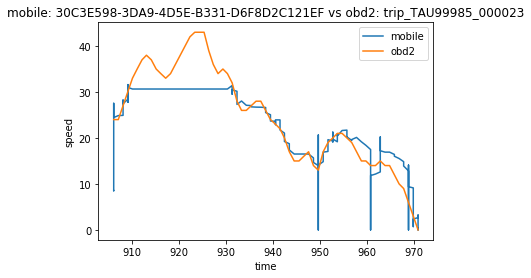

1496001627.9992 906.05
1496002791.0001 970.948


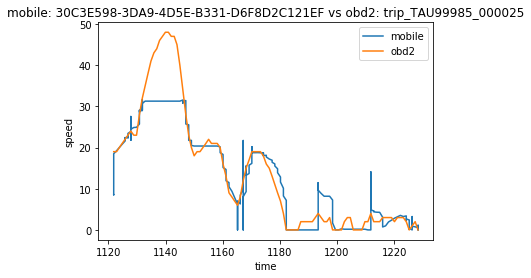

1496001627.9992 1121.851
1496002791.0001 1228.348


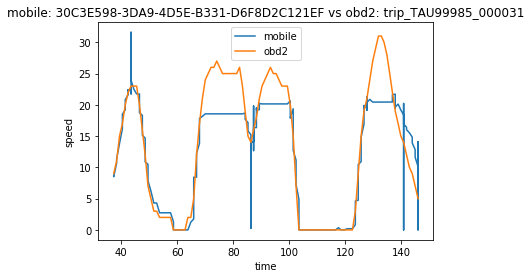

1496001627.9992 37.25
1496002791.0001 146.039


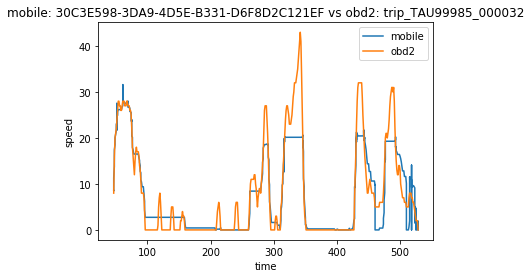

1496001627.9992 46.493
1496002791.0001 528.492


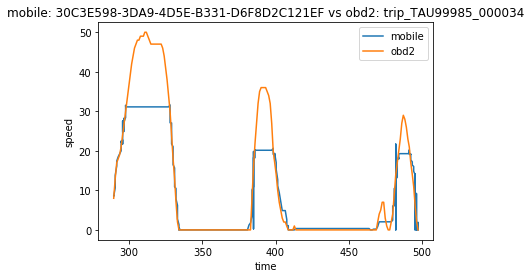

1496001627.9992 289.419
1496002791.0001 497.39


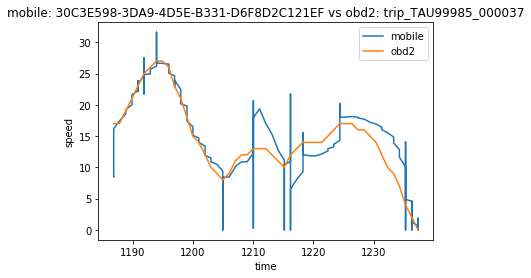

1496001627.9992 1186.877
1496002791.0001 1237.349


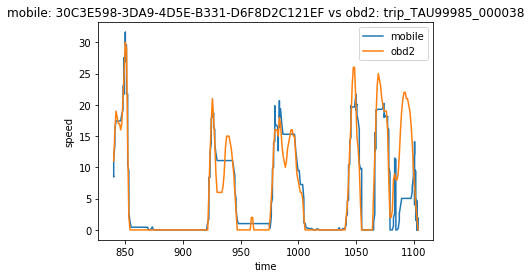

1496001627.9992 840.107
1496002791.0001 1103.586


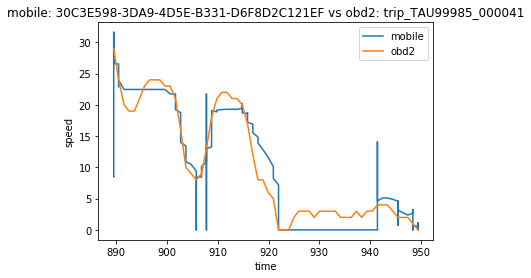

1496001627.9992 889.577
1496002791.0001 949.386


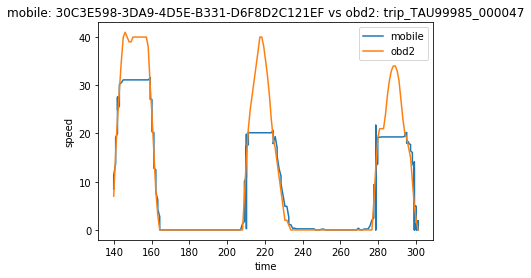

1496001627.9992 139.829
1496002791.0001 301.164


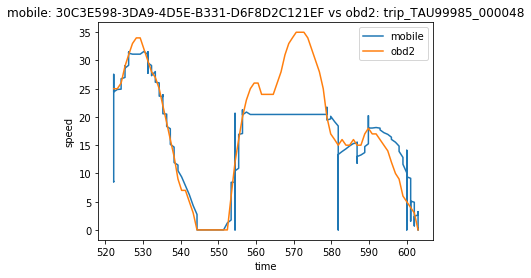

1496001627.9992 522.188
1496002791.0001 603.023


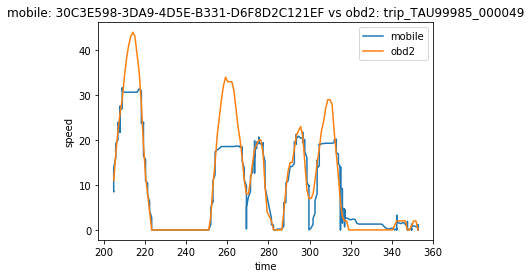

1496001627.9992 204.862
1496002791.0001 352.727


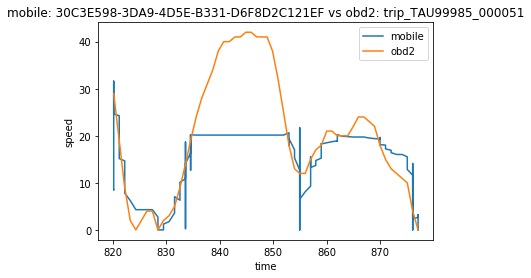

1496001627.9992 820.191
1496002791.0001 877.032


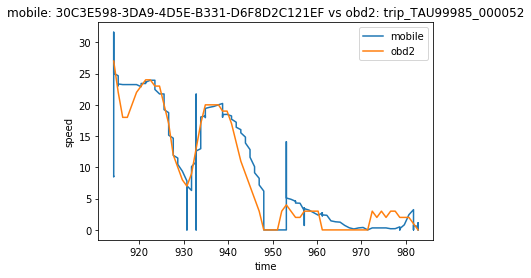

1496001627.9992 914.269
1496002791.0001 982.754


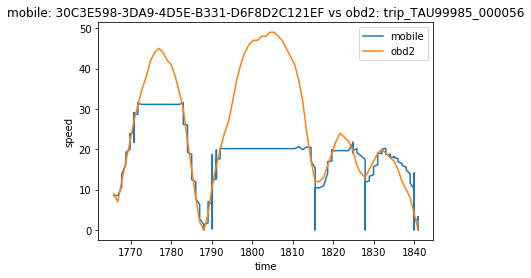

1496001627.9992 1765.836
1496002791.0001 1840.902


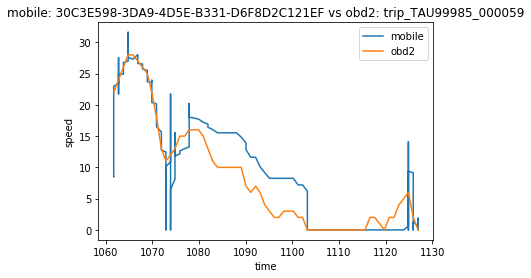

1496001627.9992 1061.716
1496002791.0001 1126.917


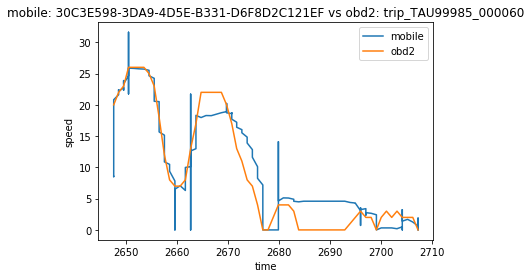

1496001627.9992 2647.529
1496002791.0001 2707.229


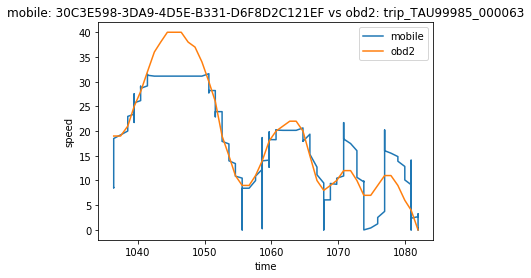

1496001627.9992 1036.408
1496002791.0001 1081.929


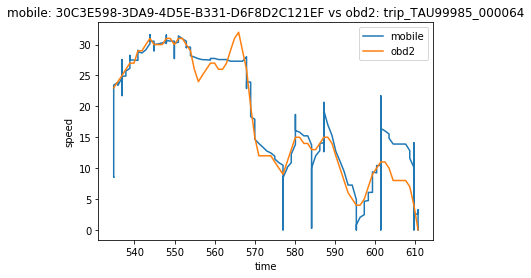

1496001627.9992 534.825
1496002791.0001 610.745


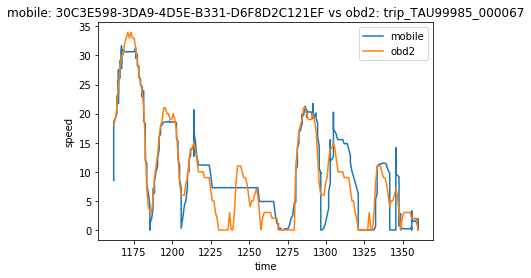

1496001627.9992 1161.885
1496002791.0001 1359.929


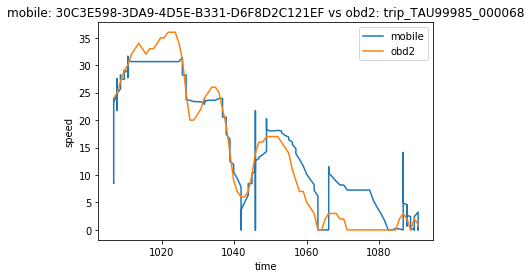

1496001627.9992 1006.75
1496002791.0001 1090.813


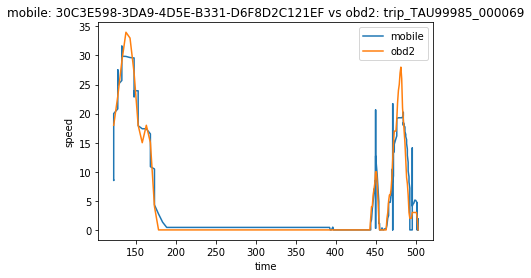

1496001627.9992 122.706
1496002791.0001 503.208


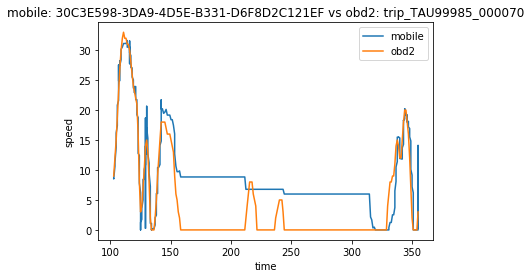

1496001627.9992 102.919
1496002791.0001 355.082


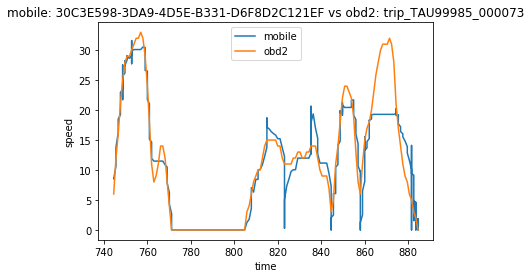

1496001627.9992 744.503
1496002791.0001 884.52


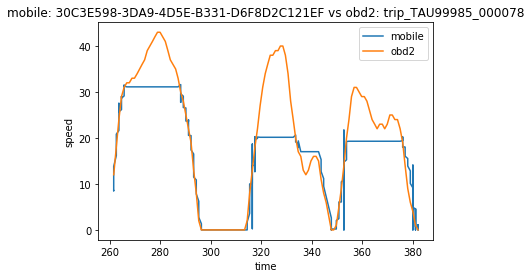

1496001627.9992 261.595
1496002791.0001 382.116


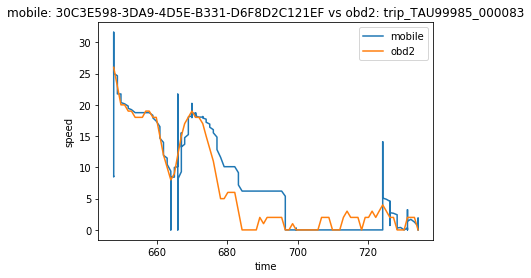

1496001627.9992 647.766
1496002791.0001 734.225


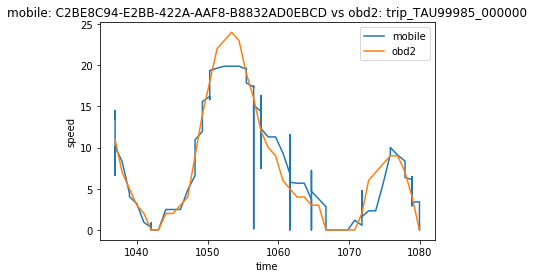

1496141957.9999 1036.933
1496142609.0002 1079.914


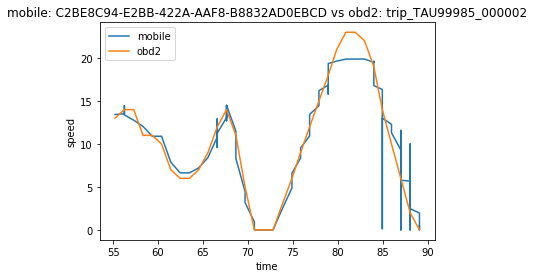

1496141957.9999 55.214
1496142609.0002 89.086


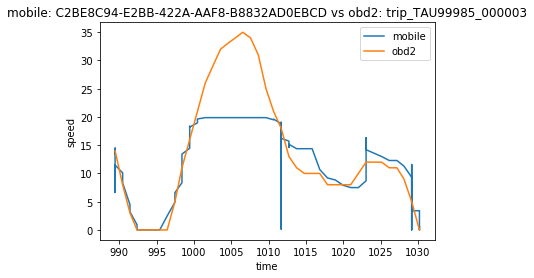

1496141957.9999 989.438
1496142609.0002 1030.204


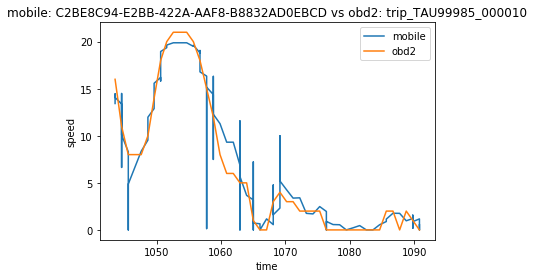

1496141957.9999 1043.564
1496142609.0002 1090.793


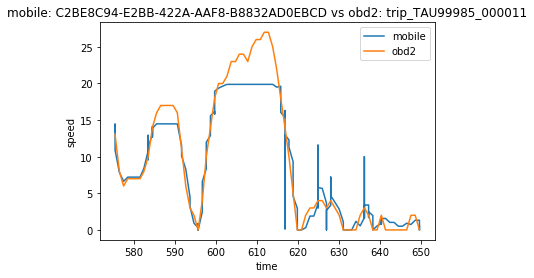

1496141957.9999 575.373
1496142609.0002 649.657


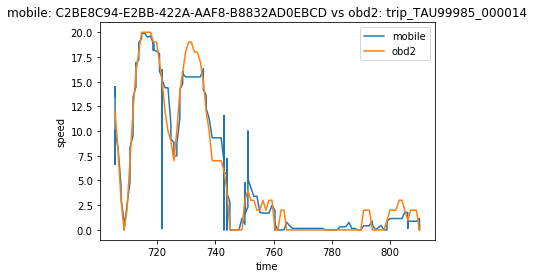

1496141957.9999 705.545
1496142609.0002 810.111


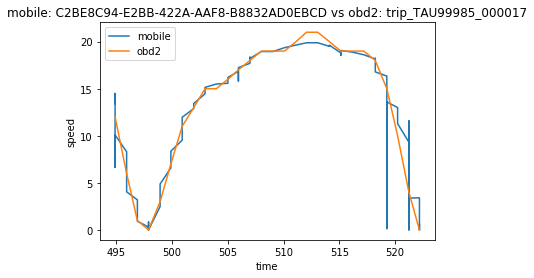

1496141957.9999 494.884
1496142609.0002 522.189


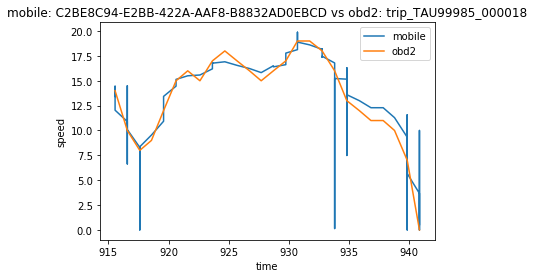

1496141957.9999 915.553
1496142609.0002 940.843


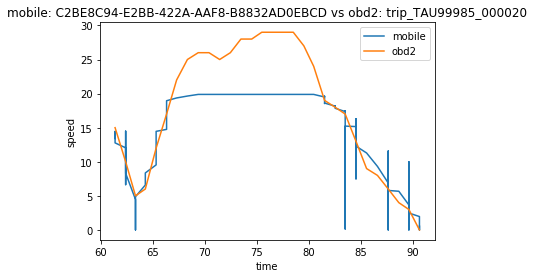

1496141957.9999 61.383
1496142609.0002 90.598


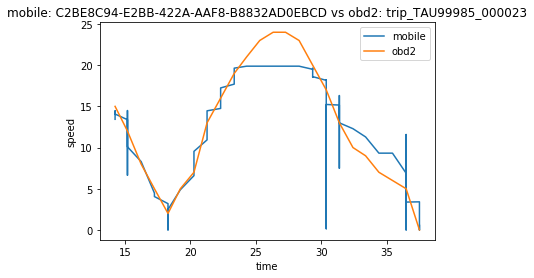

1496141957.9999 14.257
1496142609.0002 37.487


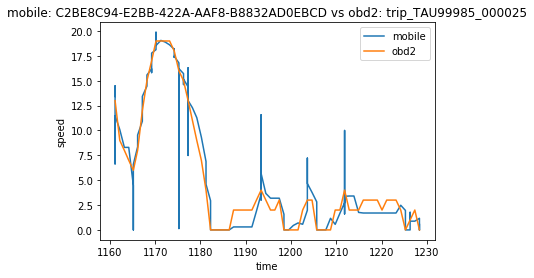

1496141957.9999 1161.154
1496142609.0002 1228.348


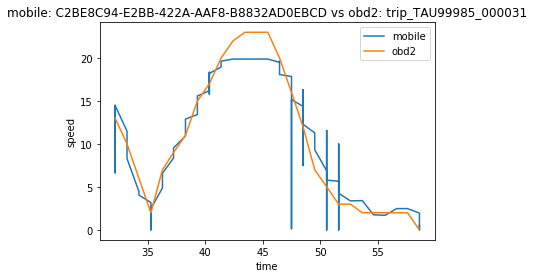

1496141957.9999 32.176
1496142609.0002 58.605


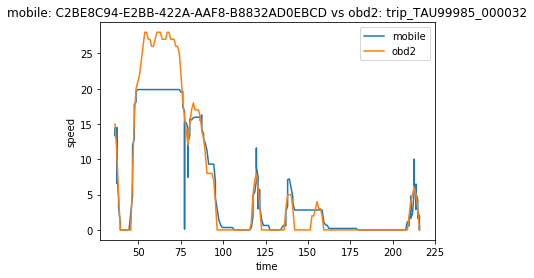

1496141957.9999 36.18
1496142609.0002 215.898


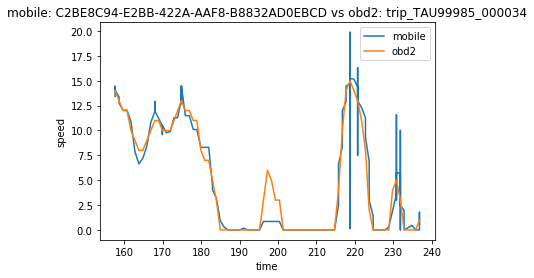

1496141957.9999 157.612
1496142609.0002 236.824


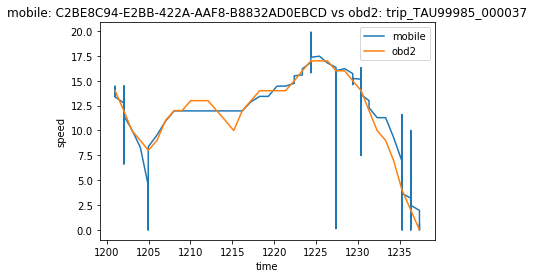

1496141957.9999 1200.998
1496142609.0002 1237.349


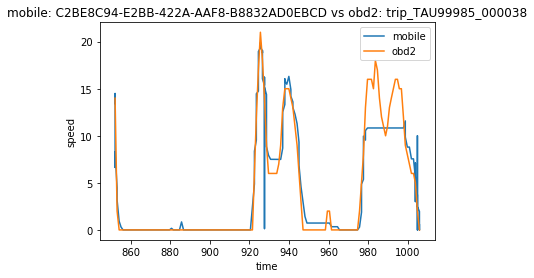

1496141957.9999 852.203
1496142609.0002 1005.762


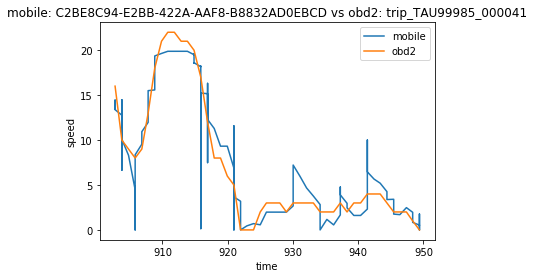

1496141957.9999 902.733
1496142609.0002 949.386


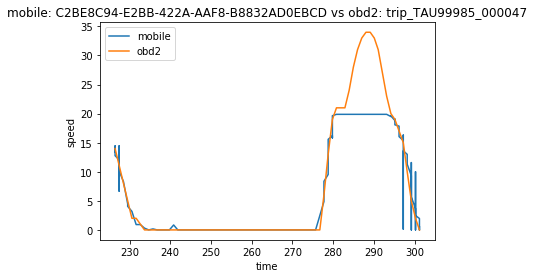

1496141957.9999 226.458
1496142609.0002 301.164


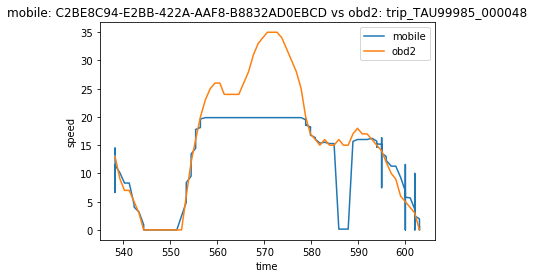

1496141957.9999 538.224
1496142609.0002 603.023


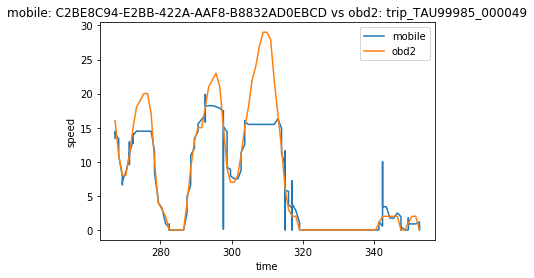

1496141957.9999 267.292
1496142609.0002 352.727


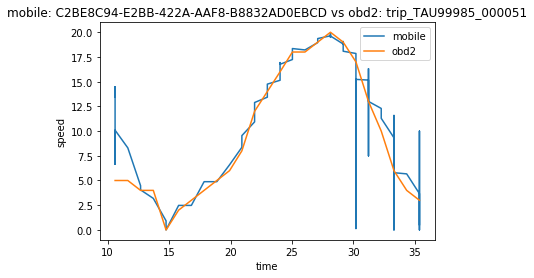

1496141957.9999 10.607
1496142609.0002 35.373


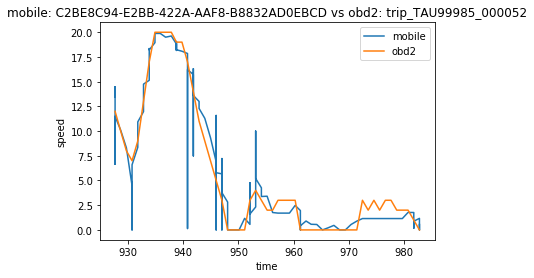

1496141957.9999 927.67
1496142609.0002 982.754


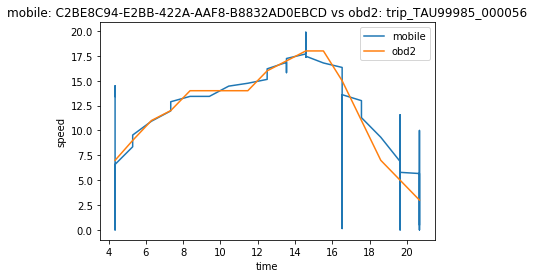

1496141957.9999 4.349
1496142609.0002 20.678


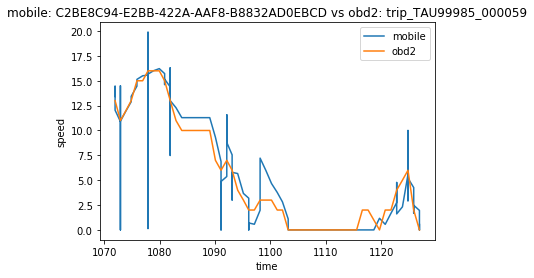

1496141957.9999 1071.929
1496142609.0002 1126.917


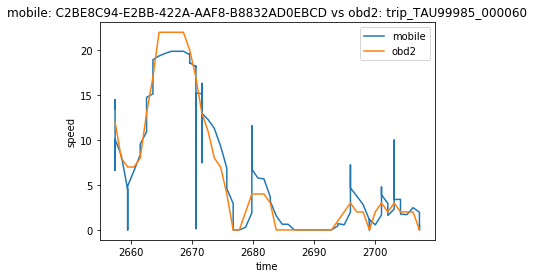

1496141957.9999 2657.475
1496142609.0002 2707.229


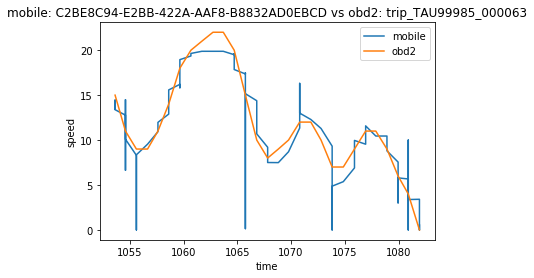

1496141957.9999 1053.641
1496142609.0002 1081.929


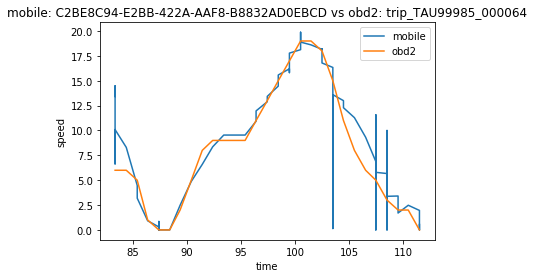

1496141957.9999 83.35
1496142609.0002 111.526


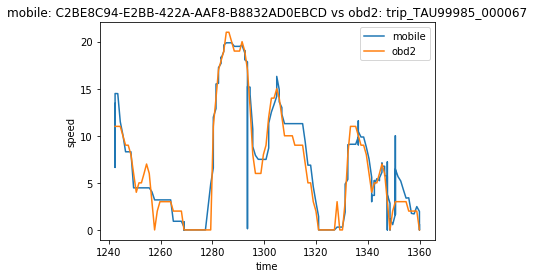

1496141957.9999 1242.463
1496142609.0002 1359.929


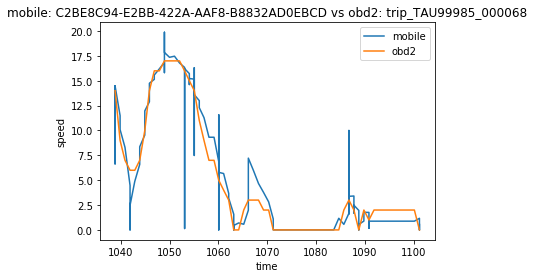

1496141957.9999 1038.858
1496142609.0002 1101.148


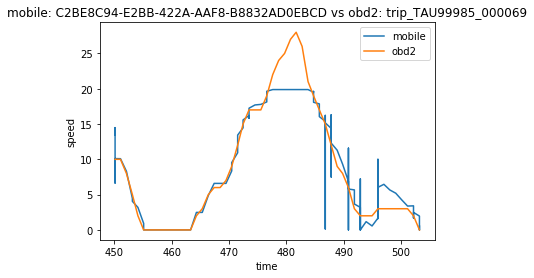

1496141957.9999 450.13
1496142609.0002 503.208


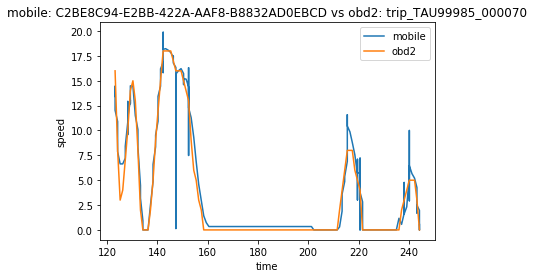

1496141957.9999 123.16
1496142609.0002 244.231


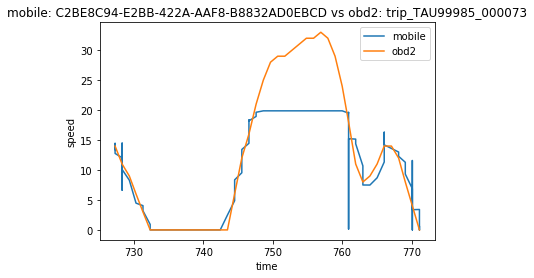

1496141957.9999 727.278
1496142609.0002 771.129


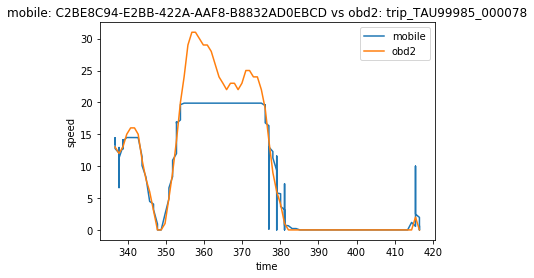

1496141957.9999 336.645
1496142609.0002 416.479


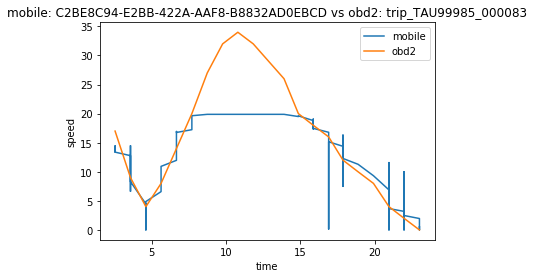

1496141957.9999 2.531
1496142609.0002 23.02


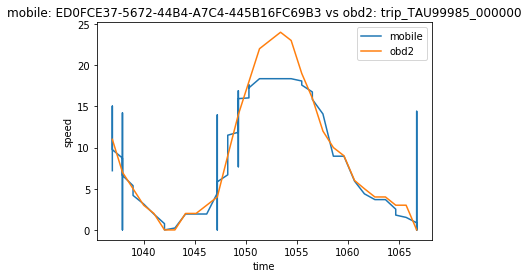

1496173633.9999 1036.933
1496174092 1066.714


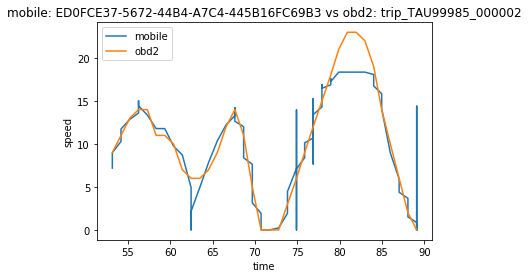

1496173633.9999 53.156
1496174092 89.086


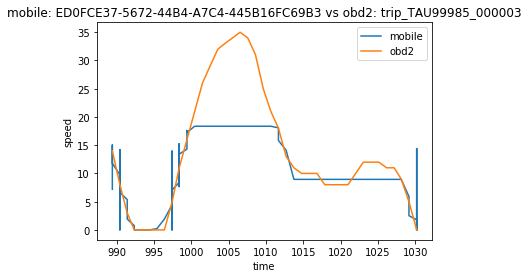

1496173633.9999 989.438
1496174092 1030.204


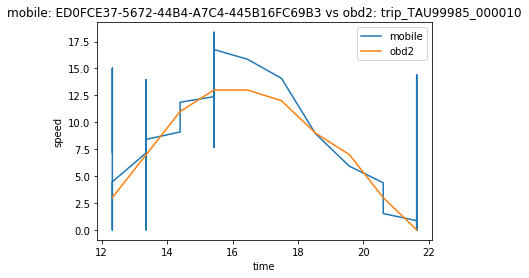

1496173633.9999 12.329
1496174092 21.626


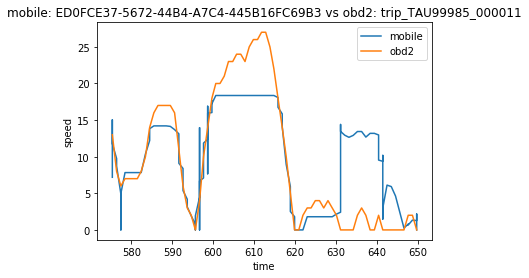

1496173633.9999 575.373
1496174092 649.657


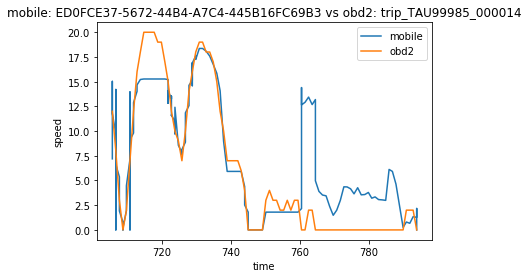

1496173633.9999 705.545
1496174092 793.924


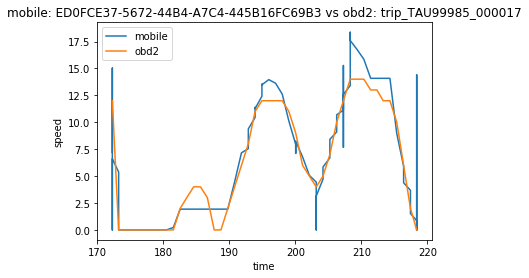

1496173633.9999 172.295
1496174092 218.367


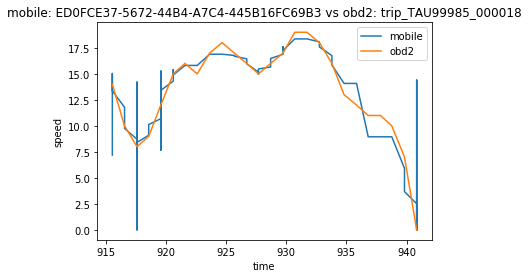

1496173633.9999 915.553
1496174092 940.843


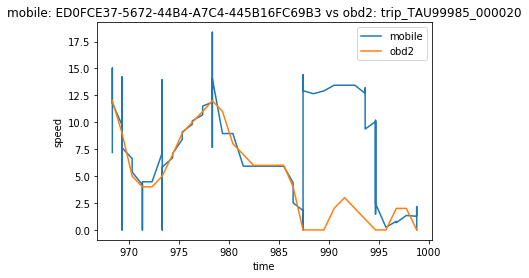

1496173633.9999 968.385
1496174092 998.784


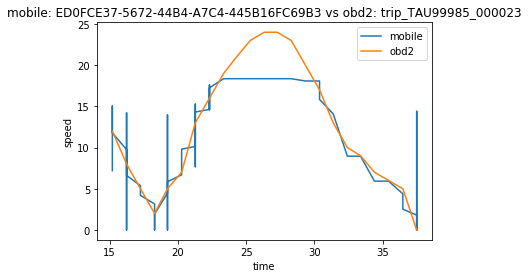

1496173633.9999 15.202
1496174092 37.487


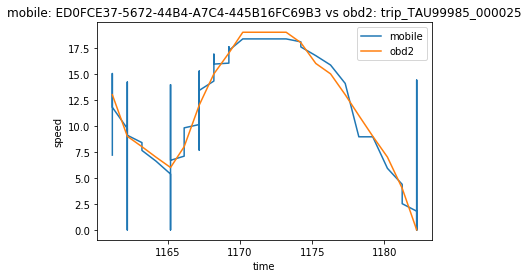

1496173633.9999 1161.154
1496174092 1182.233


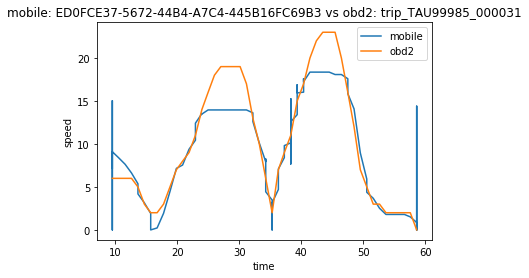

1496173633.9999 9.501
1496174092 58.605


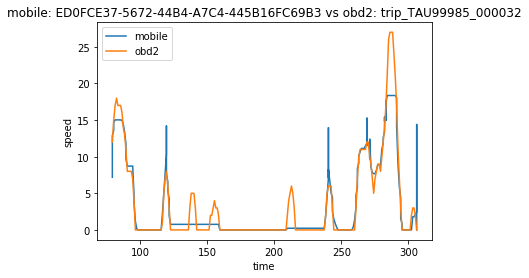

1496173633.9999 79.258
1496174092 306.204


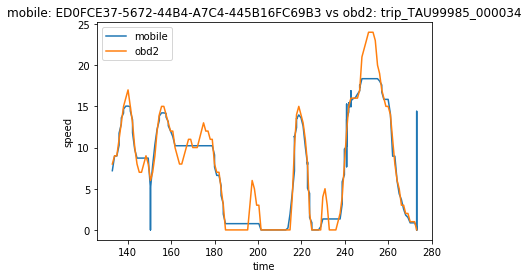

1496173633.9999 132.851
1496174092 273.077


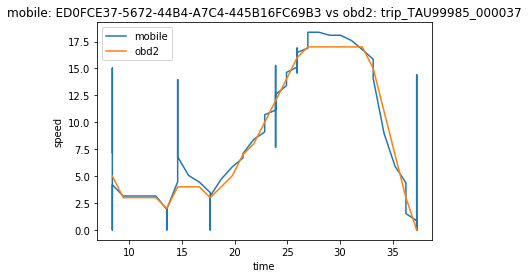

1496173633.9999 8.372
1496174092 37.273


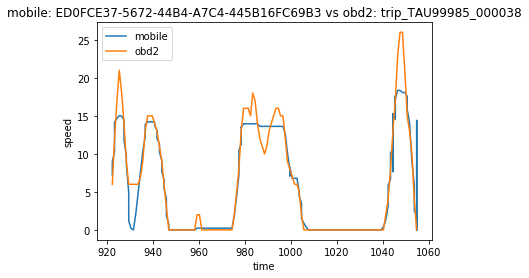

1496173633.9999 922.508
1496174092 1054.789


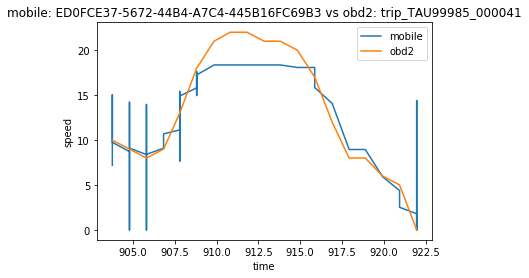

1496173633.9999 903.769
1496174092 921.969


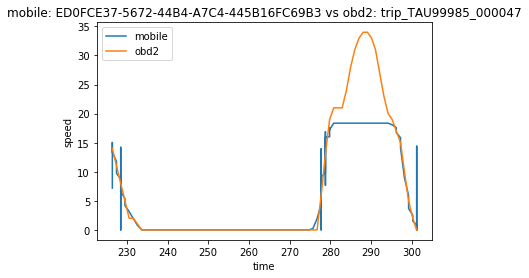

1496173633.9999 226.458
1496174092 301.164


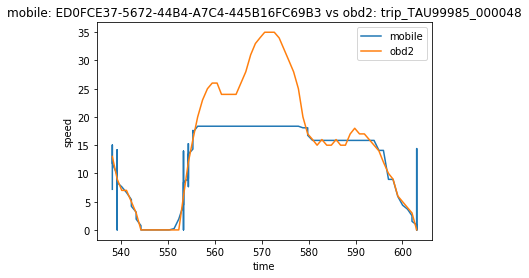

1496173633.9999 538.224
1496174092 603.023


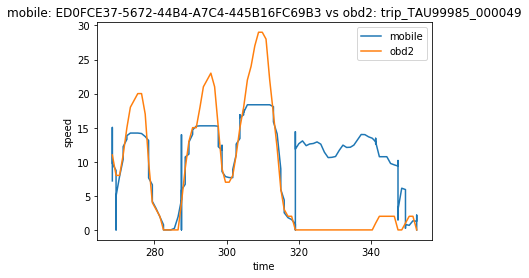

1496173633.9999 268.307
1496174092 352.727


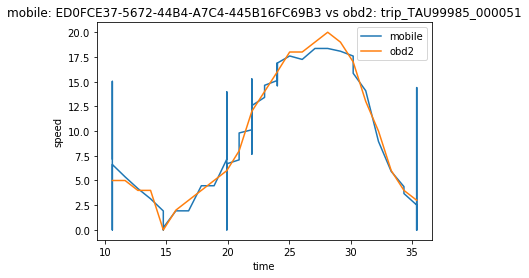

1496173633.9999 10.607
1496174092 35.373


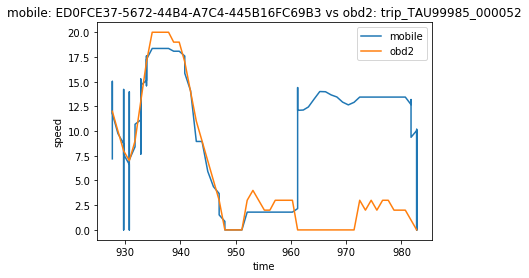

1496173633.9999 927.67
1496174092 982.754


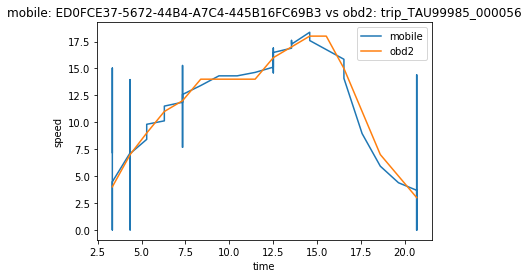

1496173633.9999 3.334
1496174092 20.678


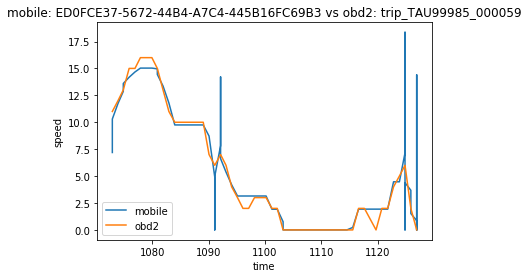

1496173633.9999 1072.894
1496174092 1126.917


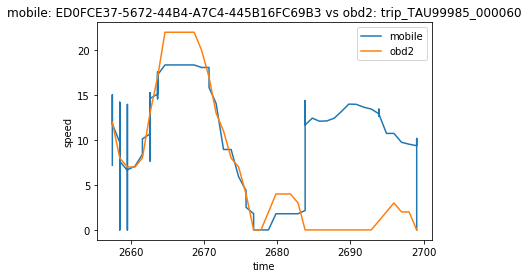

1496173633.9999 2657.475
1496174092 2699.057


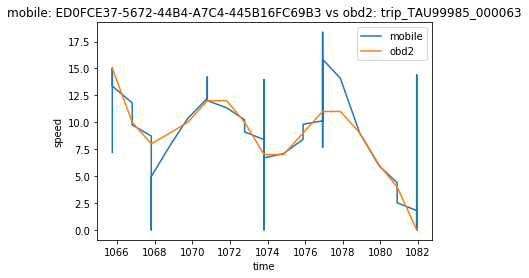

1496173633.9999 1065.751
1496174092 1081.929


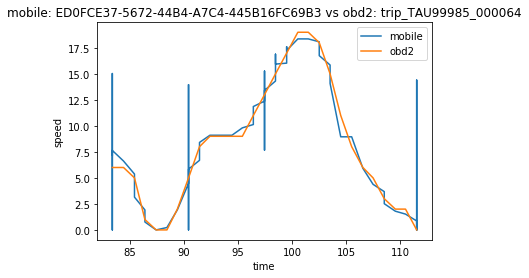

1496173633.9999 83.35
1496174092 111.526


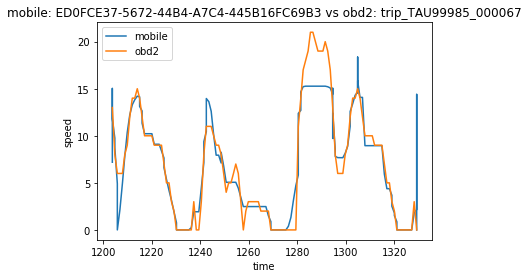

1496173633.9999 1203.717
1496174092 1329.183


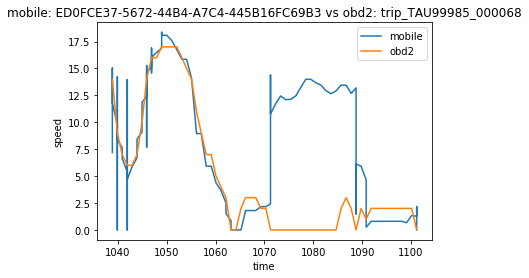

1496173633.9999 1038.858
1496174092 1101.148


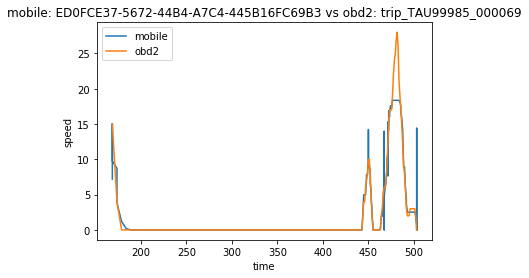

1496173633.9999 168.582
1496174092 503.208


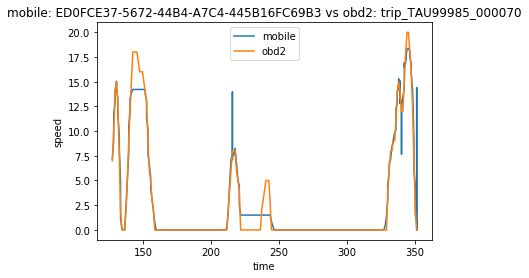

1496173633.9999 127.217
1496174092 351.1


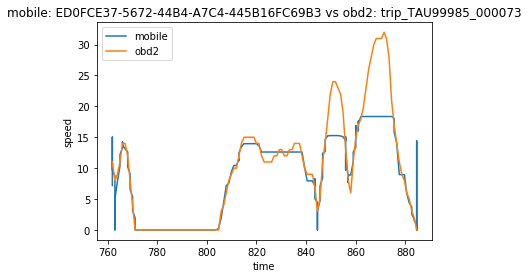

1496173633.9999 761.944
1496174092 884.52


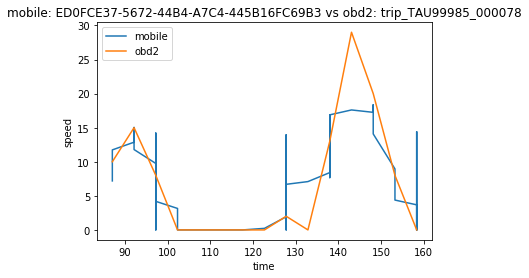

1496173633.9999 87.051
1496174092 158.367


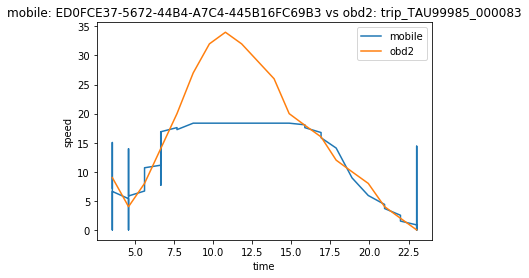

1496173633.9999 3.568
1496174092 23.02


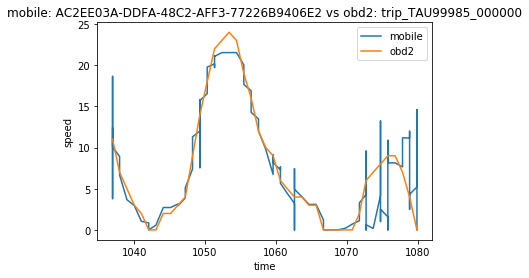

1496198037.0001 1036.933
1496198861.9987 1079.914


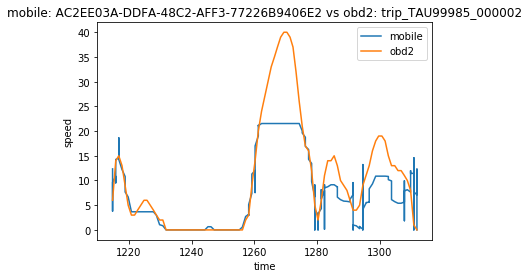

1496198037.0001 1214.756
1496198861.9987 1311.954


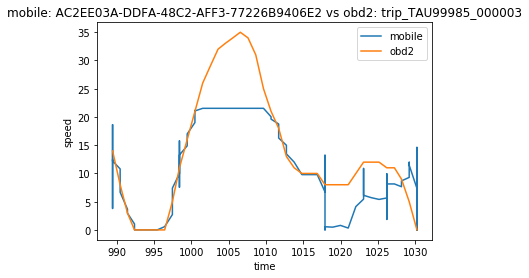

1496198037.0001 989.438
1496198861.9987 1030.204


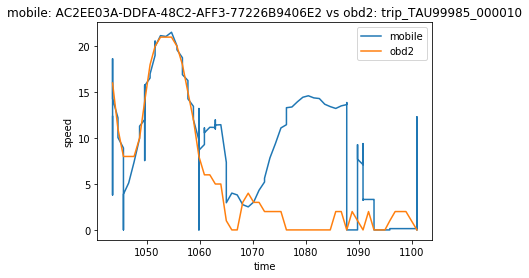

1496198037.0001 1043.564
1496198861.9987 1100.959


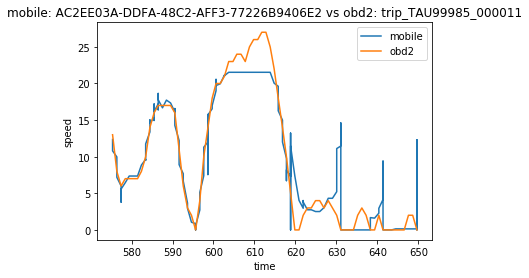

1496198037.0001 575.373
1496198861.9987 649.657


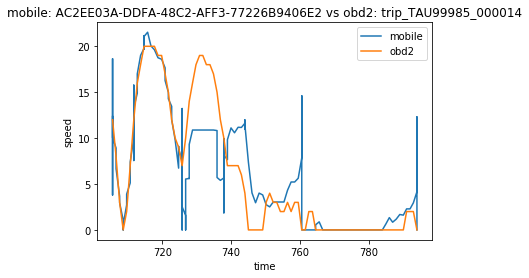

1496198037.0001 705.545
1496198861.9987 793.924


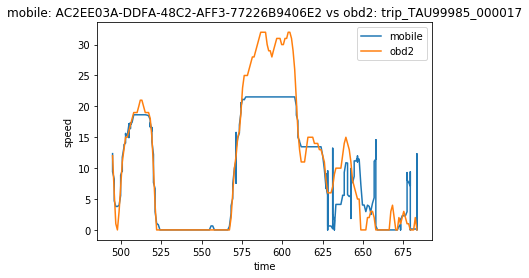

1496198037.0001 494.884
1496198861.9987 683.506


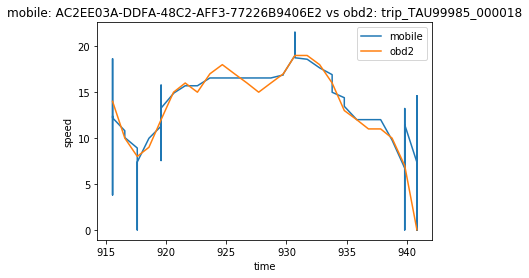

1496198037.0001 915.553
1496198861.9987 940.843


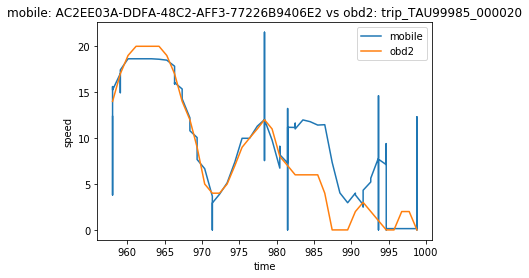

1496198037.0001 958.032
1496198861.9987 998.784


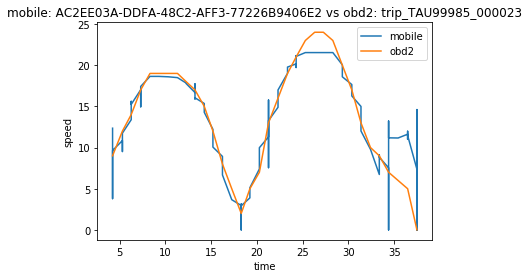

1496198037.0001 4.242
1496198861.9987 37.487


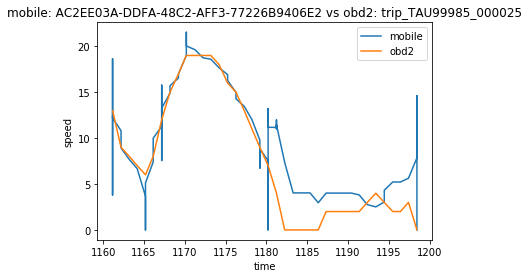

1496198037.0001 1161.154
1496198861.9987 1198.434


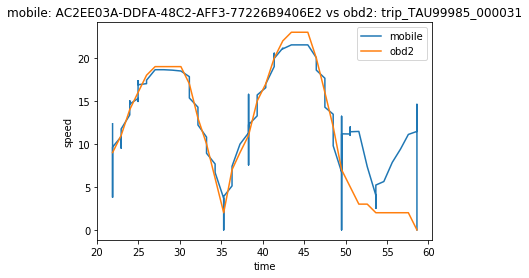

1496198037.0001 21.872
1496198861.9987 58.605


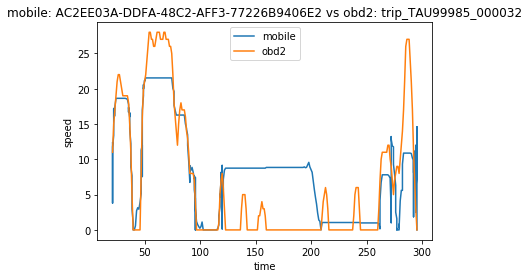

1496198037.0001 20.709
1496198861.9987 295.315


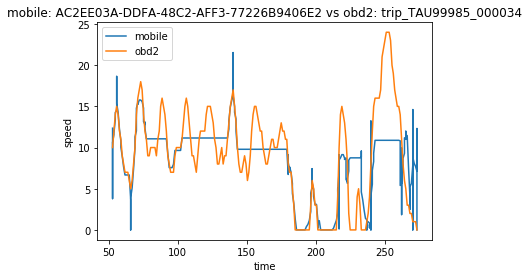

1496198037.0001 52.842
1496198861.9987 273.077


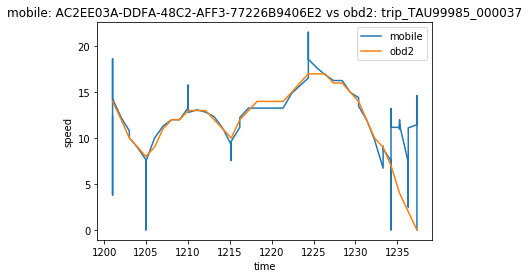

1496198037.0001 1200.998
1496198861.9987 1237.349


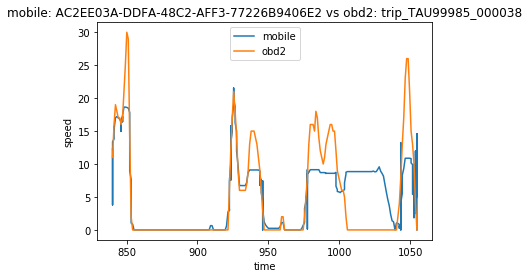

1496198037.0001 840.107
1496198861.9987 1054.789


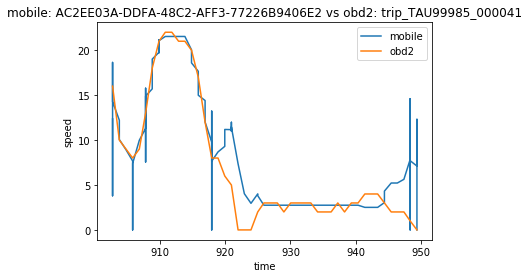

1496198037.0001 902.733
1496198861.9987 949.386


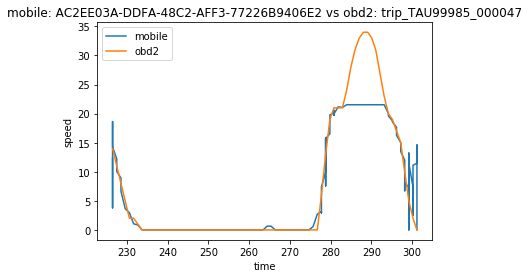

1496198037.0001 226.458
1496198861.9987 301.164


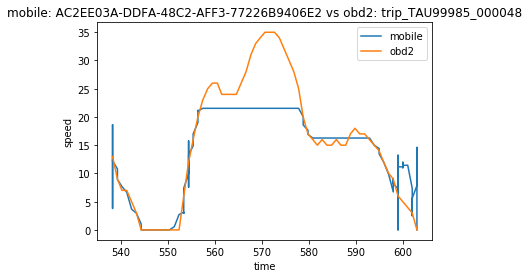

1496198037.0001 538.224
1496198861.9987 603.023


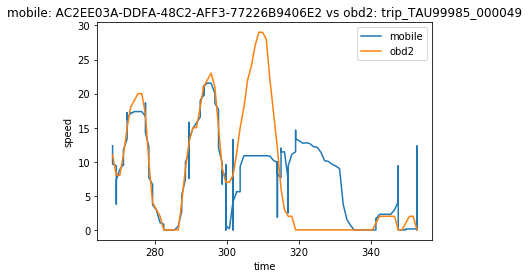

1496198037.0001 268.307
1496198861.9987 352.727


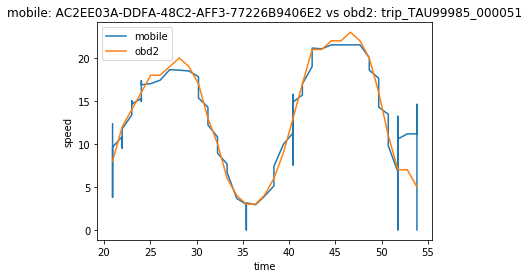

1496198037.0001 20.924
1496198861.9987 53.806


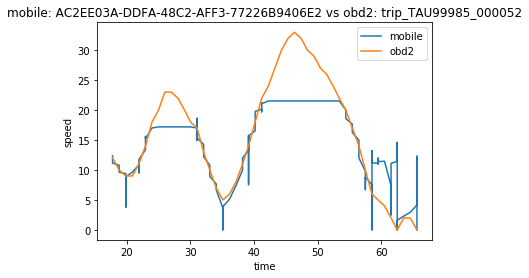

1496198037.0001 17.779
1496198861.9987 65.58


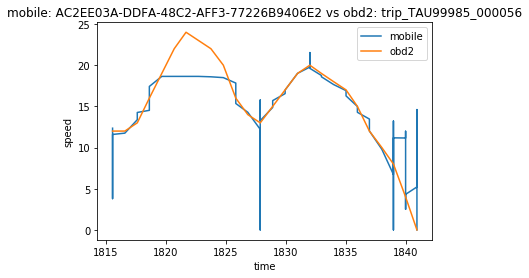

1496198037.0001 1815.544
1496198861.9987 1840.902


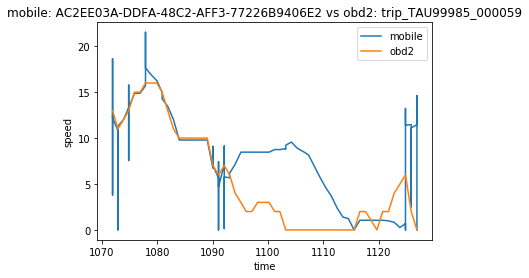

1496198037.0001 1071.929
1496198861.9987 1126.917


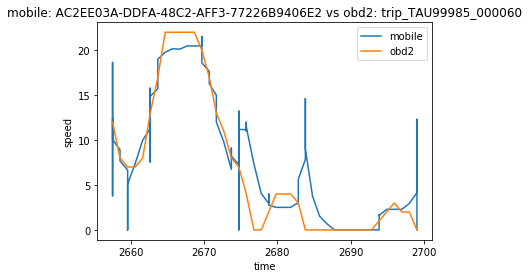

1496198037.0001 2657.475
1496198861.9987 2699.057


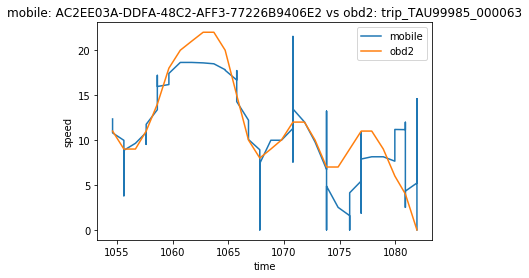

1496198037.0001 1054.607
1496198861.9987 1081.929


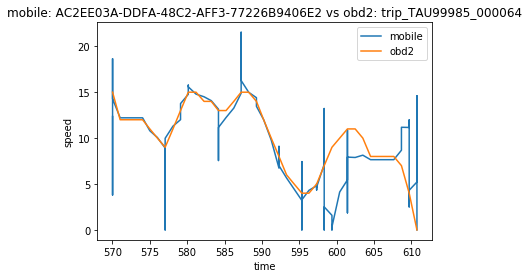

1496198037.0001 570.018
1496198861.9987 610.745


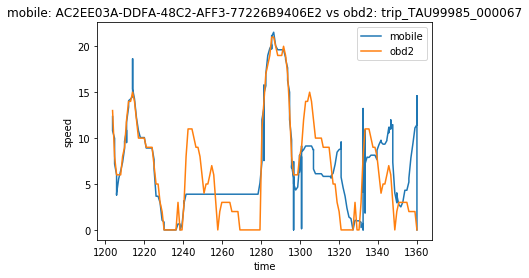

1496198037.0001 1203.717
1496198861.9987 1359.929


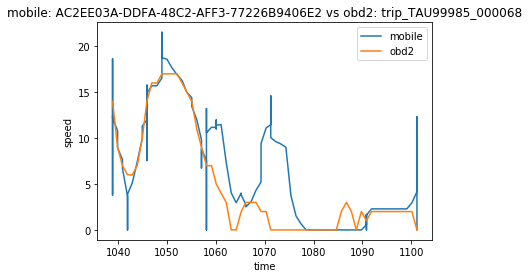

1496198037.0001 1038.858
1496198861.9987 1101.148


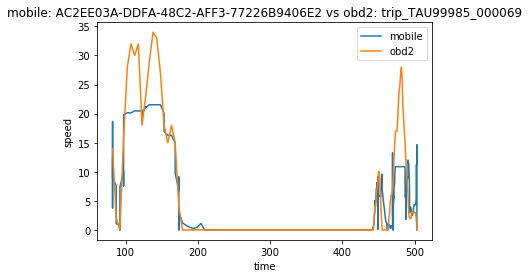

1496198037.0001 81.965
1496198861.9987 503.208


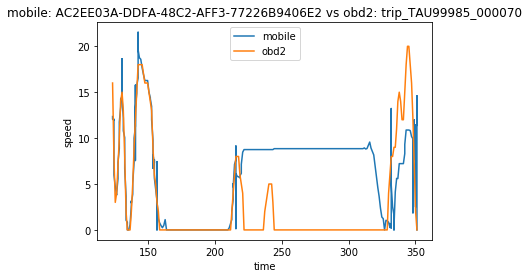

1496198037.0001 123.16
1496198861.9987 351.1


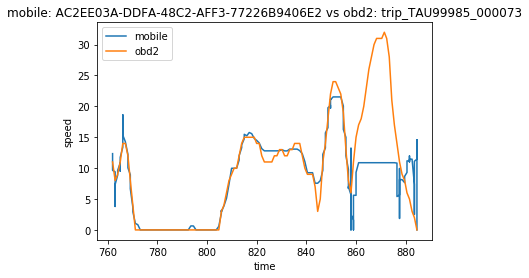

1496198037.0001 761.944
1496198861.9987 884.52


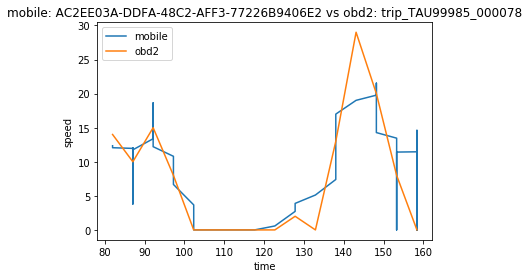

1496198037.0001 81.958
1496198861.9987 158.367


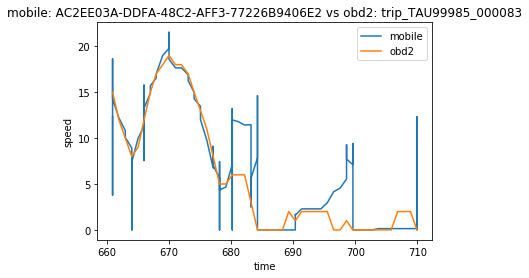

1496198037.0001 660.891
1496198861.9987 709.921


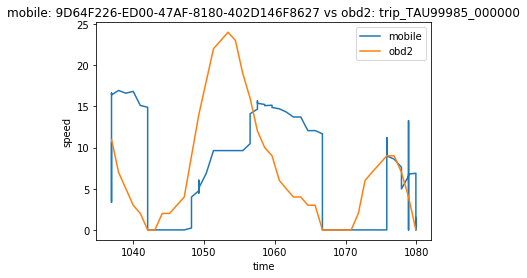

1496334977.0002 1036.933
1496335584.9991 1079.914


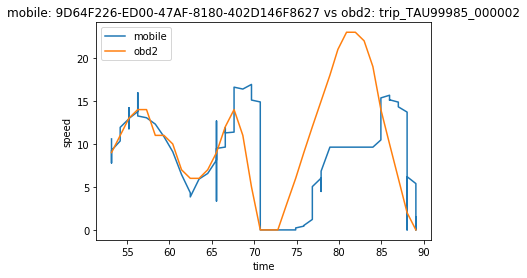

1496334977.0002 53.156
1496335584.9991 89.086


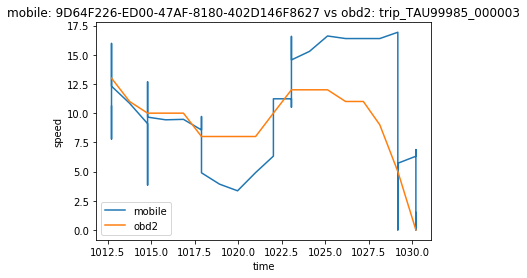

1496334977.0002 1012.722
1496335584.9991 1030.204


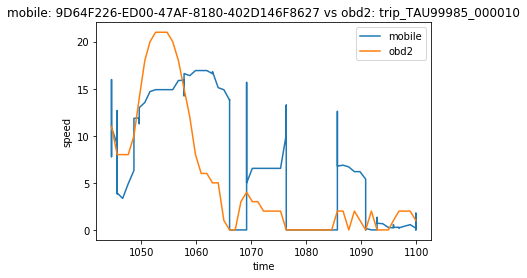

1496334977.0002 1044.579
1496335584.9991 1099.923


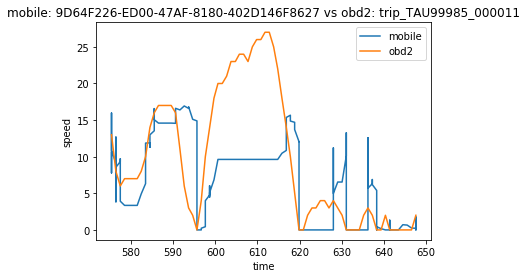

1496334977.0002 575.373
1496335584.9991 647.585


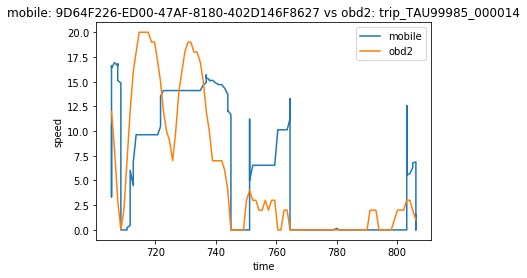

1496334977.0002 705.545
1496335584.9991 806.094


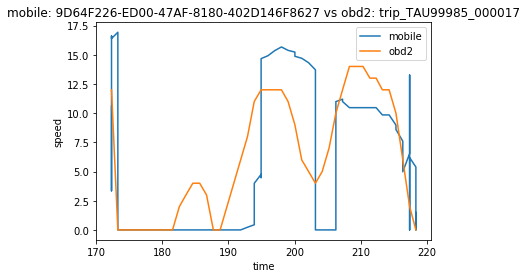

1496334977.0002 172.295
1496335584.9991 218.367


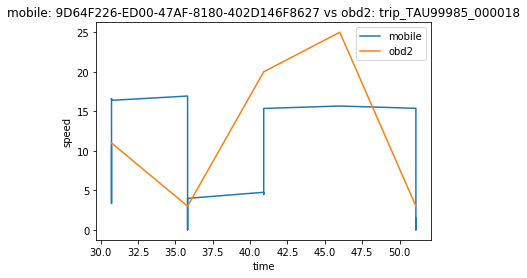

1496334977.0002 30.724
1496335584.9991 51.093


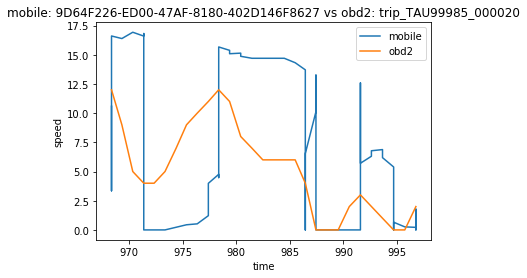

1496334977.0002 968.385
1496335584.9991 996.746


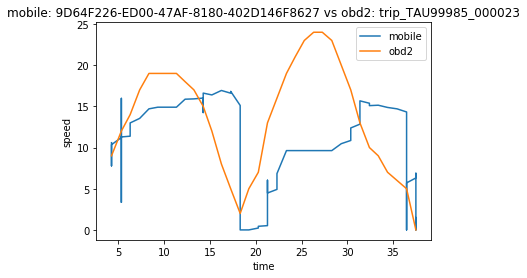

1496334977.0002 4.242
1496335584.9991 37.487


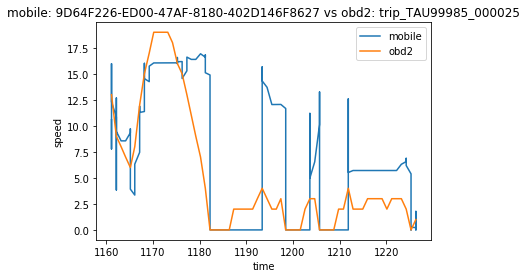

1496334977.0002 1161.154
1496335584.9991 1226.29


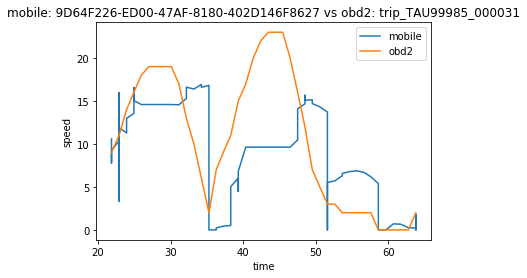

1496334977.0002 21.872
1496335584.9991 63.772


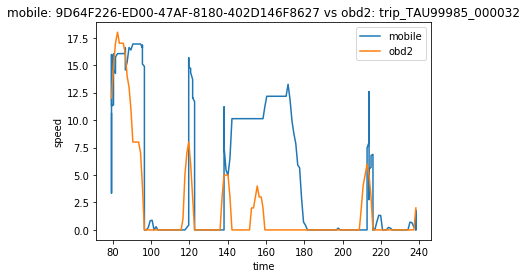

1496334977.0002 79.258
1496335584.9991 238.328


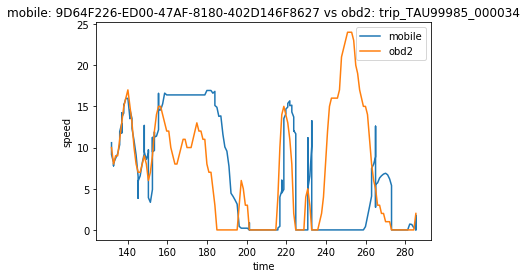

1496334977.0002 131.829
1496335584.9991 285.36


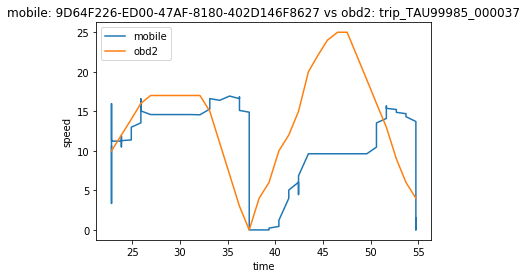

1496334977.0002 22.838
1496335584.9991 54.741


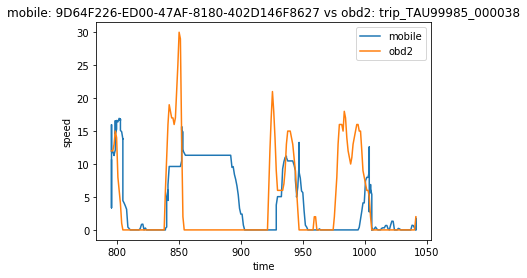

1496334977.0002 795.556
1496335584.9991 1041.358


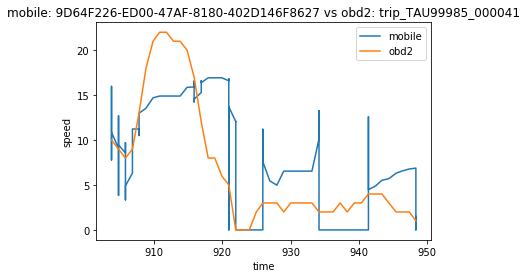

1496334977.0002 903.769
1496335584.9991 948.35


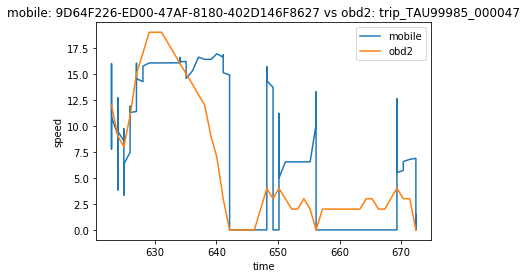

1496334977.0002 622.972
1496335584.9991 672.397


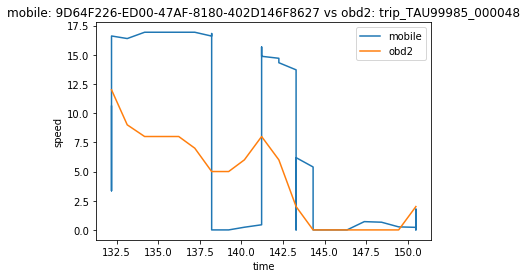

1496334977.0002 132.187
1496335584.9991 150.483


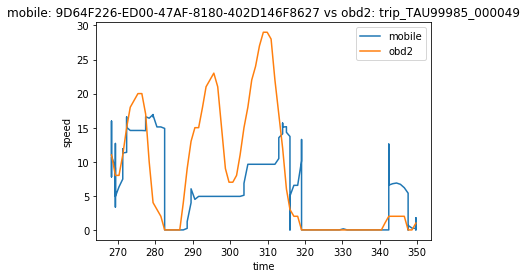

1496334977.0002 268.307
1496335584.9991 349.615


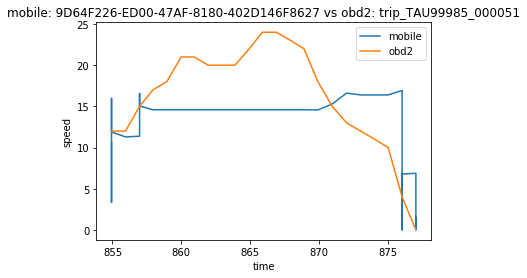

1496334977.0002 854.929
1496335584.9991 877.032


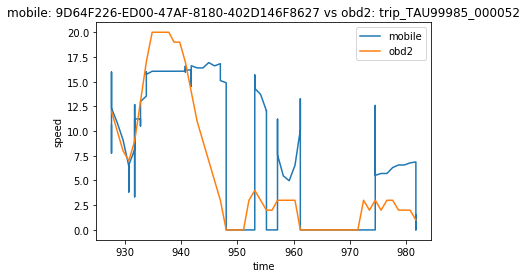

1496334977.0002 927.67
1496335584.9991 981.73


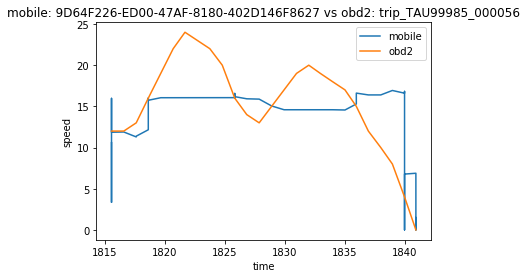

1496334977.0002 1815.544
1496335584.9991 1840.902


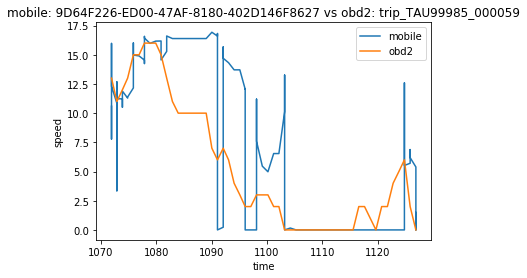

1496334977.0002 1071.929
1496335584.9991 1126.917


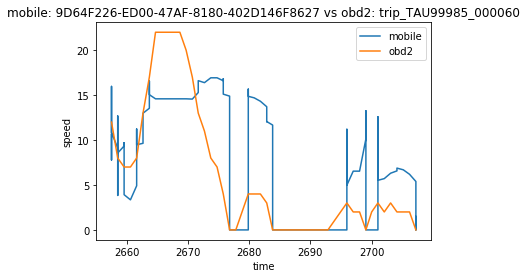

1496334977.0002 2657.475
1496335584.9991 2707.229


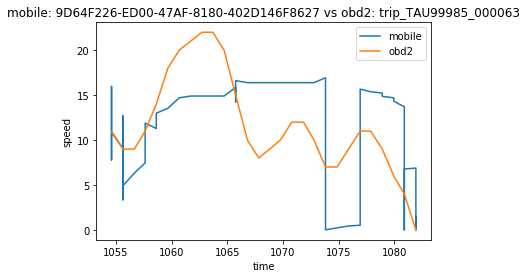

1496334977.0002 1054.607
1496335584.9991 1081.929


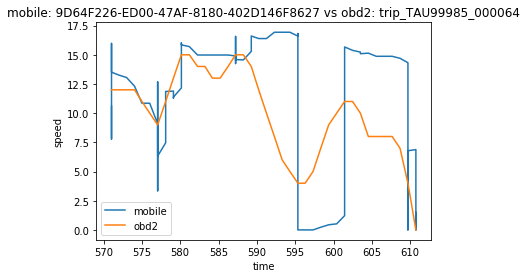

1496334977.0002 571.033
1496335584.9991 610.745


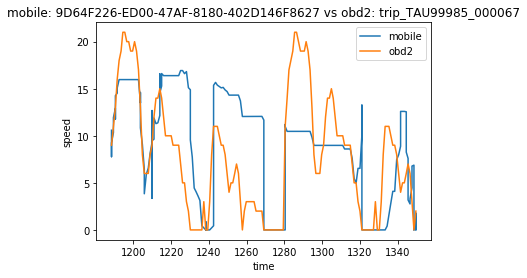

1496334977.0002 1188.418
1496335584.9991 1349.594


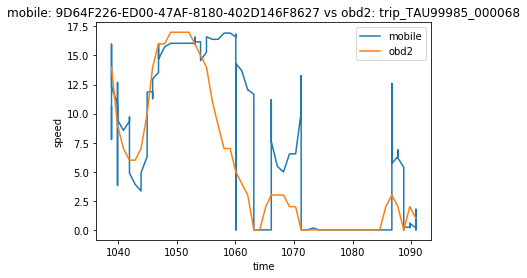

1496334977.0002 1038.858
1496335584.9991 1090.813


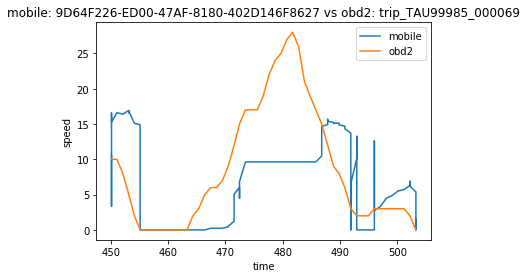

1496334977.0002 450.13
1496335584.9991 503.208


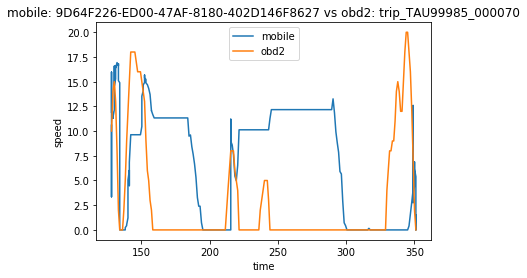

1496334977.0002 128.201
1496335584.9991 351.1


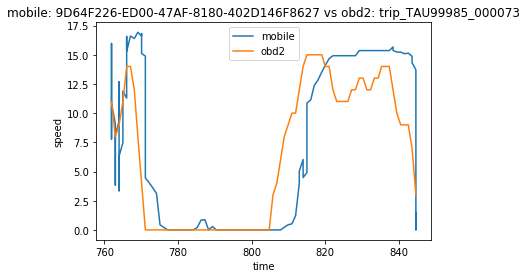

1496334977.0002 761.944
1496335584.9991 844.546


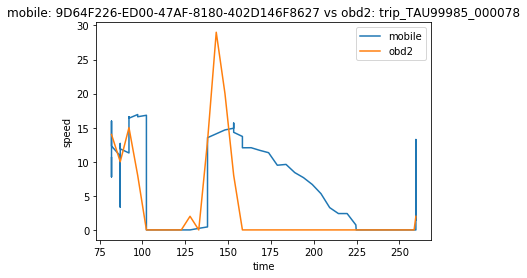

1496334977.0002 81.958
1496335584.9991 259.628


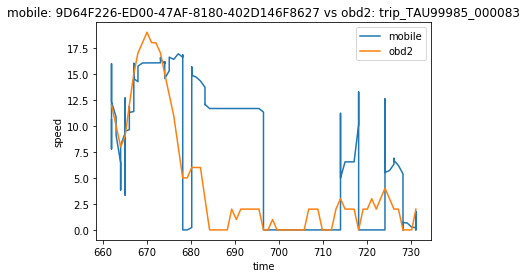

1496334977.0002 661.906
1496335584.9991 731.218


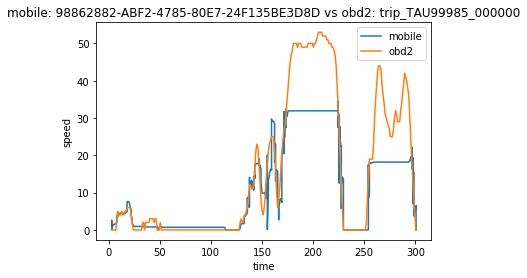

1496346170.9989 3.116
1496348272 300.682


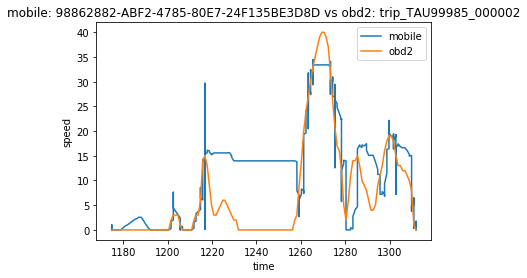

1496346170.9989 1174.723
1496348272 1311.954


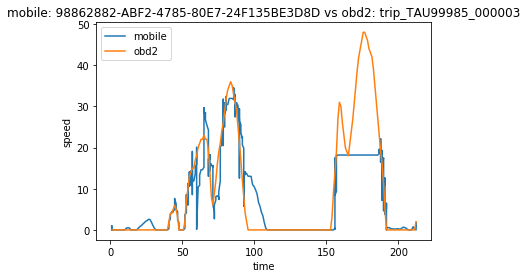

1496346170.9989 1.123
1496348272 212.221


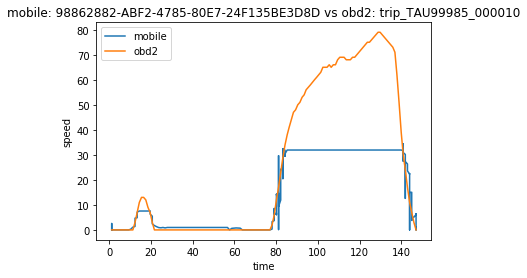

1496346170.9989 1.144
1496348272 147.117


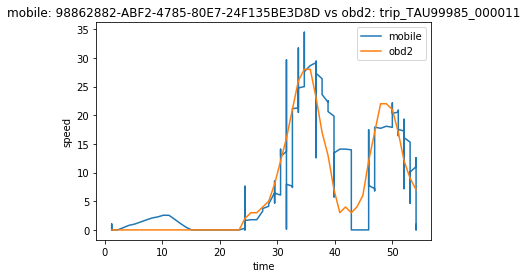

1496346170.9989 1.163
1496348272 54.141


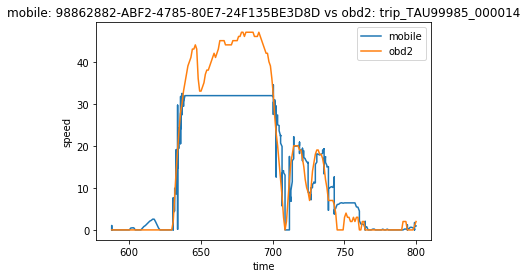

1496346170.9989 587.775
1496348272 800.003


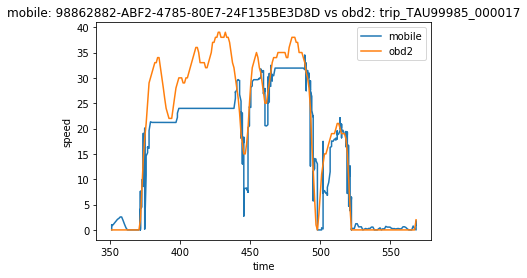

1496346170.9989 351.015
1496348272 568.337


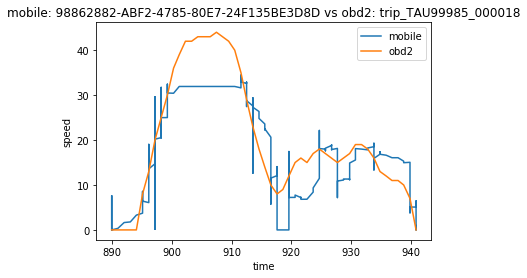

1496346170.9989 889.962
1496348272 940.843


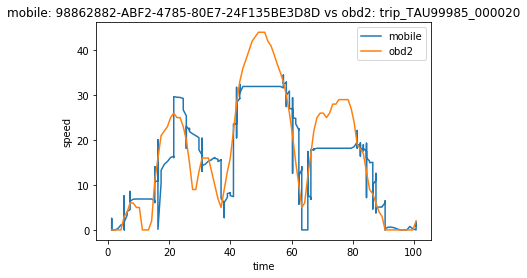

1496346170.9989 1.206
1496348272 100.716


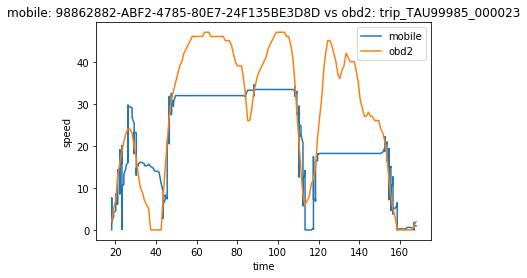

1496346170.9989 18.296
1496348272 167.944


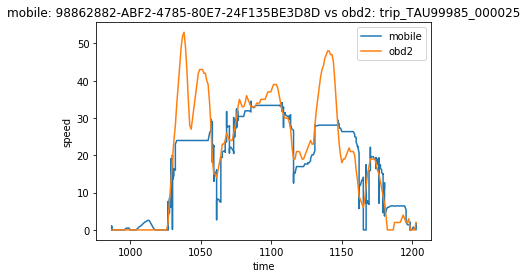

1496346170.9989 986.876
1496348272 1202.566


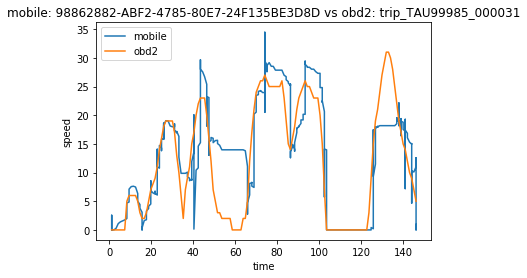

1496346170.9989 1.248
1496348272 146.039


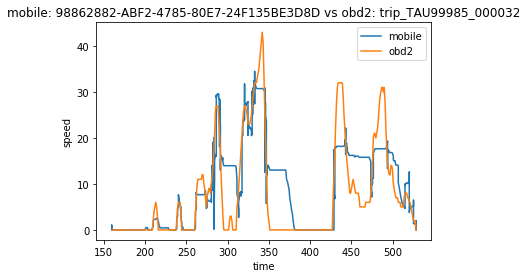

1496346170.9989 159.433
1496348272 528.492


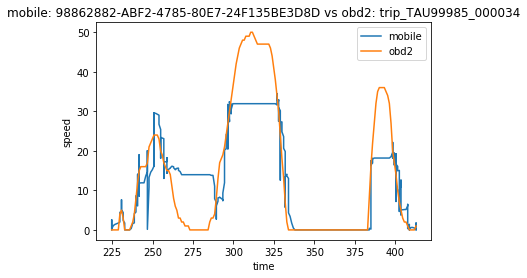

1496346170.9989 224.779
1496348272 412.853


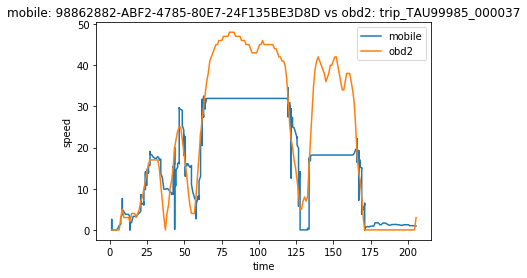

1496346170.9989 1.246
1496348272 205.403


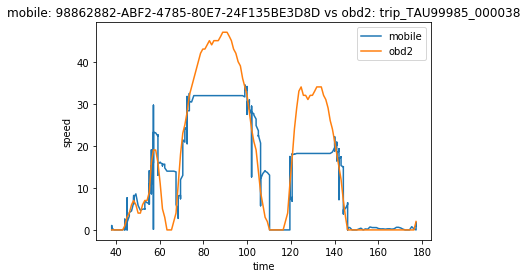

1496346170.9989 38.078
1496348272 177.306


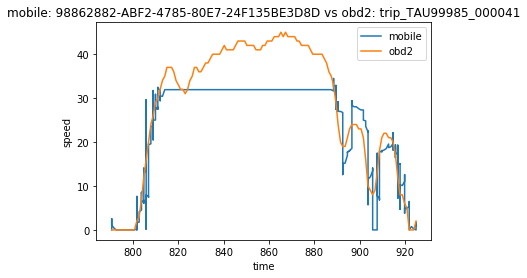

1496346170.9989 790.546
1496348272 924.985


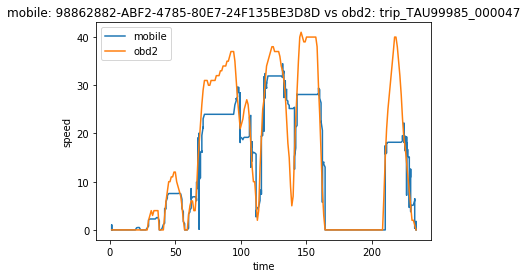

1496346170.9989 1.309
1496348272 233.684


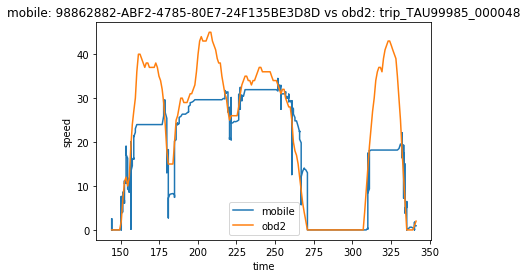

1496346170.9989 144.305
1496348272 341.131


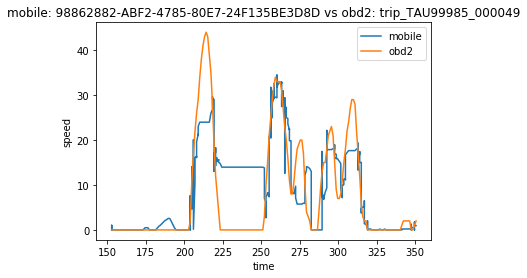

1496346170.9989 152.766
1496348272 350.651


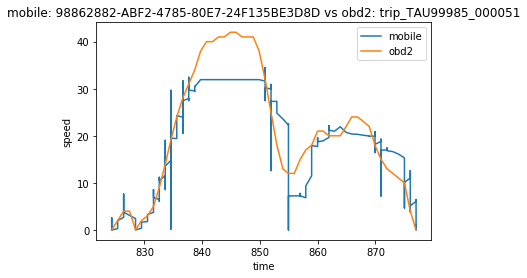

1496346170.9989 824.323
1496348272 877.032


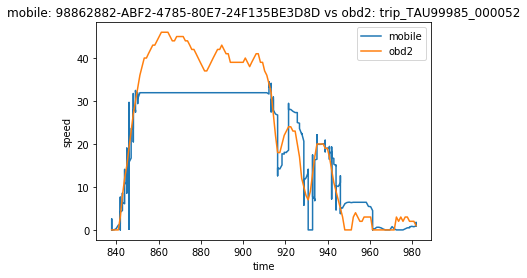

1496346170.9989 837.879
1496348272 981.73


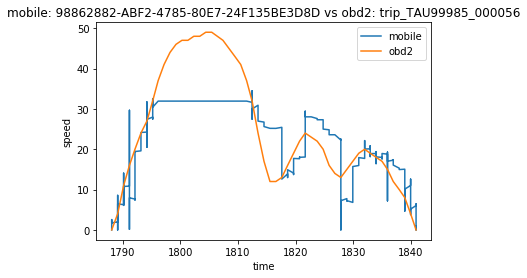

1496346170.9989 1788.075
1496348272 1840.902


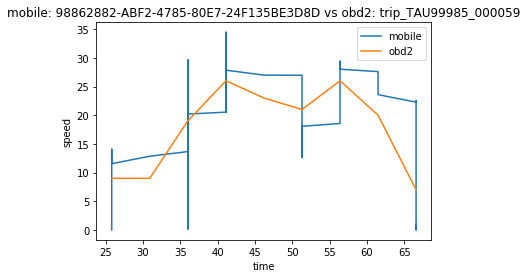

1496346170.9989 25.798
1496348272 66.559


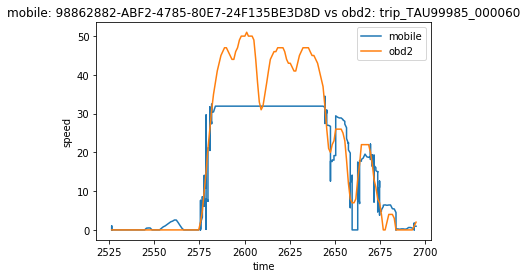

1496346170.9989 2526.417
1496348272 2694.927


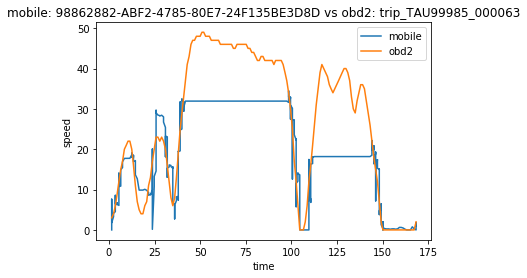

1496346170.9989 1.465
1496348272 168.311


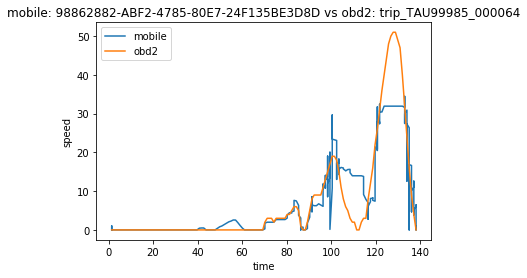

1496346170.9989 1.422
1496348272 138.191


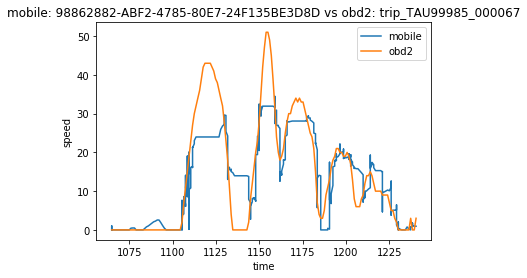

1496346170.9989 1064.831
1496348272 1240.405


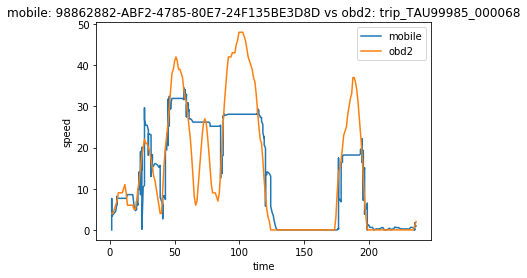

1496346170.9989 1.432
1496348272 236.38


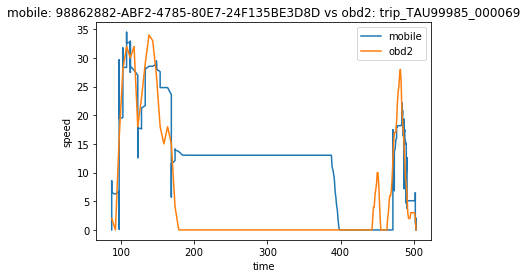

1496346170.9989 87.059
1496348272 503.208


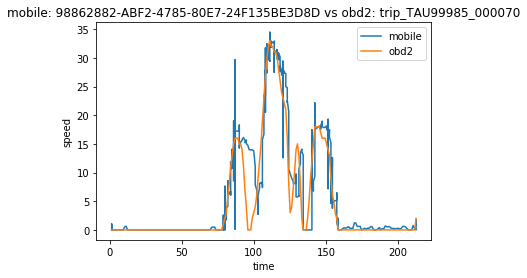

1496346170.9989 1.434
1496348272 212.455


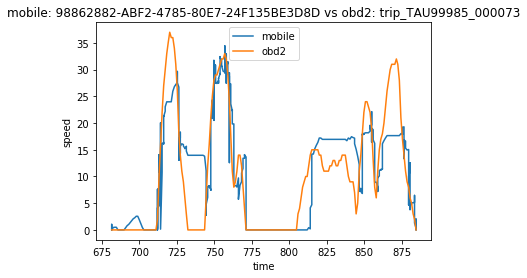

1496346170.9989 681.517
1496348272 884.52


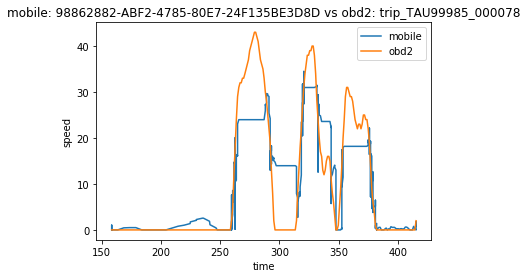

1496346170.9989 158.367
1496348272 415.444


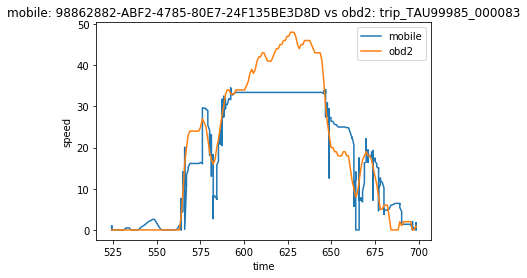

1496346170.9989 524.143
1496348272 698.582


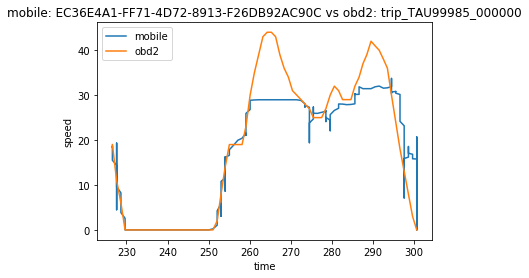

1496356576.0001 226.583
1496357250.0001 300.682


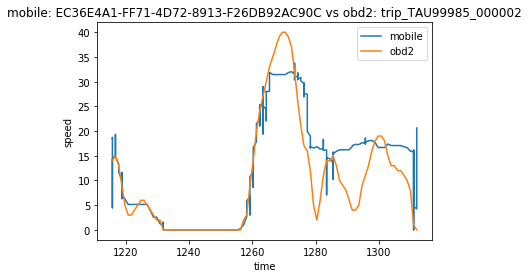

1496356576.0001 1215.771
1496357250.0001 1311.954


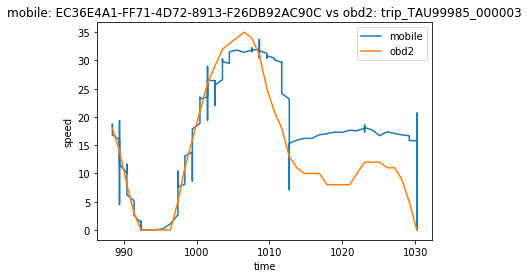

1496356576.0001 988.464
1496357250.0001 1030.204


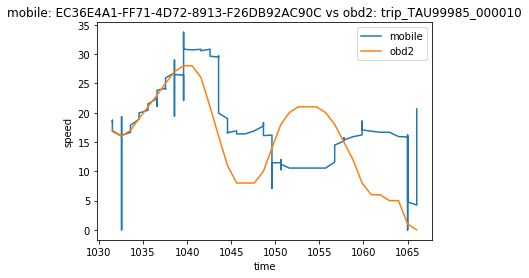

1496356576.0001 1031.517
1496357250.0001 1066.049


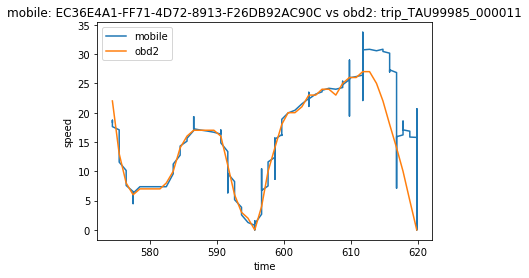

1496356576.0001 574.358
1496357250.0001 619.859


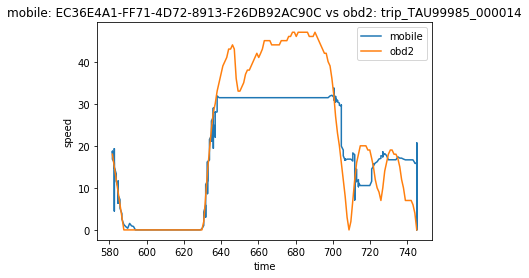

1496356576.0001 581.625
1496357250.0001 744.992


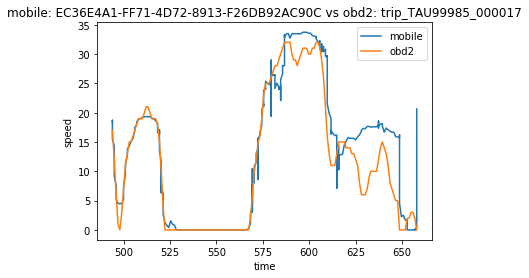

1496356576.0001 493.869
1496357250.0001 658.035


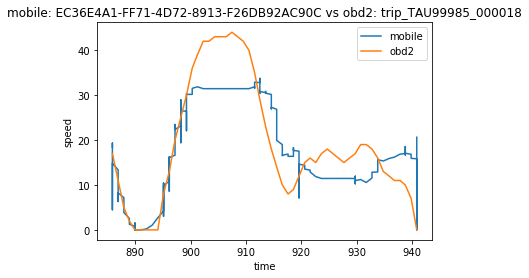

1496356576.0001 885.887
1496357250.0001 940.843


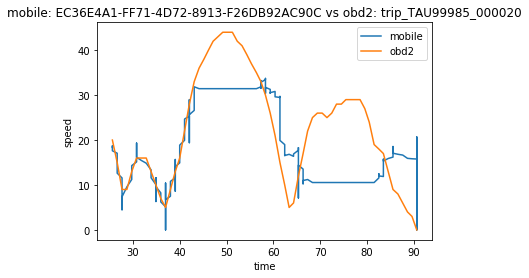

1496356576.0001 25.601
1496357250.0001 90.598


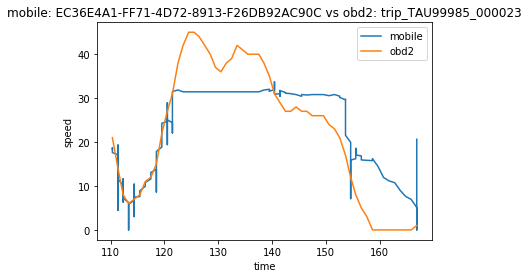

1496356576.0001 110.341
1496357250.0001 166.908


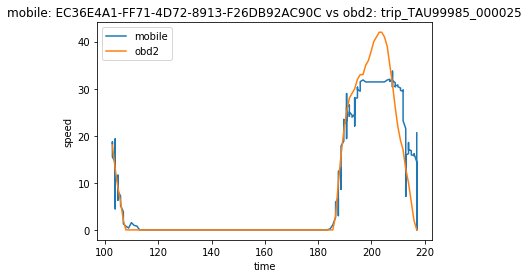

1496356576.0001 102.812
1496357250.0001 217.008


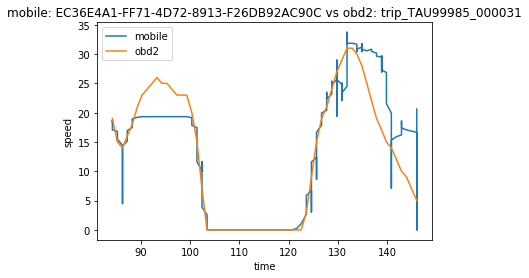

1496356576.0001 84.232
1496357250.0001 146.039


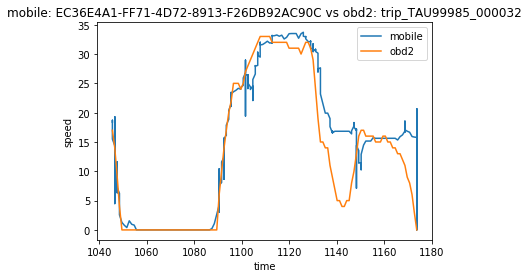

1496356576.0001 1045.456
1496357250.0001 1173.721


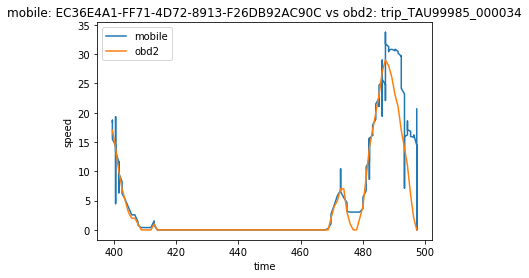

1496356576.0001 399.41
1496357250.0001 497.39


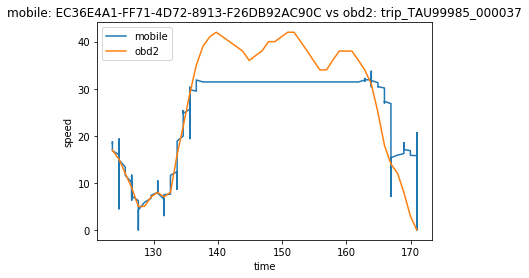

1496356576.0001 123.575
1496357250.0001 170.953


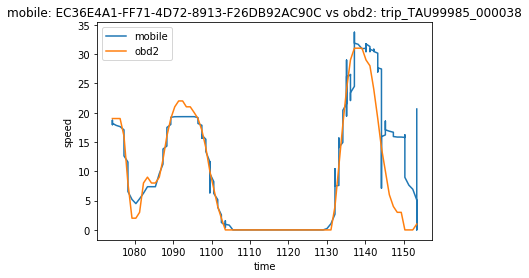

1496356576.0001 1074.188
1496357250.0001 1153.4


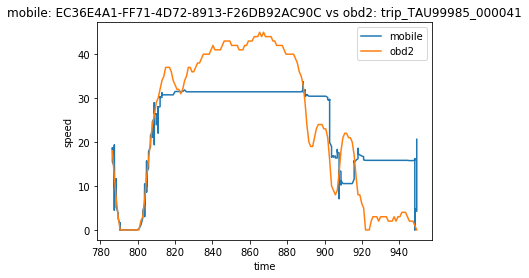

1496356576.0001 786.416
1496357250.0001 949.386


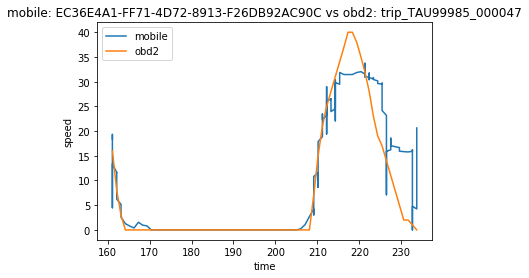

1496356576.0001 161.137
1496357250.0001 233.684


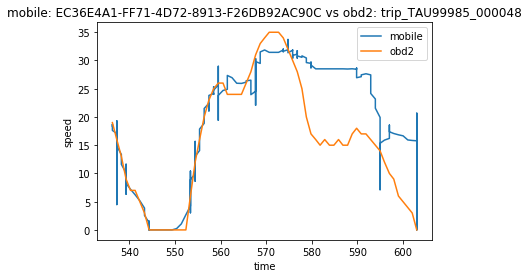

1496356576.0001 536.256
1496357250.0001 603.023


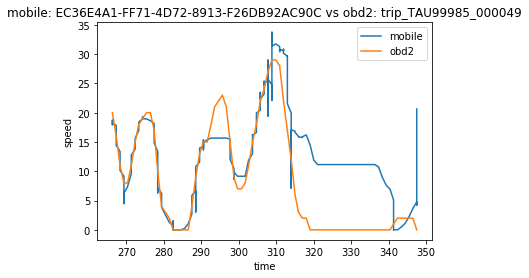

1496356576.0001 266.265
1496357250.0001 347.542


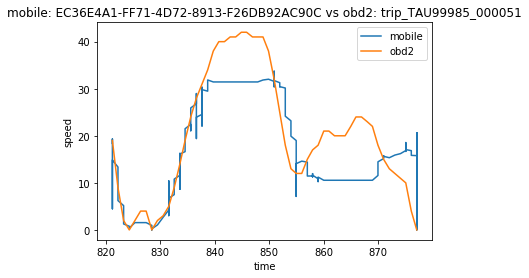

1496356576.0001 821.227
1496357250.0001 877.032


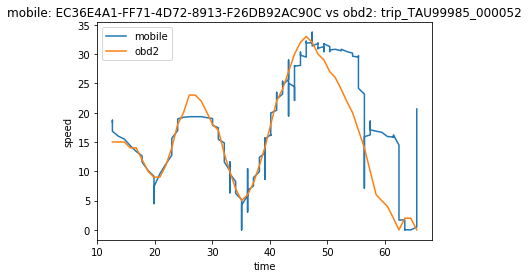

1496356576.0001 12.61
1496357250.0001 65.58


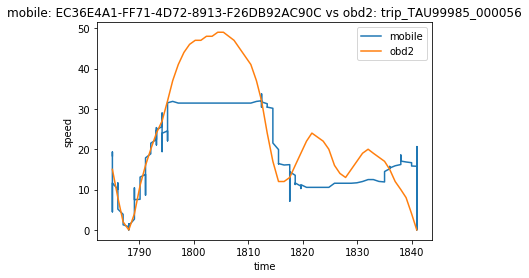

1496356576.0001 1785.073
1496357250.0001 1840.902


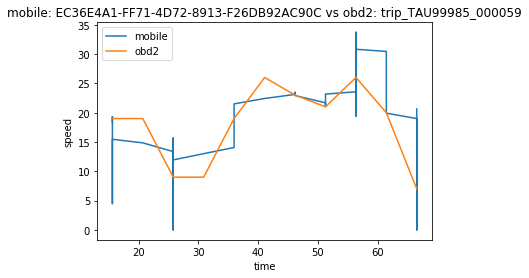

1496356576.0001 15.613
1496357250.0001 66.559


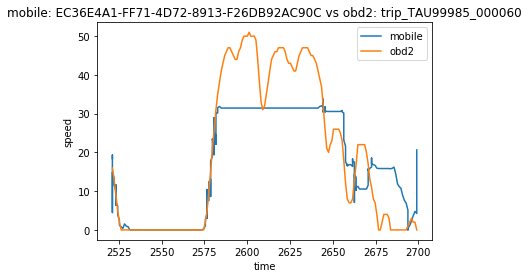

1496356576.0001 2521.292
1496357250.0001 2699.057


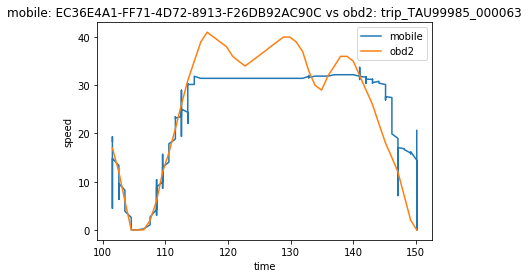

1496356576.0001 101.541
1496357250.0001 150.144


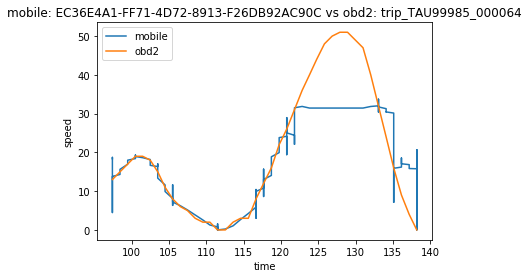

1496356576.0001 97.439
1496357250.0001 138.191


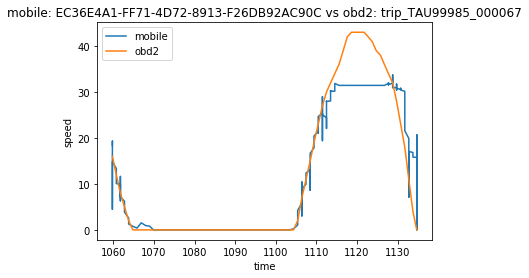

1496356576.0001 1059.787
1496357250.0001 1134.684


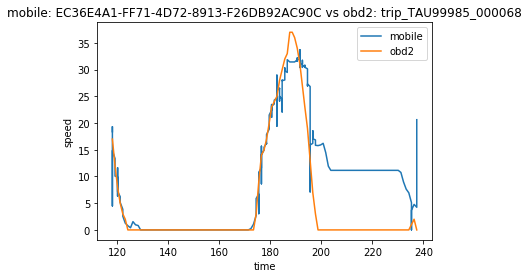

1496356576.0001 118.112
1496357250.0001 237.42


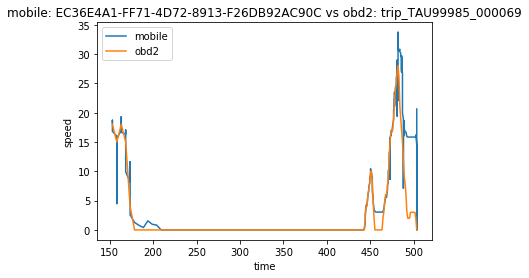

1496356576.0001 153.284
1496357250.0001 503.208


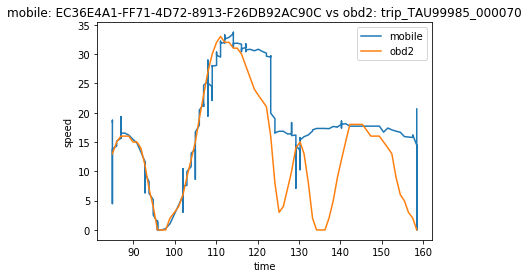

1496356576.0001 84.934
1496357250.0001 158.422


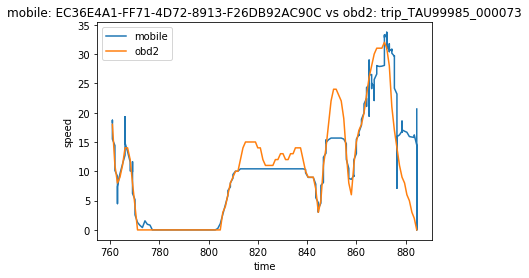

1496356576.0001 760.92
1496357250.0001 884.52


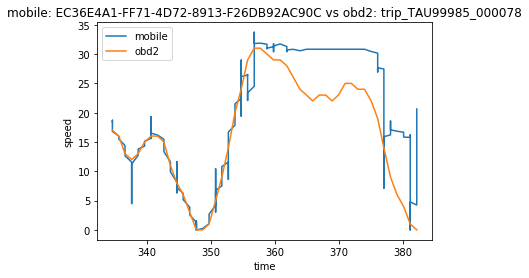

1496356576.0001 334.678
1496357250.0001 382.116


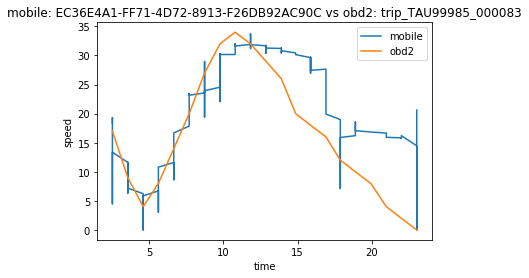

1496356576.0001 2.531
1496357250.0001 23.02


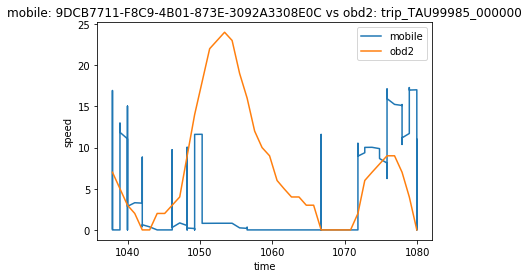

1496407198 1037.924
1496408259 1079.914


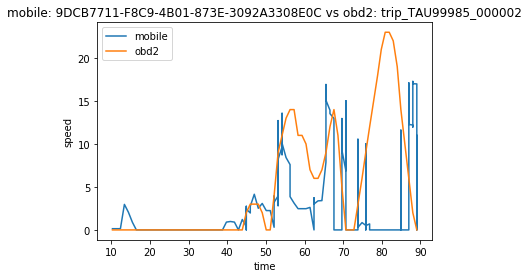

1496407198 10.249
1496408259 89.086


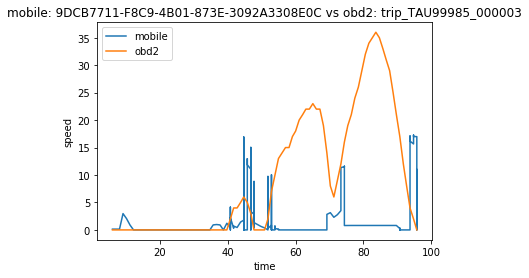

1496407198 6.106
1496408259 95.715


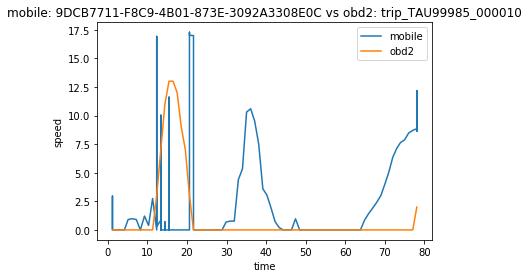

1496407198 1.144
1496408259 78.062


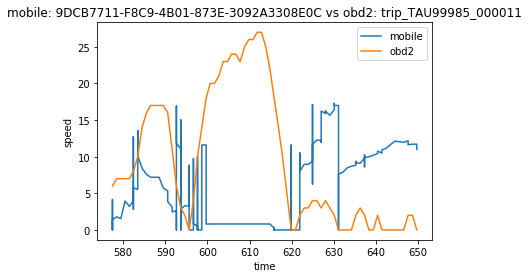

1496407198 577.454
1496408259 649.657


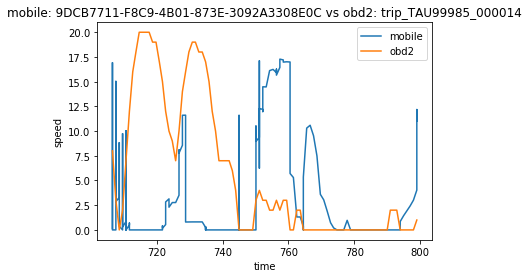

1496407198 706.559
1496408259 798.967


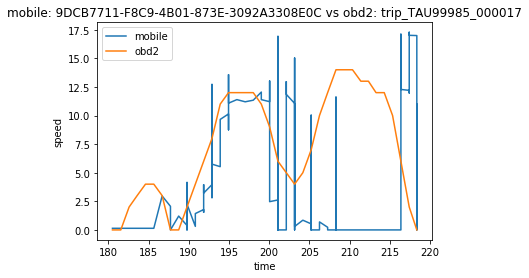

1496407198 180.495
1496408259 218.367


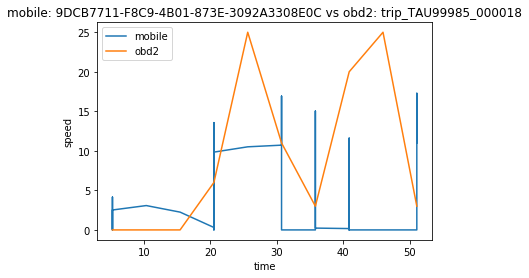

1496407198 5.261
1496408259 51.093


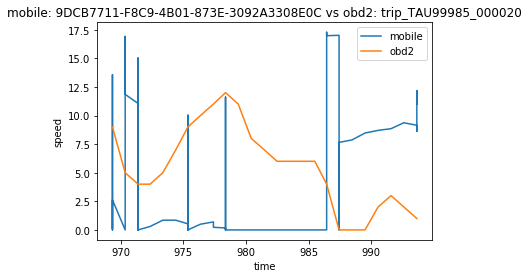

1496407198 969.351
1496408259 993.637


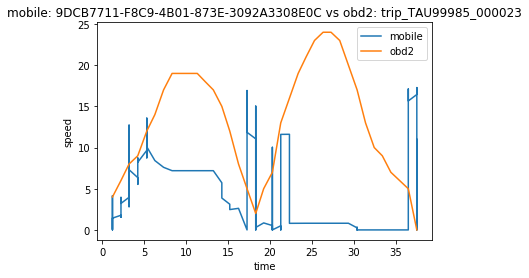

1496407198 1.226
1496408259 37.487


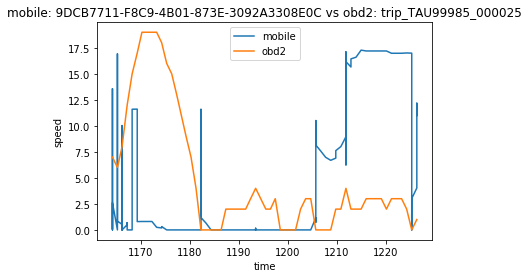

1496407198 1164.17
1496408259 1226.29


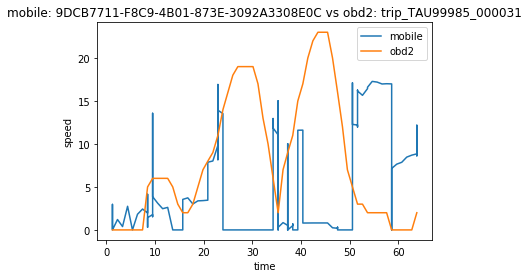

1496407198 1.248
1496408259 63.772


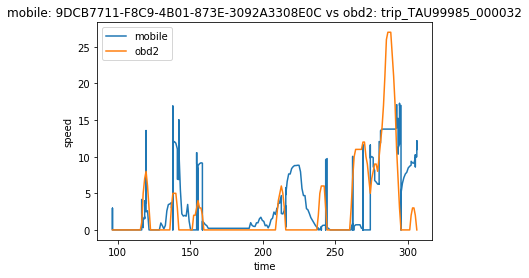

1496407198 96.442
1496408259 306.204


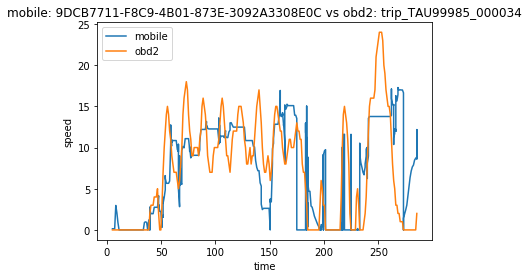

1496407198 5.205
1496408259 285.36


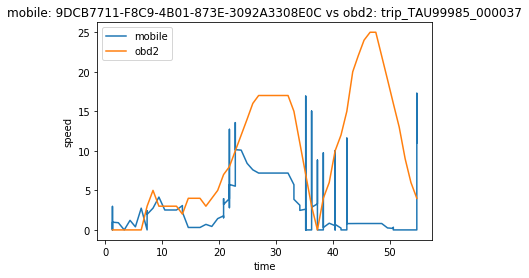

1496407198 1.246
1496408259 54.741


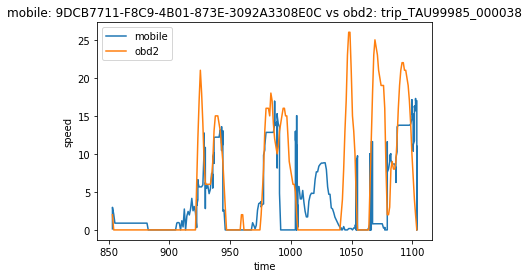

1496407198 853.217
1496408259 1103.586


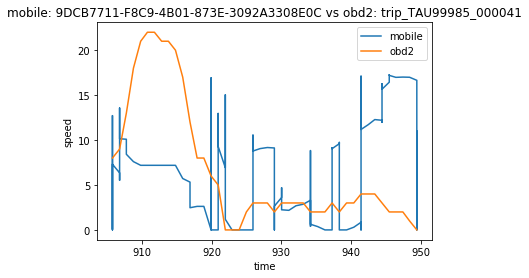

1496407198 905.81
1496408259 949.386


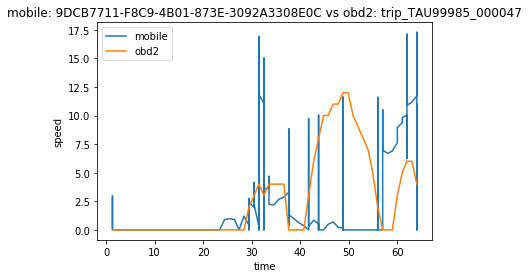

1496407198 1.309
1496408259 64.036


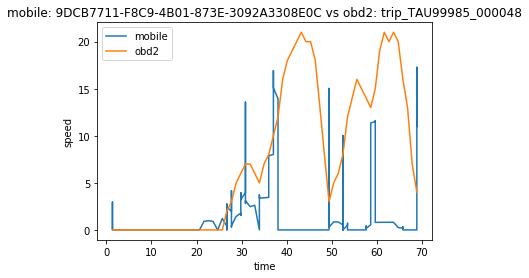

1496407198 1.333
1496408259 68.927


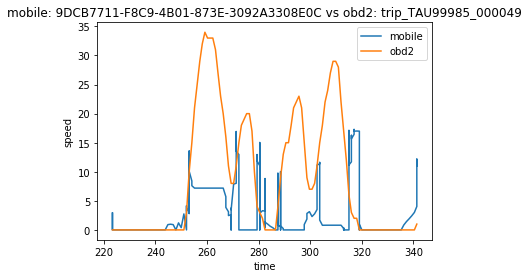

1496407198 223.319
1496408259 341.351


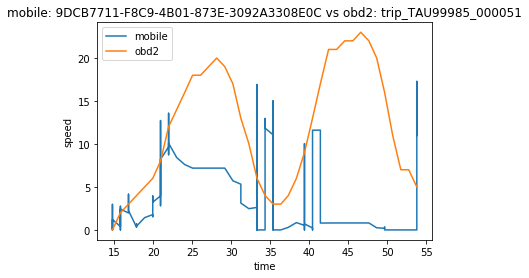

1496407198 14.755
1496408259 53.806


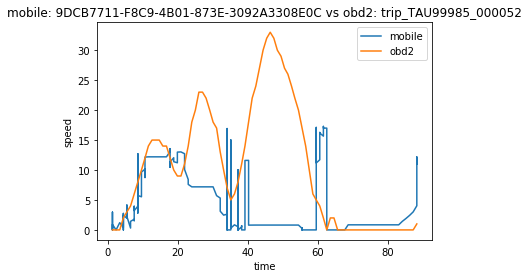

1496407198 1.33
1496408259 88.178


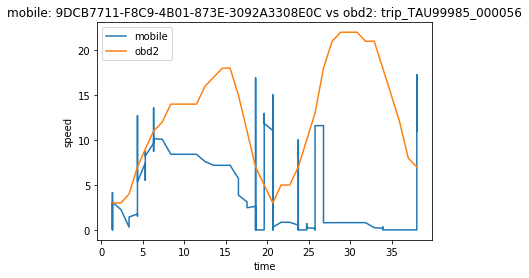

1496407198 1.332
1496408259 38.054


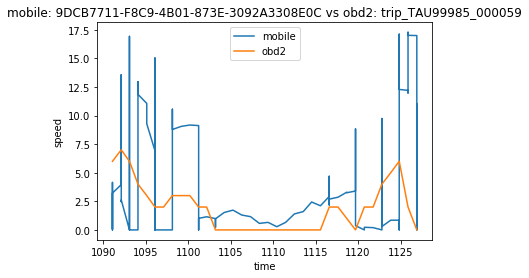

1496407198 1091.072
1496408259 1126.917


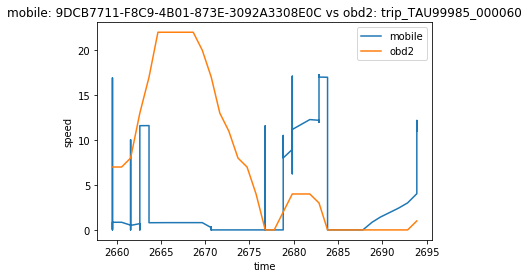

1496407198 2659.533
1496408259 2693.89


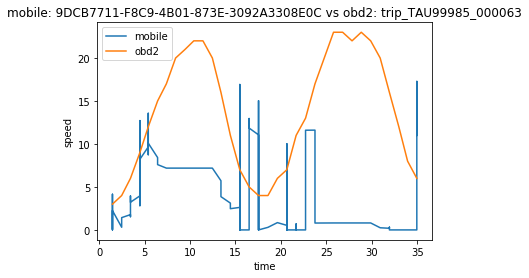

1496407198 1.465
1496408259 34.953


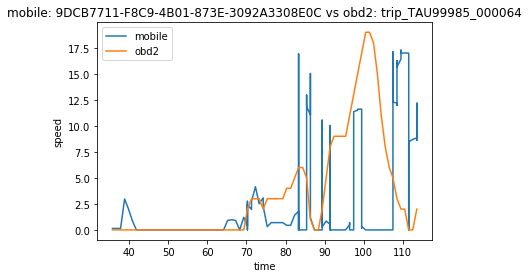

1496407198 35.711
1496408259 113.599


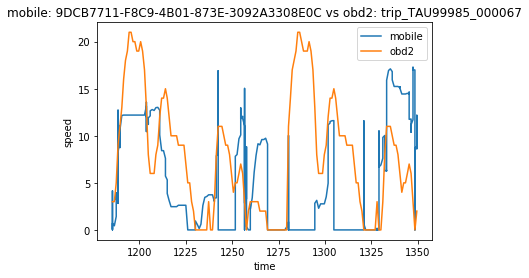

1496407198 1185.415
1496408259 1349.594


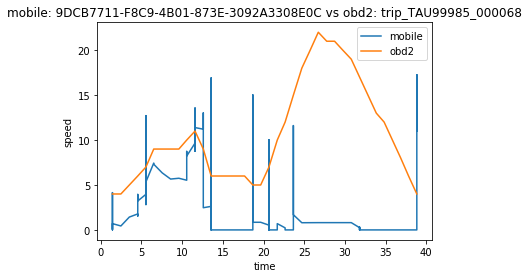

1496407198 1.432
1496408259 38.845


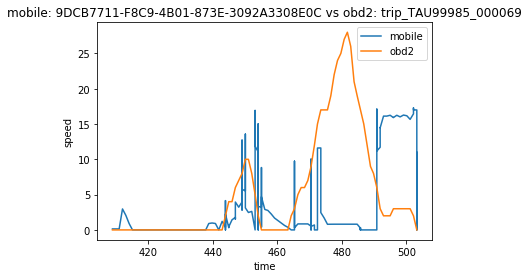

1496407198 408.988
1496408259 503.208


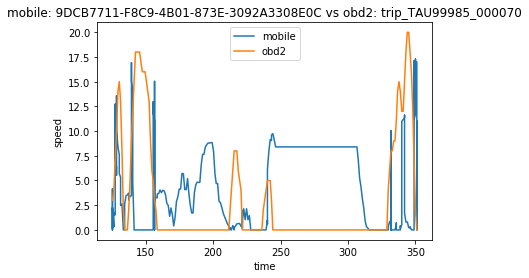

1496407198 125.178
1496408259 351.1


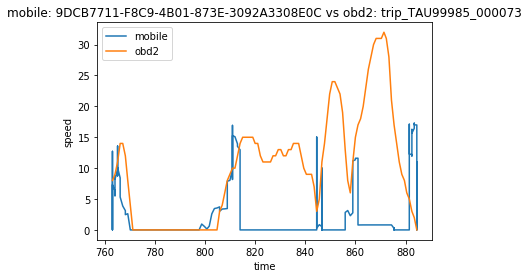

1496407198 762.979
1496408259 884.52


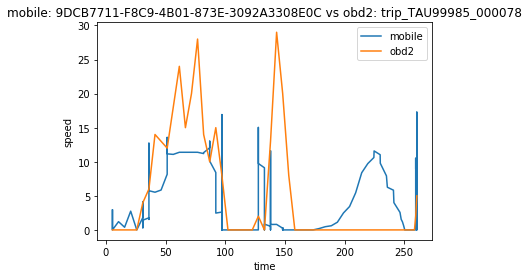

1496407198 5.549
1496408259 260.572


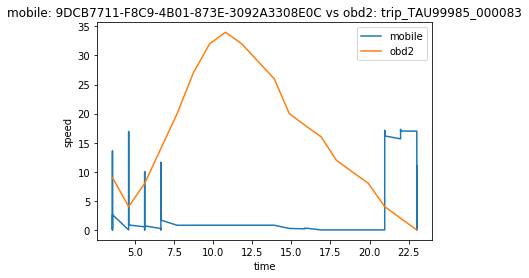

1496407198 3.568
1496408259 23.02


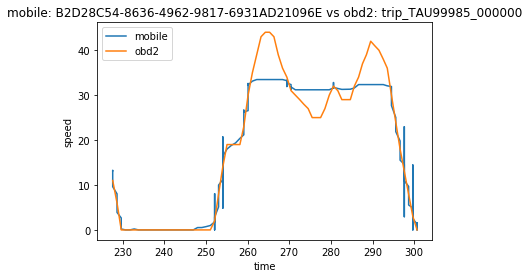

1496427148.9999 227.62
1496428057 300.682


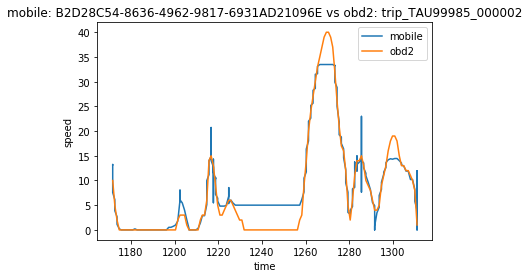

1496427148.9999 1171.707
1496428057 1310.964


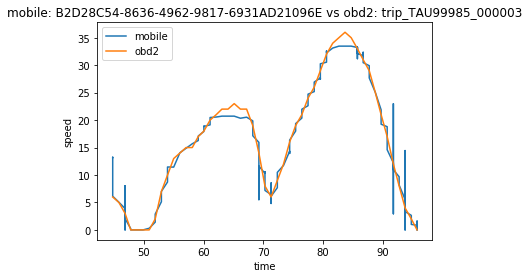

1496427148.9999 44.77
1496428057 95.715


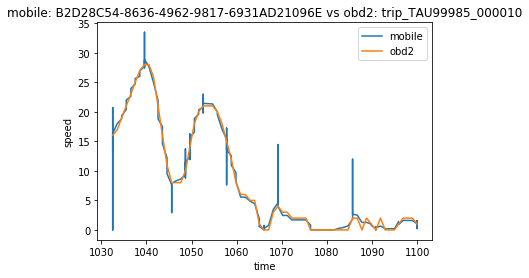

1496427148.9999 1032.56
1496428057 1099.923


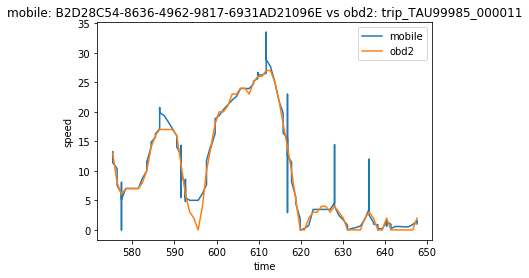

1496427148.9999 575.373
1496428057 647.585


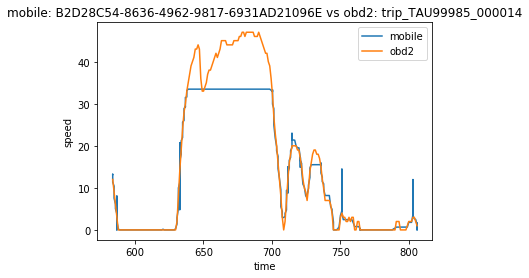

1496427148.9999 583.699
1496428057 806.094


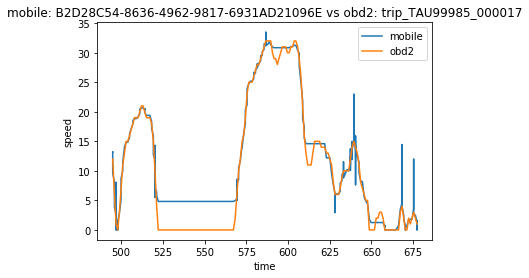

1496427148.9999 494.884
1496428057 677.395


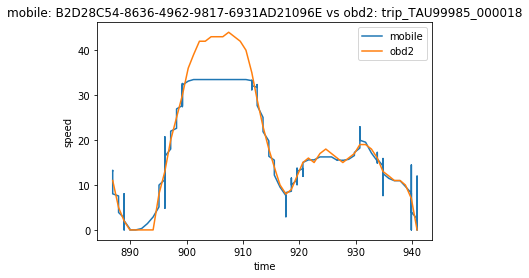

1496427148.9999 886.924
1496428057 940.843


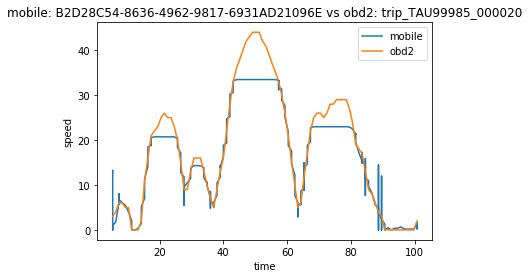

1496427148.9999 5.298
1496428057 100.716


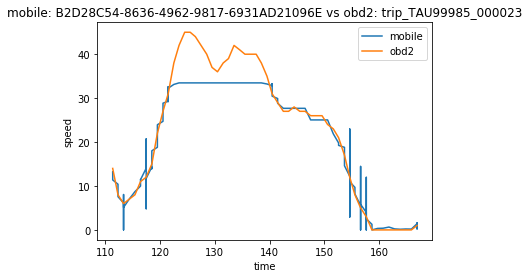

1496427148.9999 111.378
1496428057 166.908


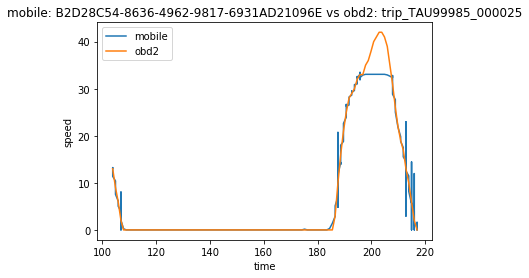

1496427148.9999 103.848
1496428057 217.008


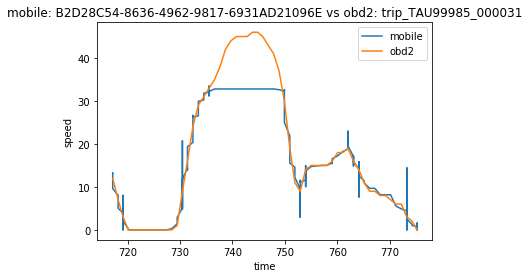

1496427148.9999 717.171
1496428057 775.187


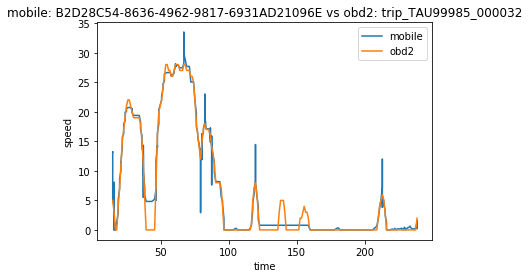

1496427148.9999 14.69
1496428057 238.328


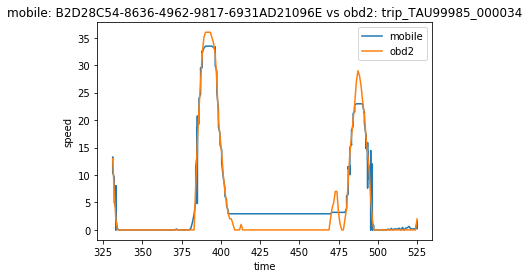

1496427148.9999 331.023
1496428057 524.96


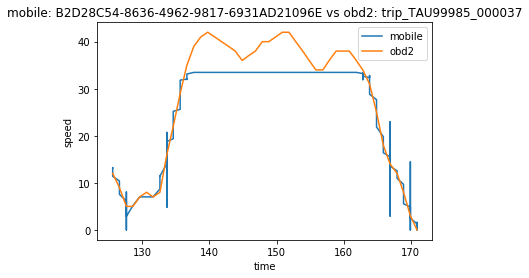

1496427148.9999 125.576
1496428057 170.953


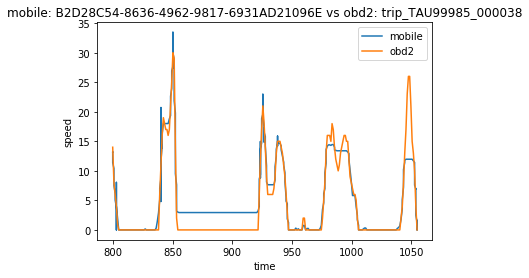

1496427148.9999 799.666
1496428057 1054.789


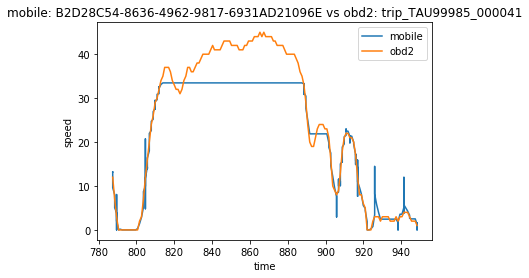

1496427148.9999 787.453
1496428057 948.35


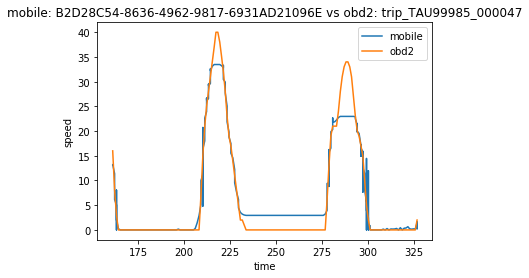

1496427148.9999 161.137
1496428057 326.687


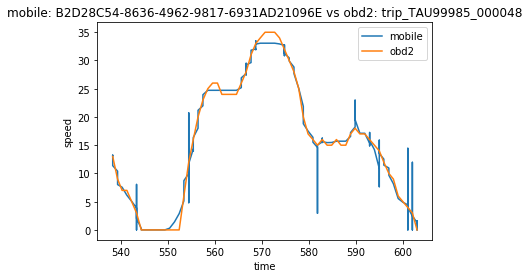

1496427148.9999 538.224
1496428057 603.023


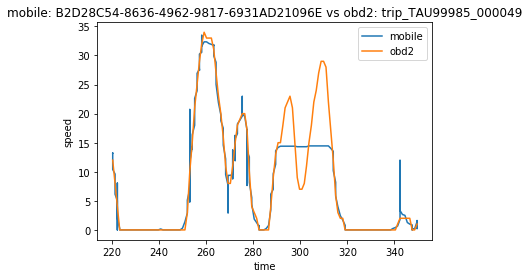

1496427148.9999 220.338
1496428057 349.615


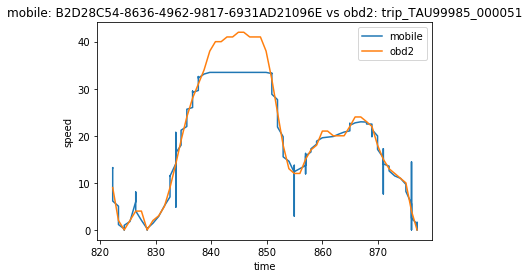

1496427148.9999 822.249
1496428057 877.032


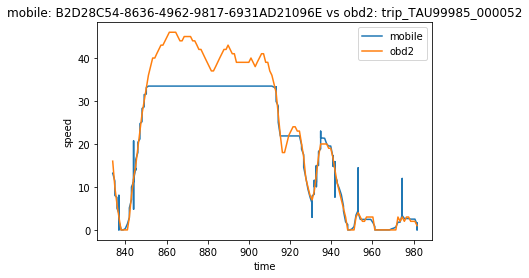

1496427148.9999 833.84
1496428057 981.73


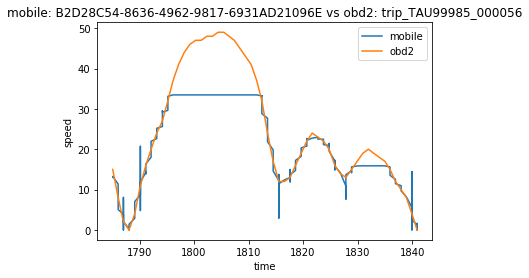

1496427148.9999 1785.073
1496428057 1840.902


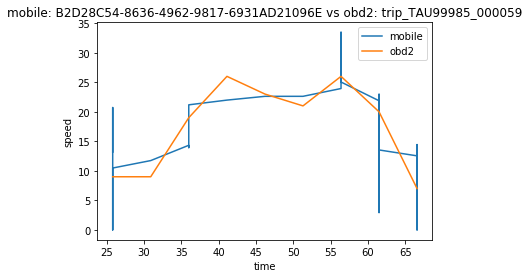

1496427148.9999 25.798
1496428057 66.559


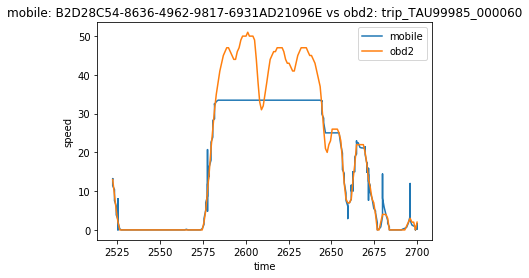

1496427148.9999 2522.307
1496428057 2700.001


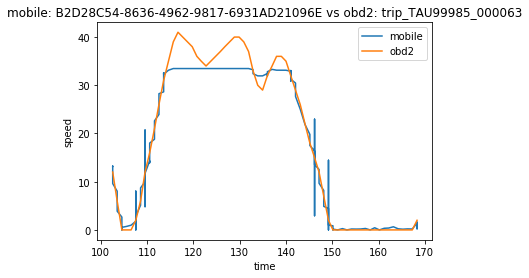

1496427148.9999 102.577
1496428057 168.311


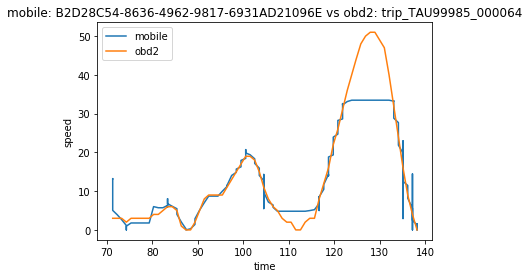

1496427148.9999 71.29
1496428057 138.191


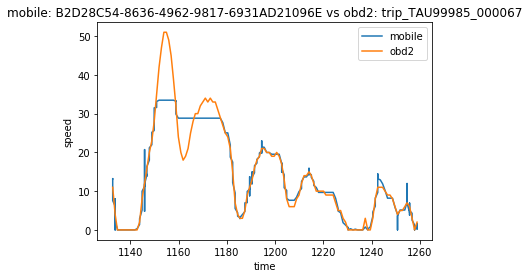

1496427148.9999 1132.725
1496428057 1258.743


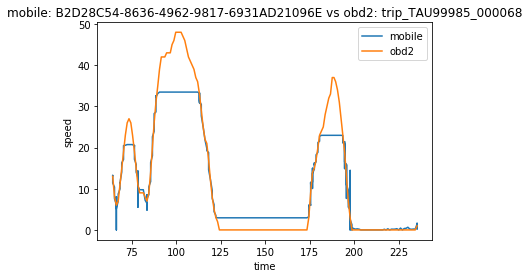

1496427148.9999 64.174
1496428057 235.344


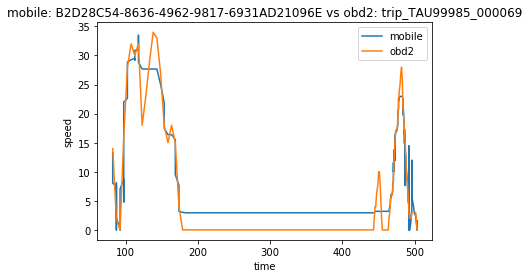

1496427148.9999 81.965
1496428057 503.208


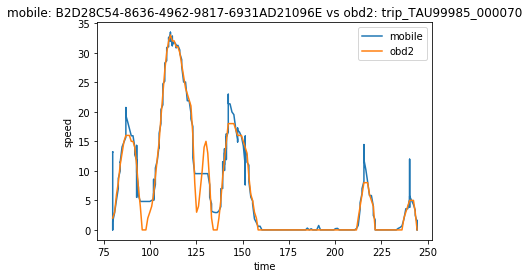

1496427148.9999 79.881
1496428057 244.231


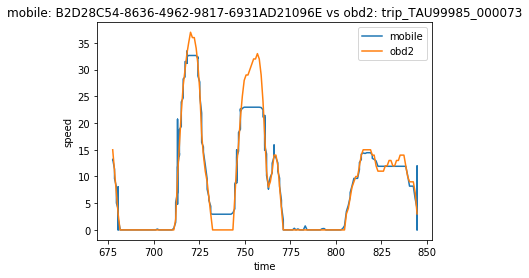

1496427148.9999 677.498
1496428057 844.546


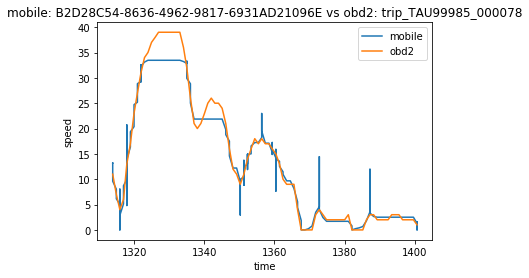

1496427148.9999 1313.878
1496428057 1400.657


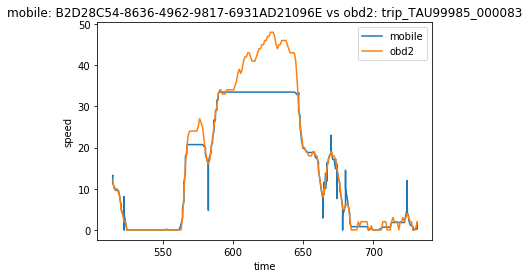

1496427148.9999 514.106
1496428057 731.218


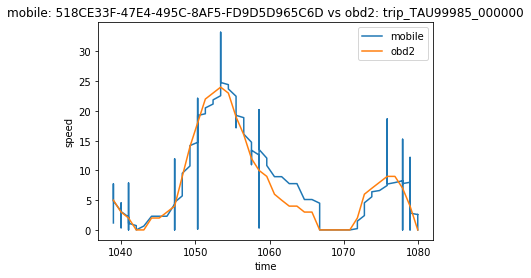

1496432612.0006 1038.96
1496434552.0003 1079.914


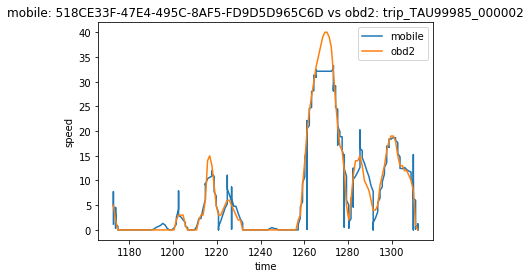

1496432612.0006 1172.672
1496434552.0003 1311.954


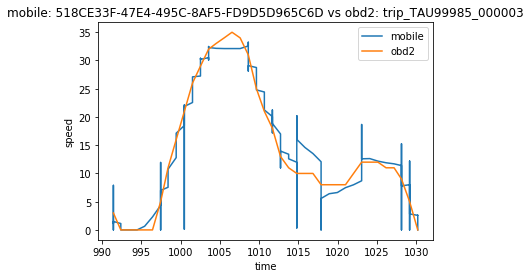

1496432612.0006 991.433
1496434552.0003 1030.204


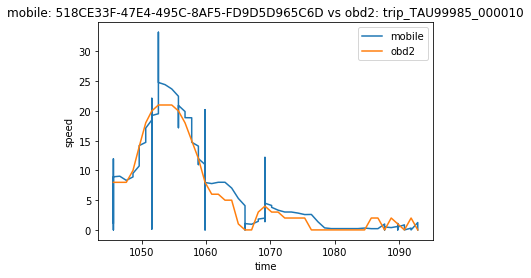

1496432612.0006 1045.615
1496434552.0003 1092.866


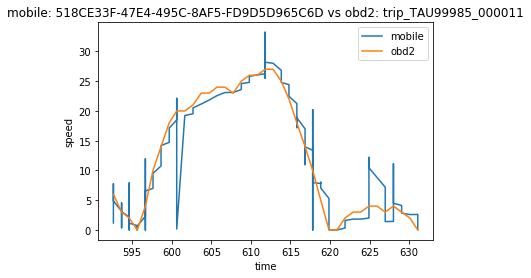

1496432612.0006 592.625
1496434552.0003 631.079


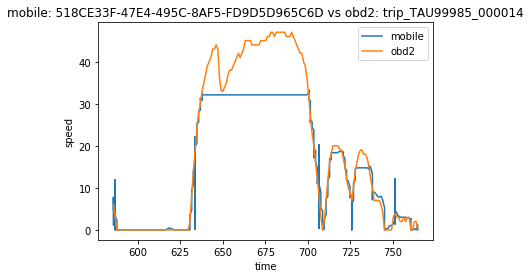

1496432612.0006 585.704
1496434552.0003 764.514


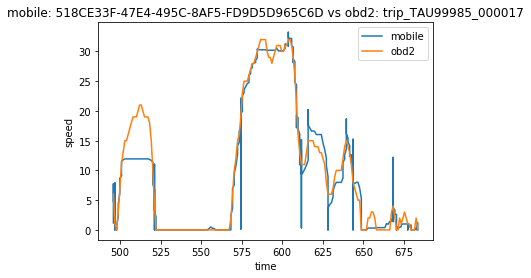

1496432612.0006 495.92
1496434552.0003 683.506


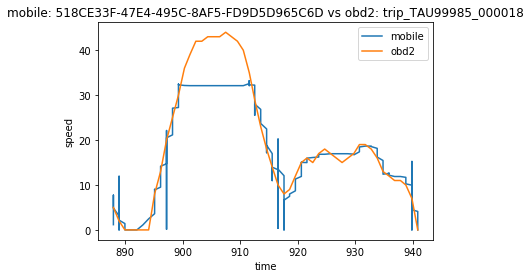

1496432612.0006 887.96
1496434552.0003 940.843


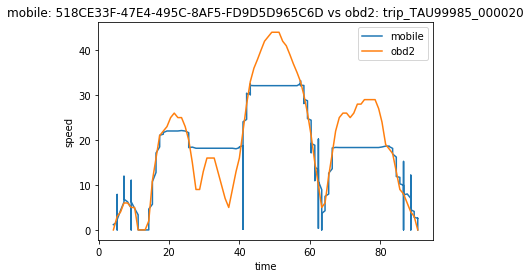

1496432612.0006 4.223
1496434552.0003 90.598


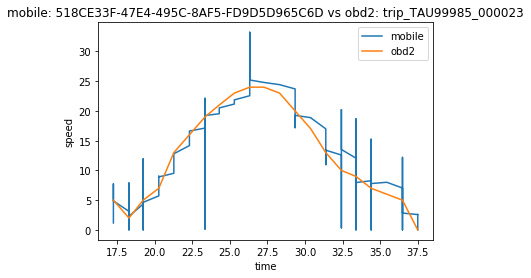

1496432612.0006 17.26
1496434552.0003 37.487


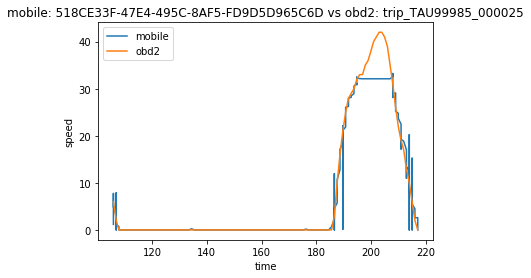

1496432612.0006 105.885
1496434552.0003 217.008


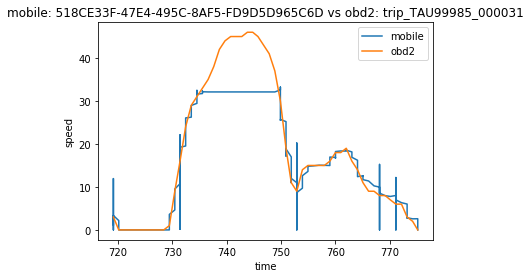

1496432612.0006 719.152
1496434552.0003 775.187


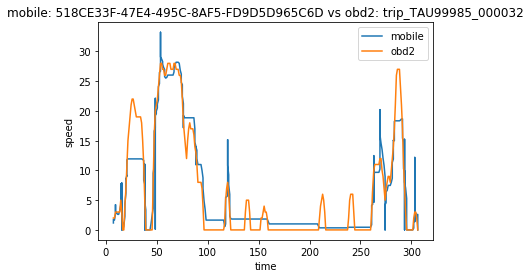

1496432612.0006 7.451
1496434552.0003 306.204


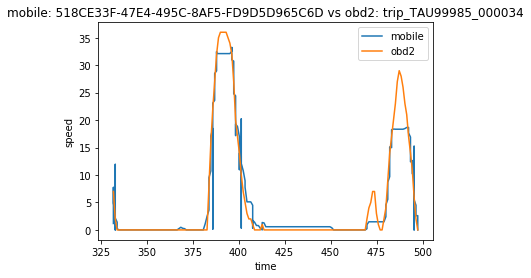

1496432612.0006 331.989
1496434552.0003 497.39


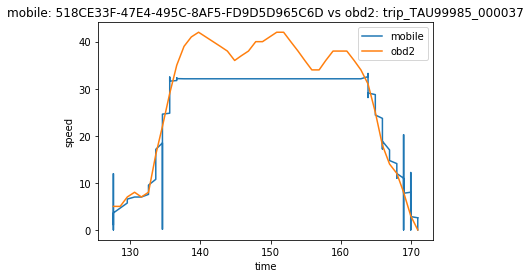

1496432612.0006 127.614
1496434552.0003 170.953


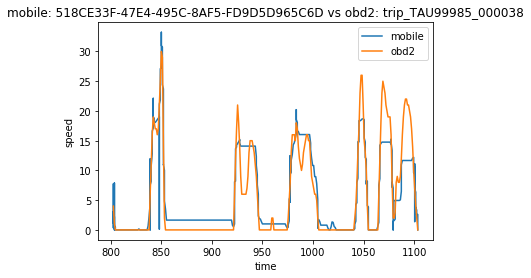

1496432612.0006 802.752
1496434552.0003 1103.586


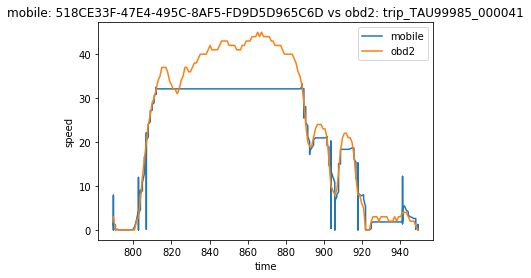

1496432612.0006 789.508
1496434552.0003 949.386


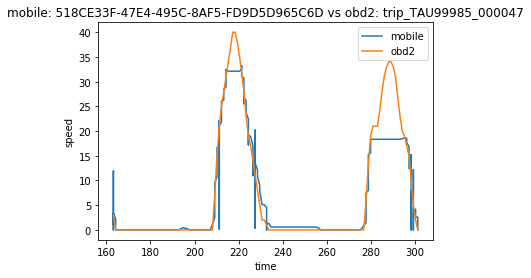

1496432612.0006 163.195
1496434552.0003 301.164


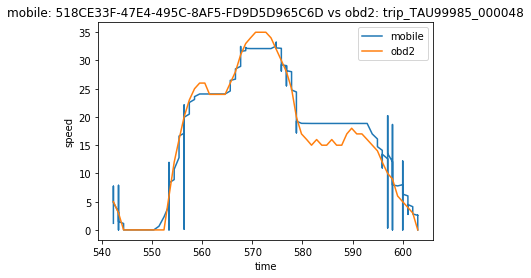

1496432612.0006 542.277
1496434552.0003 603.023


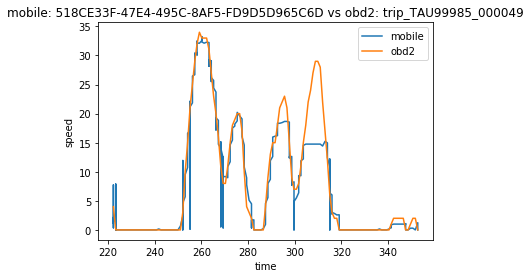

1496432612.0006 222.304
1496434552.0003 352.727


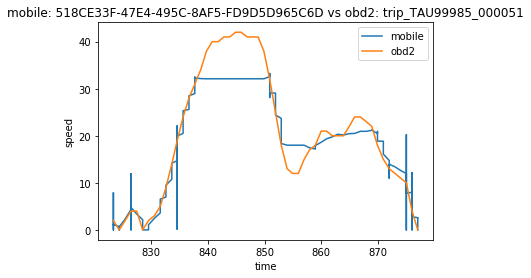

1496432612.0006 823.285
1496434552.0003 877.032


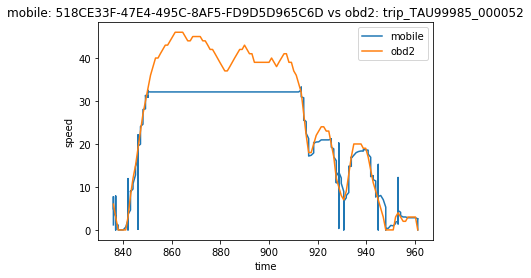

1496432612.0006 835.913
1496434552.0003 961.206


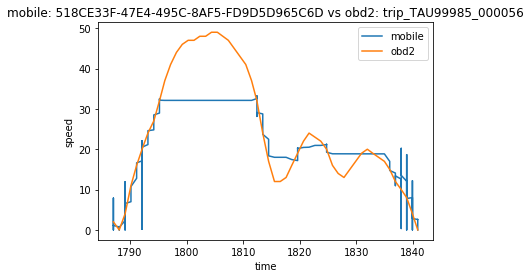

1496432612.0006 1787.039
1496434552.0003 1840.902


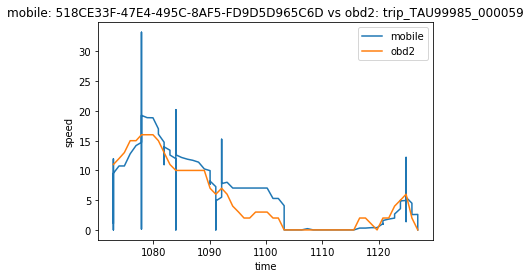

1496432612.0006 1072.894
1496434552.0003 1126.917


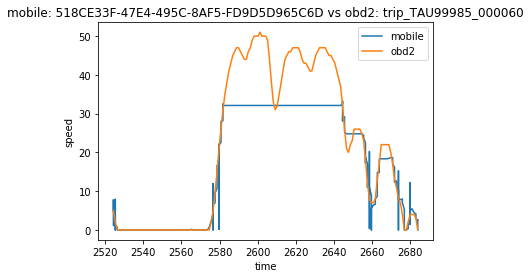

1496432612.0006 2524.379
1496434552.0003 2683.814


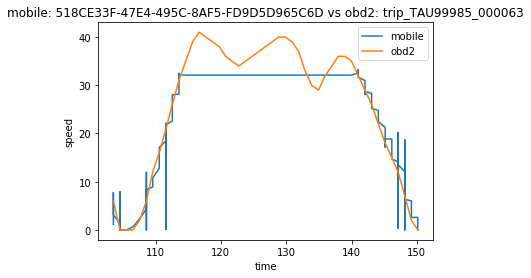

1496432612.0006 103.543
1496434552.0003 150.144


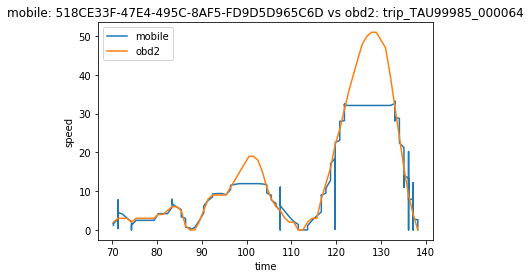

1496432612.0006 70.251
1496434552.0003 138.191


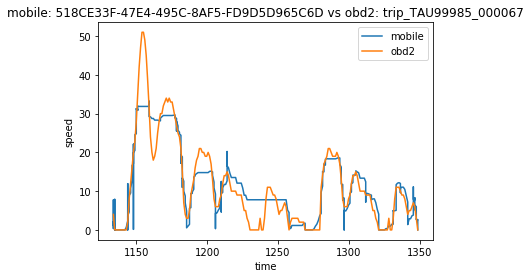

1496432612.0006 1133.74
1496434552.0003 1348.57


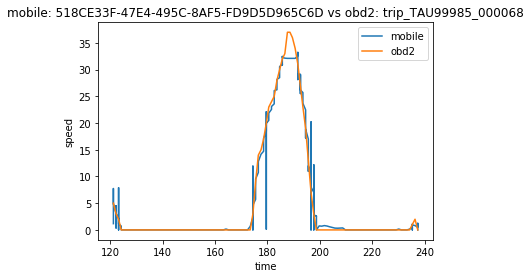

1496432612.0006 121.168
1496434552.0003 237.42


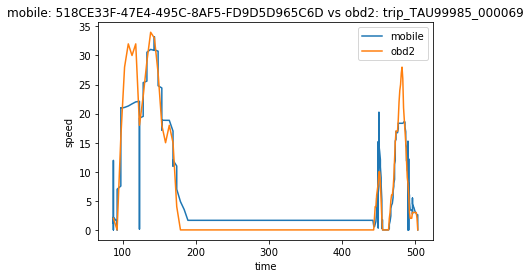

1496432612.0006 87.059
1496434552.0003 503.208


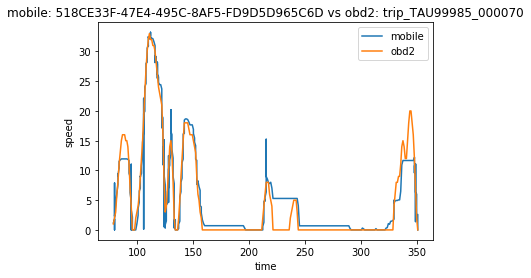

1496432612.0006 78.836
1496434552.0003 351.1


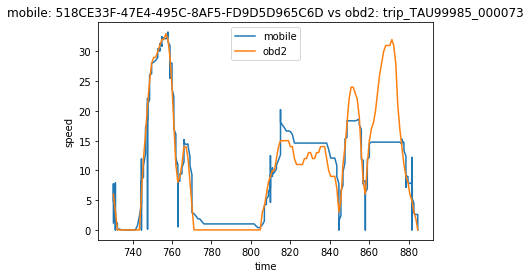

1496432612.0006 730.295
1496434552.0003 884.52


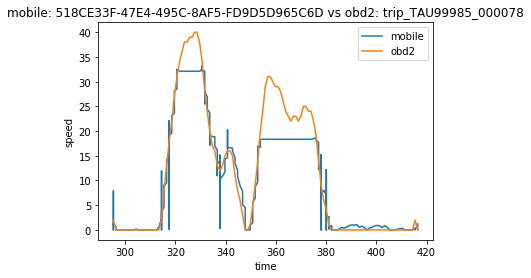

1496432612.0006 295.277
1496434552.0003 416.479


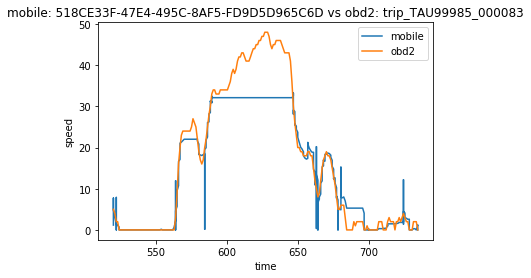

1496432612.0006 520.144
1496434552.0003 734.225


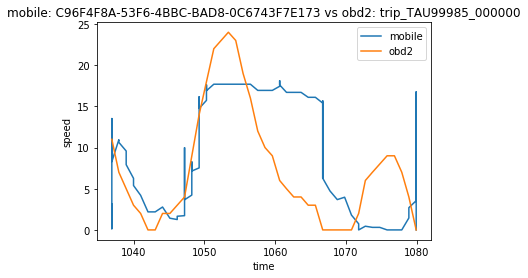

1496747716.0008 1036.933
1496748490 1079.914


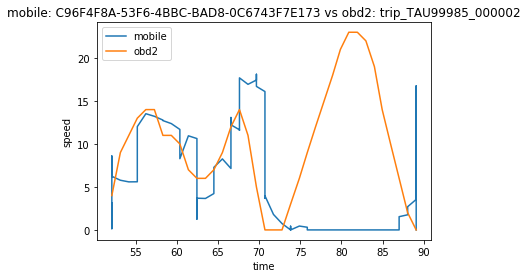

1496747716.0008 52.12
1496748490 89.086


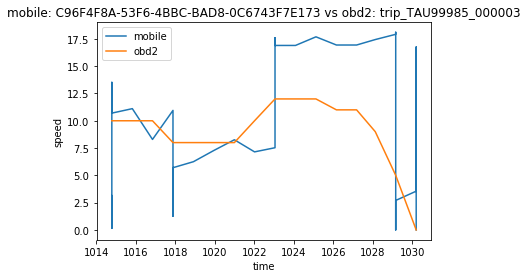

1496747716.0008 1014.794
1496748490 1030.204


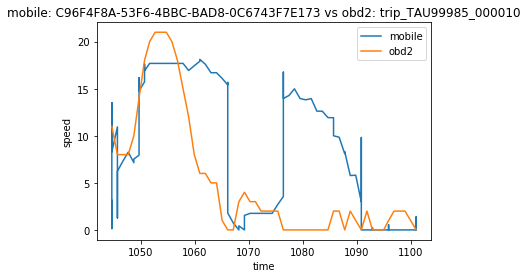

1496747716.0008 1044.579
1496748490 1100.959


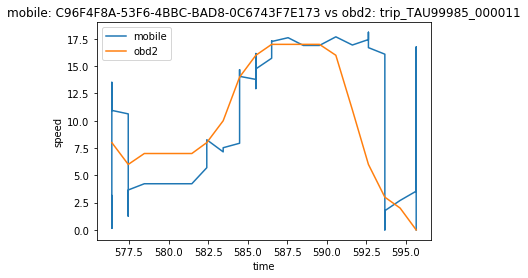

1496747716.0008 576.417
1496748490 595.642


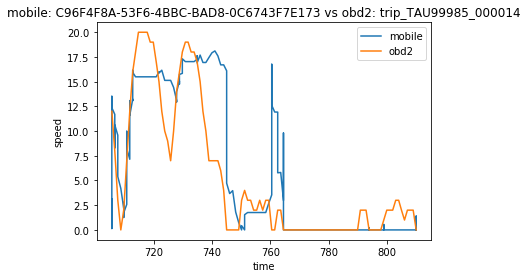

1496747716.0008 705.545
1496748490 810.111


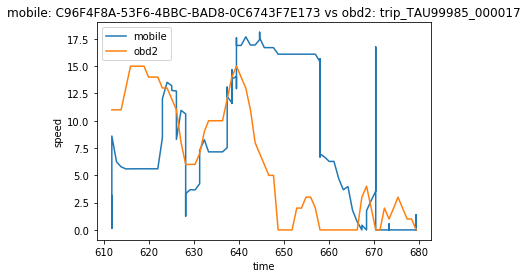

1496747716.0008 611.797
1496748490 679.397


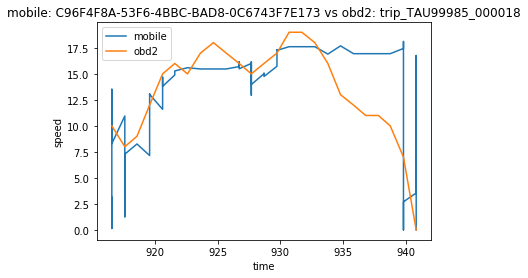

1496747716.0008 916.569
1496748490 940.843


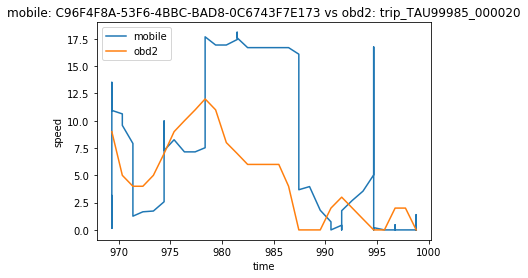

1496747716.0008 969.351
1496748490 998.784


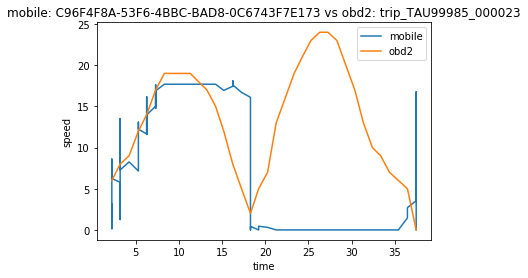

1496747716.0008 2.241
1496748490 37.487


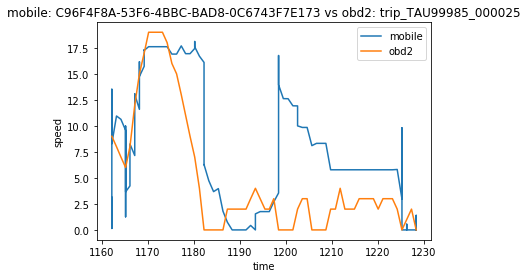

1496747716.0008 1162.191
1496748490 1228.348


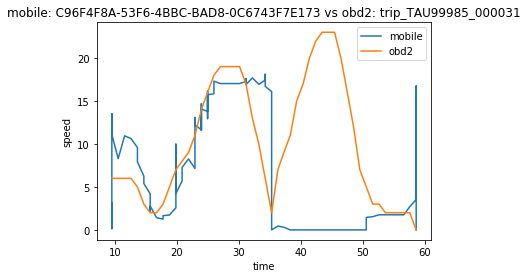

1496747716.0008 9.501
1496748490 58.605


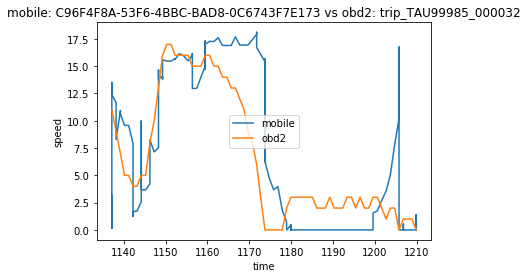

1496747716.0008 1137.161
1496748490 1209.828


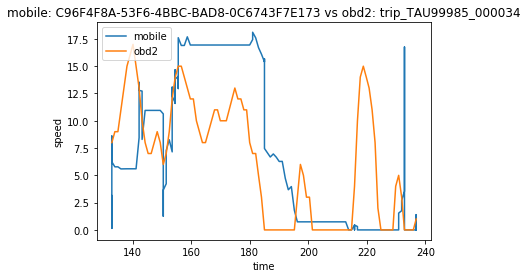

1496747716.0008 132.851
1496748490 236.824


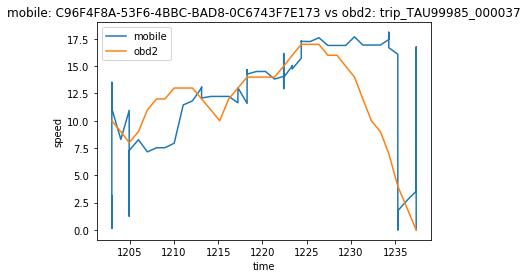

1496747716.0008 1203
1496748490 1237.349


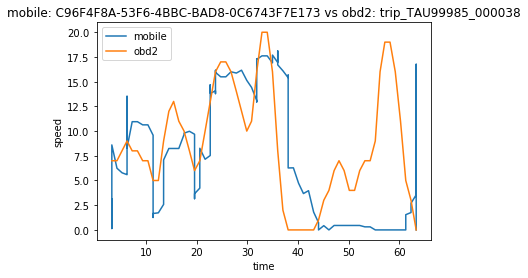

1496747716.0008 3.267
1496748490 63.356


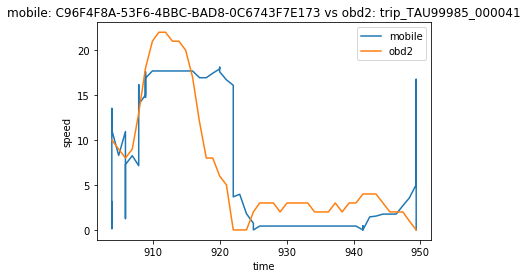

1496747716.0008 903.769
1496748490 949.386


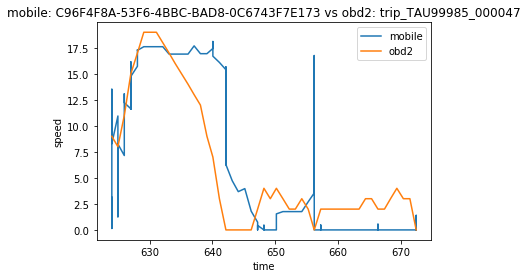

1496747716.0008 624.008
1496748490 672.397


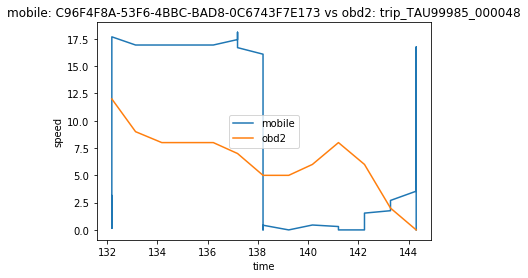

1496747716.0008 132.187
1496748490 144.305


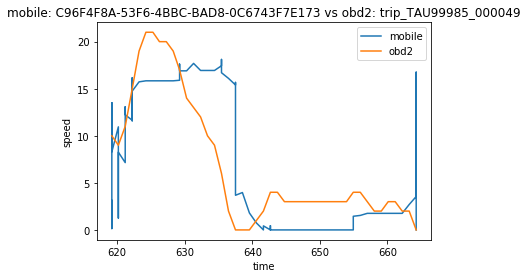

1496747716.0008 619.204
1496748490 664.254


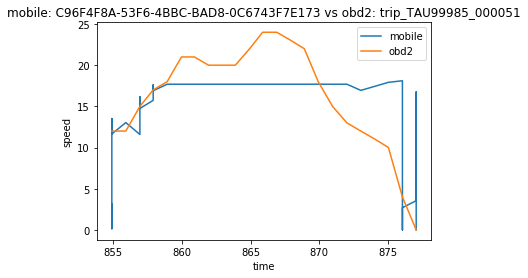

1496747716.0008 854.929
1496748490 877.032


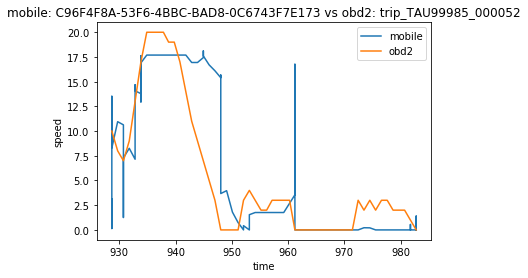

1496747716.0008 928.685
1496748490 982.754


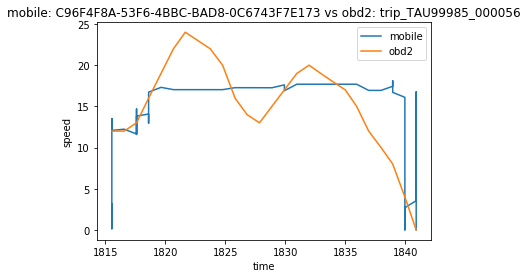

1496747716.0008 1815.544
1496748490 1840.902


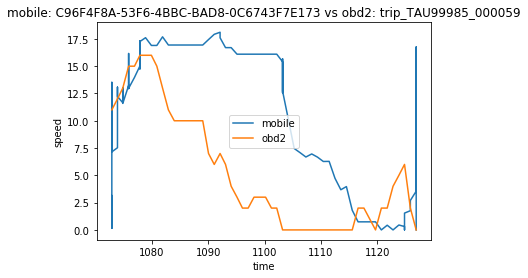

1496747716.0008 1072.894
1496748490 1126.917


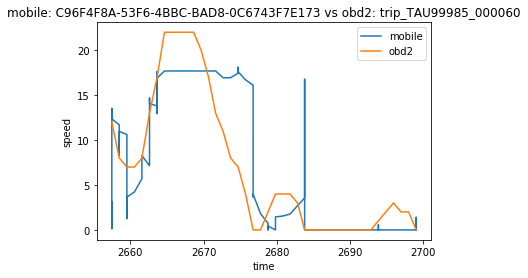

1496747716.0008 2657.475
1496748490 2699.057


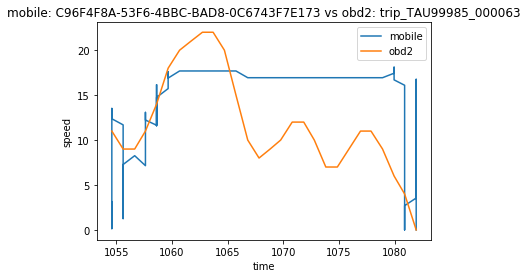

1496747716.0008 1054.607
1496748490 1081.929


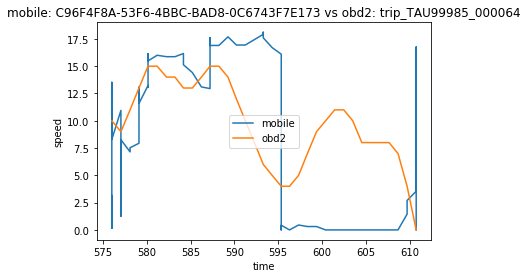

1496747716.0008 576.017
1496748490 610.745


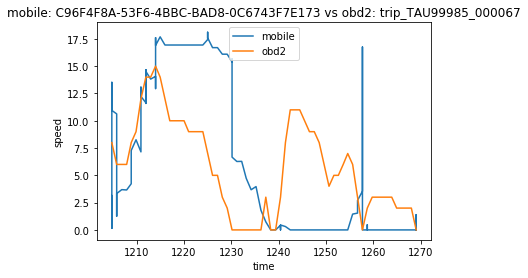

1496747716.0008 1204.753
1496748490 1269.078


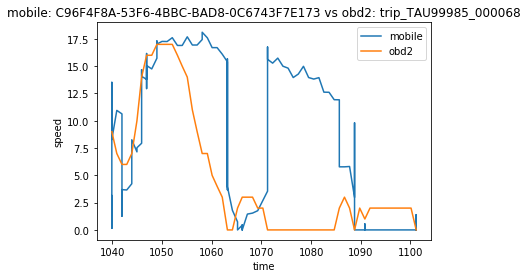

1496747716.0008 1039.884
1496748490 1101.148


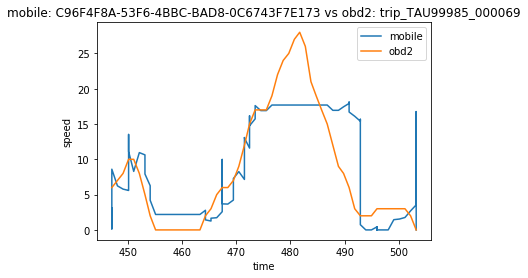

1496747716.0008 447.035
1496748490 503.208


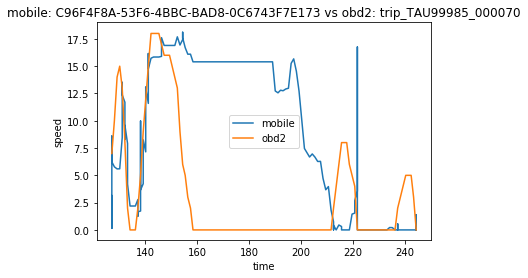

1496747716.0008 127.217
1496748490 244.231


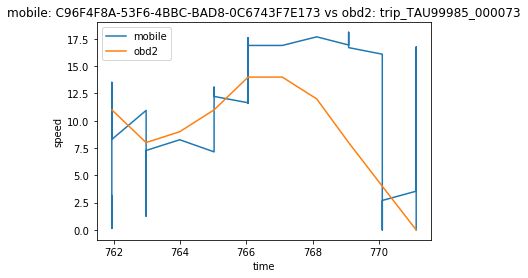

1496747716.0008 761.944
1496748490 771.129


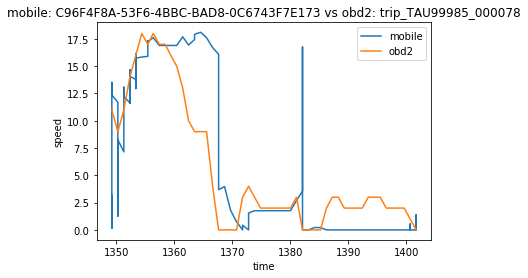

1496747716.0008 1349.21
1496748490 1401.694


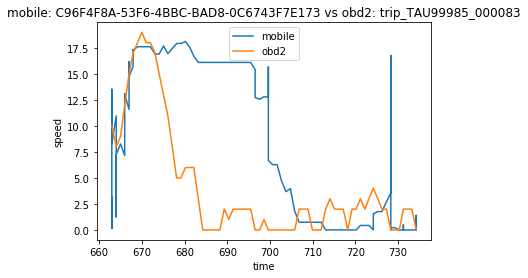

1496747716.0008 662.949
1496748490 734.225


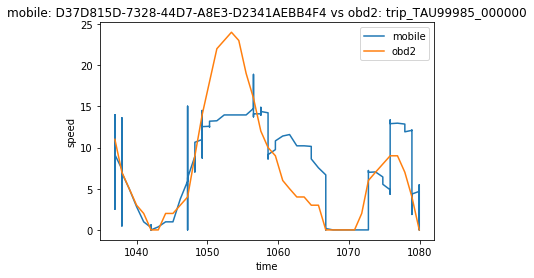

1496778545 1036.933
1496779197.0001 1079.914


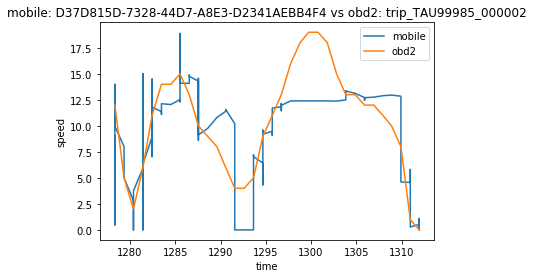

1496778545 1278.324
1496779197.0001 1311.954


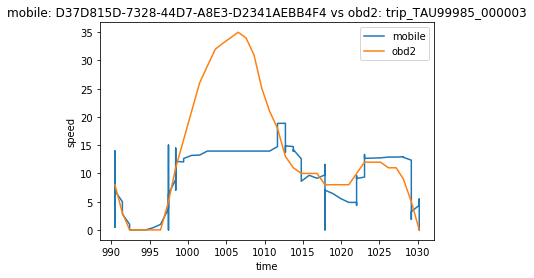

1496778545 990.453
1496779197.0001 1030.204


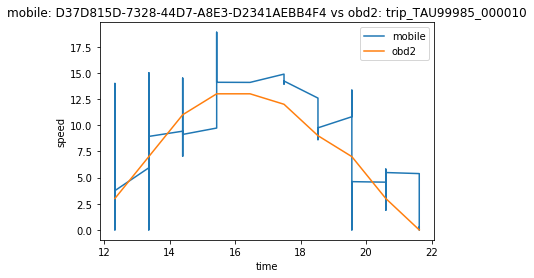

1496778545 12.329
1496779197.0001 21.626


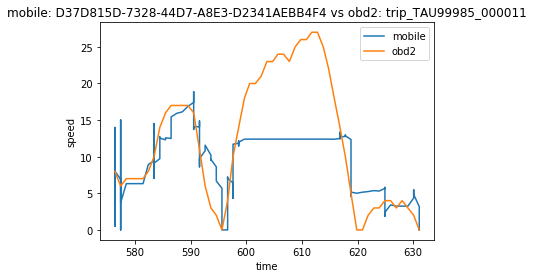

1496778545 576.417
1496779197.0001 631.079


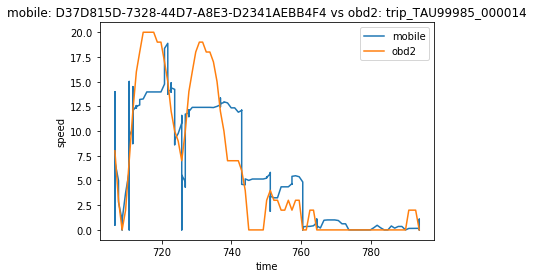

1496778545 706.559
1496779197.0001 793.924


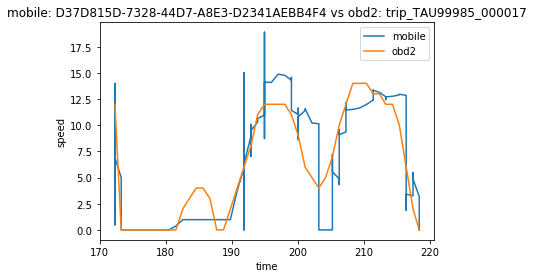

1496778545 172.295
1496779197.0001 218.367


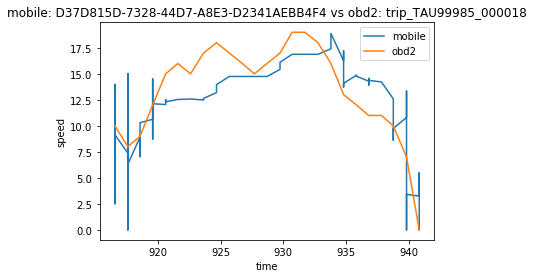

1496778545 916.569
1496779197.0001 940.843


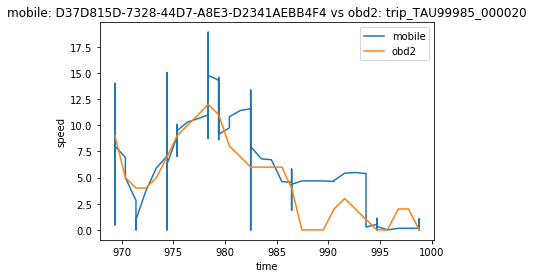

1496778545 969.351
1496779197.0001 998.784


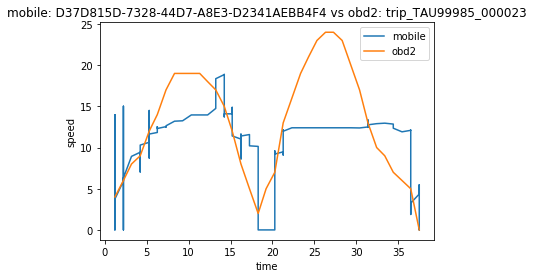

1496778545 1.226
1496779197.0001 37.487


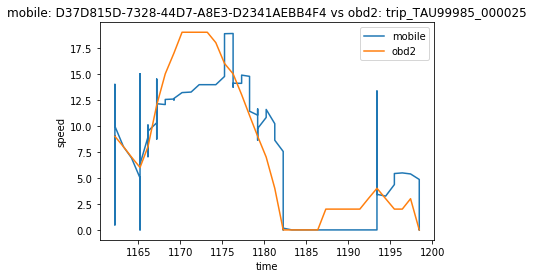

1496778545 1162.191
1496779197.0001 1198.434


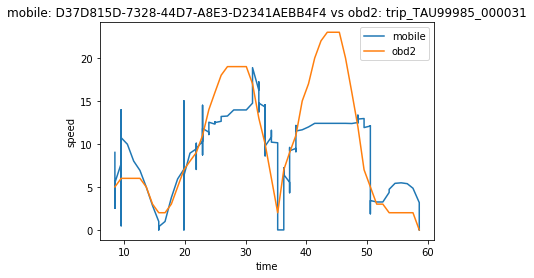

1496778545 8.466
1496779197.0001 58.605


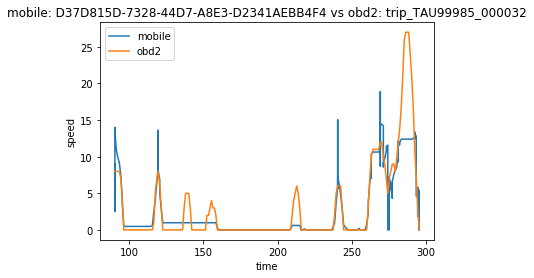

1496778545 90.422
1496779197.0001 295.315


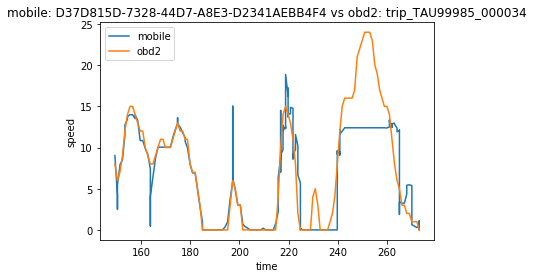

1496778545 149.39
1496779197.0001 273.077


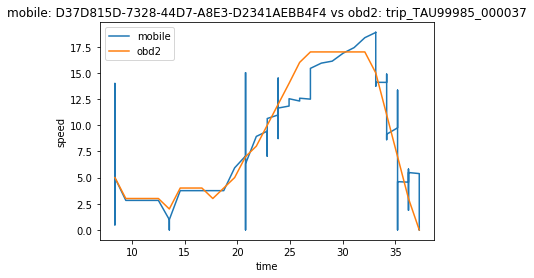

1496778545 8.372
1496779197.0001 37.273


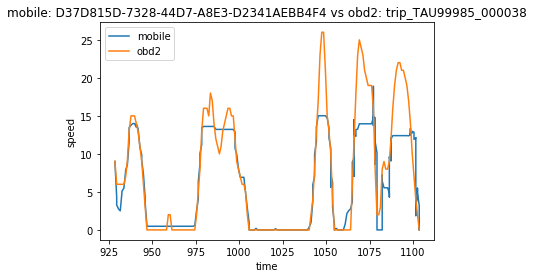

1496778545 928.598
1496779197.0001 1103.586


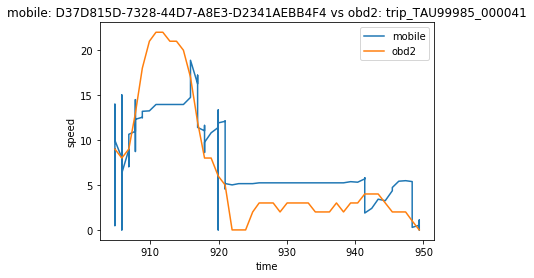

1496778545 904.795
1496779197.0001 949.386


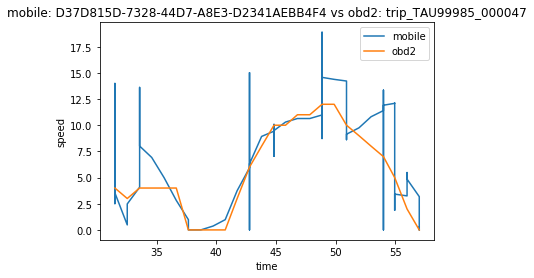

1496778545 31.489
1496779197.0001 57.003


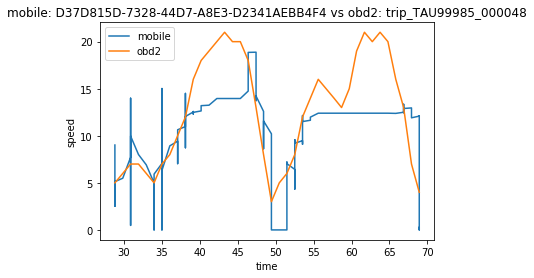

1496778545 28.798
1496779197.0001 68.927


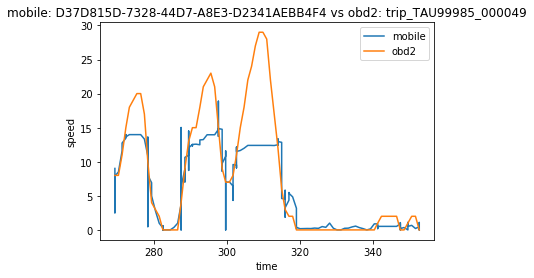

1496778545 269.344
1496779197.0001 352.727


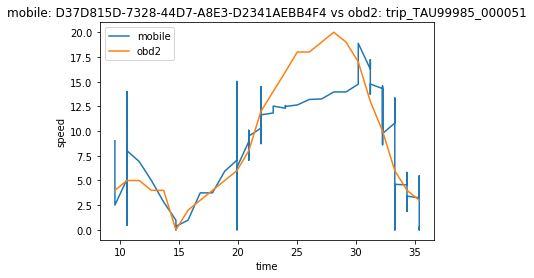

1496778545 9.583
1496779197.0001 35.373


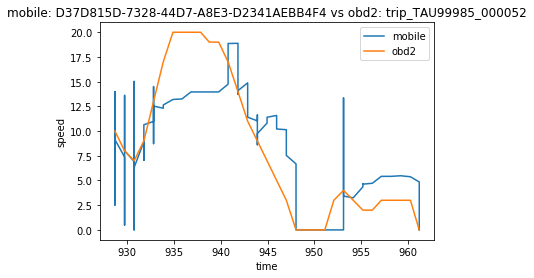

1496778545 928.685
1496779197.0001 961.206


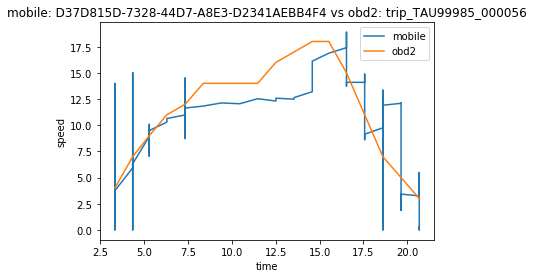

1496778545 3.334
1496779197.0001 20.678


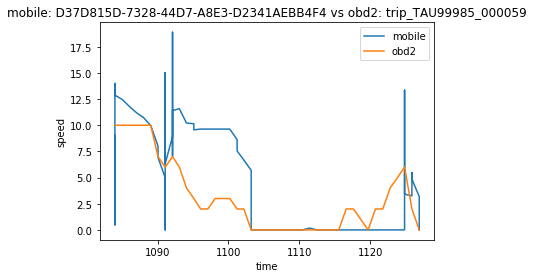

1496778545 1083.977
1496779197.0001 1126.917


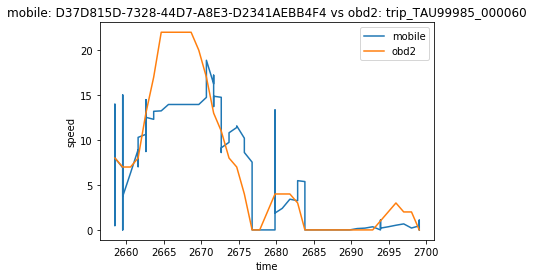

1496778545 2658.49
1496779197.0001 2699.057


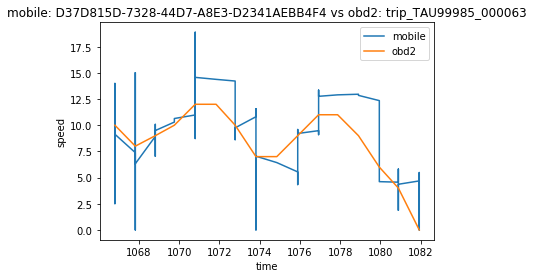

1496778545 1066.808
1496779197.0001 1081.929


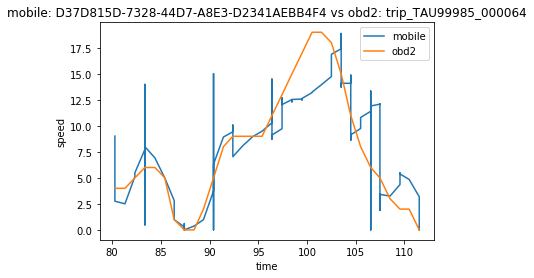

1496778545 80.277
1496779197.0001 111.526


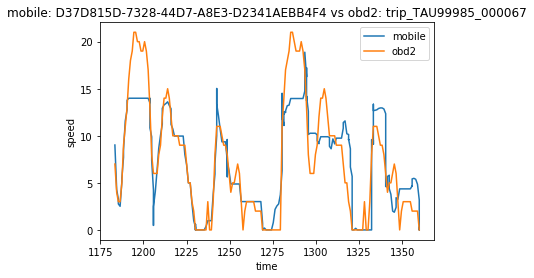

1496778545 1183.413
1496779197.0001 1359.929


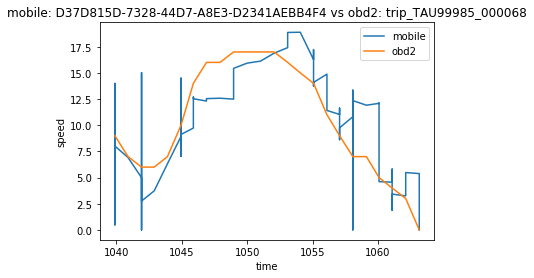

1496778545 1039.884
1496779197.0001 1063.147


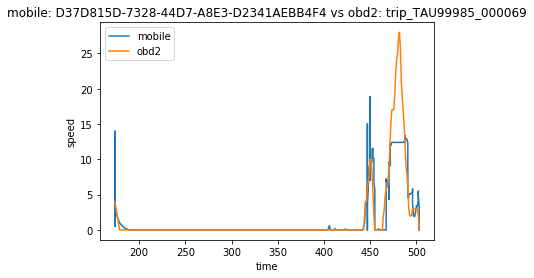

1496778545 173.675
1496779197.0001 503.208


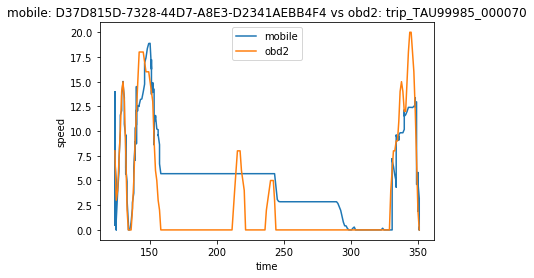

1496778545 124.175
1496779197.0001 351.1


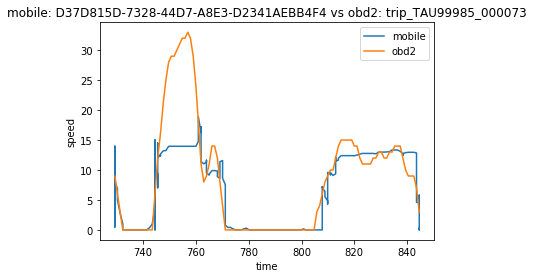

1496778545 729.33
1496779197.0001 844.546


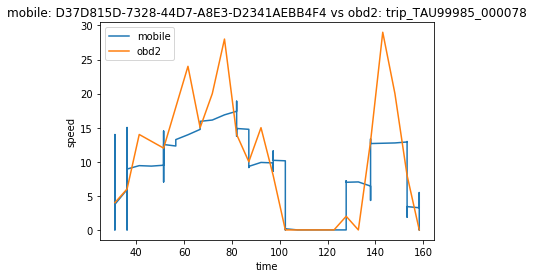

1496778545 31.012
1496779197.0001 158.367


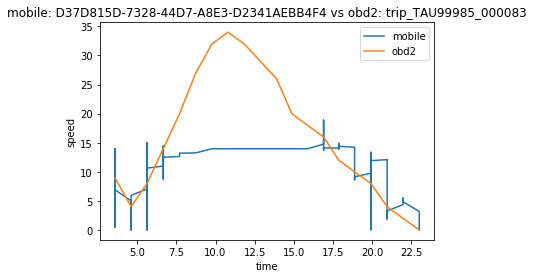

1496778545 3.568
1496779197.0001 23.02


In [112]:
for i in range(len(mobile)):
    mobile_id= mobile[i][0]['trip_id']
    
    if mobile_id not in mobile_list:
        continue
    
    #mobile_time= pd.DataFrame(columns=['start', 'end', 'sec', 'speed'], index= range(len(mobile[i])))
    #cnt=0
    
    #end= datetime.datetime.fromtimestamp(float(mobile[i][0]['timestamp']))
    #for value in mobile[i]:
        
    #    if value['accuracy'] > 17.5:
    #        continue
        
    #    start= datetime.datetime.fromtimestamp(float(value['timestamp']))
    #    mobile_time.loc[cnt, 'start']= start
    #    mobile_time.loc[cnt, 'end']= end
    #    mobile_time.loc[cnt, 'sec'] = (start-end).total_seconds() 
    #    mobile_time.loc[cnt, 'speed']= value['speed']
    #    cnt+=1
    
    #x1= mobile_time['sec']
    #y1= mobile_time['speed']
    #if sum(y1)==0:
    #    continue
        
    #x1= np.asarray(x1)
    #x1= (x1-min(x1))/(max(x1)-min(x1)) 
    
    x1 = [value['timestamp'] for value in mobile[i]]
    y1 = [value['speed'] for value in mobile[i]]
    if False:
        y1= [value['speed'] for value in mobile[i] if value['accuracy'] < 17.5]
        y1= np.asarray(y1)
        y1= (y1-min(y1))/(max(y1)-min(y1))
    
    if sum(y1)==0 and np.var(y1)<0.1:
        continue
    
    for j in range(len(obd2)):
        obd2_id= obd2[j][0]['trip_id']
        
        if obd2_id not in obd2_list:
            continue
        
        x2= [value['timestamp'] for value in obd2[j]] 
        y2= [value['speed'] for value in obd2[j]]
        #if sum(y2)==0 and np.var(y2)<0.1:
        
        
        curr_pair = pair(mobile[i],x2,y2,threshold = 17.5, scaling = True)
        curr_pair.calculate()
        
        if False:
        
            #x2= np.asarray(x2)
            #x2= (x2-min(x2))/(max(x2)-min(x2))
            y2= np.asarray(y2)
            y2= (y2-min(y2))/(max(y2)-min(y2))

            #if max(y2)-min(y2)<0.5:
            if sum(y2)==0 and np.var(y2)<0.1:
                continue

            # search optimal sub path

            p, d = dtw_subsequence_path(y1, y2) # (subseq, longseq)
        
        p,d = curr_pair.optim_path, curr_pair.dist
        # take the index
        mobile_index= [o[0] for o in p]
        obd2_index= [o[1] for o in p]
        
        
        title= 'mobile: '+ mobile_id + ' vs ' +'obd2: ' + obd2_id
        plt.title(title)
        plt.xlabel('time')
        plt.ylabel('speed')
        
        plt.plot([x2[i] for i in obd2_index], [y1[i] for i in mobile_index] , label='mobile')
        plt.plot([x2[i] for i in obd2_index], [y2[i] for i in obd2_index], label='obd2')
        
        #plt.plot([x2[i] for i in odb2_index], )
        
        #plt.plot(x1, y1, label='mobile')
        #plt.plot(x2, y2, label='obd2')
        plt.legend()
        #plt.savefig(path + 'figure/' + mobile_id +'-'+ obd2_id)
        plt.show()
        
        
        # save start and end time
        
        print(x1[p[0][0]], x2[p[0][1]])
        print(x1[p[-1][0]], x2[p[-1][1]])
        

In [110]:
import pdb
from tslearn.metrics import dtw_subsequence_path
class pair (object):
    def __init__(self, mobile, obd2_time, obd2_speed,threshold=None,scaling = False):
        self.obd2_time = obd2_time
        self.obd2_speed = obd2_speed
        self.optim_path = None
        self.dist = None
        self.__populate_mobile(mobile,threshold,scaling)
    
    def __populate_mobile(self, mobile,threshold=None,scaling=False):
        self.mobile_speed = []
        self.mobile_time  = []
        for point in mobile:
            accuracy = point['accuracy']
            if threshold is not None and accuracy > threshold:
                continue
            self.mobile_speed.append(point['speed'])
            self.mobile_time.append(point['timestamp'])
        if scaling:
            self.__scaling()

    def __scaling(self):
        self.mobile_speed = np.asarray(self.mobile_speed)
        self.obd2_speed = np.asarray(self.obd2_speed)
        self.mobile_speed = \
            self.mobile_speed - min(self.mobile_speed)/ (max(self.mobile_speed)-min(self.mobile_speed))
        self.obd2_speed = \
            self.obd2_speed - min(self.obd2_speed)/ (max(self.obd2_speed)-min(self.obd2_speed))
    
    def calculate(self, threshold=None, scaling=False):
        self.optim_path, self.dist = dtw_subsequence_path(self.mobile_speed,self.obd2_speed)
        